<a href="https://colab.research.google.com/github/DT6A/DCGAN/blob/master/Copy_of_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip install kaggle

In [0]:
from google.colab import files 
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"dt6cgsg","key":"b823fa1cebd4d2dfd2639306a0ad1280"}'}

In [0]:
!mkdir -p ~/.kaggle 
!cp kaggle.json ~/.kaggle/

In [0]:
!kaggle datasets download -d jessicali9530/celeba-dataset

 99% 1.20G/1.21G [00:11<00:00, 136MB/s]
100% 1.21G/1.21G [00:11<00:00, 113MB/s]


In [0]:
!unzip celeba-dataset.zip -d faces
!unzip faces/img_align_celeba.zip -d faces

In [0]:
import os

In [0]:
faces = os.listdir('faces/img_align_celeba')

In [0]:
os.listdir('faces/img_align_celeba')[:10]

In [0]:
import cv2
from matplotlib import pyplot as plt

In [0]:
len(faces)

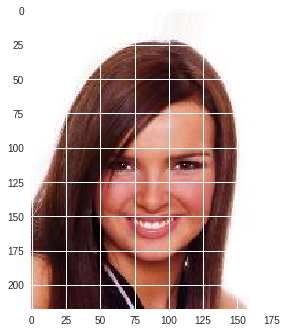

In [0]:
img = cv2.imread('faces/img_align_celeba/'+faces[753])
plt.imshow(img[..., [2, 1, 0]])

In [0]:
img.shape

(218, 178)

In [0]:
img

array([[222, 222, 222, ..., 204, 205, 205],
       [222, 222, 222, ..., 204, 205, 205],
       [222, 222, 222, ..., 204, 205, 205],
       ...,
       [236, 238, 241, ..., 210, 205, 205],
       [235, 238, 242, ..., 212, 208, 208],
       [235, 238, 242, ..., 212, 208, 208]], dtype=uint8)

In [0]:
img = cv2.imread(images[0])

#DCGAN

In [0]:
import numpy as np

from keras.initializers import RandomNormal

from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten, Reshape
from keras.layers import Conv2D, Conv2DTranspose, UpSampling2D, AveragePooling2D
from keras.layers import LeakyReLU, Dropout
from keras.layers import BatchNormalization
from keras.optimizers import Adam, RMSprop, SGD


Using TensorFlow backend.


In [0]:
class DCGAN:
  def __init__(self, img_rows=128, img_cols=128, channel=3): 
    self.img_rows = img_rows 
    self.img_cols = img_cols 
    self.channel = channel 

    self.D = None # discriminator
    self.G = None # generator 
    self.AM = None # adversarial model 
    self.DM = None # discriminator model 
    
    # (W−F+2P)/S+1 
  def discriminator(self): 
    if self.D: 
      return self.D
    
    self.D = Sequential() 
    depth = 256 
    dropout = 0.4
    
    input_shape = (self.img_rows, self.img_cols, self.channel) 
    self.D.add(Conv2D(32, 5,  strides=2, input_shape=input_shape, padding='same', kernel_initializer=RandomNormal(stddev=0.02))) 
    self.D.add(LeakyReLU(alpha=0.2))
    self.D.add(Dropout(dropout))
    self.D.add(Conv2D(64, 5,  strides=2, input_shape=input_shape, padding='same', kernel_initializer=RandomNormal(stddev=0.02))) 
    self.D.add(LeakyReLU(alpha=0.2))
    self.D.add(Dropout(dropout))
    self.D.add(Conv2D(128, 5,  strides=1, input_shape=input_shape, padding='same', kernel_initializer=RandomNormal(stddev=0.02))) 
    self.D.add(LeakyReLU(alpha=0.2))
    self.D.add(Dropout(dropout))
    self.D.add(Conv2D(256, 5,  strides=1, input_shape=input_shape, padding='same', kernel_initializer=RandomNormal(stddev=0.02))) 
    self.D.add(LeakyReLU(alpha=0.2))
    self.D.add(Dropout(dropout))
    
    
    self.D.add(Flatten()) 
    self.D.add(Dropout(dropout))
    self.D.add(Dense(1, kernel_initializer=RandomNormal(stddev=0.02))) 
    self.D.add(Activation('sigmoid')) 
    self.D.summary() 
    
    return self.D
  
  def generator(self): 
    if self.G: 
      return self.G
    
    self.G = Sequential() 
    dropout = 0.4
    depth = 256 
    dim = 32 
   
    self.G.add(Dense(self.img_rows // 8 * self.img_cols // 8 * 256, input_dim=100, kernel_initializer=RandomNormal(stddev=0.02)))
    self.G.add(BatchNormalization(momentum=0.9))
    self.G.add(LeakyReLU(alpha=0.2)) 
    self.G.add(Reshape((self.img_rows // 8, self.img_cols // 8, 256)))
    self.G.add(Dropout(dropout))
    self.G.add(UpSampling2D()) 
    
   
    self.G.add(Conv2DTranspose(128, 5, padding='same', kernel_initializer=RandomNormal(stddev=0.02)))
    self.G.add(BatchNormalization(momentum=0.9))
    self.G.add(LeakyReLU(alpha=0.2)) 
    self.G.add(UpSampling2D()) 
    
    self.G.add(Conv2DTranspose(64, 5, padding='same', kernel_initializer=RandomNormal(stddev=0.02)))
    self.G.add(BatchNormalization(momentum=0.9))
    self.G.add(LeakyReLU(alpha=0.2)) 
    self.G.add(UpSampling2D()) 
   
    self.G.add(Conv2DTranspose(32, 5, padding='same'))
    self.G.add(BatchNormalization(momentum=0.9)) 
    self.G.add(Activation('relu')) 
    self.G.add(Conv2DTranspose(self.channel, 3, padding='same', kernel_initializer=RandomNormal(stddev=0.02))) 
    self.G.add(Activation('tanh')) 
    self.G.summary() 
    
    return self.G 
  
  def discriminator_model(self): 
    if self.DM: 
      return self.DM 
    
    optimizer = Adam(lr=0.0004, decay=6e-8) 
    
    self.DM = Sequential() 
    self.DM.add(self.discriminator()) 
    self.DM.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
  
    return self.DM 
  
  def adversarial_model(self): 
    if self.AM: 
      return self.AM 
    
    optimizer = Adam(lr=0.0001, decay=3e-8)     
    self.AM = Sequential() 
    self.AM.add(self.generator()) 
    self.AM.add(self.discriminator()) 
    self.AM.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy']) 
    
    return self.AM

In [0]:
class CAT_DCGAN: 
  def __init__(self, model=None, W=None, H=None, C=None, g=None, d=None): 
    self.img_rows = W
    self.img_cols = H
    self.channel = C
    self.noise_s = 100
    
    self.x_train = None
    
    
    self.DCGAN = DCGAN(W, H, C) 
 
    self.DCGAN.G = g
    self.DCGAN.D = d
    
    self.discriminator = self.DCGAN.discriminator_model() 
    self.adversarial = self.DCGAN.adversarial_model() 
    self.generator = self.DCGAN.generator() 
    
    self.i_n = 0
    
  def plot_images(self, save2file=False, fake=True, samples=16, noise=None, step=0): 
        filename = 'tmp_res/!faces' + str(self.i_n) + '.png'
        
        
        if fake: 
          if noise is None: 
            noise = np.random.normal(0, 0.3, size=[samples, self.noise_s])
          else: 
            filename = "mnist_%d.png" % step 
          images = self.generator.predict(noise) 
        else: 
          i = np.random.randint(0, self.x_train.shape[0], samples) 
          images = self.x_train[i, :, :, :] 
          
          plt.figure(figsize=(10,10)) 
          
        for i in range(images.shape[0]): 
          plt.subplot(4, 4, i+1) 
          image = images[i, :, :, :] 
          image = np.reshape((image + 1) / 2 , [self.img_rows, self.img_cols, self.channel]) 
          plt.imshow(image[..., [2, 1, 0]]) 
          plt.axis('off') 
            
        plt.tight_layout() 
        if save2file: 
          plt.savefig(filename)
          self.i_n += 1
          plt.close('all') 
        else: 
          plt.show()
  def train(self, train_steps=2000, batch_size=16, save_interval=50, G_T=True): 
    noise_input = None
    
    
    
    if save_interval>0: 
      noise = np.random.normal(0, 0.3, size=[batch_size, self.noise_s])
    for i in range(train_steps): 
      images_train = self.x_train[np.random.randint(0, self.x_train.shape[0], size=batch_size), :] 
      noise = np.random.normal(0, 0.3, size=[batch_size, self.noise_s])
      images_fake = self.generator.predict(noise) 
      x = np.concatenate((images_train.reshape(batch_size, self.img_rows, self.img_cols, self.channel), images_fake)) 
      y = np.ones([2*batch_size, 1]) 
      y[batch_size:, :] = np.zeros([batch_size, 1]) 
      d_loss = self.discriminator.train_on_batch(x, y) 
      
      y = np.ones([batch_size, 1]) 
      noise = np.random.normal(0, 0.3, size=[batch_size, self.noise_s])
      if G_T:
        a_loss = self.adversarial.train_on_batch(noise, y) 
      log_mesg = "%d: [D loss: %f, acc: %f]" % (i, d_loss[0], d_loss[1]) 
      if G_T:
        log_mesg = "%s [A loss: %f, acc: %f]" % (log_mesg, a_loss[0], a_loss[1]) 
      print(log_mesg)
      
          
      if save_interval>0: 
        if (i+1)%save_interval==0: 
          self.plot_images(save2file=False, samples=16, noise=None, step=(i+1)) 
          
    

In [0]:
y_train = []
    
for f in faces[:1000]:
  im = cv2.resize((cv2.imread('faces/img_align_celeba/' + f) / 255), (128, 	128), interpolation = cv2.INTER_AREA)
  im = im.sum(axis=2) / 3
  im = (im * 2 - 1).reshape(-1)
  y_train.append(im)

In [0]:
y_train[0].shape

(16384,)

In [0]:
from keras.models import load_model

In [0]:
#del mnist_dcgan
mnist_dcgan = CAT_DCGAN(W=64, H=64, C=3)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_11 (Conv2D)           (None, 32, 32, 32)        2432      
_________________________________________________________________
leaky_re_lu_19 (LeakyReLU)   (None, 32, 32, 32)        0         
_________________________________________________________________
dropout_17 (Dropout)         (None, 32, 32, 32)        0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 16, 16, 64)        51264     
_________________________________________________________________
leaky_re_lu_20 (LeakyReLU)   (None, 16, 16, 64)        0         
_________________________________________________________________
dropout_18 (Dropout)         (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 16, 16, 128)       204928    
__________

0: [D loss: 0.845401, acc: 0.531250] [A loss: 1.145906, acc: 0.156250]
1: [D loss: 0.684214, acc: 0.562500] [A loss: 0.757124, acc: 0.453125]
2: [D loss: 0.799052, acc: 0.523438] [A loss: 1.233458, acc: 0.125000]
3: [D loss: 0.633538, acc: 0.687500] [A loss: 0.982069, acc: 0.140625]
4: [D loss: 0.646051, acc: 0.656250] [A loss: 0.984992, acc: 0.265625]
5: [D loss: 0.686160, acc: 0.593750] [A loss: 1.026744, acc: 0.140625]
6: [D loss: 0.663163, acc: 0.679688] [A loss: 1.080693, acc: 0.140625]
7: [D loss: 0.600363, acc: 0.710938] [A loss: 0.988106, acc: 0.234375]
8: [D loss: 0.655397, acc: 0.601562] [A loss: 1.409509, acc: 0.015625]
9: [D loss: 0.575883, acc: 0.710938] [A loss: 0.787400, acc: 0.406250]
10: [D loss: 0.664308, acc: 0.546875] [A loss: 1.377060, acc: 0.062500]
11: [D loss: 0.544348, acc: 0.757812] [A loss: 0.807677, acc: 0.453125]
12: [D loss: 0.561983, acc: 0.640625] [A loss: 1.282995, acc: 0.078125]
13: [D loss: 0.494791, acc: 0.765625] [A loss: 0.892472, acc: 0.359375]
14

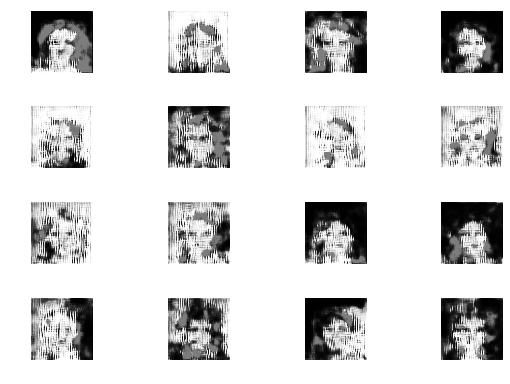

0: [D loss: 0.023651, acc: 1.000000] [A loss: 3.035000, acc: 0.031250]
1: [D loss: 0.127797, acc: 0.953125] [A loss: 3.673642, acc: 0.015625]
2: [D loss: 0.040442, acc: 0.992188] [A loss: 2.532638, acc: 0.062500]
3: [D loss: 0.182369, acc: 0.929688] [A loss: 4.270360, acc: 0.000000]
4: [D loss: 0.077435, acc: 0.984375] [A loss: 1.691624, acc: 0.218750]
5: [D loss: 0.275317, acc: 0.882812] [A loss: 4.104490, acc: 0.000000]
6: [D loss: 0.081856, acc: 0.984375] [A loss: 2.618607, acc: 0.062500]
7: [D loss: 0.207464, acc: 0.914062] [A loss: 3.951269, acc: 0.000000]
8: [D loss: 0.158032, acc: 0.945312] [A loss: 1.235649, acc: 0.265625]
9: [D loss: 0.689874, acc: 0.726562] [A loss: 4.090173, acc: 0.000000]
10: [D loss: 0.533346, acc: 0.734375] [A loss: 1.686380, acc: 0.093750]
11: [D loss: 0.368425, acc: 0.796875] [A loss: 2.770215, acc: 0.000000]
12: [D loss: 0.188946, acc: 0.953125] [A loss: 2.086531, acc: 0.046875]
13: [D loss: 0.252619, acc: 0.875000] [A loss: 2.512516, acc: 0.000000]
14

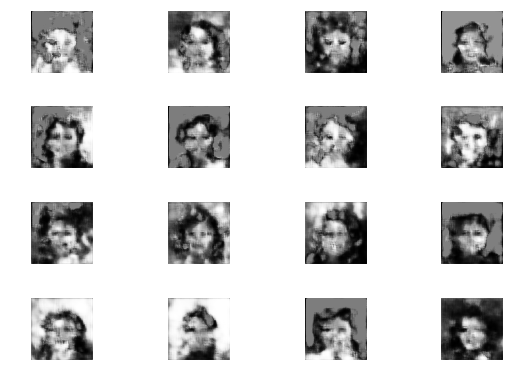

0: [D loss: 0.712929, acc: 0.515625] [A loss: 0.906735, acc: 0.078125]
1: [D loss: 0.668765, acc: 0.609375] [A loss: 0.768193, acc: 0.406250]
2: [D loss: 0.735544, acc: 0.507812] [A loss: 0.923035, acc: 0.125000]
3: [D loss: 0.739969, acc: 0.484375] [A loss: 0.835025, acc: 0.234375]
4: [D loss: 0.667433, acc: 0.570312] [A loss: 0.736841, acc: 0.421875]
5: [D loss: 0.721219, acc: 0.453125] [A loss: 0.832325, acc: 0.187500]
6: [D loss: 0.675657, acc: 0.539062] [A loss: 0.728215, acc: 0.406250]
7: [D loss: 0.783326, acc: 0.539062] [A loss: 1.044574, acc: 0.000000]
8: [D loss: 0.716443, acc: 0.484375] [A loss: 0.837814, acc: 0.171875]
9: [D loss: 0.650729, acc: 0.617188] [A loss: 0.714790, acc: 0.406250]
10: [D loss: 0.683143, acc: 0.523438] [A loss: 0.767409, acc: 0.328125]
11: [D loss: 0.717004, acc: 0.554688] [A loss: 0.957759, acc: 0.078125]
12: [D loss: 0.687644, acc: 0.554688] [A loss: 0.685415, acc: 0.515625]
13: [D loss: 0.732150, acc: 0.546875] [A loss: 0.950867, acc: 0.031250]
14

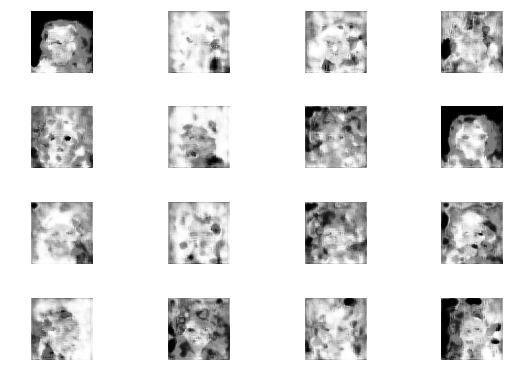

0: [D loss: 0.544258, acc: 0.734375] [A loss: 0.975481, acc: 0.328125]
1: [D loss: 0.605189, acc: 0.679688] [A loss: 0.904765, acc: 0.468750]
2: [D loss: 0.714132, acc: 0.632812] [A loss: 1.287524, acc: 0.218750]
3: [D loss: 0.589707, acc: 0.664062] [A loss: 0.752393, acc: 0.468750]
4: [D loss: 0.726738, acc: 0.632812] [A loss: 1.008339, acc: 0.343750]
5: [D loss: 0.675069, acc: 0.554688] [A loss: 0.918597, acc: 0.390625]
6: [D loss: 0.691802, acc: 0.640625] [A loss: 1.070761, acc: 0.312500]
7: [D loss: 0.677214, acc: 0.601562] [A loss: 0.791243, acc: 0.484375]
8: [D loss: 0.748075, acc: 0.640625] [A loss: 1.191146, acc: 0.234375]
9: [D loss: 0.699680, acc: 0.578125] [A loss: 0.935944, acc: 0.312500]
10: [D loss: 0.632637, acc: 0.671875] [A loss: 0.902555, acc: 0.375000]
11: [D loss: 0.669339, acc: 0.648438] [A loss: 1.391240, acc: 0.140625]
12: [D loss: 0.585422, acc: 0.703125] [A loss: 0.604020, acc: 0.609375]
13: [D loss: 0.873581, acc: 0.562500] [A loss: 1.001929, acc: 0.203125]
14

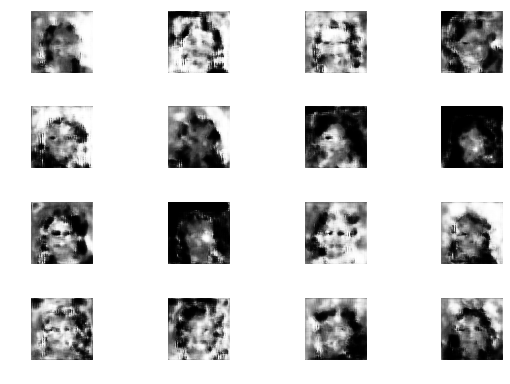

0: [D loss: 0.762392, acc: 0.421875] [A loss: 0.320698, acc: 0.875000]
1: [D loss: 0.810346, acc: 0.453125] [A loss: 0.409038, acc: 0.812500]
2: [D loss: 0.764476, acc: 0.476562] [A loss: 0.200885, acc: 0.921875]
3: [D loss: 0.765652, acc: 0.437500] [A loss: 0.285229, acc: 0.890625]
4: [D loss: 0.759067, acc: 0.453125] [A loss: 0.079411, acc: 1.000000]
5: [D loss: 0.760168, acc: 0.460938] [A loss: 0.138320, acc: 0.984375]
6: [D loss: 0.726826, acc: 0.500000] [A loss: 0.068226, acc: 0.984375]
7: [D loss: 0.655650, acc: 0.585938] [A loss: 0.112732, acc: 0.968750]
8: [D loss: 0.638231, acc: 0.609375] [A loss: 0.078951, acc: 1.000000]
9: [D loss: 0.647118, acc: 0.648438] [A loss: 0.083182, acc: 1.000000]
10: [D loss: 0.584907, acc: 0.593750] [A loss: 0.015055, acc: 1.000000]
11: [D loss: 0.788940, acc: 0.453125] [A loss: 0.100667, acc: 0.984375]
12: [D loss: 0.695992, acc: 0.570312] [A loss: 0.048979, acc: 0.984375]
13: [D loss: 0.465697, acc: 0.851562] [A loss: 0.077123, acc: 1.000000]
14

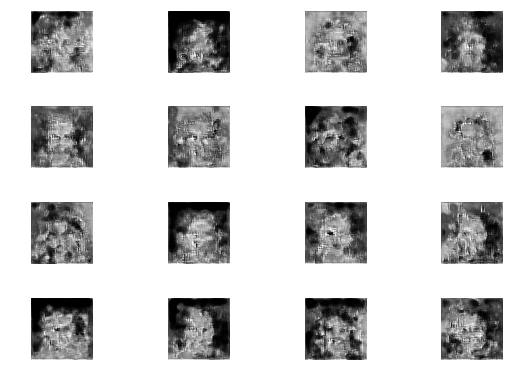

0: [D loss: 0.573751, acc: 0.679688] [A loss: 0.020857, acc: 1.000000]
1: [D loss: 0.526467, acc: 0.757812] [A loss: 0.001861, acc: 1.000000]
2: [D loss: 0.581475, acc: 0.679688] [A loss: 0.038710, acc: 1.000000]
3: [D loss: 0.551518, acc: 0.765625] [A loss: 0.003153, acc: 1.000000]
4: [D loss: 0.405905, acc: 0.898438] [A loss: 0.017281, acc: 1.000000]
5: [D loss: 0.546150, acc: 0.703125] [A loss: 0.000035, acc: 1.000000]
6: [D loss: 0.751630, acc: 0.531250] [A loss: 0.087125, acc: 0.968750]
7: [D loss: 0.426959, acc: 0.898438] [A loss: 0.000232, acc: 1.000000]
8: [D loss: 0.256276, acc: 0.960938] [A loss: 0.000195, acc: 1.000000]
9: [D loss: 0.239864, acc: 0.960938] [A loss: 0.000525, acc: 1.000000]
10: [D loss: 0.171767, acc: 0.992188] [A loss: 0.001555, acc: 1.000000]
11: [D loss: 0.170892, acc: 0.992188] [A loss: 0.007422, acc: 1.000000]
12: [D loss: 0.140199, acc: 0.992188] [A loss: 0.008835, acc: 1.000000]
13: [D loss: 0.136954, acc: 0.992188] [A loss: 0.002775, acc: 1.000000]
14

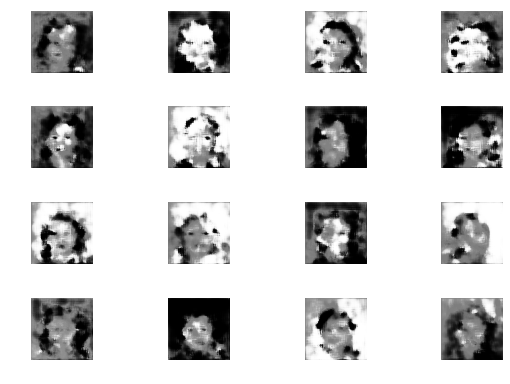

0: [D loss: 0.749148, acc: 0.546875] [A loss: 0.956871, acc: 0.078125]
1: [D loss: 0.706256, acc: 0.515625] [A loss: 0.737125, acc: 0.375000]
2: [D loss: 0.680569, acc: 0.601562] [A loss: 0.746655, acc: 0.390625]
3: [D loss: 0.713114, acc: 0.507812] [A loss: 0.827784, acc: 0.203125]
4: [D loss: 0.723370, acc: 0.437500] [A loss: 0.841347, acc: 0.250000]
5: [D loss: 0.696529, acc: 0.500000] [A loss: 0.791637, acc: 0.265625]
6: [D loss: 0.685872, acc: 0.539062] [A loss: 0.856173, acc: 0.203125]
7: [D loss: 0.708919, acc: 0.515625] [A loss: 0.818357, acc: 0.218750]
8: [D loss: 0.701716, acc: 0.539062] [A loss: 0.834270, acc: 0.203125]
9: [D loss: 0.699062, acc: 0.531250] [A loss: 0.806870, acc: 0.312500]
10: [D loss: 0.707731, acc: 0.531250] [A loss: 0.831543, acc: 0.281250]
11: [D loss: 0.672311, acc: 0.585938] [A loss: 0.698649, acc: 0.484375]
12: [D loss: 0.688733, acc: 0.578125] [A loss: 0.845584, acc: 0.109375]
13: [D loss: 0.659995, acc: 0.546875] [A loss: 0.676012, acc: 0.531250]
14

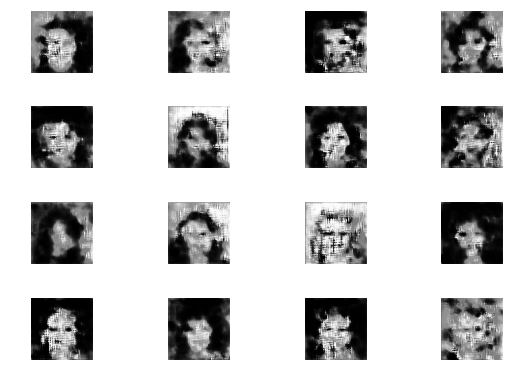

0: [D loss: 0.655268, acc: 0.625000] [A loss: 0.000608, acc: 1.000000]
1: [D loss: 0.718944, acc: 0.539062] [A loss: 0.019537, acc: 0.984375]
2: [D loss: 0.553647, acc: 0.718750] [A loss: 0.002292, acc: 1.000000]
3: [D loss: 0.458446, acc: 0.796875] [A loss: 0.001210, acc: 1.000000]
4: [D loss: 0.372328, acc: 0.921875] [A loss: 0.033337, acc: 0.984375]
5: [D loss: 0.447834, acc: 0.726562] [A loss: 0.000246, acc: 1.000000]
6: [D loss: 0.953991, acc: 0.359375] [A loss: 0.062752, acc: 0.968750]
7: [D loss: 0.397874, acc: 0.851562] [A loss: 0.000006, acc: 1.000000]
8: [D loss: 0.195697, acc: 0.992188] [A loss: 0.000000, acc: 1.000000]
9: [D loss: 0.143165, acc: 1.000000] [A loss: 0.001509, acc: 1.000000]
10: [D loss: 0.101927, acc: 1.000000] [A loss: 0.020057, acc: 0.984375]
11: [D loss: 0.063136, acc: 0.992188] [A loss: 0.097347, acc: 0.968750]
12: [D loss: 0.143190, acc: 0.937500] [A loss: 2.970181, acc: 0.546875]
13: [D loss: 0.091482, acc: 0.960938] [A loss: 0.356313, acc: 0.890625]
14

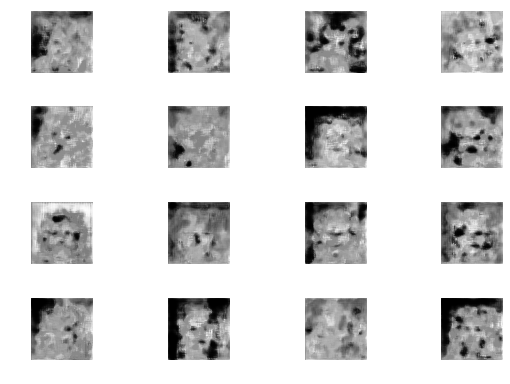

0: [D loss: 0.649008, acc: 0.601562] [A loss: 0.869341, acc: 0.171875]
1: [D loss: 0.580570, acc: 0.687500] [A loss: 0.740212, acc: 0.406250]
2: [D loss: 0.623933, acc: 0.656250] [A loss: 0.864589, acc: 0.218750]
3: [D loss: 0.559816, acc: 0.710938] [A loss: 0.886177, acc: 0.093750]
4: [D loss: 0.537368, acc: 0.640625] [A loss: 0.908619, acc: 0.109375]
5: [D loss: 0.553962, acc: 0.742188] [A loss: 0.693931, acc: 0.500000]
6: [D loss: 0.914676, acc: 0.515625] [A loss: 1.121723, acc: 0.046875]
7: [D loss: 0.662170, acc: 0.562500] [A loss: 0.987149, acc: 0.078125]
8: [D loss: 0.524270, acc: 0.742188] [A loss: 0.827353, acc: 0.296875]
9: [D loss: 0.557875, acc: 0.648438] [A loss: 0.999570, acc: 0.109375]
10: [D loss: 0.465520, acc: 0.812500] [A loss: 0.773352, acc: 0.359375]
11: [D loss: 0.602993, acc: 0.609375] [A loss: 1.034777, acc: 0.109375]
12: [D loss: 0.571909, acc: 0.757812] [A loss: 0.709481, acc: 0.484375]
13: [D loss: 0.770274, acc: 0.593750] [A loss: 1.075536, acc: 0.031250]
14

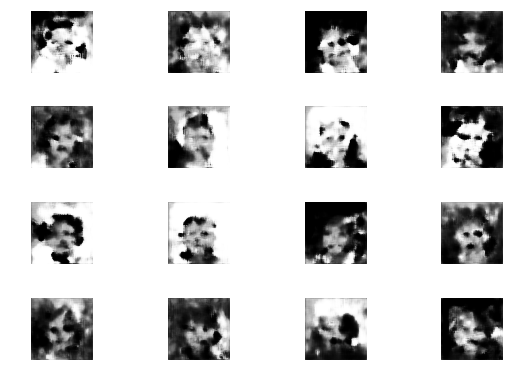

0: [D loss: 0.792120, acc: 0.625000] [A loss: 1.218908, acc: 0.046875]
1: [D loss: 0.677924, acc: 0.578125] [A loss: 1.083866, acc: 0.093750]
2: [D loss: 0.597877, acc: 0.617188] [A loss: 0.872972, acc: 0.375000]
3: [D loss: 0.699813, acc: 0.695312] [A loss: 0.921979, acc: 0.281250]
4: [D loss: 0.614592, acc: 0.640625] [A loss: 0.925643, acc: 0.187500]
5: [D loss: 0.699347, acc: 0.664062] [A loss: 0.901456, acc: 0.312500]
6: [D loss: 0.687087, acc: 0.562500] [A loss: 0.914728, acc: 0.312500]
7: [D loss: 0.704460, acc: 0.531250] [A loss: 0.884136, acc: 0.281250]
8: [D loss: 0.778751, acc: 0.484375] [A loss: 1.041494, acc: 0.125000]
9: [D loss: 0.717882, acc: 0.554688] [A loss: 0.823438, acc: 0.343750]
10: [D loss: 0.749666, acc: 0.476562] [A loss: 0.782613, acc: 0.421875]
11: [D loss: 0.752438, acc: 0.507812] [A loss: 0.821764, acc: 0.453125]
12: [D loss: 0.778917, acc: 0.539062] [A loss: 0.854512, acc: 0.265625]
13: [D loss: 0.754330, acc: 0.523438] [A loss: 0.756286, acc: 0.406250]
14

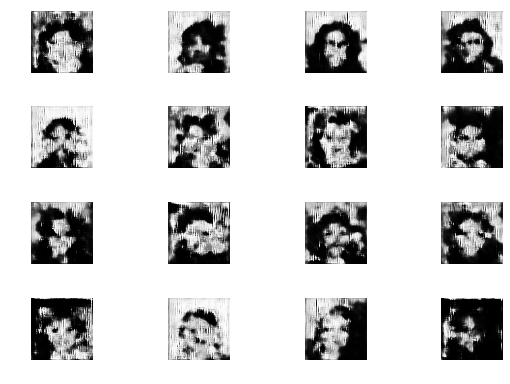

0: [D loss: 0.108444, acc: 0.968750] [A loss: 1.837233, acc: 0.171875]
1: [D loss: 0.183458, acc: 0.921875] [A loss: 3.563040, acc: 0.046875]
2: [D loss: 1.082475, acc: 0.539062] [A loss: 0.000442, acc: 1.000000]
3: [D loss: 3.191671, acc: 0.515625] [A loss: 0.983915, acc: 0.359375]
4: [D loss: 2.124597, acc: 0.578125] [A loss: 1.597181, acc: 0.250000]
5: [D loss: 0.632257, acc: 0.789062] [A loss: 1.932608, acc: 0.171875]
6: [D loss: 0.526431, acc: 0.781250] [A loss: 1.867818, acc: 0.203125]
7: [D loss: 0.766064, acc: 0.734375] [A loss: 2.359259, acc: 0.046875]
8: [D loss: 0.545396, acc: 0.734375] [A loss: 0.511670, acc: 0.734375]
9: [D loss: 1.288160, acc: 0.593750] [A loss: 2.396466, acc: 0.000000]
10: [D loss: 0.856091, acc: 0.515625] [A loss: 1.090363, acc: 0.171875]
11: [D loss: 0.728455, acc: 0.546875] [A loss: 0.959207, acc: 0.234375]
12: [D loss: 0.813225, acc: 0.500000] [A loss: 0.872706, acc: 0.343750]
13: [D loss: 0.722608, acc: 0.554688] [A loss: 0.719619, acc: 0.468750]
14

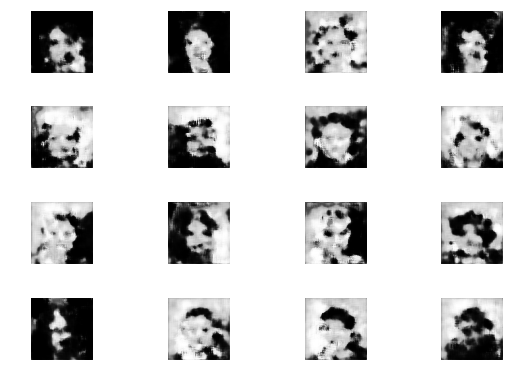

0: [D loss: 0.691685, acc: 0.539062] [A loss: 0.668477, acc: 0.531250]
1: [D loss: 0.727507, acc: 0.476562] [A loss: 0.862903, acc: 0.140625]
2: [D loss: 0.674202, acc: 0.562500] [A loss: 0.574789, acc: 0.734375]
3: [D loss: 0.758062, acc: 0.515625] [A loss: 0.854066, acc: 0.171875]
4: [D loss: 0.726165, acc: 0.484375] [A loss: 0.677294, acc: 0.515625]
5: [D loss: 0.709551, acc: 0.437500] [A loss: 0.477535, acc: 0.812500]
6: [D loss: 0.727275, acc: 0.476562] [A loss: 0.190754, acc: 0.937500]
7: [D loss: 0.709795, acc: 0.476562] [A loss: 0.133074, acc: 0.953125]
8: [D loss: 0.706666, acc: 0.492188] [A loss: 0.005186, acc: 1.000000]
9: [D loss: 0.742038, acc: 0.437500] [A loss: 0.004179, acc: 1.000000]
10: [D loss: 0.717234, acc: 0.492188] [A loss: 0.008975, acc: 1.000000]
11: [D loss: 0.717932, acc: 0.445312] [A loss: 0.015717, acc: 1.000000]
12: [D loss: 0.741756, acc: 0.390625] [A loss: 0.037854, acc: 1.000000]
13: [D loss: 0.738592, acc: 0.453125] [A loss: 0.033233, acc: 1.000000]
14

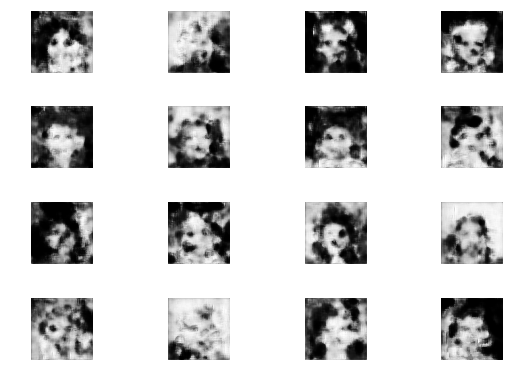

0: [D loss: 0.712856, acc: 0.539062] [A loss: 0.835483, acc: 0.234375]
1: [D loss: 0.742450, acc: 0.531250] [A loss: 0.852618, acc: 0.218750]
2: [D loss: 0.688452, acc: 0.562500] [A loss: 0.828638, acc: 0.281250]
3: [D loss: 0.762609, acc: 0.492188] [A loss: 0.920974, acc: 0.078125]
4: [D loss: 0.682240, acc: 0.515625] [A loss: 0.718821, acc: 0.453125]
5: [D loss: 0.727668, acc: 0.460938] [A loss: 0.782646, acc: 0.296875]
6: [D loss: 0.702473, acc: 0.585938] [A loss: 0.823398, acc: 0.296875]
7: [D loss: 0.719460, acc: 0.515625] [A loss: 0.769421, acc: 0.343750]
8: [D loss: 0.746010, acc: 0.460938] [A loss: 0.819705, acc: 0.281250]
9: [D loss: 0.704565, acc: 0.523438] [A loss: 0.781319, acc: 0.359375]
10: [D loss: 0.711493, acc: 0.507812] [A loss: 0.743076, acc: 0.437500]
11: [D loss: 0.727441, acc: 0.476562] [A loss: 0.794382, acc: 0.250000]
12: [D loss: 0.705618, acc: 0.523438] [A loss: 0.751383, acc: 0.359375]
13: [D loss: 0.727440, acc: 0.484375] [A loss: 0.805969, acc: 0.250000]
14

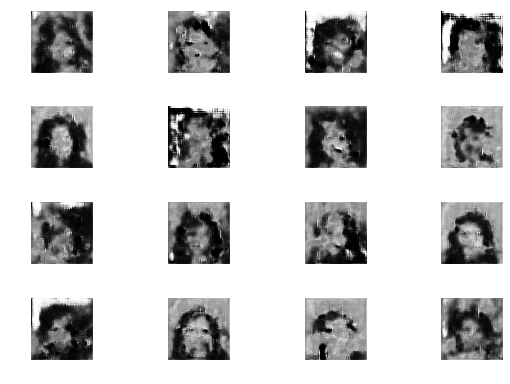

0: [D loss: 0.939456, acc: 0.531250] [A loss: 1.398135, acc: 0.046875]
1: [D loss: 0.671634, acc: 0.625000] [A loss: 0.825149, acc: 0.406250]
2: [D loss: 0.724235, acc: 0.625000] [A loss: 0.960797, acc: 0.265625]
3: [D loss: 0.819314, acc: 0.523438] [A loss: 0.976351, acc: 0.281250]
4: [D loss: 0.742691, acc: 0.484375] [A loss: 0.947240, acc: 0.218750]
5: [D loss: 0.658443, acc: 0.578125] [A loss: 0.866477, acc: 0.328125]
6: [D loss: 0.745667, acc: 0.562500] [A loss: 0.919617, acc: 0.250000]
7: [D loss: 0.706017, acc: 0.515625] [A loss: 0.834707, acc: 0.250000]
8: [D loss: 0.763143, acc: 0.500000] [A loss: 0.869226, acc: 0.265625]
9: [D loss: 0.727053, acc: 0.523438] [A loss: 0.786681, acc: 0.343750]
10: [D loss: 0.792020, acc: 0.414062] [A loss: 0.940717, acc: 0.140625]
11: [D loss: 0.759216, acc: 0.460938] [A loss: 0.846060, acc: 0.218750]
12: [D loss: 0.705165, acc: 0.546875] [A loss: 0.965523, acc: 0.078125]
13: [D loss: 0.700123, acc: 0.562500] [A loss: 0.829219, acc: 0.265625]
14

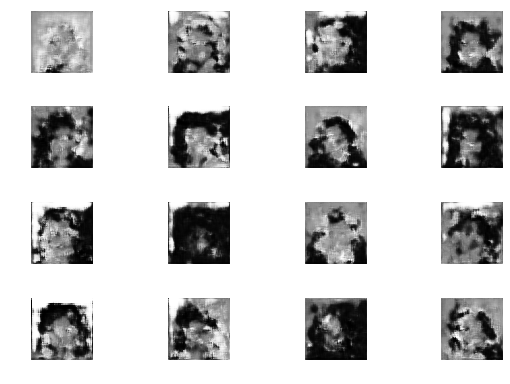

0: [D loss: 0.722012, acc: 0.507812] [A loss: 0.720013, acc: 0.390625]
1: [D loss: 0.708982, acc: 0.531250] [A loss: 0.718483, acc: 0.390625]
2: [D loss: 0.737481, acc: 0.562500] [A loss: 0.797970, acc: 0.234375]
3: [D loss: 0.717724, acc: 0.429688] [A loss: 0.721936, acc: 0.421875]
4: [D loss: 0.752789, acc: 0.484375] [A loss: 0.811383, acc: 0.250000]
5: [D loss: 0.694695, acc: 0.554688] [A loss: 0.748518, acc: 0.390625]
6: [D loss: 0.801988, acc: 0.546875] [A loss: 0.782016, acc: 0.281250]
7: [D loss: 0.790462, acc: 0.476562] [A loss: 0.886820, acc: 0.109375]
8: [D loss: 0.700358, acc: 0.507812] [A loss: 0.820474, acc: 0.250000]
9: [D loss: 0.701837, acc: 0.515625] [A loss: 0.792910, acc: 0.265625]
10: [D loss: 0.664819, acc: 0.585938] [A loss: 0.783932, acc: 0.343750]
11: [D loss: 0.685117, acc: 0.539062] [A loss: 0.769976, acc: 0.265625]
12: [D loss: 0.697958, acc: 0.609375] [A loss: 0.763113, acc: 0.359375]
13: [D loss: 0.662968, acc: 0.578125] [A loss: 0.742844, acc: 0.390625]
14

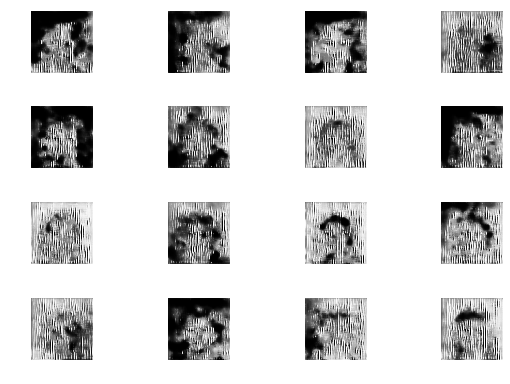

0: [D loss: 0.493862, acc: 0.906250] [A loss: 10.882637, acc: 0.078125]
1: [D loss: 0.008528, acc: 0.992188] [A loss: 7.122400, acc: 0.203125]
2: [D loss: 1.417155, acc: 0.851562] [A loss: 14.945810, acc: 0.000000]
3: [D loss: 0.003779, acc: 1.000000] [A loss: 14.904009, acc: 0.000000]
4: [D loss: 0.010356, acc: 0.992188] [A loss: 13.191545, acc: 0.000000]
5: [D loss: 0.001053, acc: 1.000000] [A loss: 12.317107, acc: 0.000000]
6: [D loss: 0.003446, acc: 1.000000] [A loss: 7.227505, acc: 0.062500]
7: [D loss: 0.834198, acc: 0.843750] [A loss: 13.447310, acc: 0.000000]
8: [D loss: 0.002504, acc: 1.000000] [A loss: 12.821042, acc: 0.000000]
9: [D loss: 0.003976, acc: 1.000000] [A loss: 12.325522, acc: 0.000000]
10: [D loss: 0.004696, acc: 1.000000] [A loss: 9.756599, acc: 0.000000]
11: [D loss: 0.011600, acc: 1.000000] [A loss: 8.229151, acc: 0.015625]
12: [D loss: 0.015119, acc: 1.000000] [A loss: 6.300337, acc: 0.000000]
13: [D loss: 0.044928, acc: 0.992188] [A loss: 4.968764, acc: 0.01

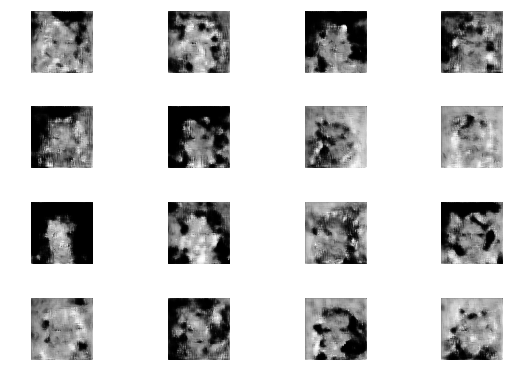

0: [D loss: 0.795782, acc: 0.500000] [A loss: 0.823514, acc: 0.250000]
1: [D loss: 0.701179, acc: 0.500000] [A loss: 0.764278, acc: 0.484375]
2: [D loss: 0.679265, acc: 0.562500] [A loss: 0.665157, acc: 0.546875]
3: [D loss: 1.620791, acc: 0.492188] [A loss: 0.474697, acc: 0.765625]
4: [D loss: 1.065960, acc: 0.476562] [A loss: 0.824182, acc: 0.203125]
5: [D loss: 0.745314, acc: 0.476562] [A loss: 0.768211, acc: 0.265625]
6: [D loss: 0.694858, acc: 0.585938] [A loss: 0.653267, acc: 0.500000]
7: [D loss: 0.882562, acc: 0.476562] [A loss: 0.777302, acc: 0.281250]
8: [D loss: 0.803755, acc: 0.445312] [A loss: 0.767096, acc: 0.328125]
9: [D loss: 0.778577, acc: 0.523438] [A loss: 0.795159, acc: 0.203125]
10: [D loss: 0.733356, acc: 0.468750] [A loss: 0.777290, acc: 0.328125]
11: [D loss: 0.739004, acc: 0.531250] [A loss: 0.698803, acc: 0.484375]
12: [D loss: 0.821452, acc: 0.445312] [A loss: 0.748388, acc: 0.468750]
13: [D loss: 0.664133, acc: 0.640625] [A loss: 0.700027, acc: 0.531250]
14

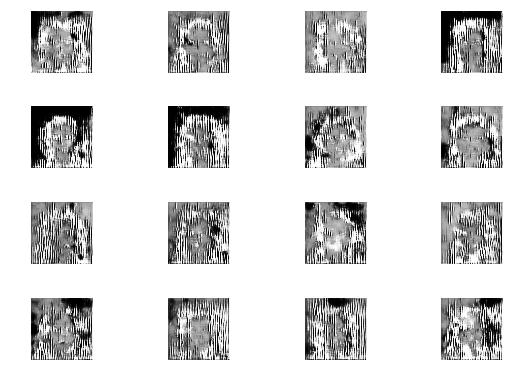

0: [D loss: 0.156808, acc: 0.976562] [A loss: 1.726272, acc: 0.171875]
1: [D loss: 0.069535, acc: 0.984375] [A loss: 0.712423, acc: 0.578125]
2: [D loss: 0.131906, acc: 0.960938] [A loss: 1.433131, acc: 0.375000]
3: [D loss: 0.126747, acc: 0.976562] [A loss: 1.836801, acc: 0.250000]
4: [D loss: 0.074365, acc: 0.968750] [A loss: 0.872143, acc: 0.609375]
5: [D loss: 0.196755, acc: 0.937500] [A loss: 3.605320, acc: 0.000000]
6: [D loss: 0.655116, acc: 0.718750] [A loss: 0.003715, acc: 1.000000]
7: [D loss: 2.239923, acc: 0.640625] [A loss: 1.735592, acc: 0.156250]
8: [D loss: 0.241548, acc: 0.906250] [A loss: 0.481005, acc: 0.750000]
9: [D loss: 0.767080, acc: 0.773438] [A loss: 1.813209, acc: 0.125000]
10: [D loss: 0.336323, acc: 0.851562] [A loss: 0.806913, acc: 0.593750]
11: [D loss: 0.724617, acc: 0.726562] [A loss: 2.860623, acc: 0.000000]
12: [D loss: 0.774454, acc: 0.617188] [A loss: 0.186974, acc: 0.953125]
13: [D loss: 1.027710, acc: 0.664062] [A loss: 1.631073, acc: 0.078125]
14

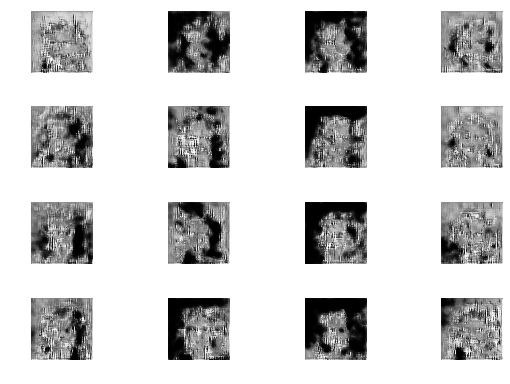

0: [D loss: 0.285746, acc: 0.960938] [A loss: 0.002319, acc: 1.000000]
1: [D loss: 0.226215, acc: 1.000000] [A loss: 0.023641, acc: 0.984375]
2: [D loss: 0.209387, acc: 0.984375] [A loss: 0.000000, acc: 1.000000]
3: [D loss: 0.105209, acc: 1.000000] [A loss: 0.006165, acc: 1.000000]
4: [D loss: 0.074074, acc: 0.992188] [A loss: 0.000654, acc: 1.000000]
5: [D loss: 0.088487, acc: 0.968750] [A loss: 0.065367, acc: 0.984375]
6: [D loss: 0.322723, acc: 0.929688] [A loss: 2.357219, acc: 0.671875]
7: [D loss: 0.107906, acc: 0.960938] [A loss: 0.203515, acc: 0.968750]
8: [D loss: 0.027482, acc: 1.000000] [A loss: 0.168153, acc: 0.968750]
9: [D loss: 0.223510, acc: 0.953125] [A loss: 8.987062, acc: 0.140625]
10: [D loss: 0.057002, acc: 0.984375] [A loss: 2.682964, acc: 0.671875]
11: [D loss: 0.076531, acc: 0.960938] [A loss: 1.685849, acc: 0.765625]
12: [D loss: 0.210978, acc: 0.945312] [A loss: 12.362067, acc: 0.062500]
13: [D loss: 0.009267, acc: 1.000000] [A loss: 4.671995, acc: 0.406250]
1

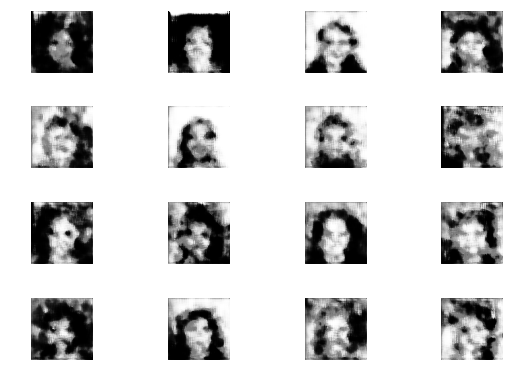

0: [D loss: 0.726739, acc: 0.484375] [A loss: 0.802913, acc: 0.343750]
1: [D loss: 0.704398, acc: 0.500000] [A loss: 0.727788, acc: 0.390625]
2: [D loss: 0.745047, acc: 0.468750] [A loss: 0.797620, acc: 0.296875]
3: [D loss: 0.771097, acc: 0.398438] [A loss: 0.792147, acc: 0.390625]
4: [D loss: 0.744900, acc: 0.500000] [A loss: 0.740292, acc: 0.421875]
5: [D loss: 0.721466, acc: 0.476562] [A loss: 0.786711, acc: 0.421875]
6: [D loss: 0.717343, acc: 0.437500] [A loss: 0.808022, acc: 0.281250]
7: [D loss: 0.687114, acc: 0.578125] [A loss: 0.808870, acc: 0.312500]
8: [D loss: 0.723469, acc: 0.507812] [A loss: 0.747658, acc: 0.421875]
9: [D loss: 0.770055, acc: 0.453125] [A loss: 0.842088, acc: 0.156250]
10: [D loss: 0.700869, acc: 0.515625] [A loss: 0.787339, acc: 0.406250]
11: [D loss: 0.702996, acc: 0.523438] [A loss: 0.767533, acc: 0.453125]
12: [D loss: 0.688251, acc: 0.593750] [A loss: 0.659990, acc: 0.562500]
13: [D loss: 0.761247, acc: 0.468750] [A loss: 0.852765, acc: 0.171875]
14

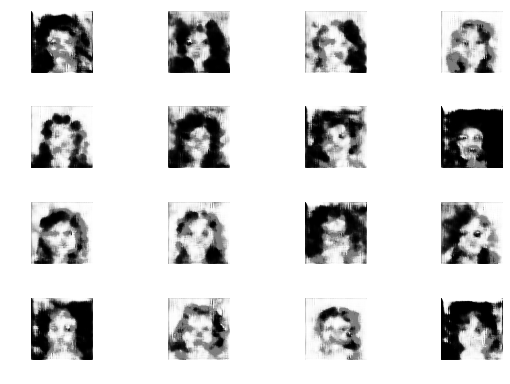

0: [D loss: 0.736882, acc: 0.492188] [A loss: 0.972365, acc: 0.187500]
1: [D loss: 0.746074, acc: 0.500000] [A loss: 0.792522, acc: 0.375000]
2: [D loss: 0.797444, acc: 0.523438] [A loss: 0.968532, acc: 0.171875]
3: [D loss: 0.754981, acc: 0.515625] [A loss: 0.945815, acc: 0.171875]
4: [D loss: 0.704230, acc: 0.554688] [A loss: 0.778047, acc: 0.328125]
5: [D loss: 0.808140, acc: 0.484375] [A loss: 0.919160, acc: 0.156250]
6: [D loss: 0.744695, acc: 0.484375] [A loss: 0.936901, acc: 0.140625]
7: [D loss: 0.695243, acc: 0.539062] [A loss: 0.891682, acc: 0.203125]
8: [D loss: 0.740321, acc: 0.468750] [A loss: 0.817727, acc: 0.234375]
9: [D loss: 0.738532, acc: 0.453125] [A loss: 0.837460, acc: 0.171875]
10: [D loss: 0.731180, acc: 0.507812] [A loss: 0.671815, acc: 0.531250]
11: [D loss: 0.813738, acc: 0.453125] [A loss: 1.205991, acc: 0.000000]
12: [D loss: 0.736784, acc: 0.500000] [A loss: 0.879167, acc: 0.093750]
13: [D loss: 0.674087, acc: 0.578125] [A loss: 0.763841, acc: 0.328125]
14

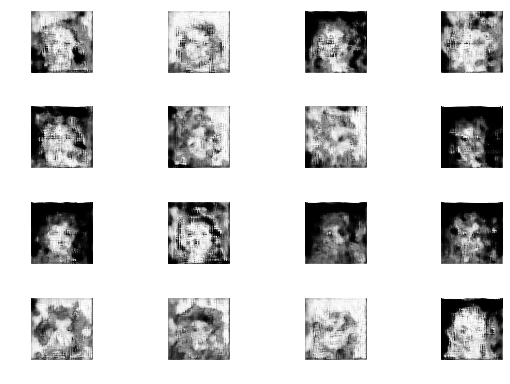

0: [D loss: 0.747642, acc: 0.476562] [A loss: 0.945736, acc: 0.015625]
1: [D loss: 0.721023, acc: 0.484375] [A loss: 0.827235, acc: 0.203125]
2: [D loss: 0.709871, acc: 0.554688] [A loss: 0.834355, acc: 0.203125]
3: [D loss: 0.693903, acc: 0.515625] [A loss: 0.780125, acc: 0.375000]
4: [D loss: 0.734748, acc: 0.539062] [A loss: 0.900645, acc: 0.093750]
5: [D loss: 0.702931, acc: 0.492188] [A loss: 0.906261, acc: 0.046875]
6: [D loss: 0.704828, acc: 0.492188] [A loss: 0.752597, acc: 0.390625]
7: [D loss: 0.726513, acc: 0.476562] [A loss: 0.784293, acc: 0.343750]
8: [D loss: 0.712197, acc: 0.492188] [A loss: 0.782098, acc: 0.406250]
9: [D loss: 0.714766, acc: 0.507812] [A loss: 0.819218, acc: 0.203125]
10: [D loss: 0.709035, acc: 0.507812] [A loss: 0.767322, acc: 0.343750]
11: [D loss: 0.716563, acc: 0.515625] [A loss: 0.789999, acc: 0.359375]
12: [D loss: 0.713214, acc: 0.539062] [A loss: 0.756505, acc: 0.390625]
13: [D loss: 0.730805, acc: 0.476562] [A loss: 0.735379, acc: 0.406250]
14

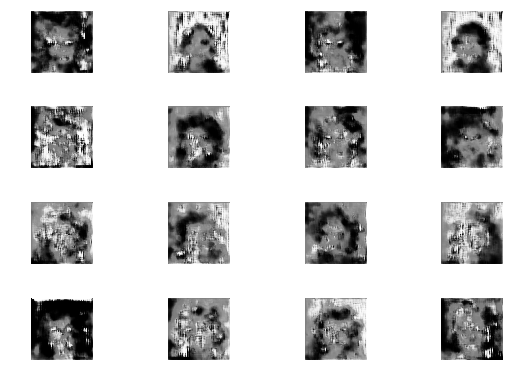

0: [D loss: 0.728144, acc: 0.500000] [A loss: 0.843754, acc: 0.250000]
1: [D loss: 0.713957, acc: 0.484375] [A loss: 0.763694, acc: 0.359375]
2: [D loss: 0.714948, acc: 0.515625] [A loss: 0.798119, acc: 0.234375]
3: [D loss: 0.707415, acc: 0.468750] [A loss: 0.784216, acc: 0.312500]
4: [D loss: 0.698620, acc: 0.500000] [A loss: 0.752953, acc: 0.375000]
5: [D loss: 0.722399, acc: 0.476562] [A loss: 0.716747, acc: 0.484375]
6: [D loss: 0.724876, acc: 0.492188] [A loss: 0.735857, acc: 0.406250]
7: [D loss: 0.792961, acc: 0.460938] [A loss: 0.953213, acc: 0.015625]
8: [D loss: 0.710819, acc: 0.507812] [A loss: 0.790673, acc: 0.312500]
9: [D loss: 0.721030, acc: 0.468750] [A loss: 0.791162, acc: 0.296875]
10: [D loss: 0.741186, acc: 0.445312] [A loss: 0.785783, acc: 0.343750]
11: [D loss: 0.699531, acc: 0.546875] [A loss: 0.730427, acc: 0.343750]
12: [D loss: 0.697158, acc: 0.578125] [A loss: 0.855062, acc: 0.234375]
13: [D loss: 0.691766, acc: 0.554688] [A loss: 0.787021, acc: 0.328125]
14

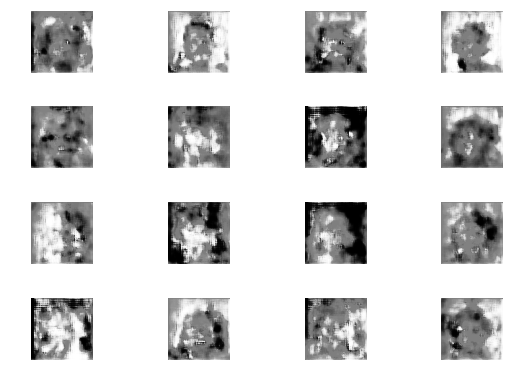

0: [D loss: 0.714134, acc: 0.539062] [A loss: 0.824550, acc: 0.312500]
1: [D loss: 0.743029, acc: 0.476562] [A loss: 0.793876, acc: 0.406250]
2: [D loss: 0.684372, acc: 0.539062] [A loss: 0.725686, acc: 0.421875]
3: [D loss: 0.787722, acc: 0.437500] [A loss: 0.843435, acc: 0.187500]
4: [D loss: 0.705407, acc: 0.500000] [A loss: 0.747381, acc: 0.375000]
5: [D loss: 0.682183, acc: 0.523438] [A loss: 0.682441, acc: 0.531250]
6: [D loss: 0.743911, acc: 0.453125] [A loss: 0.826975, acc: 0.281250]
7: [D loss: 0.715345, acc: 0.500000] [A loss: 0.759012, acc: 0.343750]
8: [D loss: 0.741325, acc: 0.437500] [A loss: 0.755041, acc: 0.390625]
9: [D loss: 0.753705, acc: 0.468750] [A loss: 0.828095, acc: 0.296875]
10: [D loss: 0.696637, acc: 0.546875] [A loss: 0.809624, acc: 0.343750]
11: [D loss: 0.730505, acc: 0.492188] [A loss: 0.830229, acc: 0.218750]
12: [D loss: 0.696826, acc: 0.531250] [A loss: 0.669769, acc: 0.609375]
13: [D loss: 0.705302, acc: 0.570312] [A loss: 0.669495, acc: 0.625000]
14

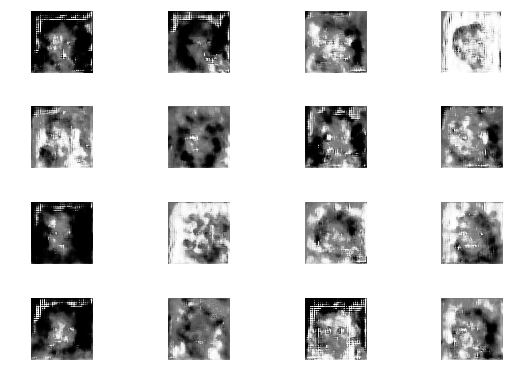

0: [D loss: 0.747446, acc: 0.460938] [A loss: 0.777583, acc: 0.375000]
1: [D loss: 0.862020, acc: 0.468750] [A loss: 0.832830, acc: 0.171875]
2: [D loss: 0.717430, acc: 0.453125] [A loss: 0.766466, acc: 0.312500]
3: [D loss: 0.694832, acc: 0.539062] [A loss: 0.738588, acc: 0.421875]
4: [D loss: 1.245801, acc: 0.484375] [A loss: 1.028595, acc: 0.015625]
5: [D loss: 0.714282, acc: 0.507812] [A loss: 0.821458, acc: 0.187500]
6: [D loss: 0.689106, acc: 0.515625] [A loss: 0.750594, acc: 0.453125]
7: [D loss: 0.718809, acc: 0.484375] [A loss: 0.795208, acc: 0.343750]
8: [D loss: 0.728828, acc: 0.421875] [A loss: 0.760117, acc: 0.375000]
9: [D loss: 0.774829, acc: 0.398438] [A loss: 0.874728, acc: 0.140625]
10: [D loss: 0.707503, acc: 0.507812] [A loss: 0.678009, acc: 0.578125]
11: [D loss: 0.740640, acc: 0.500000] [A loss: 0.791923, acc: 0.281250]
12: [D loss: 0.726862, acc: 0.523438] [A loss: 0.804543, acc: 0.312500]
13: [D loss: 0.735416, acc: 0.437500] [A loss: 0.810681, acc: 0.312500]
14

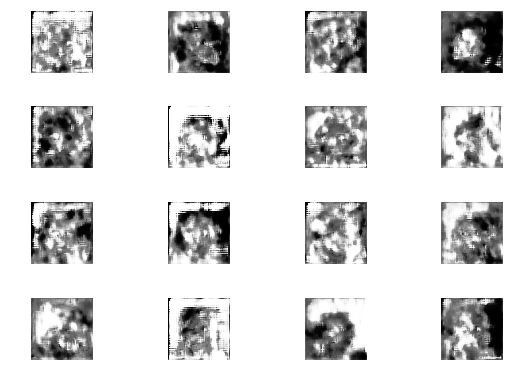

0: [D loss: 0.731520, acc: 0.460938] [A loss: 0.826007, acc: 0.140625]
1: [D loss: 0.750084, acc: 0.484375] [A loss: 0.761245, acc: 0.343750]
2: [D loss: 0.714481, acc: 0.468750] [A loss: 0.761495, acc: 0.296875]
3: [D loss: 0.759719, acc: 0.390625] [A loss: 0.844236, acc: 0.171875]
4: [D loss: 0.722571, acc: 0.476562] [A loss: 0.767424, acc: 0.265625]
5: [D loss: 0.745164, acc: 0.492188] [A loss: 0.758115, acc: 0.343750]
6: [D loss: 0.723646, acc: 0.468750] [A loss: 0.778390, acc: 0.296875]
7: [D loss: 0.729791, acc: 0.460938] [A loss: 0.763645, acc: 0.281250]
8: [D loss: 1.086878, acc: 0.507812] [A loss: 0.944569, acc: 0.015625]
9: [D loss: 0.727043, acc: 0.492188] [A loss: 0.847659, acc: 0.125000]
10: [D loss: 0.882249, acc: 0.476562] [A loss: 0.753984, acc: 0.437500]
11: [D loss: 0.795385, acc: 0.515625] [A loss: 0.879451, acc: 0.015625]
12: [D loss: 0.708209, acc: 0.500000] [A loss: 0.805138, acc: 0.234375]
13: [D loss: 0.708408, acc: 0.460938] [A loss: 0.767679, acc: 0.359375]
14

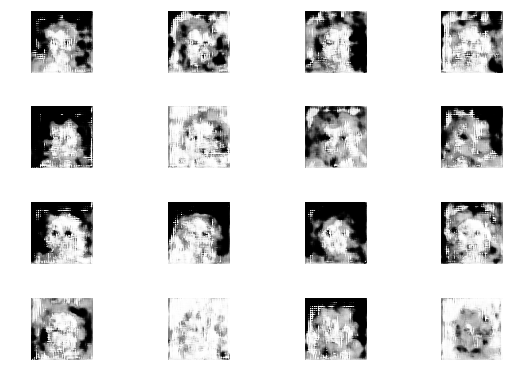

0: [D loss: 0.729076, acc: 0.492188] [A loss: 0.840852, acc: 0.156250]
1: [D loss: 0.797296, acc: 0.515625] [A loss: 0.894810, acc: 0.031250]
2: [D loss: 0.707510, acc: 0.468750] [A loss: 0.809064, acc: 0.171875]
3: [D loss: 4.103961, acc: 0.523438] [A loss: 1.098756, acc: 0.000000]
4: [D loss: 0.744625, acc: 0.500000] [A loss: 1.035457, acc: 0.000000]
5: [D loss: 0.731710, acc: 0.500000] [A loss: 0.963147, acc: 0.000000]
6: [D loss: 0.723787, acc: 0.515625] [A loss: 0.930564, acc: 0.000000]
7: [D loss: 0.735753, acc: 0.445312] [A loss: 0.888657, acc: 0.000000]
8: [D loss: 0.712793, acc: 0.437500] [A loss: 0.797857, acc: 0.296875]
9: [D loss: 0.730575, acc: 0.507812] [A loss: 0.815403, acc: 0.265625]
10: [D loss: 0.713707, acc: 0.546875] [A loss: 0.768371, acc: 0.296875]
11: [D loss: 0.863297, acc: 0.421875] [A loss: 0.846763, acc: 0.109375]
12: [D loss: 0.679558, acc: 0.523438] [A loss: 0.733741, acc: 0.265625]
13: [D loss: 3.403017, acc: 0.484375] [A loss: 1.065416, acc: 0.000000]
14

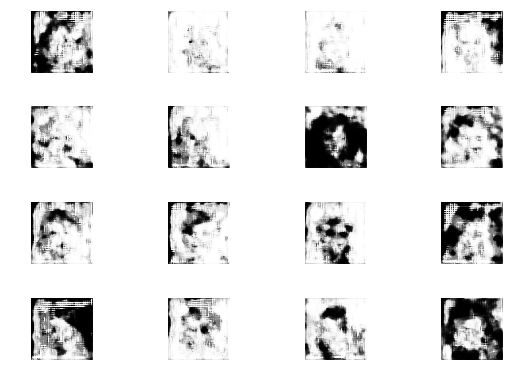

0: [D loss: 0.699147, acc: 0.523438] [A loss: 0.719122, acc: 0.468750]
1: [D loss: 0.929375, acc: 0.500000] [A loss: 0.848634, acc: 0.093750]
2: [D loss: 0.713206, acc: 0.468750] [A loss: 0.791918, acc: 0.296875]
3: [D loss: 0.749656, acc: 0.390625] [A loss: 0.852598, acc: 0.046875]
4: [D loss: 0.802790, acc: 0.476562] [A loss: 0.886756, acc: 0.031250]
5: [D loss: 0.739107, acc: 0.375000] [A loss: 0.862115, acc: 0.093750]
6: [D loss: 0.776442, acc: 0.421875] [A loss: 0.922107, acc: 0.000000]
7: [D loss: 0.710288, acc: 0.445312] [A loss: 0.854248, acc: 0.156250]
8: [D loss: 0.705249, acc: 0.476562] [A loss: 1.006212, acc: 0.046875]
9: [D loss: 0.715732, acc: 0.429688] [A loss: 0.846108, acc: 0.156250]
10: [D loss: 0.707302, acc: 0.507812] [A loss: 0.813623, acc: 0.296875]
11: [D loss: 0.790261, acc: 0.468750] [A loss: 0.823673, acc: 0.156250]
12: [D loss: 0.759143, acc: 0.406250] [A loss: 0.936441, acc: 0.000000]
13: [D loss: 0.736765, acc: 0.437500] [A loss: 0.927728, acc: 0.000000]
14

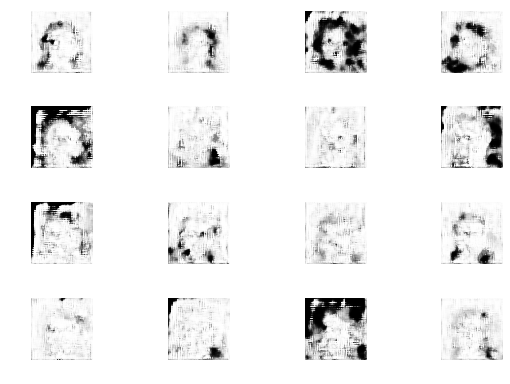

0: [D loss: 0.713428, acc: 0.414062] [A loss: 0.822667, acc: 0.218750]
1: [D loss: 0.719401, acc: 0.492188] [A loss: 0.690338, acc: 0.343750]
2: [D loss: 5.335364, acc: 0.531250] [A loss: 1.010566, acc: 0.000000]
3: [D loss: 0.730638, acc: 0.500000] [A loss: 0.965868, acc: 0.000000]
4: [D loss: 0.727873, acc: 0.500000] [A loss: 0.958157, acc: 0.000000]
5: [D loss: 0.724858, acc: 0.476562] [A loss: 0.884603, acc: 0.000000]
6: [D loss: 0.698249, acc: 0.468750] [A loss: 0.873228, acc: 0.046875]
7: [D loss: 0.721045, acc: 0.429688] [A loss: 0.830036, acc: 0.156250]
8: [D loss: 4.030980, acc: 0.515625] [A loss: 0.981460, acc: 0.000000]
9: [D loss: 0.724153, acc: 0.507812] [A loss: 0.943403, acc: 0.000000]
10: [D loss: 0.789201, acc: 0.500000] [A loss: 0.901319, acc: 0.015625]
11: [D loss: 0.920919, acc: 0.476562] [A loss: 0.848789, acc: 0.093750]
12: [D loss: 0.743263, acc: 0.437500] [A loss: 0.884575, acc: 0.015625]
13: [D loss: 0.714643, acc: 0.445312] [A loss: 0.778791, acc: 0.281250]
14

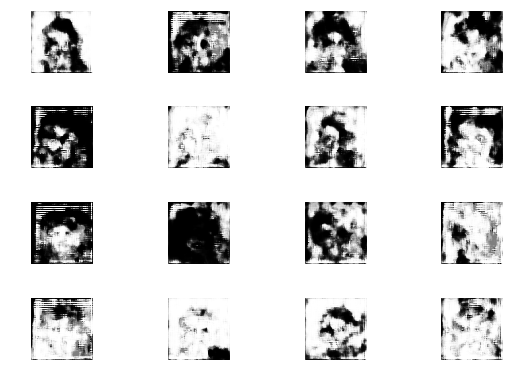

0: [D loss: 0.730531, acc: 0.460938] [A loss: 0.786486, acc: 0.281250]
1: [D loss: 0.713624, acc: 0.468750] [A loss: 0.851616, acc: 0.296875]
2: [D loss: 0.732044, acc: 0.500000] [A loss: 0.900238, acc: 0.265625]
3: [D loss: 0.710478, acc: 0.492188] [A loss: 0.711271, acc: 0.421875]
4: [D loss: 0.756709, acc: 0.492188] [A loss: 0.863128, acc: 0.140625]
5: [D loss: 0.721351, acc: 0.429688] [A loss: 0.797220, acc: 0.234375]
6: [D loss: 0.733886, acc: 0.445312] [A loss: 0.859362, acc: 0.046875]
7: [D loss: 0.748481, acc: 0.359375] [A loss: 1.173284, acc: 0.000000]
8: [D loss: 0.717688, acc: 0.460938] [A loss: 0.889250, acc: 0.000000]
9: [D loss: 0.735034, acc: 0.429688] [A loss: 0.891537, acc: 0.015625]
10: [D loss: 0.719417, acc: 0.398438] [A loss: 0.836645, acc: 0.125000]
11: [D loss: 0.722778, acc: 0.421875] [A loss: 0.908788, acc: 0.000000]
12: [D loss: 0.725192, acc: 0.421875] [A loss: 0.901761, acc: 0.000000]
13: [D loss: 0.873446, acc: 0.375000] [A loss: 0.877247, acc: 0.000000]
14

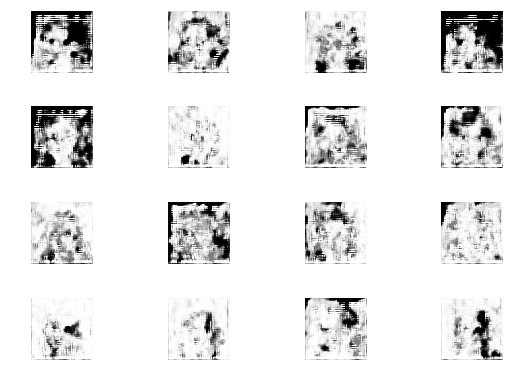

0: [D loss: 0.725183, acc: 0.476562] [A loss: 0.859281, acc: 0.015625]
1: [D loss: 0.719121, acc: 0.359375] [A loss: 0.846645, acc: 0.000000]
2: [D loss: 0.761085, acc: 0.359375] [A loss: 0.871625, acc: 0.000000]
3: [D loss: 0.725345, acc: 0.421875] [A loss: 0.913491, acc: 0.000000]
4: [D loss: 0.703103, acc: 0.515625] [A loss: 0.855311, acc: 0.015625]
5: [D loss: 1.284200, acc: 0.343750] [A loss: 0.987067, acc: 0.000000]
6: [D loss: 0.745805, acc: 0.492188] [A loss: 0.872278, acc: 0.000000]
7: [D loss: 0.723031, acc: 0.398438] [A loss: 0.842511, acc: 0.015625]
8: [D loss: 1.021592, acc: 0.367188] [A loss: 0.937682, acc: 0.000000]
9: [D loss: 0.708917, acc: 0.507812] [A loss: 0.858091, acc: 0.015625]
10: [D loss: 0.825950, acc: 0.328125] [A loss: 0.951145, acc: 0.031250]
11: [D loss: 0.790800, acc: 0.500000] [A loss: 0.860216, acc: 0.015625]
12: [D loss: 0.723187, acc: 0.351562] [A loss: 0.836356, acc: 0.046875]
13: [D loss: 0.713160, acc: 0.351562] [A loss: 0.827761, acc: 0.046875]
14

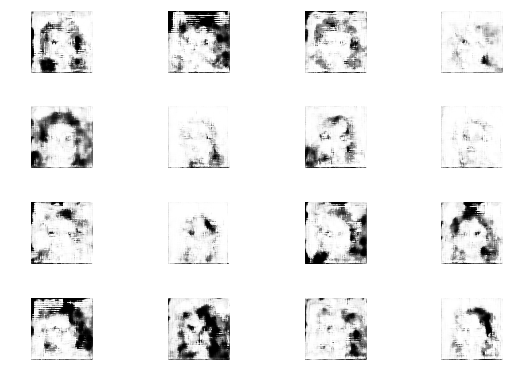

0: [D loss: 0.768052, acc: 0.484375] [A loss: 0.860646, acc: 0.078125]
1: [D loss: 0.723826, acc: 0.429688] [A loss: 0.815737, acc: 0.187500]
2: [D loss: 0.838163, acc: 0.445312] [A loss: 0.606486, acc: 0.421875]
3: [D loss: 3.496076, acc: 0.484375] [A loss: 0.936255, acc: 0.000000]
4: [D loss: 0.718562, acc: 0.500000] [A loss: 0.932899, acc: 0.000000]
5: [D loss: 0.710836, acc: 0.507812] [A loss: 0.921822, acc: 0.000000]
6: [D loss: 0.706619, acc: 0.507812] [A loss: 0.908011, acc: 0.015625]
7: [D loss: 0.719495, acc: 0.484375] [A loss: 0.877055, acc: 0.093750]
8: [D loss: 0.840308, acc: 0.437500] [A loss: 0.872603, acc: 0.062500]
9: [D loss: 0.709458, acc: 0.445312] [A loss: 0.839252, acc: 0.218750]
10: [D loss: 0.706408, acc: 0.484375] [A loss: 0.822170, acc: 0.171875]
11: [D loss: 0.729583, acc: 0.500000] [A loss: 0.833806, acc: 0.187500]
12: [D loss: 0.707894, acc: 0.546875] [A loss: 1.646386, acc: 0.109375]
13: [D loss: 1.320343, acc: 0.398438] [A loss: 0.911343, acc: 0.015625]
14

KeyboardInterrupt: ignored

In [0]:

faces = np.array(faces)
for j in range(10000):
  #x_train = []
    
  #for f in cats_im[np.random.randint(0, cats_im.shape[0], size=1000)]:
  #   x_train.append(cv2.resize((cv2.imread(f) / 255), (256, 	256), interpolation = cv2.INTER_AREA))
 
  y_train = []
    
  for f in faces[np.random.randint(0, faces.shape[0], size=1000)]:
    im = cv2.resize((cv2.imread('faces/img_align_celeba/' + f, cv2.IMREAD_GRAYSCALE) / 255), (256, 256), interpolation = cv2.INTER_AREA)
    im.reshape((256, 256, 1))
    y_train.append(im)

  mnist_dcgan.x_train = np.array(y_train)
  #mnist_dcgan.y_train = np.array(y_train)
  
  mnist_dcgan.train(train_steps=100, batch_size=64, save_interval=1000)
  mnist_dcgan.plot_images(fake=True) 
  mnist_dcgan.plot_images(fake=True, save2file=True) 
  #mnist_dcgan.plot_images(fake=False, save2file=True)
  mnist_dcgan.generator.save('gen.h5')
  #files.download('my_model.h5')

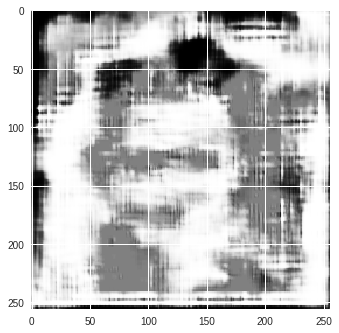

In [0]:
im = mnist_dcgan.generator.predict(np.random.uniform(-1.0, 1.0, size=[1, 300]))
plt.imshow(im[0].reshape(256, 256), cmap='gray')

In [0]:
os.mkdir('tmp_res')

In [0]:
import shutil 

for i in range(0,140):
  st = 'tmp_res/!faces{}.png'.format(i)
  shutil.move(st, "tmp_res")

In [0]:
mnist_dcgan.generator.save('gen_p.h5')
  

In [0]:
import zipfile

with zipfile.ZipFile('!res.zip', 'w') as myzip: 
  for f in os.listdir('tmp_res'):
    myzip.write('tmp_res/'+f)

0: [D loss: 0.652671, acc: 0.687500] [A loss: 0.868882, acc: 0.437500]
1: [D loss: 0.580299, acc: 0.718750] [A loss: 1.204246, acc: 0.375000]
2: [D loss: 0.931212, acc: 0.500000] [A loss: 0.869428, acc: 0.562500]
3: [D loss: 0.799813, acc: 0.593750] [A loss: 0.979852, acc: 0.312500]
4: [D loss: 0.683540, acc: 0.625000] [A loss: 1.042300, acc: 0.312500]
5: [D loss: 0.617132, acc: 0.656250] [A loss: 1.309258, acc: 0.437500]
6: [D loss: 0.994310, acc: 0.468750] [A loss: 1.354171, acc: 0.125000]
7: [D loss: 0.941593, acc: 0.437500] [A loss: 0.831669, acc: 0.500000]
8: [D loss: 0.841292, acc: 0.500000] [A loss: 1.421591, acc: 0.312500]
9: [D loss: 0.632743, acc: 0.687500] [A loss: 1.218564, acc: 0.437500]
10: [D loss: 0.865328, acc: 0.468750] [A loss: 1.248074, acc: 0.375000]
11: [D loss: 0.657205, acc: 0.718750] [A loss: 1.016770, acc: 0.500000]
12: [D loss: 0.559801, acc: 0.656250] [A loss: 1.115077, acc: 0.437500]
13: [D loss: 0.884414, acc: 0.500000] [A loss: 0.998422, acc: 0.437500]
14

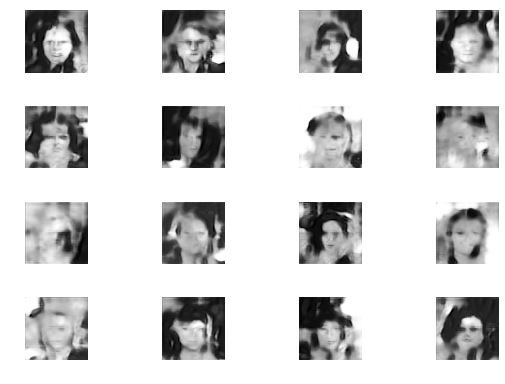

0: [D loss: 0.641625, acc: 0.687500] [A loss: 1.295109, acc: 0.250000]
1: [D loss: 0.641062, acc: 0.750000] [A loss: 1.379623, acc: 0.250000]
2: [D loss: 0.746010, acc: 0.750000] [A loss: 1.636771, acc: 0.187500]
3: [D loss: 0.559494, acc: 0.687500] [A loss: 1.570910, acc: 0.062500]
4: [D loss: 0.490331, acc: 0.750000] [A loss: 1.963475, acc: 0.062500]
5: [D loss: 0.991709, acc: 0.593750] [A loss: 1.985445, acc: 0.000000]
6: [D loss: 0.538325, acc: 0.750000] [A loss: 2.102510, acc: 0.062500]
7: [D loss: 0.652363, acc: 0.656250] [A loss: 1.677138, acc: 0.250000]
8: [D loss: 0.587046, acc: 0.593750] [A loss: 1.974452, acc: 0.125000]
9: [D loss: 0.703923, acc: 0.656250] [A loss: 1.902804, acc: 0.125000]
10: [D loss: 0.718054, acc: 0.593750] [A loss: 1.913600, acc: 0.125000]
11: [D loss: 0.493315, acc: 0.750000] [A loss: 2.135640, acc: 0.062500]
12: [D loss: 0.573468, acc: 0.718750] [A loss: 2.648018, acc: 0.000000]
13: [D loss: 0.498360, acc: 0.687500] [A loss: 1.983967, acc: 0.187500]
14

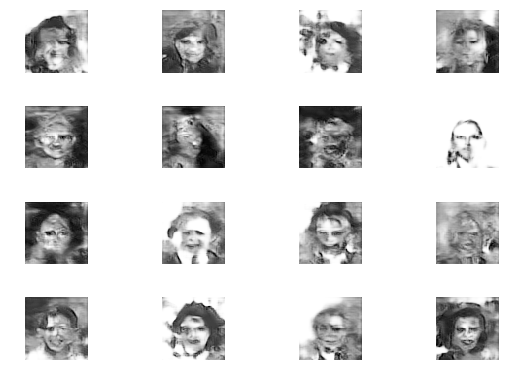

0: [D loss: 0.871901, acc: 0.562500] [A loss: 1.677383, acc: 0.187500]
1: [D loss: 0.945586, acc: 0.500000] [A loss: 1.210060, acc: 0.250000]
2: [D loss: 0.952420, acc: 0.468750] [A loss: 1.349195, acc: 0.187500]
3: [D loss: 0.779158, acc: 0.531250] [A loss: 1.587100, acc: 0.187500]
4: [D loss: 0.747186, acc: 0.687500] [A loss: 1.747923, acc: 0.250000]
5: [D loss: 0.618172, acc: 0.656250] [A loss: 1.630544, acc: 0.125000]
6: [D loss: 0.901042, acc: 0.625000] [A loss: 1.686648, acc: 0.250000]
7: [D loss: 0.754698, acc: 0.593750] [A loss: 1.910747, acc: 0.062500]
8: [D loss: 0.864669, acc: 0.468750] [A loss: 1.732285, acc: 0.187500]
9: [D loss: 0.775988, acc: 0.500000] [A loss: 1.842279, acc: 0.125000]
10: [D loss: 0.760087, acc: 0.625000] [A loss: 1.204741, acc: 0.375000]
11: [D loss: 0.740617, acc: 0.593750] [A loss: 1.434260, acc: 0.187500]
12: [D loss: 0.938113, acc: 0.531250] [A loss: 1.401683, acc: 0.062500]
13: [D loss: 0.514245, acc: 0.656250] [A loss: 2.527371, acc: 0.000000]
14

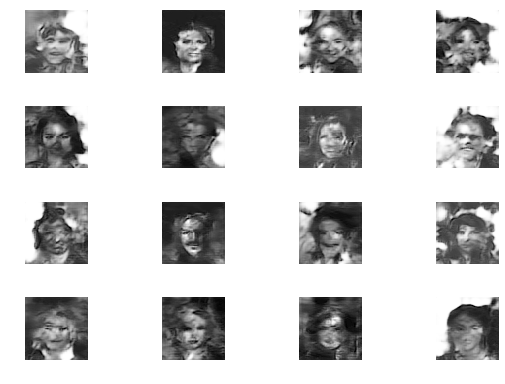

0: [D loss: 0.832471, acc: 0.593750] [A loss: 1.549255, acc: 0.187500]
1: [D loss: 0.738666, acc: 0.593750] [A loss: 1.533168, acc: 0.312500]
2: [D loss: 0.864082, acc: 0.500000] [A loss: 1.188207, acc: 0.125000]
3: [D loss: 0.802256, acc: 0.562500] [A loss: 1.166270, acc: 0.437500]
4: [D loss: 0.826325, acc: 0.562500] [A loss: 1.233701, acc: 0.062500]
5: [D loss: 1.026038, acc: 0.531250] [A loss: 1.224139, acc: 0.250000]
6: [D loss: 0.842702, acc: 0.593750] [A loss: 1.521408, acc: 0.250000]
7: [D loss: 0.609339, acc: 0.656250] [A loss: 1.088411, acc: 0.500000]
8: [D loss: 0.731838, acc: 0.625000] [A loss: 1.328496, acc: 0.250000]
9: [D loss: 0.656118, acc: 0.718750] [A loss: 1.257303, acc: 0.250000]
10: [D loss: 0.844650, acc: 0.437500] [A loss: 1.420002, acc: 0.187500]
11: [D loss: 0.686710, acc: 0.687500] [A loss: 1.119527, acc: 0.437500]
12: [D loss: 0.776351, acc: 0.562500] [A loss: 1.134058, acc: 0.125000]
13: [D loss: 0.698305, acc: 0.593750] [A loss: 0.987291, acc: 0.250000]
14

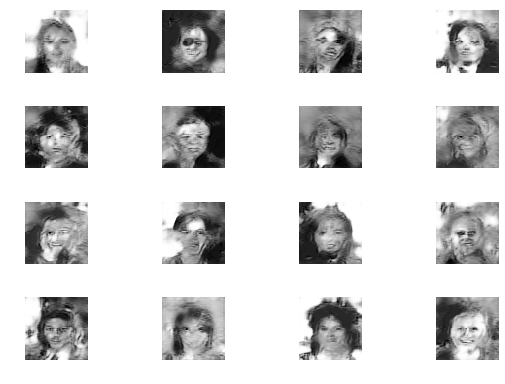

0: [D loss: 0.861140, acc: 0.468750] [A loss: 1.856168, acc: 0.312500]
1: [D loss: 0.697183, acc: 0.625000] [A loss: 1.204324, acc: 0.250000]
2: [D loss: 0.599198, acc: 0.593750] [A loss: 1.053909, acc: 0.375000]
3: [D loss: 0.663433, acc: 0.687500] [A loss: 1.018756, acc: 0.437500]
4: [D loss: 0.856937, acc: 0.500000] [A loss: 0.791520, acc: 0.562500]
5: [D loss: 0.828624, acc: 0.593750] [A loss: 0.972569, acc: 0.250000]
6: [D loss: 0.913895, acc: 0.500000] [A loss: 1.095271, acc: 0.312500]
7: [D loss: 1.003491, acc: 0.468750] [A loss: 1.533288, acc: 0.187500]
8: [D loss: 0.774864, acc: 0.531250] [A loss: 2.055444, acc: 0.000000]
9: [D loss: 0.670249, acc: 0.562500] [A loss: 1.781077, acc: 0.187500]
10: [D loss: 0.651487, acc: 0.656250] [A loss: 1.639793, acc: 0.250000]
11: [D loss: 0.666704, acc: 0.593750] [A loss: 2.089516, acc: 0.125000]
12: [D loss: 0.761828, acc: 0.500000] [A loss: 1.581703, acc: 0.312500]
13: [D loss: 0.884498, acc: 0.500000] [A loss: 1.686229, acc: 0.187500]
14

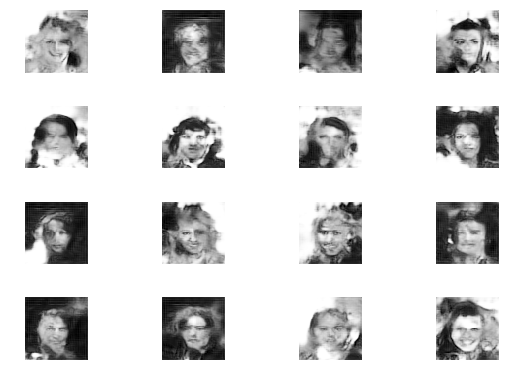

0: [D loss: 0.866087, acc: 0.562500] [A loss: 1.749028, acc: 0.250000]
1: [D loss: 0.490691, acc: 0.718750] [A loss: 2.246125, acc: 0.062500]
2: [D loss: 0.914068, acc: 0.468750] [A loss: 2.162467, acc: 0.000000]
3: [D loss: 0.813261, acc: 0.593750] [A loss: 2.193941, acc: 0.062500]
4: [D loss: 0.720029, acc: 0.531250] [A loss: 1.456858, acc: 0.187500]
5: [D loss: 0.867085, acc: 0.531250] [A loss: 2.050547, acc: 0.062500]
6: [D loss: 0.588869, acc: 0.750000] [A loss: 1.491286, acc: 0.250000]
7: [D loss: 0.892406, acc: 0.562500] [A loss: 1.754336, acc: 0.062500]
8: [D loss: 0.828320, acc: 0.531250] [A loss: 1.901540, acc: 0.125000]
9: [D loss: 0.746760, acc: 0.593750] [A loss: 1.544997, acc: 0.062500]
10: [D loss: 0.699710, acc: 0.625000] [A loss: 1.926508, acc: 0.125000]
11: [D loss: 0.639151, acc: 0.687500] [A loss: 0.939073, acc: 0.500000]
12: [D loss: 1.031155, acc: 0.343750] [A loss: 1.406987, acc: 0.187500]
13: [D loss: 1.006955, acc: 0.500000] [A loss: 1.211802, acc: 0.250000]
14

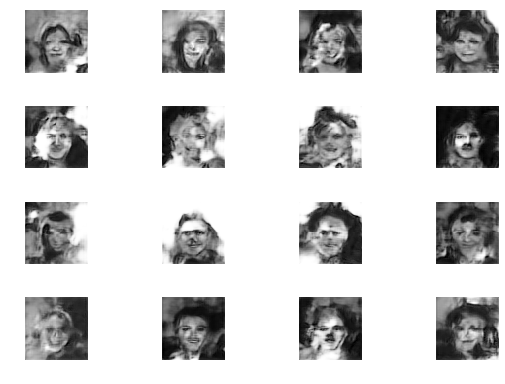

0: [D loss: 0.631956, acc: 0.656250] [A loss: 2.092585, acc: 0.062500]
1: [D loss: 0.766802, acc: 0.687500] [A loss: 2.222027, acc: 0.000000]
2: [D loss: 0.671858, acc: 0.593750] [A loss: 2.091593, acc: 0.000000]
3: [D loss: 0.654108, acc: 0.593750] [A loss: 2.202420, acc: 0.000000]
4: [D loss: 0.609657, acc: 0.687500] [A loss: 1.941028, acc: 0.000000]
5: [D loss: 0.734493, acc: 0.625000] [A loss: 1.543529, acc: 0.250000]
6: [D loss: 0.751420, acc: 0.656250] [A loss: 2.228219, acc: 0.125000]
7: [D loss: 0.675014, acc: 0.718750] [A loss: 2.348531, acc: 0.000000]
8: [D loss: 0.855902, acc: 0.593750] [A loss: 2.472708, acc: 0.000000]
9: [D loss: 0.602244, acc: 0.718750] [A loss: 2.592657, acc: 0.000000]
10: [D loss: 0.729126, acc: 0.531250] [A loss: 1.317984, acc: 0.250000]
11: [D loss: 0.779006, acc: 0.687500] [A loss: 1.258201, acc: 0.187500]
12: [D loss: 0.606104, acc: 0.656250] [A loss: 1.278105, acc: 0.187500]
13: [D loss: 0.932053, acc: 0.625000] [A loss: 1.877126, acc: 0.125000]
14

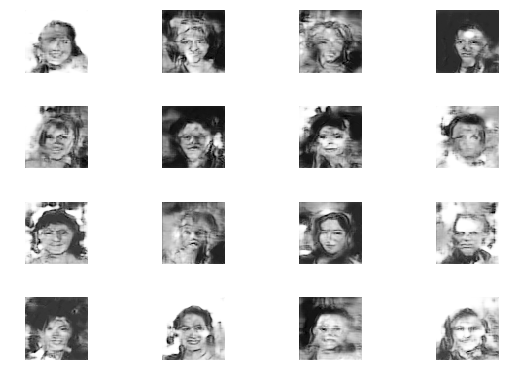

0: [D loss: 0.578422, acc: 0.593750] [A loss: 1.270700, acc: 0.437500]
1: [D loss: 0.716736, acc: 0.656250] [A loss: 1.172804, acc: 0.250000]
2: [D loss: 0.860042, acc: 0.562500] [A loss: 1.851645, acc: 0.187500]
3: [D loss: 0.957995, acc: 0.500000] [A loss: 1.755962, acc: 0.125000]
4: [D loss: 0.657526, acc: 0.656250] [A loss: 1.907583, acc: 0.250000]
5: [D loss: 0.822287, acc: 0.625000] [A loss: 2.077337, acc: 0.125000]
6: [D loss: 0.712386, acc: 0.625000] [A loss: 2.502524, acc: 0.187500]
7: [D loss: 0.799789, acc: 0.500000] [A loss: 1.736640, acc: 0.187500]
8: [D loss: 0.644931, acc: 0.656250] [A loss: 1.392571, acc: 0.187500]
9: [D loss: 0.838531, acc: 0.468750] [A loss: 1.250251, acc: 0.375000]
10: [D loss: 1.150561, acc: 0.437500] [A loss: 0.730019, acc: 0.750000]
11: [D loss: 0.916558, acc: 0.593750] [A loss: 0.949275, acc: 0.437500]
12: [D loss: 0.783513, acc: 0.593750] [A loss: 1.271690, acc: 0.500000]
13: [D loss: 0.605482, acc: 0.718750] [A loss: 1.546451, acc: 0.187500]
14

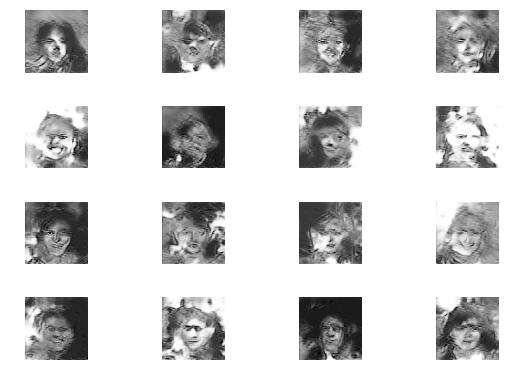

0: [D loss: 0.770847, acc: 0.531250] [A loss: 0.925587, acc: 0.375000]
1: [D loss: 0.658295, acc: 0.687500] [A loss: 1.418886, acc: 0.312500]
2: [D loss: 0.666966, acc: 0.562500] [A loss: 1.093616, acc: 0.250000]
3: [D loss: 0.910264, acc: 0.593750] [A loss: 0.917268, acc: 0.437500]
4: [D loss: 0.747957, acc: 0.625000] [A loss: 1.662456, acc: 0.125000]
5: [D loss: 0.714310, acc: 0.625000] [A loss: 2.288981, acc: 0.187500]
6: [D loss: 0.525467, acc: 0.812500] [A loss: 2.465406, acc: 0.000000]
7: [D loss: 0.468705, acc: 0.812500] [A loss: 1.850951, acc: 0.125000]
8: [D loss: 0.713695, acc: 0.593750] [A loss: 1.675324, acc: 0.125000]
9: [D loss: 0.675346, acc: 0.625000] [A loss: 1.753182, acc: 0.125000]
10: [D loss: 0.945363, acc: 0.531250] [A loss: 1.909869, acc: 0.125000]
11: [D loss: 0.916839, acc: 0.500000] [A loss: 2.236355, acc: 0.000000]
12: [D loss: 0.815077, acc: 0.531250] [A loss: 2.266724, acc: 0.000000]
13: [D loss: 0.515100, acc: 0.718750] [A loss: 1.894268, acc: 0.062500]
14

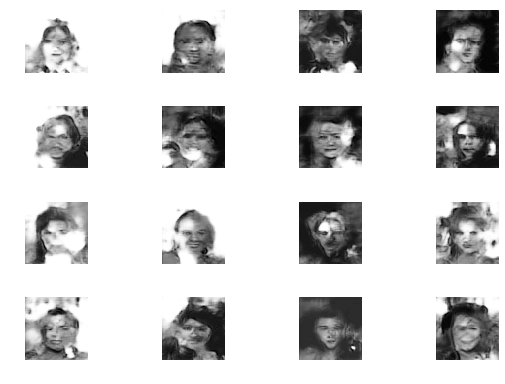

0: [D loss: 0.953130, acc: 0.468750] [A loss: 1.039756, acc: 0.250000]
1: [D loss: 0.681896, acc: 0.593750] [A loss: 0.974065, acc: 0.437500]
2: [D loss: 0.773892, acc: 0.625000] [A loss: 1.005442, acc: 0.500000]
3: [D loss: 0.805343, acc: 0.406250] [A loss: 1.256488, acc: 0.062500]
4: [D loss: 0.705413, acc: 0.593750] [A loss: 1.246616, acc: 0.375000]
5: [D loss: 0.770142, acc: 0.625000] [A loss: 1.604149, acc: 0.062500]
6: [D loss: 0.891202, acc: 0.406250] [A loss: 1.108137, acc: 0.187500]
7: [D loss: 0.769399, acc: 0.531250] [A loss: 1.166991, acc: 0.312500]
8: [D loss: 0.738890, acc: 0.531250] [A loss: 0.922633, acc: 0.437500]
9: [D loss: 0.703603, acc: 0.656250] [A loss: 0.851864, acc: 0.312500]
10: [D loss: 0.778679, acc: 0.625000] [A loss: 1.186756, acc: 0.312500]
11: [D loss: 0.684392, acc: 0.468750] [A loss: 1.611379, acc: 0.187500]
12: [D loss: 0.596995, acc: 0.718750] [A loss: 1.196102, acc: 0.375000]
13: [D loss: 0.784386, acc: 0.500000] [A loss: 1.502971, acc: 0.187500]
14

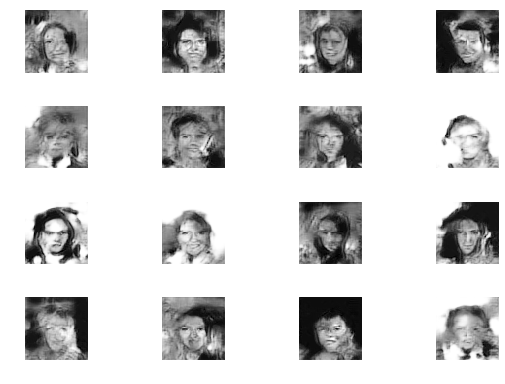

0: [D loss: 0.770794, acc: 0.625000] [A loss: 1.466381, acc: 0.187500]
1: [D loss: 0.676056, acc: 0.593750] [A loss: 1.360230, acc: 0.187500]
2: [D loss: 0.795538, acc: 0.593750] [A loss: 1.810630, acc: 0.125000]
3: [D loss: 0.873969, acc: 0.375000] [A loss: 1.528598, acc: 0.250000]
4: [D loss: 0.804394, acc: 0.500000] [A loss: 1.430100, acc: 0.250000]
5: [D loss: 0.500783, acc: 0.718750] [A loss: 1.033204, acc: 0.375000]
6: [D loss: 0.641871, acc: 0.625000] [A loss: 1.344434, acc: 0.187500]
7: [D loss: 0.783972, acc: 0.531250] [A loss: 0.964130, acc: 0.562500]
8: [D loss: 0.831375, acc: 0.531250] [A loss: 1.446412, acc: 0.312500]
9: [D loss: 0.966239, acc: 0.500000] [A loss: 1.256021, acc: 0.250000]
10: [D loss: 0.858622, acc: 0.562500] [A loss: 0.807318, acc: 0.375000]
11: [D loss: 0.695798, acc: 0.625000] [A loss: 1.361147, acc: 0.187500]
12: [D loss: 0.833220, acc: 0.531250] [A loss: 0.945261, acc: 0.375000]
13: [D loss: 0.872808, acc: 0.468750] [A loss: 1.291062, acc: 0.312500]
14

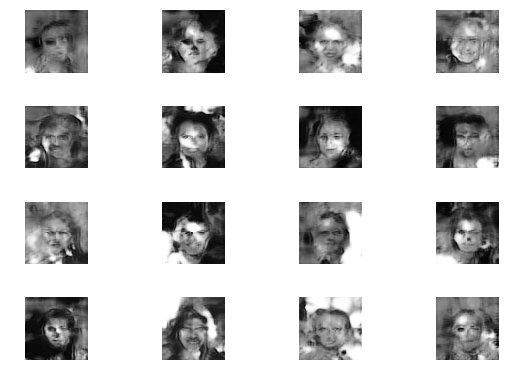

0: [D loss: 0.664398, acc: 0.625000] [A loss: 1.721762, acc: 0.125000]
1: [D loss: 0.684149, acc: 0.562500] [A loss: 1.879808, acc: 0.125000]
2: [D loss: 1.006491, acc: 0.468750] [A loss: 2.062382, acc: 0.062500]
3: [D loss: 0.656529, acc: 0.656250] [A loss: 1.603696, acc: 0.062500]
4: [D loss: 0.758739, acc: 0.531250] [A loss: 1.375981, acc: 0.250000]
5: [D loss: 0.752566, acc: 0.562500] [A loss: 1.016266, acc: 0.312500]
6: [D loss: 0.723865, acc: 0.593750] [A loss: 0.977815, acc: 0.437500]
7: [D loss: 0.984645, acc: 0.406250] [A loss: 0.899526, acc: 0.437500]
8: [D loss: 0.917528, acc: 0.406250] [A loss: 1.252383, acc: 0.375000]
9: [D loss: 0.634951, acc: 0.718750] [A loss: 1.145942, acc: 0.312500]
10: [D loss: 0.759003, acc: 0.468750] [A loss: 1.403938, acc: 0.125000]
11: [D loss: 0.913909, acc: 0.468750] [A loss: 1.572653, acc: 0.187500]
12: [D loss: 1.009653, acc: 0.437500] [A loss: 1.407266, acc: 0.187500]
13: [D loss: 0.743932, acc: 0.656250] [A loss: 1.231220, acc: 0.125000]
14

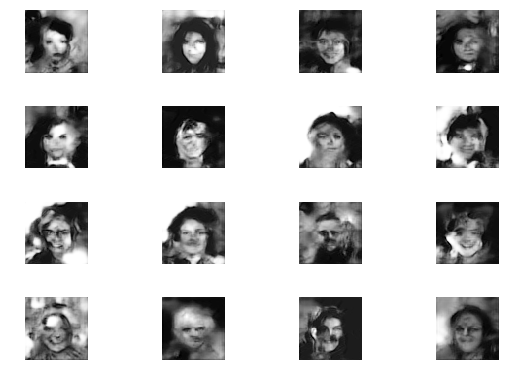

0: [D loss: 0.849465, acc: 0.687500] [A loss: 1.109907, acc: 0.312500]
1: [D loss: 0.570771, acc: 0.718750] [A loss: 1.278832, acc: 0.187500]
2: [D loss: 0.692478, acc: 0.562500] [A loss: 1.213260, acc: 0.125000]
3: [D loss: 0.654237, acc: 0.562500] [A loss: 1.269311, acc: 0.125000]
4: [D loss: 0.740590, acc: 0.750000] [A loss: 1.661155, acc: 0.062500]
5: [D loss: 0.575301, acc: 0.687500] [A loss: 1.512248, acc: 0.125000]
6: [D loss: 0.708364, acc: 0.656250] [A loss: 1.100328, acc: 0.375000]
7: [D loss: 0.589903, acc: 0.687500] [A loss: 1.214427, acc: 0.312500]
8: [D loss: 0.743145, acc: 0.656250] [A loss: 1.313692, acc: 0.250000]
9: [D loss: 0.822817, acc: 0.625000] [A loss: 1.298564, acc: 0.250000]
10: [D loss: 0.732228, acc: 0.656250] [A loss: 1.119179, acc: 0.312500]
11: [D loss: 0.683523, acc: 0.593750] [A loss: 1.382742, acc: 0.187500]
12: [D loss: 0.879839, acc: 0.625000] [A loss: 1.431882, acc: 0.187500]
13: [D loss: 1.059841, acc: 0.406250] [A loss: 1.606359, acc: 0.062500]
14

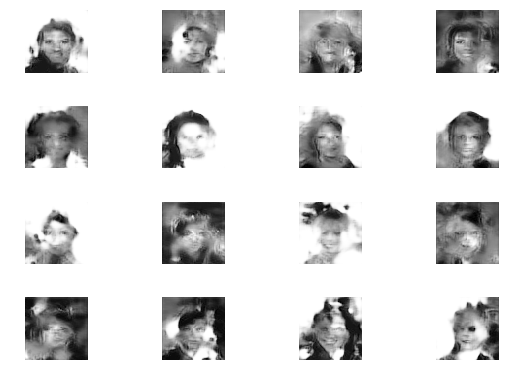

0: [D loss: 0.859624, acc: 0.625000] [A loss: 1.673915, acc: 0.312500]
1: [D loss: 0.820177, acc: 0.625000] [A loss: 1.722173, acc: 0.125000]
2: [D loss: 0.820484, acc: 0.531250] [A loss: 2.030602, acc: 0.062500]
3: [D loss: 0.873090, acc: 0.500000] [A loss: 2.338055, acc: 0.062500]
4: [D loss: 0.868755, acc: 0.562500] [A loss: 1.577909, acc: 0.250000]
5: [D loss: 0.920661, acc: 0.531250] [A loss: 1.669919, acc: 0.062500]
6: [D loss: 0.777492, acc: 0.625000] [A loss: 1.999088, acc: 0.000000]
7: [D loss: 0.855524, acc: 0.562500] [A loss: 1.392835, acc: 0.062500]
8: [D loss: 0.693544, acc: 0.562500] [A loss: 1.280831, acc: 0.250000]
9: [D loss: 0.952213, acc: 0.468750] [A loss: 1.534130, acc: 0.062500]
10: [D loss: 0.824412, acc: 0.593750] [A loss: 1.774708, acc: 0.000000]
11: [D loss: 0.717452, acc: 0.593750] [A loss: 1.816270, acc: 0.000000]
12: [D loss: 0.732572, acc: 0.562500] [A loss: 1.549526, acc: 0.187500]
13: [D loss: 0.678632, acc: 0.562500] [A loss: 1.359200, acc: 0.125000]
14

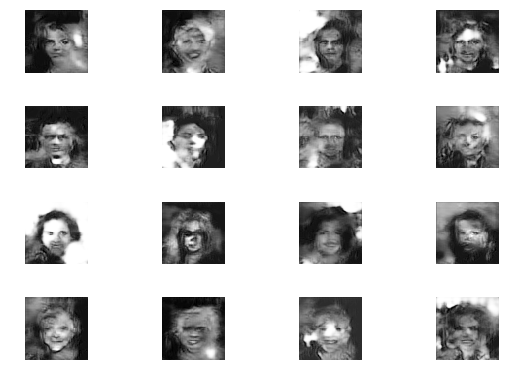

0: [D loss: 0.744904, acc: 0.562500] [A loss: 1.256552, acc: 0.250000]
1: [D loss: 0.732210, acc: 0.625000] [A loss: 1.300256, acc: 0.250000]
2: [D loss: 0.745366, acc: 0.468750] [A loss: 0.986872, acc: 0.375000]
3: [D loss: 0.696690, acc: 0.625000] [A loss: 1.311009, acc: 0.187500]
4: [D loss: 0.717889, acc: 0.625000] [A loss: 1.276273, acc: 0.187500]
5: [D loss: 0.640654, acc: 0.656250] [A loss: 1.297230, acc: 0.312500]
6: [D loss: 0.693835, acc: 0.625000] [A loss: 1.288041, acc: 0.250000]
7: [D loss: 0.860759, acc: 0.468750] [A loss: 1.428422, acc: 0.062500]
8: [D loss: 0.813631, acc: 0.593750] [A loss: 1.376427, acc: 0.250000]
9: [D loss: 0.764855, acc: 0.625000] [A loss: 1.725278, acc: 0.125000]
10: [D loss: 0.744920, acc: 0.656250] [A loss: 1.518283, acc: 0.125000]
11: [D loss: 0.681006, acc: 0.593750] [A loss: 1.647639, acc: 0.125000]
12: [D loss: 0.763129, acc: 0.593750] [A loss: 1.590297, acc: 0.187500]
13: [D loss: 0.676652, acc: 0.656250] [A loss: 1.579290, acc: 0.187500]
14

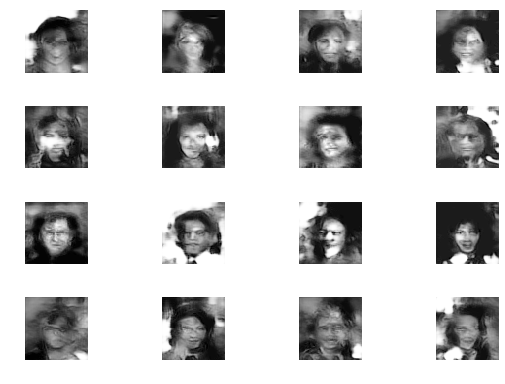

0: [D loss: 0.770535, acc: 0.468750] [A loss: 1.917588, acc: 0.062500]
1: [D loss: 0.836876, acc: 0.437500] [A loss: 1.148922, acc: 0.250000]
2: [D loss: 0.768477, acc: 0.593750] [A loss: 1.486039, acc: 0.187500]
3: [D loss: 0.801976, acc: 0.562500] [A loss: 1.420841, acc: 0.062500]
4: [D loss: 0.745786, acc: 0.531250] [A loss: 0.998561, acc: 0.562500]
5: [D loss: 1.028954, acc: 0.531250] [A loss: 1.314973, acc: 0.187500]
6: [D loss: 0.824643, acc: 0.468750] [A loss: 1.578360, acc: 0.125000]
7: [D loss: 0.781136, acc: 0.625000] [A loss: 1.238170, acc: 0.187500]
8: [D loss: 0.689524, acc: 0.593750] [A loss: 1.511190, acc: 0.062500]
9: [D loss: 0.750808, acc: 0.625000] [A loss: 1.596554, acc: 0.125000]
10: [D loss: 0.786280, acc: 0.593750] [A loss: 1.139148, acc: 0.312500]
11: [D loss: 0.841575, acc: 0.625000] [A loss: 1.385522, acc: 0.250000]
12: [D loss: 0.740096, acc: 0.625000] [A loss: 1.423864, acc: 0.250000]
13: [D loss: 0.744902, acc: 0.625000] [A loss: 1.059605, acc: 0.375000]
14

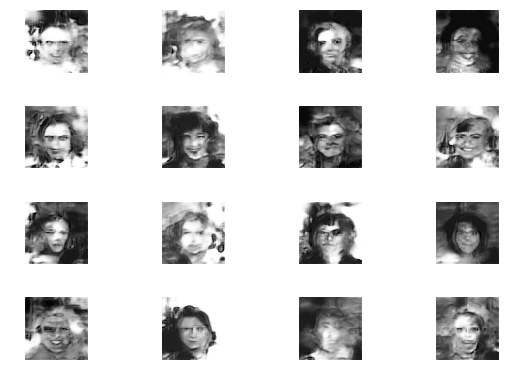

0: [D loss: 0.825708, acc: 0.500000] [A loss: 1.294553, acc: 0.250000]
1: [D loss: 0.707398, acc: 0.656250] [A loss: 1.615903, acc: 0.062500]
2: [D loss: 0.880834, acc: 0.500000] [A loss: 1.826370, acc: 0.000000]
3: [D loss: 0.730662, acc: 0.562500] [A loss: 1.375466, acc: 0.187500]
4: [D loss: 0.714362, acc: 0.656250] [A loss: 1.352923, acc: 0.062500]
5: [D loss: 0.797549, acc: 0.625000] [A loss: 1.353918, acc: 0.250000]
6: [D loss: 0.932377, acc: 0.593750] [A loss: 1.009037, acc: 0.375000]
7: [D loss: 0.890728, acc: 0.593750] [A loss: 1.250843, acc: 0.250000]
8: [D loss: 0.818975, acc: 0.500000] [A loss: 1.672914, acc: 0.187500]
9: [D loss: 0.799768, acc: 0.468750] [A loss: 1.566966, acc: 0.250000]
10: [D loss: 0.703680, acc: 0.593750] [A loss: 1.413218, acc: 0.125000]
11: [D loss: 0.554458, acc: 0.781250] [A loss: 1.334049, acc: 0.250000]
12: [D loss: 0.963122, acc: 0.437500] [A loss: 1.384520, acc: 0.250000]
13: [D loss: 0.812907, acc: 0.562500] [A loss: 1.039501, acc: 0.437500]
14

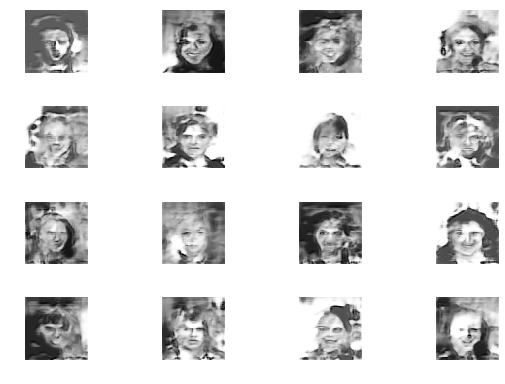

0: [D loss: 0.734832, acc: 0.531250] [A loss: 2.330704, acc: 0.187500]
1: [D loss: 0.784900, acc: 0.562500] [A loss: 2.624110, acc: 0.000000]
2: [D loss: 0.964041, acc: 0.500000] [A loss: 2.237549, acc: 0.062500]
3: [D loss: 0.836259, acc: 0.531250] [A loss: 3.068134, acc: 0.000000]
4: [D loss: 0.817348, acc: 0.437500] [A loss: 3.048364, acc: 0.000000]
5: [D loss: 0.606264, acc: 0.656250] [A loss: 3.039423, acc: 0.000000]
6: [D loss: 1.010337, acc: 0.531250] [A loss: 3.145102, acc: 0.000000]
7: [D loss: 0.611881, acc: 0.656250] [A loss: 2.368330, acc: 0.125000]
8: [D loss: 0.719111, acc: 0.531250] [A loss: 1.868344, acc: 0.125000]
9: [D loss: 0.882715, acc: 0.593750] [A loss: 2.569949, acc: 0.000000]
10: [D loss: 0.836444, acc: 0.437500] [A loss: 2.059432, acc: 0.062500]
11: [D loss: 1.053296, acc: 0.468750] [A loss: 4.399109, acc: 0.000000]
12: [D loss: 0.789787, acc: 0.468750] [A loss: 2.780478, acc: 0.000000]
13: [D loss: 1.012931, acc: 0.437500] [A loss: 2.621470, acc: 0.062500]
14

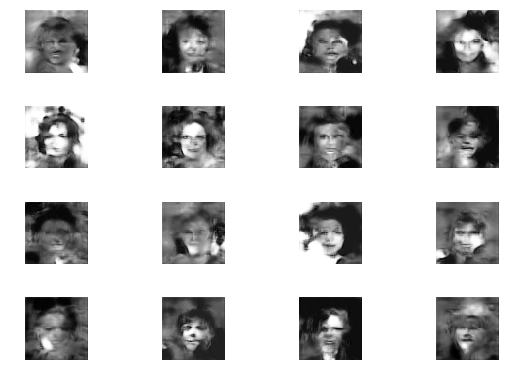

0: [D loss: 0.725923, acc: 0.656250] [A loss: 1.351999, acc: 0.125000]
1: [D loss: 1.125860, acc: 0.343750] [A loss: 1.308782, acc: 0.125000]
2: [D loss: 0.709048, acc: 0.656250] [A loss: 1.187548, acc: 0.187500]
3: [D loss: 0.821750, acc: 0.500000] [A loss: 1.477608, acc: 0.250000]
4: [D loss: 0.621463, acc: 0.718750] [A loss: 1.782068, acc: 0.062500]
5: [D loss: 0.762974, acc: 0.531250] [A loss: 1.498776, acc: 0.187500]
6: [D loss: 0.873723, acc: 0.500000] [A loss: 1.439184, acc: 0.187500]
7: [D loss: 0.596255, acc: 0.750000] [A loss: 1.542381, acc: 0.187500]
8: [D loss: 0.750586, acc: 0.531250] [A loss: 1.504806, acc: 0.062500]
9: [D loss: 0.766258, acc: 0.468750] [A loss: 1.112776, acc: 0.187500]
10: [D loss: 0.817395, acc: 0.593750] [A loss: 0.876495, acc: 0.375000]
11: [D loss: 0.669685, acc: 0.656250] [A loss: 0.898115, acc: 0.312500]
12: [D loss: 0.833421, acc: 0.562500] [A loss: 1.489352, acc: 0.062500]
13: [D loss: 0.934456, acc: 0.531250] [A loss: 1.085585, acc: 0.312500]
14

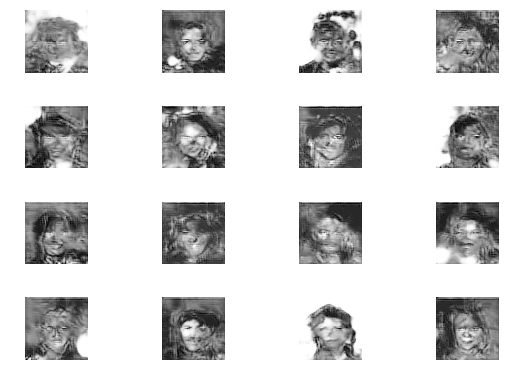

0: [D loss: 0.878764, acc: 0.500000] [A loss: 1.009796, acc: 0.437500]
1: [D loss: 0.837358, acc: 0.500000] [A loss: 1.612928, acc: 0.250000]
2: [D loss: 0.670573, acc: 0.593750] [A loss: 1.394311, acc: 0.250000]
3: [D loss: 0.832699, acc: 0.500000] [A loss: 1.353373, acc: 0.312500]
4: [D loss: 0.546915, acc: 0.781250] [A loss: 1.375705, acc: 0.250000]
5: [D loss: 0.923488, acc: 0.593750] [A loss: 1.567219, acc: 0.250000]
6: [D loss: 0.667733, acc: 0.593750] [A loss: 1.376675, acc: 0.312500]
7: [D loss: 0.616049, acc: 0.781250] [A loss: 1.100872, acc: 0.250000]
8: [D loss: 0.949149, acc: 0.468750] [A loss: 1.505337, acc: 0.375000]
9: [D loss: 0.667269, acc: 0.593750] [A loss: 2.361626, acc: 0.125000]
10: [D loss: 0.742971, acc: 0.625000] [A loss: 1.939797, acc: 0.250000]
11: [D loss: 0.690839, acc: 0.656250] [A loss: 1.957799, acc: 0.125000]
12: [D loss: 0.678808, acc: 0.593750] [A loss: 2.005687, acc: 0.125000]
13: [D loss: 0.567725, acc: 0.781250] [A loss: 2.413592, acc: 0.312500]
14

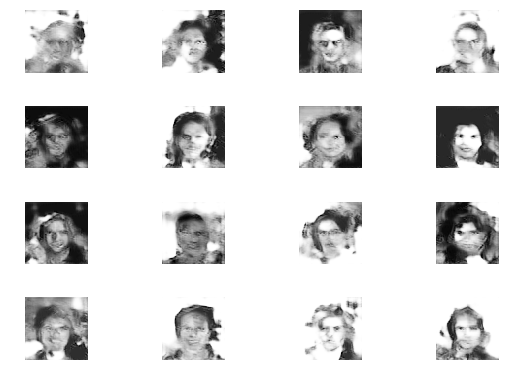

0: [D loss: 0.874803, acc: 0.562500] [A loss: 1.226862, acc: 0.250000]
1: [D loss: 0.912103, acc: 0.562500] [A loss: 1.254063, acc: 0.312500]
2: [D loss: 1.090394, acc: 0.343750] [A loss: 1.078828, acc: 0.312500]
3: [D loss: 0.788573, acc: 0.468750] [A loss: 1.116899, acc: 0.250000]
4: [D loss: 0.839895, acc: 0.562500] [A loss: 1.361248, acc: 0.187500]
5: [D loss: 0.550838, acc: 0.656250] [A loss: 1.177334, acc: 0.187500]
6: [D loss: 0.735152, acc: 0.625000] [A loss: 1.410471, acc: 0.187500]
7: [D loss: 0.794493, acc: 0.562500] [A loss: 1.181282, acc: 0.125000]
8: [D loss: 0.868435, acc: 0.500000] [A loss: 1.463367, acc: 0.187500]
9: [D loss: 0.788166, acc: 0.593750] [A loss: 1.621400, acc: 0.125000]
10: [D loss: 0.853102, acc: 0.531250] [A loss: 1.645837, acc: 0.062500]
11: [D loss: 0.612896, acc: 0.593750] [A loss: 1.303663, acc: 0.187500]
12: [D loss: 0.622009, acc: 0.625000] [A loss: 1.668039, acc: 0.125000]
13: [D loss: 0.784743, acc: 0.531250] [A loss: 1.589325, acc: 0.187500]
14

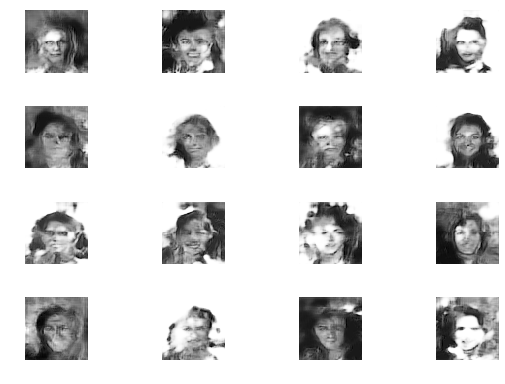

0: [D loss: 0.996564, acc: 0.531250] [A loss: 1.663265, acc: 0.187500]
1: [D loss: 0.936074, acc: 0.375000] [A loss: 1.197862, acc: 0.375000]
2: [D loss: 0.993287, acc: 0.437500] [A loss: 1.663152, acc: 0.250000]
3: [D loss: 0.870272, acc: 0.343750] [A loss: 0.969620, acc: 0.312500]
4: [D loss: 0.773306, acc: 0.593750] [A loss: 1.279883, acc: 0.312500]
5: [D loss: 0.899557, acc: 0.468750] [A loss: 0.974989, acc: 0.437500]
6: [D loss: 0.690733, acc: 0.531250] [A loss: 1.084050, acc: 0.250000]
7: [D loss: 0.886140, acc: 0.531250] [A loss: 1.110173, acc: 0.375000]
8: [D loss: 0.780314, acc: 0.562500] [A loss: 0.977276, acc: 0.375000]
9: [D loss: 0.939773, acc: 0.375000] [A loss: 1.392176, acc: 0.250000]
10: [D loss: 0.836492, acc: 0.531250] [A loss: 1.249867, acc: 0.250000]
11: [D loss: 0.654051, acc: 0.562500] [A loss: 1.062215, acc: 0.250000]
12: [D loss: 0.710238, acc: 0.656250] [A loss: 1.067466, acc: 0.312500]
13: [D loss: 0.793326, acc: 0.468750] [A loss: 1.134800, acc: 0.250000]
14

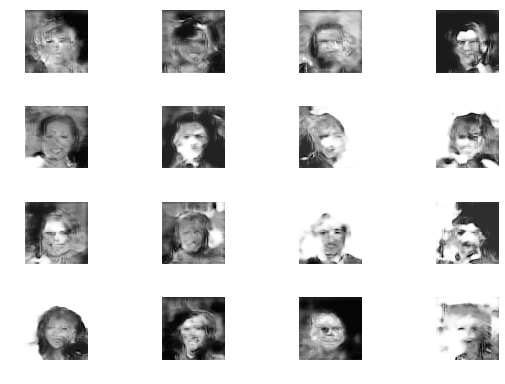

0: [D loss: 0.801758, acc: 0.593750] [A loss: 0.829902, acc: 0.437500]
1: [D loss: 0.897093, acc: 0.562500] [A loss: 1.122061, acc: 0.375000]
2: [D loss: 0.782568, acc: 0.562500] [A loss: 1.738292, acc: 0.000000]
3: [D loss: 0.873379, acc: 0.468750] [A loss: 1.195598, acc: 0.062500]
4: [D loss: 0.988125, acc: 0.343750] [A loss: 1.316686, acc: 0.187500]
5: [D loss: 0.799691, acc: 0.468750] [A loss: 1.274219, acc: 0.187500]
6: [D loss: 0.908267, acc: 0.468750] [A loss: 1.031562, acc: 0.375000]
7: [D loss: 0.729089, acc: 0.468750] [A loss: 1.024205, acc: 0.312500]
8: [D loss: 0.766232, acc: 0.500000] [A loss: 1.008918, acc: 0.250000]
9: [D loss: 0.918129, acc: 0.468750] [A loss: 1.014719, acc: 0.250000]
10: [D loss: 0.900122, acc: 0.375000] [A loss: 0.979675, acc: 0.437500]
11: [D loss: 0.850775, acc: 0.531250] [A loss: 1.064498, acc: 0.312500]
12: [D loss: 1.003077, acc: 0.343750] [A loss: 1.189779, acc: 0.250000]
13: [D loss: 0.776960, acc: 0.500000] [A loss: 1.374139, acc: 0.125000]
14

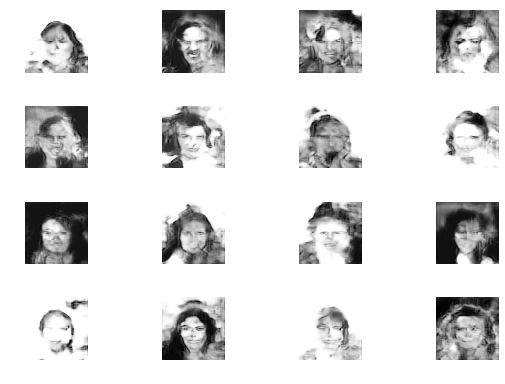

0: [D loss: 0.749210, acc: 0.593750] [A loss: 1.379709, acc: 0.187500]
1: [D loss: 1.068501, acc: 0.343750] [A loss: 1.311430, acc: 0.125000]
2: [D loss: 0.907415, acc: 0.437500] [A loss: 1.417499, acc: 0.312500]
3: [D loss: 0.792358, acc: 0.593750] [A loss: 1.394178, acc: 0.125000]
4: [D loss: 0.612566, acc: 0.750000] [A loss: 1.496566, acc: 0.000000]
5: [D loss: 0.792490, acc: 0.406250] [A loss: 1.651002, acc: 0.062500]
6: [D loss: 0.690171, acc: 0.656250] [A loss: 1.882603, acc: 0.062500]
7: [D loss: 0.832628, acc: 0.593750] [A loss: 1.195166, acc: 0.125000]
8: [D loss: 0.688233, acc: 0.625000] [A loss: 1.530303, acc: 0.250000]
9: [D loss: 0.675109, acc: 0.562500] [A loss: 1.547330, acc: 0.125000]
10: [D loss: 0.939596, acc: 0.406250] [A loss: 1.364194, acc: 0.312500]
11: [D loss: 0.773184, acc: 0.468750] [A loss: 2.462888, acc: 0.062500]
12: [D loss: 0.692952, acc: 0.500000] [A loss: 1.902446, acc: 0.062500]
13: [D loss: 0.764919, acc: 0.593750] [A loss: 1.673777, acc: 0.125000]
14

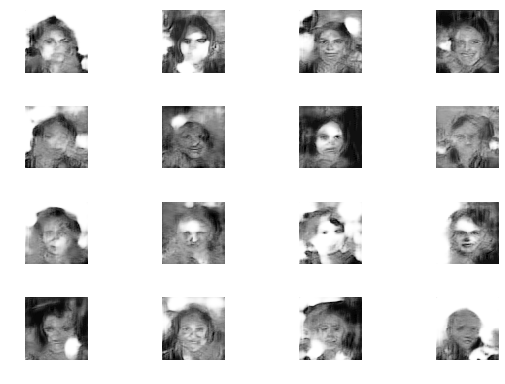

0: [D loss: 0.669969, acc: 0.656250] [A loss: 1.263215, acc: 0.125000]
1: [D loss: 0.812235, acc: 0.500000] [A loss: 0.945474, acc: 0.375000]
2: [D loss: 0.752001, acc: 0.531250] [A loss: 0.931675, acc: 0.375000]
3: [D loss: 0.694567, acc: 0.531250] [A loss: 0.995451, acc: 0.500000]
4: [D loss: 0.800081, acc: 0.593750] [A loss: 1.149751, acc: 0.250000]
5: [D loss: 0.704707, acc: 0.562500] [A loss: 1.022783, acc: 0.250000]
6: [D loss: 0.709945, acc: 0.562500] [A loss: 1.314015, acc: 0.250000]
7: [D loss: 0.875804, acc: 0.531250] [A loss: 1.384523, acc: 0.187500]
8: [D loss: 0.623557, acc: 0.625000] [A loss: 1.350250, acc: 0.312500]
9: [D loss: 0.790010, acc: 0.500000] [A loss: 1.034212, acc: 0.250000]
10: [D loss: 0.754096, acc: 0.593750] [A loss: 1.138949, acc: 0.312500]
11: [D loss: 0.678037, acc: 0.562500] [A loss: 0.812765, acc: 0.500000]
12: [D loss: 0.819165, acc: 0.500000] [A loss: 1.272057, acc: 0.062500]
13: [D loss: 0.878614, acc: 0.562500] [A loss: 0.806354, acc: 0.437500]
14

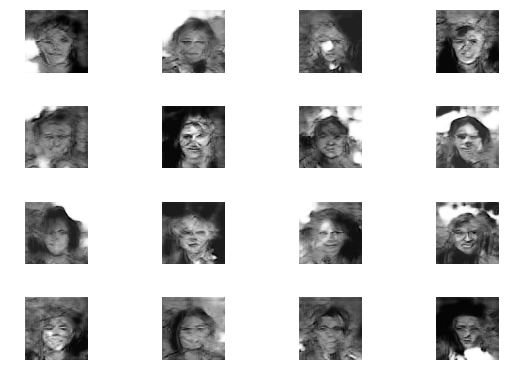

0: [D loss: 0.912052, acc: 0.593750] [A loss: 0.788866, acc: 0.500000]
1: [D loss: 0.830745, acc: 0.562500] [A loss: 1.333938, acc: 0.250000]
2: [D loss: 0.550627, acc: 0.718750] [A loss: 1.444631, acc: 0.062500]
3: [D loss: 0.746106, acc: 0.531250] [A loss: 1.195750, acc: 0.312500]
4: [D loss: 0.607814, acc: 0.750000] [A loss: 1.566437, acc: 0.062500]
5: [D loss: 0.909555, acc: 0.437500] [A loss: 1.309108, acc: 0.187500]
6: [D loss: 0.783427, acc: 0.500000] [A loss: 1.185759, acc: 0.250000]
7: [D loss: 0.819517, acc: 0.718750] [A loss: 1.250450, acc: 0.375000]
8: [D loss: 0.653429, acc: 0.625000] [A loss: 0.864669, acc: 0.500000]
9: [D loss: 0.603522, acc: 0.718750] [A loss: 1.007309, acc: 0.375000]
10: [D loss: 0.690842, acc: 0.625000] [A loss: 1.463376, acc: 0.125000]
11: [D loss: 0.893471, acc: 0.531250] [A loss: 1.902061, acc: 0.187500]
12: [D loss: 0.989956, acc: 0.437500] [A loss: 1.439380, acc: 0.125000]
13: [D loss: 0.944289, acc: 0.531250] [A loss: 1.411201, acc: 0.062500]
14

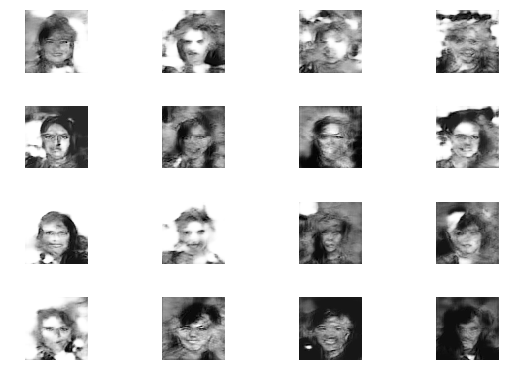

0: [D loss: 0.863658, acc: 0.406250] [A loss: 1.465212, acc: 0.125000]
1: [D loss: 0.877799, acc: 0.562500] [A loss: 1.305582, acc: 0.187500]
2: [D loss: 0.872771, acc: 0.500000] [A loss: 1.350877, acc: 0.125000]
3: [D loss: 0.918205, acc: 0.468750] [A loss: 0.931799, acc: 0.375000]
4: [D loss: 0.849409, acc: 0.531250] [A loss: 1.172516, acc: 0.312500]
5: [D loss: 0.866483, acc: 0.468750] [A loss: 1.410811, acc: 0.187500]
6: [D loss: 0.779262, acc: 0.625000] [A loss: 1.317112, acc: 0.312500]
7: [D loss: 0.795896, acc: 0.562500] [A loss: 1.066440, acc: 0.312500]
8: [D loss: 0.626299, acc: 0.750000] [A loss: 0.974519, acc: 0.125000]
9: [D loss: 0.794816, acc: 0.562500] [A loss: 1.620076, acc: 0.000000]
10: [D loss: 0.686141, acc: 0.625000] [A loss: 1.477467, acc: 0.187500]
11: [D loss: 0.549652, acc: 0.781250] [A loss: 1.223268, acc: 0.187500]
12: [D loss: 0.651873, acc: 0.718750] [A loss: 1.449151, acc: 0.187500]
13: [D loss: 0.812735, acc: 0.593750] [A loss: 1.306213, acc: 0.000000]
14

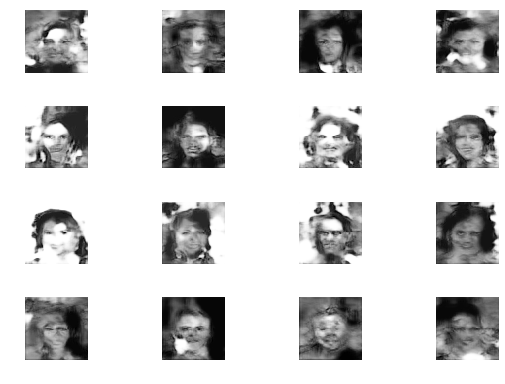

0: [D loss: 0.815227, acc: 0.500000] [A loss: 1.124030, acc: 0.312500]
1: [D loss: 0.738272, acc: 0.531250] [A loss: 0.919807, acc: 0.312500]
2: [D loss: 0.907549, acc: 0.656250] [A loss: 0.953796, acc: 0.375000]
3: [D loss: 0.890569, acc: 0.500000] [A loss: 0.992336, acc: 0.500000]
4: [D loss: 0.805391, acc: 0.562500] [A loss: 1.243148, acc: 0.312500]
5: [D loss: 0.768706, acc: 0.500000] [A loss: 1.144154, acc: 0.375000]
6: [D loss: 0.630066, acc: 0.718750] [A loss: 1.569676, acc: 0.312500]
7: [D loss: 0.544120, acc: 0.562500] [A loss: 0.934838, acc: 0.250000]
8: [D loss: 0.904976, acc: 0.406250] [A loss: 0.817876, acc: 0.437500]
9: [D loss: 0.765405, acc: 0.500000] [A loss: 0.954077, acc: 0.312500]
10: [D loss: 1.050747, acc: 0.343750] [A loss: 1.131652, acc: 0.187500]
11: [D loss: 0.866879, acc: 0.437500] [A loss: 1.261236, acc: 0.250000]
12: [D loss: 1.123601, acc: 0.281250] [A loss: 1.037083, acc: 0.312500]
13: [D loss: 0.696220, acc: 0.562500] [A loss: 1.295192, acc: 0.312500]
14

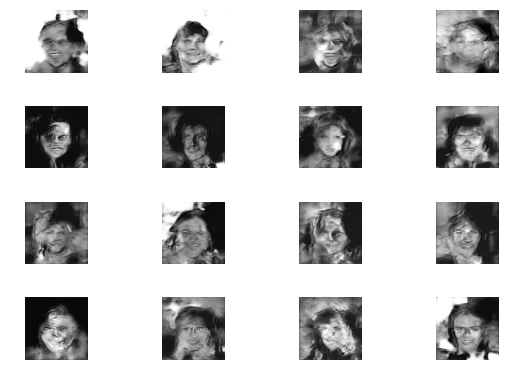

0: [D loss: 0.695027, acc: 0.656250] [A loss: 1.524761, acc: 0.000000]
1: [D loss: 0.820369, acc: 0.437500] [A loss: 1.610514, acc: 0.125000]
2: [D loss: 0.651309, acc: 0.531250] [A loss: 1.460632, acc: 0.000000]
3: [D loss: 0.911634, acc: 0.468750] [A loss: 1.851290, acc: 0.000000]
4: [D loss: 0.723536, acc: 0.656250] [A loss: 1.698107, acc: 0.125000]
5: [D loss: 0.758949, acc: 0.593750] [A loss: 1.331450, acc: 0.062500]
6: [D loss: 0.901206, acc: 0.531250] [A loss: 1.251281, acc: 0.187500]
7: [D loss: 0.802182, acc: 0.593750] [A loss: 1.293570, acc: 0.312500]
8: [D loss: 0.602735, acc: 0.687500] [A loss: 1.249333, acc: 0.125000]
9: [D loss: 0.684290, acc: 0.593750] [A loss: 1.016024, acc: 0.312500]
10: [D loss: 0.746667, acc: 0.500000] [A loss: 1.079465, acc: 0.250000]
11: [D loss: 0.961338, acc: 0.343750] [A loss: 1.091946, acc: 0.312500]
12: [D loss: 0.739954, acc: 0.500000] [A loss: 1.136554, acc: 0.187500]
13: [D loss: 0.687646, acc: 0.562500] [A loss: 1.209254, acc: 0.312500]
14

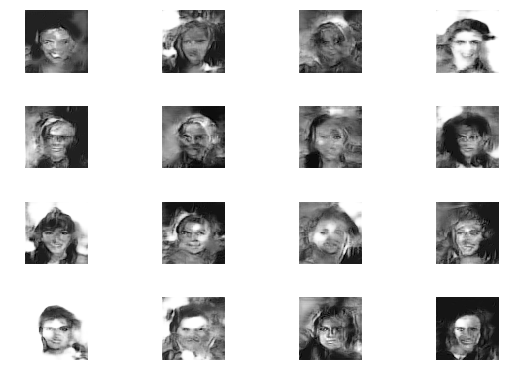

0: [D loss: 0.806872, acc: 0.562500] [A loss: 0.918446, acc: 0.250000]
1: [D loss: 0.682879, acc: 0.625000] [A loss: 1.042830, acc: 0.312500]
2: [D loss: 0.857186, acc: 0.562500] [A loss: 1.068928, acc: 0.187500]
3: [D loss: 0.829092, acc: 0.562500] [A loss: 1.209153, acc: 0.125000]
4: [D loss: 0.686689, acc: 0.625000] [A loss: 1.291309, acc: 0.250000]
5: [D loss: 0.811723, acc: 0.500000] [A loss: 1.530206, acc: 0.062500]
6: [D loss: 0.689518, acc: 0.656250] [A loss: 1.021806, acc: 0.187500]
7: [D loss: 0.779530, acc: 0.593750] [A loss: 1.101247, acc: 0.312500]
8: [D loss: 0.703395, acc: 0.656250] [A loss: 1.384010, acc: 0.187500]
9: [D loss: 0.708418, acc: 0.562500] [A loss: 0.997281, acc: 0.312500]
10: [D loss: 0.803119, acc: 0.562500] [A loss: 1.085390, acc: 0.312500]
11: [D loss: 0.768288, acc: 0.562500] [A loss: 1.405219, acc: 0.312500]
12: [D loss: 1.235081, acc: 0.406250] [A loss: 1.325539, acc: 0.187500]
13: [D loss: 0.869149, acc: 0.500000] [A loss: 1.109579, acc: 0.187500]
14

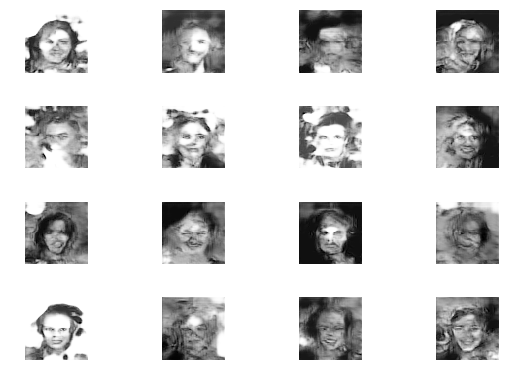

0: [D loss: 0.873168, acc: 0.468750] [A loss: 0.995077, acc: 0.312500]
1: [D loss: 0.823769, acc: 0.468750] [A loss: 1.355827, acc: 0.250000]
2: [D loss: 0.711825, acc: 0.500000] [A loss: 1.538389, acc: 0.062500]
3: [D loss: 0.652094, acc: 0.625000] [A loss: 1.321448, acc: 0.187500]
4: [D loss: 0.749688, acc: 0.562500] [A loss: 1.655154, acc: 0.187500]
5: [D loss: 0.677613, acc: 0.531250] [A loss: 1.264954, acc: 0.125000]
6: [D loss: 0.685673, acc: 0.593750] [A loss: 0.987732, acc: 0.312500]
7: [D loss: 0.805768, acc: 0.531250] [A loss: 0.991536, acc: 0.250000]
8: [D loss: 0.859037, acc: 0.562500] [A loss: 1.205707, acc: 0.187500]
9: [D loss: 0.747640, acc: 0.562500] [A loss: 1.240407, acc: 0.187500]
10: [D loss: 0.773077, acc: 0.500000] [A loss: 1.052769, acc: 0.187500]
11: [D loss: 0.789540, acc: 0.625000] [A loss: 1.075869, acc: 0.250000]
12: [D loss: 0.660648, acc: 0.625000] [A loss: 1.128740, acc: 0.250000]
13: [D loss: 0.689130, acc: 0.531250] [A loss: 1.451778, acc: 0.187500]
14

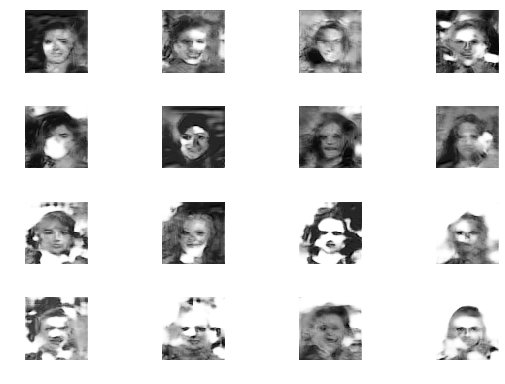

0: [D loss: 0.803603, acc: 0.468750] [A loss: 1.587684, acc: 0.125000]
1: [D loss: 0.896629, acc: 0.406250] [A loss: 1.718487, acc: 0.000000]
2: [D loss: 0.681757, acc: 0.562500] [A loss: 1.204698, acc: 0.062500]
3: [D loss: 0.837533, acc: 0.375000] [A loss: 1.176602, acc: 0.250000]
4: [D loss: 0.951165, acc: 0.437500] [A loss: 0.948876, acc: 0.312500]
5: [D loss: 1.026243, acc: 0.406250] [A loss: 0.928970, acc: 0.250000]
6: [D loss: 0.776921, acc: 0.531250] [A loss: 0.996537, acc: 0.375000]
7: [D loss: 0.862216, acc: 0.375000] [A loss: 1.187837, acc: 0.250000]
8: [D loss: 0.816650, acc: 0.437500] [A loss: 1.446430, acc: 0.062500]
9: [D loss: 0.866448, acc: 0.406250] [A loss: 1.315342, acc: 0.312500]
10: [D loss: 0.796156, acc: 0.625000] [A loss: 1.120169, acc: 0.125000]
11: [D loss: 0.733480, acc: 0.656250] [A loss: 1.201274, acc: 0.250000]
12: [D loss: 0.842608, acc: 0.468750] [A loss: 0.967985, acc: 0.312500]
13: [D loss: 0.759307, acc: 0.468750] [A loss: 1.008045, acc: 0.187500]
14

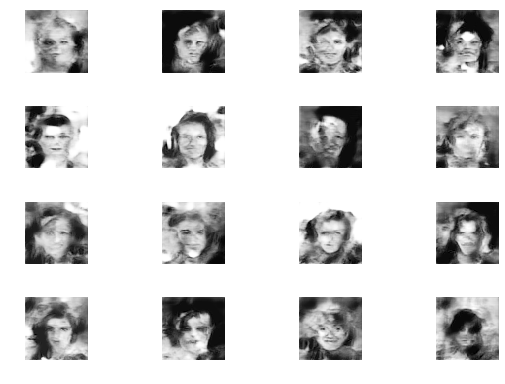

0: [D loss: 0.690386, acc: 0.562500] [A loss: 1.609392, acc: 0.000000]
1: [D loss: 0.758184, acc: 0.500000] [A loss: 1.356272, acc: 0.125000]
2: [D loss: 0.616068, acc: 0.718750] [A loss: 1.629295, acc: 0.062500]
3: [D loss: 0.745806, acc: 0.593750] [A loss: 1.463626, acc: 0.062500]
4: [D loss: 0.623770, acc: 0.625000] [A loss: 1.691575, acc: 0.062500]
5: [D loss: 0.834705, acc: 0.437500] [A loss: 1.615524, acc: 0.125000]
6: [D loss: 0.637733, acc: 0.625000] [A loss: 1.614746, acc: 0.125000]
7: [D loss: 0.723153, acc: 0.562500] [A loss: 1.142783, acc: 0.437500]
8: [D loss: 0.626488, acc: 0.593750] [A loss: 1.606709, acc: 0.062500]
9: [D loss: 0.725982, acc: 0.562500] [A loss: 1.780434, acc: 0.000000]
10: [D loss: 0.744509, acc: 0.468750] [A loss: 1.666789, acc: 0.062500]
11: [D loss: 0.604186, acc: 0.625000] [A loss: 1.336919, acc: 0.250000]
12: [D loss: 1.047752, acc: 0.406250] [A loss: 2.031848, acc: 0.125000]
13: [D loss: 0.586155, acc: 0.562500] [A loss: 1.532872, acc: 0.062500]
14

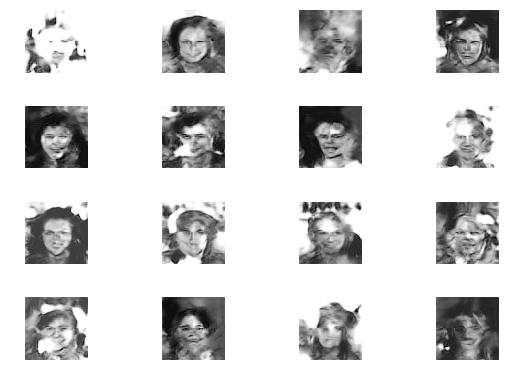

0: [D loss: 0.615903, acc: 0.593750] [A loss: 1.527851, acc: 0.062500]
1: [D loss: 0.805784, acc: 0.656250] [A loss: 2.016636, acc: 0.062500]
2: [D loss: 0.881371, acc: 0.375000] [A loss: 1.704411, acc: 0.000000]
3: [D loss: 0.774569, acc: 0.500000] [A loss: 1.298084, acc: 0.375000]
4: [D loss: 0.870124, acc: 0.375000] [A loss: 1.427092, acc: 0.125000]
5: [D loss: 0.867903, acc: 0.500000] [A loss: 1.163428, acc: 0.250000]
6: [D loss: 0.709354, acc: 0.656250] [A loss: 1.441455, acc: 0.375000]
7: [D loss: 0.952371, acc: 0.437500] [A loss: 1.449959, acc: 0.125000]
8: [D loss: 0.794643, acc: 0.531250] [A loss: 1.545806, acc: 0.125000]
9: [D loss: 0.776381, acc: 0.531250] [A loss: 1.194169, acc: 0.437500]
10: [D loss: 0.738978, acc: 0.531250] [A loss: 1.451578, acc: 0.187500]
11: [D loss: 0.790219, acc: 0.500000] [A loss: 1.078557, acc: 0.375000]
12: [D loss: 0.841598, acc: 0.531250] [A loss: 1.054183, acc: 0.125000]
13: [D loss: 0.803108, acc: 0.656250] [A loss: 0.963219, acc: 0.375000]
14

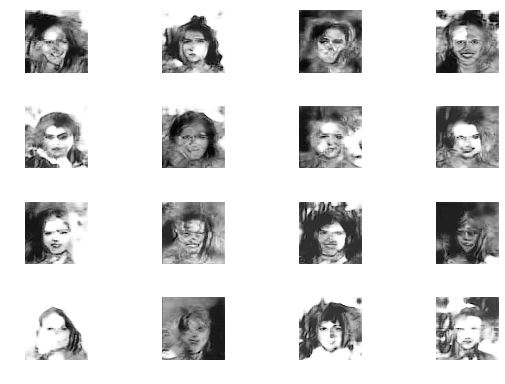

0: [D loss: 0.887618, acc: 0.500000] [A loss: 1.384404, acc: 0.062500]
1: [D loss: 0.613062, acc: 0.625000] [A loss: 1.726990, acc: 0.187500]
2: [D loss: 0.723904, acc: 0.531250] [A loss: 1.639227, acc: 0.062500]
3: [D loss: 0.683805, acc: 0.656250] [A loss: 1.283326, acc: 0.125000]
4: [D loss: 0.673620, acc: 0.562500] [A loss: 0.950723, acc: 0.250000]
5: [D loss: 0.738278, acc: 0.625000] [A loss: 1.255486, acc: 0.312500]
6: [D loss: 0.830793, acc: 0.531250] [A loss: 1.032311, acc: 0.187500]
7: [D loss: 0.623352, acc: 0.687500] [A loss: 0.943900, acc: 0.312500]
8: [D loss: 0.694622, acc: 0.593750] [A loss: 1.223067, acc: 0.250000]
9: [D loss: 0.809226, acc: 0.437500] [A loss: 1.344329, acc: 0.000000]
10: [D loss: 0.726750, acc: 0.500000] [A loss: 1.642613, acc: 0.000000]
11: [D loss: 0.729205, acc: 0.437500] [A loss: 1.531923, acc: 0.125000]
12: [D loss: 0.603935, acc: 0.687500] [A loss: 1.513039, acc: 0.125000]
13: [D loss: 0.704724, acc: 0.531250] [A loss: 1.704985, acc: 0.000000]
14

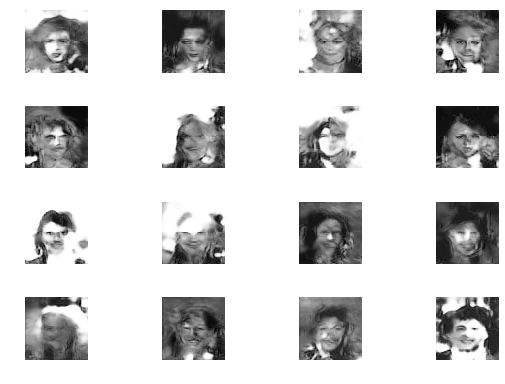

0: [D loss: 0.754279, acc: 0.593750] [A loss: 1.151532, acc: 0.250000]
1: [D loss: 0.645652, acc: 0.625000] [A loss: 1.215338, acc: 0.062500]
2: [D loss: 0.737775, acc: 0.656250] [A loss: 1.205883, acc: 0.125000]
3: [D loss: 0.793987, acc: 0.500000] [A loss: 1.248984, acc: 0.187500]
4: [D loss: 0.821189, acc: 0.500000] [A loss: 1.276201, acc: 0.125000]
5: [D loss: 0.709599, acc: 0.625000] [A loss: 1.076801, acc: 0.125000]
6: [D loss: 0.797172, acc: 0.500000] [A loss: 1.121219, acc: 0.250000]
7: [D loss: 0.784589, acc: 0.500000] [A loss: 1.272190, acc: 0.062500]
8: [D loss: 0.836798, acc: 0.500000] [A loss: 1.360394, acc: 0.125000]
9: [D loss: 0.813721, acc: 0.468750] [A loss: 1.331260, acc: 0.125000]
10: [D loss: 0.705056, acc: 0.625000] [A loss: 1.514278, acc: 0.187500]
11: [D loss: 0.817782, acc: 0.343750] [A loss: 1.207861, acc: 0.125000]
12: [D loss: 0.699441, acc: 0.531250] [A loss: 1.105431, acc: 0.125000]
13: [D loss: 0.845612, acc: 0.593750] [A loss: 1.318257, acc: 0.312500]
14

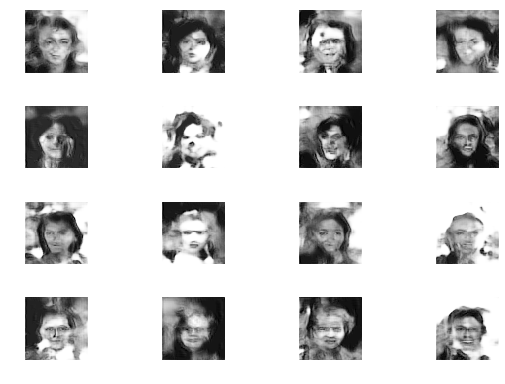

0: [D loss: 0.832683, acc: 0.562500] [A loss: 1.191206, acc: 0.375000]
1: [D loss: 0.765904, acc: 0.593750] [A loss: 1.807141, acc: 0.000000]
2: [D loss: 0.853757, acc: 0.343750] [A loss: 1.522814, acc: 0.125000]
3: [D loss: 0.650316, acc: 0.562500] [A loss: 1.573341, acc: 0.062500]
4: [D loss: 0.629181, acc: 0.687500] [A loss: 1.094291, acc: 0.250000]
5: [D loss: 0.742854, acc: 0.500000] [A loss: 1.069745, acc: 0.125000]
6: [D loss: 1.083375, acc: 0.375000] [A loss: 1.013370, acc: 0.187500]
7: [D loss: 0.886836, acc: 0.437500] [A loss: 0.942492, acc: 0.250000]
8: [D loss: 0.758251, acc: 0.531250] [A loss: 1.135041, acc: 0.250000]
9: [D loss: 0.807683, acc: 0.406250] [A loss: 1.416701, acc: 0.125000]
10: [D loss: 0.723022, acc: 0.531250] [A loss: 1.208059, acc: 0.312500]
11: [D loss: 0.664933, acc: 0.562500] [A loss: 1.169948, acc: 0.250000]
12: [D loss: 0.791590, acc: 0.562500] [A loss: 0.951803, acc: 0.500000]
13: [D loss: 0.846431, acc: 0.437500] [A loss: 1.292137, acc: 0.187500]
14

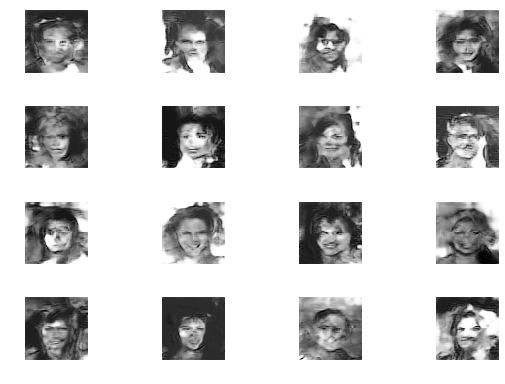

0: [D loss: 0.727013, acc: 0.625000] [A loss: 1.098175, acc: 0.250000]
1: [D loss: 0.689128, acc: 0.500000] [A loss: 1.235640, acc: 0.187500]
2: [D loss: 0.851766, acc: 0.562500] [A loss: 1.201085, acc: 0.187500]
3: [D loss: 0.764440, acc: 0.625000] [A loss: 1.048840, acc: 0.125000]
4: [D loss: 0.862306, acc: 0.500000] [A loss: 1.215624, acc: 0.187500]
5: [D loss: 0.615129, acc: 0.656250] [A loss: 1.216794, acc: 0.125000]
6: [D loss: 0.809654, acc: 0.531250] [A loss: 1.399022, acc: 0.187500]
7: [D loss: 0.637359, acc: 0.625000] [A loss: 1.577979, acc: 0.062500]
8: [D loss: 0.700365, acc: 0.562500] [A loss: 1.823896, acc: 0.000000]
9: [D loss: 0.760668, acc: 0.562500] [A loss: 1.815712, acc: 0.062500]
10: [D loss: 0.688624, acc: 0.593750] [A loss: 1.559911, acc: 0.125000]
11: [D loss: 0.780856, acc: 0.437500] [A loss: 1.632949, acc: 0.187500]
12: [D loss: 0.689141, acc: 0.531250] [A loss: 1.626013, acc: 0.000000]
13: [D loss: 0.949283, acc: 0.500000] [A loss: 1.707760, acc: 0.062500]
14

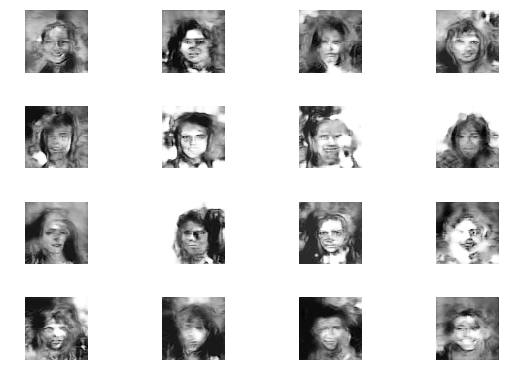

0: [D loss: 0.713133, acc: 0.656250] [A loss: 1.220019, acc: 0.187500]
1: [D loss: 0.865338, acc: 0.562500] [A loss: 1.090586, acc: 0.250000]
2: [D loss: 0.759092, acc: 0.500000] [A loss: 0.828279, acc: 0.562500]
3: [D loss: 1.026728, acc: 0.343750] [A loss: 0.952810, acc: 0.437500]
4: [D loss: 0.939687, acc: 0.437500] [A loss: 1.104622, acc: 0.187500]
5: [D loss: 0.916209, acc: 0.406250] [A loss: 1.393882, acc: 0.187500]
6: [D loss: 0.813714, acc: 0.406250] [A loss: 1.060162, acc: 0.312500]
7: [D loss: 0.669756, acc: 0.531250] [A loss: 1.156376, acc: 0.187500]
8: [D loss: 0.811869, acc: 0.562500] [A loss: 1.059270, acc: 0.250000]
9: [D loss: 1.005914, acc: 0.343750] [A loss: 1.325073, acc: 0.062500]
10: [D loss: 0.767550, acc: 0.531250] [A loss: 1.234577, acc: 0.250000]
11: [D loss: 0.864187, acc: 0.468750] [A loss: 1.235631, acc: 0.125000]
12: [D loss: 0.968613, acc: 0.437500] [A loss: 1.426398, acc: 0.125000]
13: [D loss: 0.864361, acc: 0.468750] [A loss: 1.376573, acc: 0.125000]
14

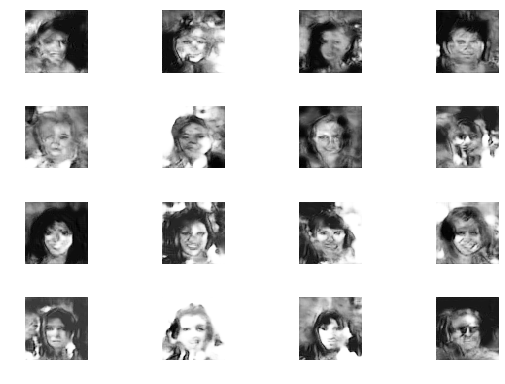

0: [D loss: 0.717130, acc: 0.468750] [A loss: 1.153957, acc: 0.375000]
1: [D loss: 0.886030, acc: 0.406250] [A loss: 1.358116, acc: 0.125000]
2: [D loss: 0.898819, acc: 0.406250] [A loss: 1.077229, acc: 0.187500]
3: [D loss: 0.898858, acc: 0.375000] [A loss: 1.152117, acc: 0.187500]
4: [D loss: 0.833899, acc: 0.500000] [A loss: 0.963993, acc: 0.250000]
5: [D loss: 0.743994, acc: 0.625000] [A loss: 1.077931, acc: 0.187500]
6: [D loss: 0.833497, acc: 0.500000] [A loss: 0.959435, acc: 0.187500]
7: [D loss: 0.773652, acc: 0.531250] [A loss: 1.183091, acc: 0.312500]
8: [D loss: 0.729453, acc: 0.562500] [A loss: 1.086913, acc: 0.312500]
9: [D loss: 0.785605, acc: 0.562500] [A loss: 1.667145, acc: 0.062500]
10: [D loss: 0.666426, acc: 0.593750] [A loss: 1.431534, acc: 0.125000]
11: [D loss: 0.753502, acc: 0.531250] [A loss: 1.354668, acc: 0.187500]
12: [D loss: 1.011748, acc: 0.500000] [A loss: 1.184573, acc: 0.312500]
13: [D loss: 0.849039, acc: 0.531250] [A loss: 1.142004, acc: 0.000000]
14

KeyboardInterrupt: ignored

In [0]:
from keras.models import load_model

  
faces = np.array(faces)
for j in range(10000):
 
  y_train = []
    
  for f in faces[np.random.randint(0, faces.shape[0], size=3000)]:
    im = cv2.resize((cv2.imread('faces/img_align_celeba/' + f, cv2.IMREAD_GRAYSCALE) / 255), (64, 64), interpolation = cv2.INTER_AREA)
    im.reshape((64, 64, 1))
    y_train.append(im)

  mnist_dcgan.x_train = np.array(y_train)
  
  mnist_dcgan.train(train_steps=200, batch_size=16, save_interval=1000)
  mnist_dcgan.plot_images(fake=True) 
  mnist_dcgan.plot_images(fake=True, save2file=True) 


In [0]:
import imageio 

with imageio.get_writer('process1.gif', mode='I') as writer: 
  for f in range(1, 200): 
    filename = 'tmp_res/!faces{}.png'.format(f)
    image = imageio.imread(filename)
    writer.append_data(image)

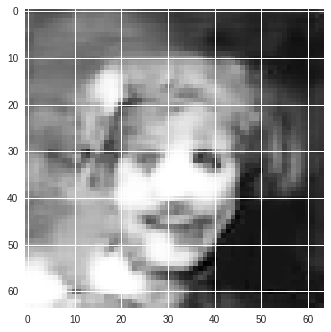

In [0]:
im = mnist_dcgan.generator.predict(np.random.uniform(-1.0, 1.0, size=[1, 100]))
plt.imshow(im[0].reshape(64, 64), cmap='gray')

In [0]:
ld = 0.00001
lg = 0.000007

optimizer = Adam(lr=ld, decay=ld / 10000) 
    
mnist_dcgan.discriminator.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])

optimizer = Adam(lr=lg, decay=lg / 10000) 
    
mnist_dcgan.adversarial.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
  

0: [D loss: 0.599945, acc: 0.742188] [A loss: 6.171118, acc: 0.000000]
1: [D loss: 0.612903, acc: 0.789062] [A loss: 5.865447, acc: 0.000000]
2: [D loss: 0.303091, acc: 0.882812] [A loss: 5.180656, acc: 0.031250]
3: [D loss: 0.441760, acc: 0.851562] [A loss: 4.839621, acc: 0.031250]
4: [D loss: 0.533275, acc: 0.828125] [A loss: 4.542348, acc: 0.046875]
5: [D loss: 0.438929, acc: 0.820312] [A loss: 4.282035, acc: 0.078125]
6: [D loss: 0.257596, acc: 0.921875] [A loss: 4.028260, acc: 0.078125]
7: [D loss: 0.337673, acc: 0.859375] [A loss: 3.424992, acc: 0.078125]
8: [D loss: 0.353201, acc: 0.875000] [A loss: 3.187709, acc: 0.109375]
9: [D loss: 0.321778, acc: 0.867188] [A loss: 2.763837, acc: 0.171875]
10: [D loss: 0.393061, acc: 0.843750] [A loss: 2.804610, acc: 0.140625]
11: [D loss: 0.456917, acc: 0.828125] [A loss: 2.437180, acc: 0.171875]
12: [D loss: 0.314309, acc: 0.851562] [A loss: 2.207473, acc: 0.234375]
13: [D loss: 0.447869, acc: 0.820312] [A loss: 2.363911, acc: 0.281250]
14

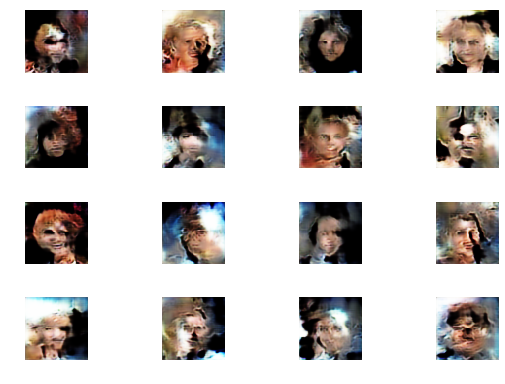

0: [D loss: 0.570178, acc: 0.796875] [A loss: 1.903670, acc: 0.250000]
1: [D loss: 0.524510, acc: 0.757812] [A loss: 2.041571, acc: 0.250000]
2: [D loss: 0.427413, acc: 0.851562] [A loss: 1.929514, acc: 0.281250]
3: [D loss: 0.642974, acc: 0.734375] [A loss: 1.680429, acc: 0.296875]
4: [D loss: 0.453565, acc: 0.789062] [A loss: 2.108699, acc: 0.187500]
5: [D loss: 0.463219, acc: 0.757812] [A loss: 2.362445, acc: 0.140625]
6: [D loss: 0.496393, acc: 0.789062] [A loss: 2.064999, acc: 0.250000]
7: [D loss: 0.590258, acc: 0.718750] [A loss: 2.298218, acc: 0.125000]
8: [D loss: 0.645288, acc: 0.742188] [A loss: 2.087286, acc: 0.265625]
9: [D loss: 0.601476, acc: 0.734375] [A loss: 1.786794, acc: 0.281250]
10: [D loss: 0.472623, acc: 0.781250] [A loss: 1.894955, acc: 0.296875]
11: [D loss: 0.701694, acc: 0.687500] [A loss: 1.900534, acc: 0.265625]
12: [D loss: 0.454005, acc: 0.781250] [A loss: 1.690417, acc: 0.250000]
13: [D loss: 0.404212, acc: 0.820312] [A loss: 1.838084, acc: 0.296875]
14

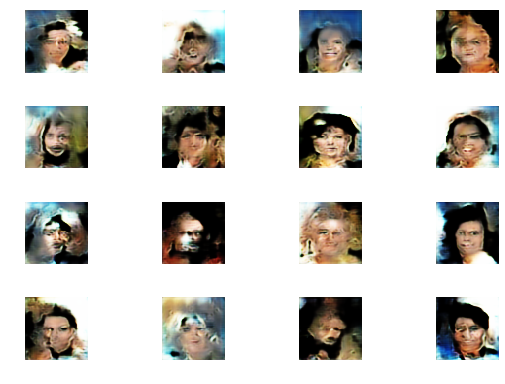

0: [D loss: 0.461670, acc: 0.835938] [A loss: 1.811200, acc: 0.218750]
1: [D loss: 0.636896, acc: 0.718750] [A loss: 1.574405, acc: 0.375000]
2: [D loss: 0.609778, acc: 0.781250] [A loss: 2.151326, acc: 0.218750]
3: [D loss: 0.534669, acc: 0.781250] [A loss: 1.862205, acc: 0.250000]
4: [D loss: 0.760684, acc: 0.710938] [A loss: 1.841511, acc: 0.265625]
5: [D loss: 0.493081, acc: 0.757812] [A loss: 1.752255, acc: 0.390625]
6: [D loss: 0.493100, acc: 0.796875] [A loss: 2.085788, acc: 0.203125]
7: [D loss: 0.573778, acc: 0.773438] [A loss: 2.002732, acc: 0.234375]
8: [D loss: 0.514519, acc: 0.742188] [A loss: 2.080927, acc: 0.218750]
9: [D loss: 0.458053, acc: 0.812500] [A loss: 2.069675, acc: 0.281250]
10: [D loss: 0.614696, acc: 0.710938] [A loss: 2.023365, acc: 0.296875]
11: [D loss: 0.638796, acc: 0.726562] [A loss: 1.912861, acc: 0.156250]
12: [D loss: 0.469700, acc: 0.781250] [A loss: 2.468518, acc: 0.156250]
13: [D loss: 0.489223, acc: 0.781250] [A loss: 1.832794, acc: 0.265625]
14

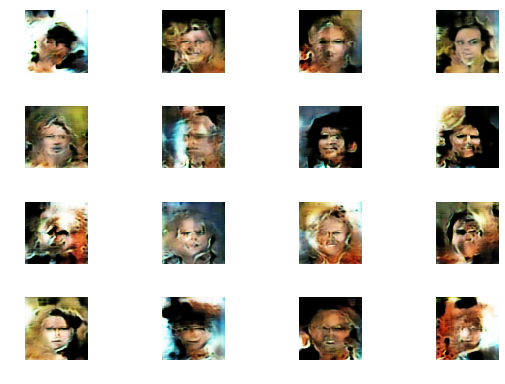

0: [D loss: 0.552318, acc: 0.750000] [A loss: 1.709097, acc: 0.296875]
1: [D loss: 0.543842, acc: 0.750000] [A loss: 2.056319, acc: 0.234375]
2: [D loss: 0.732795, acc: 0.710938] [A loss: 1.915775, acc: 0.265625]
3: [D loss: 0.591877, acc: 0.765625] [A loss: 2.207652, acc: 0.187500]
4: [D loss: 0.520014, acc: 0.789062] [A loss: 2.088071, acc: 0.234375]
5: [D loss: 0.504784, acc: 0.781250] [A loss: 1.855364, acc: 0.296875]
6: [D loss: 0.578366, acc: 0.750000] [A loss: 2.221559, acc: 0.156250]
7: [D loss: 0.750604, acc: 0.687500] [A loss: 2.287447, acc: 0.281250]
8: [D loss: 0.728836, acc: 0.710938] [A loss: 2.239022, acc: 0.187500]
9: [D loss: 0.363224, acc: 0.835938] [A loss: 2.122905, acc: 0.265625]
10: [D loss: 0.446839, acc: 0.781250] [A loss: 1.689006, acc: 0.234375]
11: [D loss: 0.463118, acc: 0.789062] [A loss: 1.777155, acc: 0.203125]
12: [D loss: 0.464862, acc: 0.773438] [A loss: 2.144307, acc: 0.265625]
13: [D loss: 0.469242, acc: 0.765625] [A loss: 2.223282, acc: 0.218750]
14

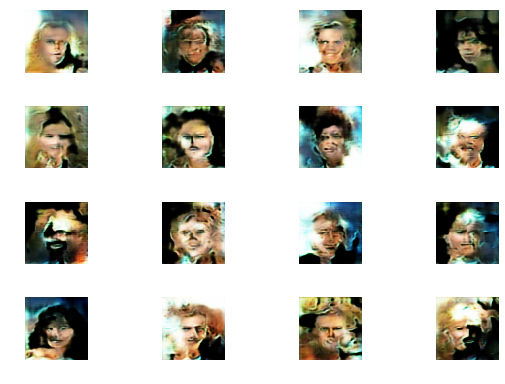

0: [D loss: 0.542454, acc: 0.789062] [A loss: 1.966141, acc: 0.250000]
1: [D loss: 0.739929, acc: 0.671875] [A loss: 2.054084, acc: 0.187500]
2: [D loss: 0.472597, acc: 0.796875] [A loss: 2.156680, acc: 0.187500]
3: [D loss: 0.346674, acc: 0.843750] [A loss: 2.365297, acc: 0.125000]
4: [D loss: 0.595941, acc: 0.734375] [A loss: 2.231735, acc: 0.109375]
5: [D loss: 0.414097, acc: 0.796875] [A loss: 2.383039, acc: 0.218750]
6: [D loss: 0.399043, acc: 0.820312] [A loss: 2.054261, acc: 0.234375]
7: [D loss: 0.411011, acc: 0.859375] [A loss: 2.117259, acc: 0.187500]
8: [D loss: 0.455318, acc: 0.781250] [A loss: 2.388517, acc: 0.140625]
9: [D loss: 0.481303, acc: 0.789062] [A loss: 2.104847, acc: 0.093750]
10: [D loss: 0.544125, acc: 0.757812] [A loss: 2.270478, acc: 0.156250]
11: [D loss: 0.432522, acc: 0.804688] [A loss: 1.744525, acc: 0.265625]
12: [D loss: 0.427212, acc: 0.812500] [A loss: 2.201566, acc: 0.250000]
13: [D loss: 0.490180, acc: 0.812500] [A loss: 2.268857, acc: 0.140625]
14

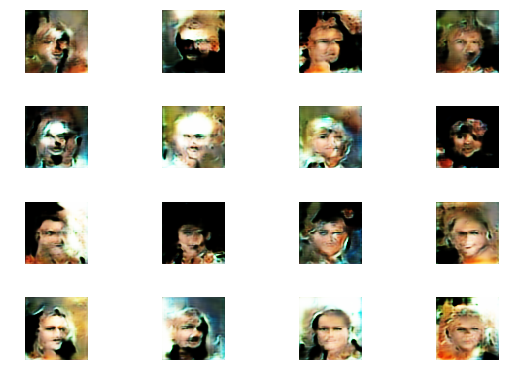

0: [D loss: 0.450900, acc: 0.796875] [A loss: 2.107078, acc: 0.234375]
1: [D loss: 0.343399, acc: 0.851562] [A loss: 2.008372, acc: 0.234375]
2: [D loss: 0.368353, acc: 0.789062] [A loss: 2.245198, acc: 0.140625]
3: [D loss: 0.390250, acc: 0.812500] [A loss: 2.275887, acc: 0.187500]
4: [D loss: 0.499681, acc: 0.789062] [A loss: 2.089199, acc: 0.218750]
5: [D loss: 0.518585, acc: 0.820312] [A loss: 2.275251, acc: 0.265625]
6: [D loss: 0.408783, acc: 0.812500] [A loss: 2.282700, acc: 0.140625]
7: [D loss: 0.449673, acc: 0.781250] [A loss: 2.478674, acc: 0.171875]
8: [D loss: 0.357080, acc: 0.843750] [A loss: 2.443991, acc: 0.218750]
9: [D loss: 0.451369, acc: 0.773438] [A loss: 2.128222, acc: 0.281250]
10: [D loss: 0.355164, acc: 0.851562] [A loss: 1.891495, acc: 0.218750]
11: [D loss: 0.401049, acc: 0.851562] [A loss: 2.172670, acc: 0.234375]
12: [D loss: 0.391900, acc: 0.843750] [A loss: 2.011578, acc: 0.281250]
13: [D loss: 0.524510, acc: 0.773438] [A loss: 2.230747, acc: 0.171875]
14

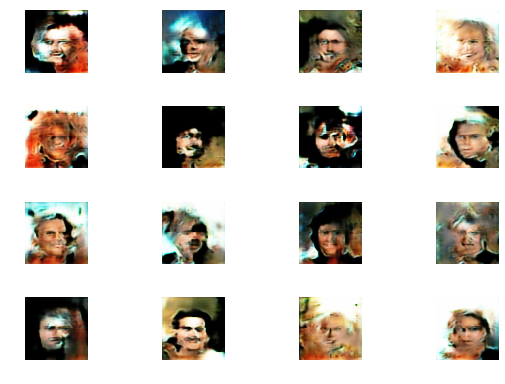

0: [D loss: 0.409618, acc: 0.820312] [A loss: 2.367207, acc: 0.140625]
1: [D loss: 0.360776, acc: 0.804688] [A loss: 1.979632, acc: 0.234375]
2: [D loss: 0.461901, acc: 0.789062] [A loss: 1.993995, acc: 0.218750]
3: [D loss: 0.517897, acc: 0.789062] [A loss: 2.183687, acc: 0.125000]
4: [D loss: 0.307454, acc: 0.843750] [A loss: 1.826079, acc: 0.250000]
5: [D loss: 0.455582, acc: 0.804688] [A loss: 2.120014, acc: 0.171875]
6: [D loss: 0.426244, acc: 0.789062] [A loss: 2.261249, acc: 0.187500]
7: [D loss: 0.465173, acc: 0.828125] [A loss: 1.955484, acc: 0.250000]
8: [D loss: 0.371411, acc: 0.835938] [A loss: 2.353101, acc: 0.187500]
9: [D loss: 0.345542, acc: 0.828125] [A loss: 2.158922, acc: 0.203125]
10: [D loss: 0.402137, acc: 0.781250] [A loss: 2.132753, acc: 0.171875]
11: [D loss: 0.430813, acc: 0.835938] [A loss: 2.277871, acc: 0.218750]
12: [D loss: 0.489132, acc: 0.773438] [A loss: 2.123233, acc: 0.234375]
13: [D loss: 0.409381, acc: 0.812500] [A loss: 2.317187, acc: 0.203125]
14

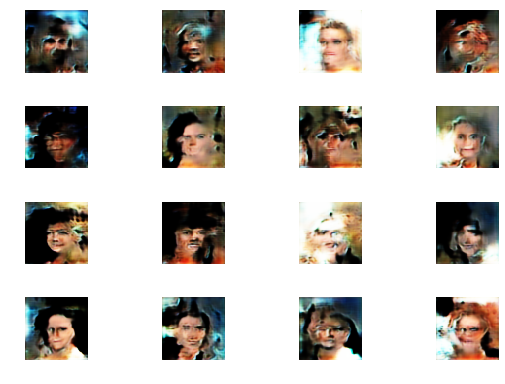

0: [D loss: 0.398327, acc: 0.796875] [A loss: 1.895392, acc: 0.218750]
1: [D loss: 0.430921, acc: 0.765625] [A loss: 1.932969, acc: 0.281250]
2: [D loss: 0.431967, acc: 0.781250] [A loss: 2.027235, acc: 0.125000]
3: [D loss: 0.504797, acc: 0.835938] [A loss: 1.834544, acc: 0.265625]
4: [D loss: 0.442912, acc: 0.812500] [A loss: 2.044583, acc: 0.187500]
5: [D loss: 0.391898, acc: 0.796875] [A loss: 1.903410, acc: 0.234375]
6: [D loss: 0.491166, acc: 0.781250] [A loss: 2.077532, acc: 0.125000]
7: [D loss: 0.456037, acc: 0.804688] [A loss: 2.250185, acc: 0.203125]
8: [D loss: 0.372098, acc: 0.828125] [A loss: 1.924748, acc: 0.234375]
9: [D loss: 0.413717, acc: 0.835938] [A loss: 2.331876, acc: 0.125000]
10: [D loss: 0.422874, acc: 0.789062] [A loss: 1.650474, acc: 0.203125]
11: [D loss: 0.434904, acc: 0.789062] [A loss: 2.126844, acc: 0.218750]
12: [D loss: 0.542185, acc: 0.765625] [A loss: 1.996265, acc: 0.203125]
13: [D loss: 0.390793, acc: 0.843750] [A loss: 1.865887, acc: 0.328125]
14

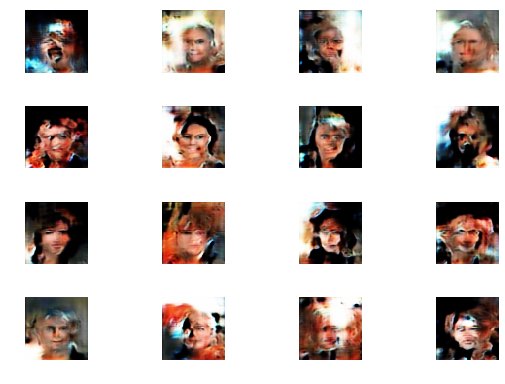

0: [D loss: 0.430798, acc: 0.796875] [A loss: 2.342708, acc: 0.156250]
1: [D loss: 0.319459, acc: 0.875000] [A loss: 1.757876, acc: 0.234375]
2: [D loss: 0.567345, acc: 0.726562] [A loss: 1.923381, acc: 0.234375]
3: [D loss: 0.434845, acc: 0.789062] [A loss: 1.774447, acc: 0.250000]
4: [D loss: 0.341356, acc: 0.851562] [A loss: 2.067484, acc: 0.171875]
5: [D loss: 0.481848, acc: 0.828125] [A loss: 2.110169, acc: 0.218750]
6: [D loss: 0.406702, acc: 0.828125] [A loss: 2.521171, acc: 0.093750]
7: [D loss: 0.546740, acc: 0.750000] [A loss: 2.030722, acc: 0.250000]
8: [D loss: 0.548995, acc: 0.757812] [A loss: 2.282757, acc: 0.203125]
9: [D loss: 0.408361, acc: 0.843750] [A loss: 2.000088, acc: 0.171875]
10: [D loss: 0.480010, acc: 0.835938] [A loss: 2.229552, acc: 0.156250]
11: [D loss: 0.467508, acc: 0.835938] [A loss: 2.014264, acc: 0.156250]
12: [D loss: 0.413378, acc: 0.828125] [A loss: 1.916903, acc: 0.250000]
13: [D loss: 0.496773, acc: 0.726562] [A loss: 2.267063, acc: 0.156250]
14

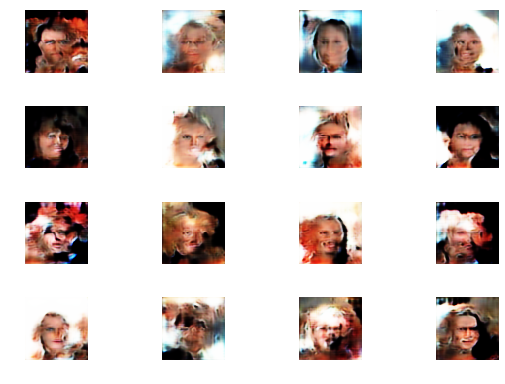

0: [D loss: 0.399574, acc: 0.828125] [A loss: 2.083075, acc: 0.187500]
1: [D loss: 0.358659, acc: 0.859375] [A loss: 2.256898, acc: 0.125000]
2: [D loss: 0.426934, acc: 0.796875] [A loss: 1.807111, acc: 0.171875]
3: [D loss: 0.311995, acc: 0.843750] [A loss: 2.153964, acc: 0.156250]
4: [D loss: 0.403863, acc: 0.820312] [A loss: 2.101898, acc: 0.140625]
5: [D loss: 0.536123, acc: 0.781250] [A loss: 2.314204, acc: 0.156250]
6: [D loss: 0.471961, acc: 0.765625] [A loss: 2.343147, acc: 0.109375]
7: [D loss: 0.401077, acc: 0.859375] [A loss: 1.999957, acc: 0.156250]
8: [D loss: 0.356522, acc: 0.828125] [A loss: 2.046623, acc: 0.125000]
9: [D loss: 0.436159, acc: 0.820312] [A loss: 2.237422, acc: 0.140625]
10: [D loss: 0.468476, acc: 0.796875] [A loss: 2.069998, acc: 0.156250]
11: [D loss: 0.431994, acc: 0.835938] [A loss: 2.160603, acc: 0.125000]
12: [D loss: 0.442985, acc: 0.742188] [A loss: 2.230701, acc: 0.187500]
13: [D loss: 0.362066, acc: 0.851562] [A loss: 2.012872, acc: 0.203125]
14

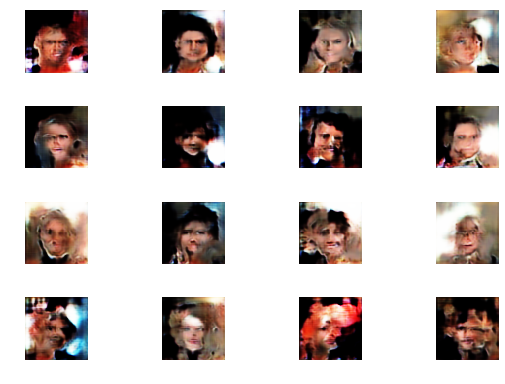

0: [D loss: 0.344227, acc: 0.851562] [A loss: 1.891293, acc: 0.265625]
1: [D loss: 0.401140, acc: 0.812500] [A loss: 1.943301, acc: 0.234375]
2: [D loss: 0.446111, acc: 0.804688] [A loss: 2.250115, acc: 0.125000]
3: [D loss: 0.442843, acc: 0.804688] [A loss: 1.784948, acc: 0.187500]
4: [D loss: 0.491092, acc: 0.726562] [A loss: 2.027715, acc: 0.171875]
5: [D loss: 0.432252, acc: 0.765625] [A loss: 2.326958, acc: 0.156250]
6: [D loss: 0.314328, acc: 0.882812] [A loss: 2.171386, acc: 0.109375]
7: [D loss: 0.395216, acc: 0.796875] [A loss: 2.016956, acc: 0.187500]
8: [D loss: 0.463262, acc: 0.781250] [A loss: 2.132500, acc: 0.187500]
9: [D loss: 0.349514, acc: 0.859375] [A loss: 1.861681, acc: 0.187500]
10: [D loss: 0.390683, acc: 0.804688] [A loss: 2.008841, acc: 0.109375]
11: [D loss: 0.383281, acc: 0.804688] [A loss: 2.093939, acc: 0.187500]
12: [D loss: 0.431029, acc: 0.828125] [A loss: 2.056022, acc: 0.187500]
13: [D loss: 0.372483, acc: 0.828125] [A loss: 2.154838, acc: 0.187500]
14

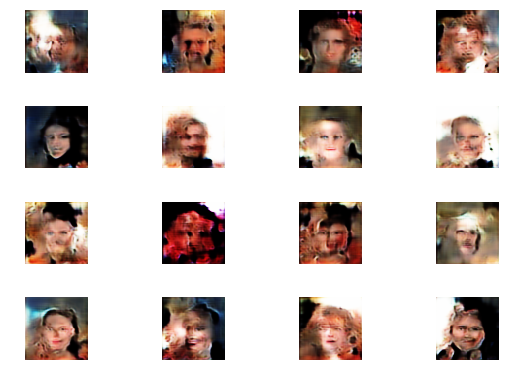

0: [D loss: 0.371043, acc: 0.843750] [A loss: 1.803890, acc: 0.203125]
1: [D loss: 0.487038, acc: 0.781250] [A loss: 1.814223, acc: 0.234375]
2: [D loss: 0.417426, acc: 0.796875] [A loss: 1.990452, acc: 0.171875]
3: [D loss: 0.404378, acc: 0.812500] [A loss: 1.855191, acc: 0.171875]
4: [D loss: 0.439281, acc: 0.804688] [A loss: 2.108843, acc: 0.109375]
5: [D loss: 0.404394, acc: 0.820312] [A loss: 1.805693, acc: 0.218750]
6: [D loss: 0.477989, acc: 0.789062] [A loss: 2.048028, acc: 0.234375]
7: [D loss: 0.609651, acc: 0.773438] [A loss: 1.806567, acc: 0.187500]
8: [D loss: 0.517593, acc: 0.757812] [A loss: 1.796940, acc: 0.218750]
9: [D loss: 0.366284, acc: 0.835938] [A loss: 2.021837, acc: 0.187500]
10: [D loss: 0.395193, acc: 0.796875] [A loss: 1.929595, acc: 0.218750]
11: [D loss: 0.469394, acc: 0.781250] [A loss: 1.917915, acc: 0.203125]
12: [D loss: 0.534224, acc: 0.726562] [A loss: 1.934579, acc: 0.109375]
13: [D loss: 0.420685, acc: 0.804688] [A loss: 2.013261, acc: 0.140625]
14

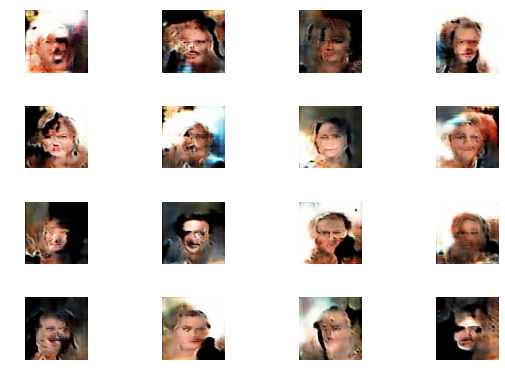

0: [D loss: 0.523455, acc: 0.781250] [A loss: 2.040604, acc: 0.171875]
1: [D loss: 0.424014, acc: 0.835938] [A loss: 1.936792, acc: 0.187500]
2: [D loss: 0.484754, acc: 0.781250] [A loss: 1.840674, acc: 0.203125]
3: [D loss: 0.630601, acc: 0.742188] [A loss: 1.927690, acc: 0.171875]
4: [D loss: 0.444313, acc: 0.789062] [A loss: 1.946137, acc: 0.156250]
5: [D loss: 0.349920, acc: 0.820312] [A loss: 1.715105, acc: 0.203125]
6: [D loss: 0.491787, acc: 0.757812] [A loss: 2.105277, acc: 0.125000]
7: [D loss: 0.457704, acc: 0.789062] [A loss: 1.847103, acc: 0.234375]
8: [D loss: 0.411160, acc: 0.828125] [A loss: 1.648401, acc: 0.218750]
9: [D loss: 0.479919, acc: 0.757812] [A loss: 2.078289, acc: 0.171875]
10: [D loss: 0.435536, acc: 0.804688] [A loss: 2.098500, acc: 0.140625]
11: [D loss: 0.435041, acc: 0.867188] [A loss: 2.158590, acc: 0.156250]
12: [D loss: 0.509951, acc: 0.781250] [A loss: 2.148437, acc: 0.093750]
13: [D loss: 0.383576, acc: 0.828125] [A loss: 1.879020, acc: 0.156250]
14

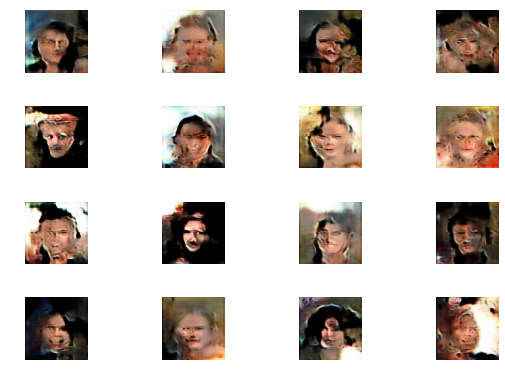

0: [D loss: 0.490296, acc: 0.750000] [A loss: 2.176183, acc: 0.203125]
1: [D loss: 0.346491, acc: 0.820312] [A loss: 1.757839, acc: 0.328125]
2: [D loss: 0.413605, acc: 0.796875] [A loss: 1.879517, acc: 0.203125]
3: [D loss: 0.372900, acc: 0.859375] [A loss: 2.080103, acc: 0.156250]
4: [D loss: 0.513914, acc: 0.750000] [A loss: 2.018535, acc: 0.203125]
5: [D loss: 0.461152, acc: 0.796875] [A loss: 2.117683, acc: 0.125000]
6: [D loss: 0.408566, acc: 0.812500] [A loss: 1.552042, acc: 0.296875]
7: [D loss: 0.495135, acc: 0.757812] [A loss: 1.985410, acc: 0.250000]
8: [D loss: 0.316614, acc: 0.828125] [A loss: 1.898961, acc: 0.203125]
9: [D loss: 0.440458, acc: 0.765625] [A loss: 1.757596, acc: 0.187500]
10: [D loss: 0.459218, acc: 0.828125] [A loss: 2.117706, acc: 0.140625]
11: [D loss: 0.333837, acc: 0.828125] [A loss: 1.901778, acc: 0.250000]
12: [D loss: 0.432845, acc: 0.781250] [A loss: 2.056408, acc: 0.140625]
13: [D loss: 0.411132, acc: 0.789062] [A loss: 2.175526, acc: 0.140625]
14

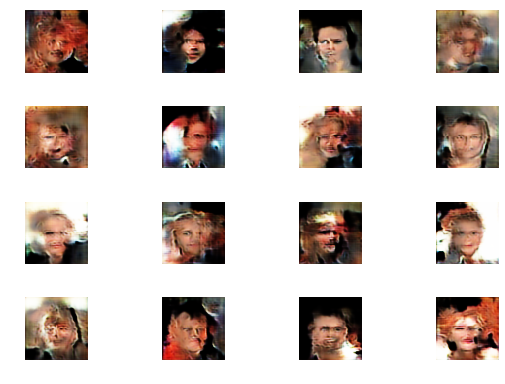

0: [D loss: 0.386926, acc: 0.820312] [A loss: 2.096267, acc: 0.125000]
1: [D loss: 0.491743, acc: 0.773438] [A loss: 1.915854, acc: 0.187500]
2: [D loss: 0.340203, acc: 0.843750] [A loss: 2.288404, acc: 0.125000]
3: [D loss: 0.428372, acc: 0.773438] [A loss: 2.294956, acc: 0.218750]
4: [D loss: 0.373833, acc: 0.843750] [A loss: 2.192544, acc: 0.171875]
5: [D loss: 0.490483, acc: 0.789062] [A loss: 2.184026, acc: 0.171875]
6: [D loss: 0.578272, acc: 0.687500] [A loss: 1.900429, acc: 0.187500]
7: [D loss: 0.330787, acc: 0.851562] [A loss: 1.852778, acc: 0.156250]
8: [D loss: 0.461296, acc: 0.750000] [A loss: 1.982117, acc: 0.218750]
9: [D loss: 0.436892, acc: 0.789062] [A loss: 1.778336, acc: 0.171875]
10: [D loss: 0.479539, acc: 0.796875] [A loss: 1.637650, acc: 0.171875]
11: [D loss: 0.438735, acc: 0.796875] [A loss: 2.027941, acc: 0.218750]
12: [D loss: 0.448851, acc: 0.781250] [A loss: 2.181213, acc: 0.125000]
13: [D loss: 0.432167, acc: 0.796875] [A loss: 2.009237, acc: 0.171875]
14

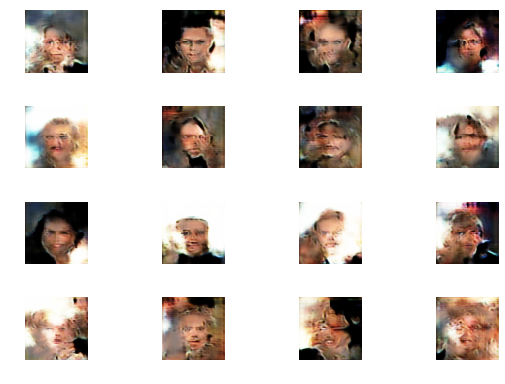

0: [D loss: 0.367688, acc: 0.804688] [A loss: 2.187054, acc: 0.125000]
1: [D loss: 0.364700, acc: 0.843750] [A loss: 1.716332, acc: 0.171875]
2: [D loss: 0.478329, acc: 0.742188] [A loss: 2.081004, acc: 0.156250]
3: [D loss: 0.519861, acc: 0.781250] [A loss: 1.999665, acc: 0.187500]
4: [D loss: 0.449346, acc: 0.789062] [A loss: 1.835110, acc: 0.140625]
5: [D loss: 0.396752, acc: 0.796875] [A loss: 2.066014, acc: 0.156250]
6: [D loss: 0.366449, acc: 0.820312] [A loss: 2.330235, acc: 0.093750]
7: [D loss: 0.468229, acc: 0.789062] [A loss: 1.854816, acc: 0.218750]
8: [D loss: 0.392602, acc: 0.843750] [A loss: 2.023997, acc: 0.171875]
9: [D loss: 0.461015, acc: 0.765625] [A loss: 1.884948, acc: 0.140625]
10: [D loss: 0.541378, acc: 0.750000] [A loss: 1.860245, acc: 0.171875]
11: [D loss: 0.488476, acc: 0.765625] [A loss: 2.022251, acc: 0.125000]
12: [D loss: 0.520760, acc: 0.773438] [A loss: 1.899336, acc: 0.265625]
13: [D loss: 0.455636, acc: 0.789062] [A loss: 1.809191, acc: 0.218750]
14

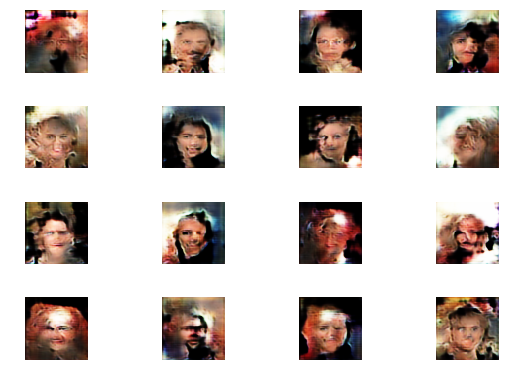

0: [D loss: 0.518584, acc: 0.781250] [A loss: 1.647036, acc: 0.250000]
1: [D loss: 0.425747, acc: 0.828125] [A loss: 1.866384, acc: 0.187500]
2: [D loss: 0.409420, acc: 0.835938] [A loss: 2.293207, acc: 0.156250]
3: [D loss: 0.333854, acc: 0.867188] [A loss: 1.754596, acc: 0.218750]
4: [D loss: 0.516235, acc: 0.742188] [A loss: 2.050825, acc: 0.140625]
5: [D loss: 0.317058, acc: 0.859375] [A loss: 2.260103, acc: 0.156250]
6: [D loss: 0.487133, acc: 0.789062] [A loss: 1.941219, acc: 0.203125]
7: [D loss: 0.529864, acc: 0.757812] [A loss: 1.915035, acc: 0.187500]
8: [D loss: 0.427081, acc: 0.843750] [A loss: 2.174477, acc: 0.156250]
9: [D loss: 0.388700, acc: 0.835938] [A loss: 1.903555, acc: 0.218750]
10: [D loss: 0.474424, acc: 0.789062] [A loss: 1.931135, acc: 0.171875]
11: [D loss: 0.409014, acc: 0.789062] [A loss: 1.549452, acc: 0.265625]
12: [D loss: 0.501498, acc: 0.781250] [A loss: 1.973269, acc: 0.156250]
13: [D loss: 0.506985, acc: 0.765625] [A loss: 1.928722, acc: 0.187500]
14

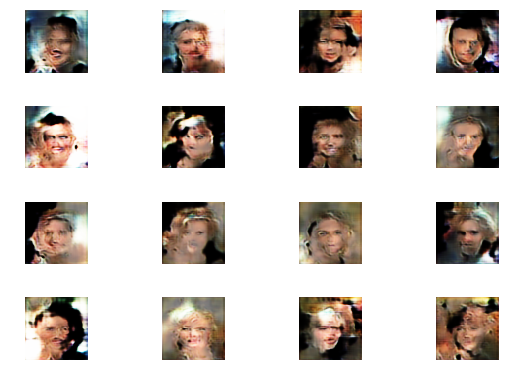

0: [D loss: 0.524317, acc: 0.781250] [A loss: 1.805672, acc: 0.265625]
1: [D loss: 0.470338, acc: 0.750000] [A loss: 2.230854, acc: 0.140625]
2: [D loss: 0.333111, acc: 0.859375] [A loss: 1.950459, acc: 0.203125]
3: [D loss: 0.469976, acc: 0.796875] [A loss: 1.733686, acc: 0.218750]
4: [D loss: 0.422378, acc: 0.804688] [A loss: 1.720448, acc: 0.250000]
5: [D loss: 0.377174, acc: 0.843750] [A loss: 2.119955, acc: 0.187500]
6: [D loss: 0.503611, acc: 0.773438] [A loss: 1.979766, acc: 0.156250]
7: [D loss: 0.374734, acc: 0.828125] [A loss: 2.177996, acc: 0.156250]
8: [D loss: 0.474940, acc: 0.804688] [A loss: 2.193574, acc: 0.093750]
9: [D loss: 0.346251, acc: 0.867188] [A loss: 2.160086, acc: 0.187500]
10: [D loss: 0.376650, acc: 0.828125] [A loss: 2.389270, acc: 0.046875]
11: [D loss: 0.391162, acc: 0.828125] [A loss: 2.212776, acc: 0.093750]
12: [D loss: 0.417871, acc: 0.828125] [A loss: 1.962982, acc: 0.234375]
13: [D loss: 0.404224, acc: 0.828125] [A loss: 2.094409, acc: 0.156250]
14

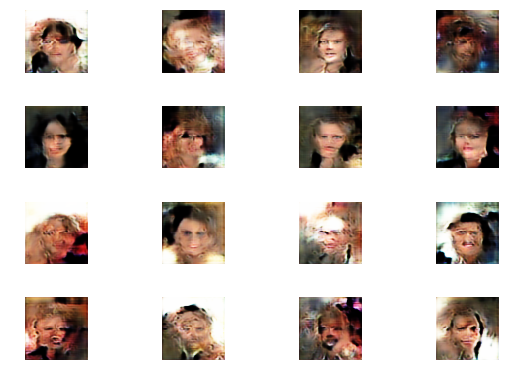

0: [D loss: 0.430897, acc: 0.820312] [A loss: 2.146232, acc: 0.218750]
1: [D loss: 0.444442, acc: 0.796875] [A loss: 1.954463, acc: 0.187500]
2: [D loss: 0.340539, acc: 0.843750] [A loss: 2.127197, acc: 0.171875]
3: [D loss: 0.358518, acc: 0.843750] [A loss: 2.195107, acc: 0.125000]
4: [D loss: 0.443084, acc: 0.804688] [A loss: 2.322863, acc: 0.140625]
5: [D loss: 0.399549, acc: 0.859375] [A loss: 2.011050, acc: 0.203125]
6: [D loss: 0.382054, acc: 0.835938] [A loss: 2.157860, acc: 0.171875]
7: [D loss: 0.385861, acc: 0.820312] [A loss: 1.987653, acc: 0.203125]
8: [D loss: 0.388463, acc: 0.828125] [A loss: 2.180518, acc: 0.125000]
9: [D loss: 0.414372, acc: 0.820312] [A loss: 2.280645, acc: 0.125000]
10: [D loss: 0.437169, acc: 0.796875] [A loss: 1.857750, acc: 0.125000]
11: [D loss: 0.479139, acc: 0.804688] [A loss: 2.144511, acc: 0.125000]
12: [D loss: 0.366505, acc: 0.835938] [A loss: 2.010235, acc: 0.140625]
13: [D loss: 0.380746, acc: 0.804688] [A loss: 1.950993, acc: 0.187500]
14

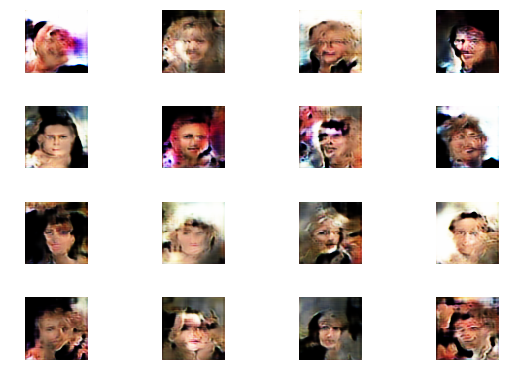

0: [D loss: 0.384442, acc: 0.812500] [A loss: 1.860585, acc: 0.312500]
1: [D loss: 0.510843, acc: 0.742188] [A loss: 1.973204, acc: 0.125000]
2: [D loss: 0.433445, acc: 0.804688] [A loss: 2.102162, acc: 0.187500]
3: [D loss: 0.456234, acc: 0.789062] [A loss: 2.081422, acc: 0.125000]
4: [D loss: 0.510573, acc: 0.812500] [A loss: 2.630828, acc: 0.093750]
5: [D loss: 0.529771, acc: 0.687500] [A loss: 1.986973, acc: 0.109375]
6: [D loss: 0.377982, acc: 0.835938] [A loss: 1.865233, acc: 0.171875]
7: [D loss: 0.494553, acc: 0.750000] [A loss: 2.124167, acc: 0.140625]
8: [D loss: 0.504129, acc: 0.750000] [A loss: 2.143211, acc: 0.203125]
9: [D loss: 0.480689, acc: 0.789062] [A loss: 2.312912, acc: 0.093750]
10: [D loss: 0.399145, acc: 0.851562] [A loss: 2.019546, acc: 0.140625]
11: [D loss: 0.481807, acc: 0.812500] [A loss: 2.203306, acc: 0.171875]
12: [D loss: 0.434294, acc: 0.734375] [A loss: 2.104227, acc: 0.156250]
13: [D loss: 0.405645, acc: 0.789062] [A loss: 2.210485, acc: 0.156250]
14

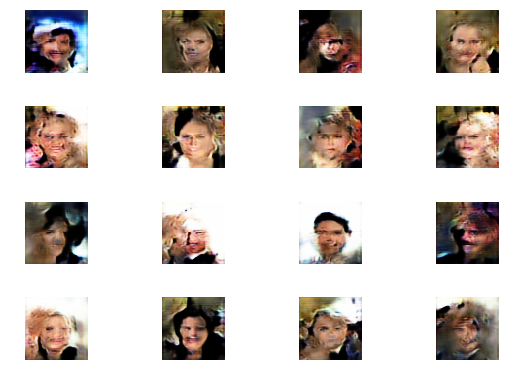

0: [D loss: 0.474679, acc: 0.773438] [A loss: 2.541319, acc: 0.203125]
1: [D loss: 0.384765, acc: 0.851562] [A loss: 2.105242, acc: 0.171875]
2: [D loss: 0.531578, acc: 0.781250] [A loss: 2.247483, acc: 0.093750]
3: [D loss: 0.464617, acc: 0.765625] [A loss: 2.077113, acc: 0.250000]
4: [D loss: 0.444717, acc: 0.789062] [A loss: 2.246191, acc: 0.187500]
5: [D loss: 0.500559, acc: 0.781250] [A loss: 2.075475, acc: 0.234375]
6: [D loss: 0.491715, acc: 0.773438] [A loss: 2.138667, acc: 0.093750]
7: [D loss: 0.510631, acc: 0.765625] [A loss: 2.033204, acc: 0.171875]
8: [D loss: 0.460405, acc: 0.804688] [A loss: 2.093357, acc: 0.156250]
9: [D loss: 0.414604, acc: 0.789062] [A loss: 2.196787, acc: 0.140625]
10: [D loss: 0.523728, acc: 0.773438] [A loss: 1.813648, acc: 0.250000]
11: [D loss: 0.446321, acc: 0.804688] [A loss: 2.141678, acc: 0.156250]
12: [D loss: 0.552984, acc: 0.734375] [A loss: 2.131698, acc: 0.140625]
13: [D loss: 0.541297, acc: 0.757812] [A loss: 1.998197, acc: 0.140625]
14

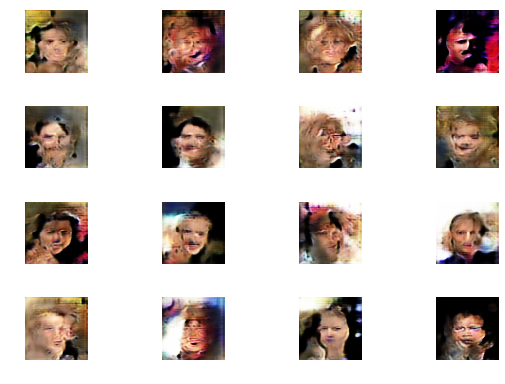

0: [D loss: 0.420066, acc: 0.835938] [A loss: 1.682208, acc: 0.265625]
1: [D loss: 0.471683, acc: 0.765625] [A loss: 1.754965, acc: 0.187500]
2: [D loss: 0.542094, acc: 0.742188] [A loss: 2.319003, acc: 0.140625]
3: [D loss: 0.455911, acc: 0.843750] [A loss: 1.761981, acc: 0.250000]
4: [D loss: 0.462824, acc: 0.804688] [A loss: 1.787575, acc: 0.250000]
5: [D loss: 0.464241, acc: 0.773438] [A loss: 1.735742, acc: 0.187500]
6: [D loss: 0.435594, acc: 0.812500] [A loss: 1.744848, acc: 0.234375]
7: [D loss: 0.549910, acc: 0.750000] [A loss: 1.843001, acc: 0.218750]
8: [D loss: 0.402503, acc: 0.843750] [A loss: 1.837170, acc: 0.187500]
9: [D loss: 0.444355, acc: 0.804688] [A loss: 1.971315, acc: 0.187500]
10: [D loss: 0.423576, acc: 0.812500] [A loss: 1.901394, acc: 0.203125]
11: [D loss: 0.536174, acc: 0.734375] [A loss: 1.908361, acc: 0.187500]
12: [D loss: 0.435434, acc: 0.835938] [A loss: 1.691668, acc: 0.265625]
13: [D loss: 0.589213, acc: 0.695312] [A loss: 2.095484, acc: 0.156250]
14

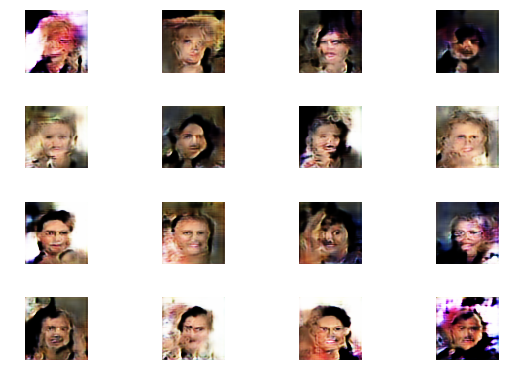

0: [D loss: 0.369571, acc: 0.851562] [A loss: 2.032189, acc: 0.156250]
1: [D loss: 0.499371, acc: 0.734375] [A loss: 2.282756, acc: 0.156250]
2: [D loss: 0.452146, acc: 0.781250] [A loss: 2.178000, acc: 0.234375]
3: [D loss: 0.366419, acc: 0.851562] [A loss: 2.355211, acc: 0.218750]
4: [D loss: 0.424904, acc: 0.804688] [A loss: 1.853282, acc: 0.218750]
5: [D loss: 0.463809, acc: 0.781250] [A loss: 2.087147, acc: 0.187500]
6: [D loss: 0.386608, acc: 0.812500] [A loss: 1.867895, acc: 0.171875]
7: [D loss: 0.514774, acc: 0.781250] [A loss: 2.127704, acc: 0.156250]
8: [D loss: 0.428601, acc: 0.804688] [A loss: 1.854609, acc: 0.218750]
9: [D loss: 0.449376, acc: 0.804688] [A loss: 1.860310, acc: 0.203125]
10: [D loss: 0.519862, acc: 0.765625] [A loss: 1.982158, acc: 0.234375]
11: [D loss: 0.484392, acc: 0.804688] [A loss: 2.072936, acc: 0.218750]
12: [D loss: 0.564457, acc: 0.765625] [A loss: 2.191074, acc: 0.171875]
13: [D loss: 0.589130, acc: 0.726562] [A loss: 1.880458, acc: 0.125000]
14

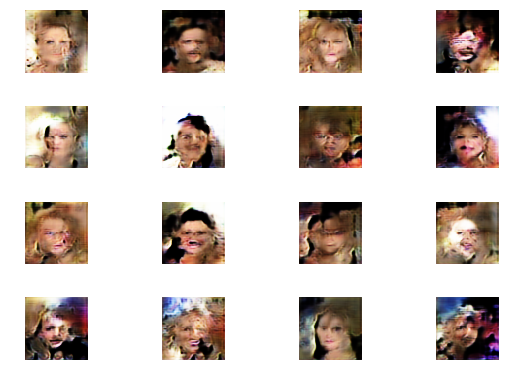

0: [D loss: 0.579524, acc: 0.726562] [A loss: 1.710697, acc: 0.203125]
1: [D loss: 0.502395, acc: 0.757812] [A loss: 2.217175, acc: 0.156250]
2: [D loss: 0.532332, acc: 0.750000] [A loss: 2.109720, acc: 0.187500]
3: [D loss: 0.416557, acc: 0.796875] [A loss: 2.034191, acc: 0.156250]
4: [D loss: 0.495256, acc: 0.781250] [A loss: 1.981280, acc: 0.140625]
5: [D loss: 0.457190, acc: 0.796875] [A loss: 1.931599, acc: 0.171875]
6: [D loss: 0.595454, acc: 0.726562] [A loss: 2.258351, acc: 0.203125]
7: [D loss: 0.518936, acc: 0.765625] [A loss: 1.641026, acc: 0.234375]
8: [D loss: 0.582436, acc: 0.781250] [A loss: 2.045271, acc: 0.171875]
9: [D loss: 0.416689, acc: 0.820312] [A loss: 1.927954, acc: 0.218750]
10: [D loss: 0.542676, acc: 0.750000] [A loss: 1.971769, acc: 0.203125]
11: [D loss: 0.537161, acc: 0.765625] [A loss: 1.878048, acc: 0.203125]
12: [D loss: 0.426645, acc: 0.781250] [A loss: 1.835322, acc: 0.171875]
13: [D loss: 0.438458, acc: 0.789062] [A loss: 2.020928, acc: 0.234375]
14

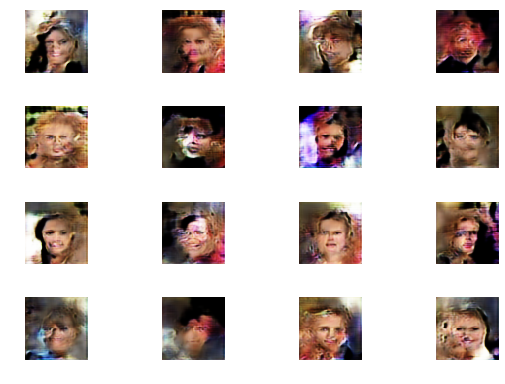

0: [D loss: 0.456203, acc: 0.750000] [A loss: 1.786361, acc: 0.234375]
1: [D loss: 0.445296, acc: 0.789062] [A loss: 1.765834, acc: 0.250000]
2: [D loss: 0.454836, acc: 0.796875] [A loss: 2.025043, acc: 0.156250]
3: [D loss: 0.515380, acc: 0.765625] [A loss: 2.281406, acc: 0.171875]
4: [D loss: 0.422179, acc: 0.781250] [A loss: 1.981856, acc: 0.250000]
5: [D loss: 0.475050, acc: 0.757812] [A loss: 1.737051, acc: 0.203125]
6: [D loss: 0.609157, acc: 0.734375] [A loss: 1.832685, acc: 0.234375]
7: [D loss: 0.418491, acc: 0.820312] [A loss: 1.933160, acc: 0.187500]
8: [D loss: 0.405794, acc: 0.820312] [A loss: 1.862118, acc: 0.203125]
9: [D loss: 0.465391, acc: 0.757812] [A loss: 2.103420, acc: 0.109375]
10: [D loss: 0.439753, acc: 0.789062] [A loss: 2.048616, acc: 0.281250]
11: [D loss: 0.500096, acc: 0.750000] [A loss: 1.888334, acc: 0.125000]
12: [D loss: 0.362855, acc: 0.812500] [A loss: 2.044022, acc: 0.156250]
13: [D loss: 0.491286, acc: 0.750000] [A loss: 1.767339, acc: 0.281250]
14

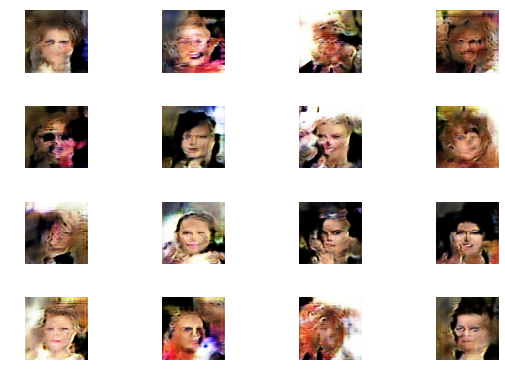

0: [D loss: 0.457047, acc: 0.789062] [A loss: 1.836404, acc: 0.250000]
1: [D loss: 0.461100, acc: 0.820312] [A loss: 2.068622, acc: 0.203125]
2: [D loss: 0.582738, acc: 0.742188] [A loss: 2.205953, acc: 0.109375]
3: [D loss: 0.476269, acc: 0.828125] [A loss: 2.097138, acc: 0.109375]
4: [D loss: 0.457172, acc: 0.828125] [A loss: 1.906666, acc: 0.203125]
5: [D loss: 0.585350, acc: 0.742188] [A loss: 1.833142, acc: 0.234375]
6: [D loss: 0.400252, acc: 0.828125] [A loss: 2.126070, acc: 0.218750]
7: [D loss: 0.561645, acc: 0.742188] [A loss: 1.960524, acc: 0.234375]
8: [D loss: 0.480535, acc: 0.781250] [A loss: 1.753217, acc: 0.250000]
9: [D loss: 0.451906, acc: 0.750000] [A loss: 1.943540, acc: 0.140625]
10: [D loss: 0.539749, acc: 0.710938] [A loss: 1.955702, acc: 0.109375]
11: [D loss: 0.472035, acc: 0.773438] [A loss: 1.948040, acc: 0.203125]
12: [D loss: 0.383372, acc: 0.812500] [A loss: 1.839252, acc: 0.156250]
13: [D loss: 0.517846, acc: 0.734375] [A loss: 2.039301, acc: 0.203125]
14

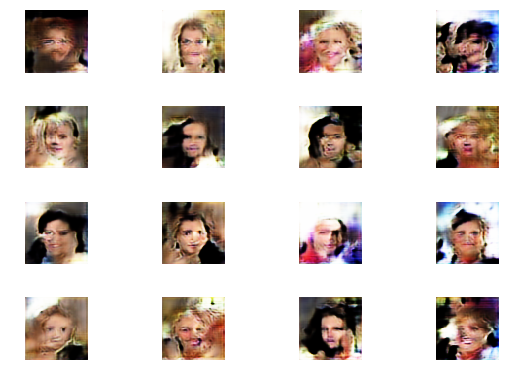

0: [D loss: 0.532619, acc: 0.765625] [A loss: 1.844732, acc: 0.281250]
1: [D loss: 0.522916, acc: 0.718750] [A loss: 1.907441, acc: 0.234375]
2: [D loss: 0.464166, acc: 0.812500] [A loss: 2.120038, acc: 0.156250]
3: [D loss: 0.438171, acc: 0.781250] [A loss: 1.827225, acc: 0.234375]
4: [D loss: 0.463341, acc: 0.781250] [A loss: 2.004890, acc: 0.203125]
5: [D loss: 0.568708, acc: 0.726562] [A loss: 2.001901, acc: 0.234375]
6: [D loss: 0.453500, acc: 0.773438] [A loss: 1.855750, acc: 0.218750]
7: [D loss: 0.381348, acc: 0.812500] [A loss: 2.046037, acc: 0.265625]
8: [D loss: 0.468147, acc: 0.773438] [A loss: 2.208554, acc: 0.218750]
9: [D loss: 0.625000, acc: 0.679688] [A loss: 2.050116, acc: 0.187500]
10: [D loss: 0.509981, acc: 0.757812] [A loss: 2.208539, acc: 0.187500]
11: [D loss: 0.486909, acc: 0.757812] [A loss: 2.049742, acc: 0.234375]
12: [D loss: 0.502879, acc: 0.750000] [A loss: 2.191265, acc: 0.140625]
13: [D loss: 0.571983, acc: 0.718750] [A loss: 2.254899, acc: 0.125000]
14

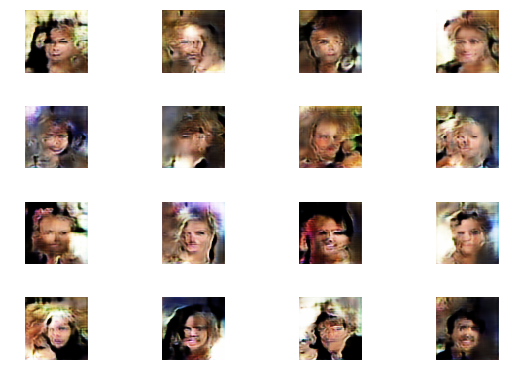

0: [D loss: 0.698672, acc: 0.671875] [A loss: 2.143511, acc: 0.156250]
1: [D loss: 0.487955, acc: 0.742188] [A loss: 2.016287, acc: 0.171875]
2: [D loss: 0.476254, acc: 0.757812] [A loss: 1.891618, acc: 0.156250]
3: [D loss: 0.550979, acc: 0.726562] [A loss: 1.827716, acc: 0.125000]
4: [D loss: 0.585669, acc: 0.757812] [A loss: 1.831043, acc: 0.187500]
5: [D loss: 0.369142, acc: 0.843750] [A loss: 1.926416, acc: 0.234375]
6: [D loss: 0.564573, acc: 0.703125] [A loss: 2.082875, acc: 0.171875]
7: [D loss: 0.490725, acc: 0.742188] [A loss: 2.076040, acc: 0.203125]
8: [D loss: 0.447045, acc: 0.796875] [A loss: 1.989345, acc: 0.156250]
9: [D loss: 0.619548, acc: 0.703125] [A loss: 2.119015, acc: 0.171875]
10: [D loss: 0.476700, acc: 0.757812] [A loss: 1.775817, acc: 0.250000]
11: [D loss: 0.499518, acc: 0.734375] [A loss: 1.822919, acc: 0.171875]
12: [D loss: 0.495717, acc: 0.765625] [A loss: 1.746115, acc: 0.296875]
13: [D loss: 0.510444, acc: 0.765625] [A loss: 2.046462, acc: 0.140625]
14

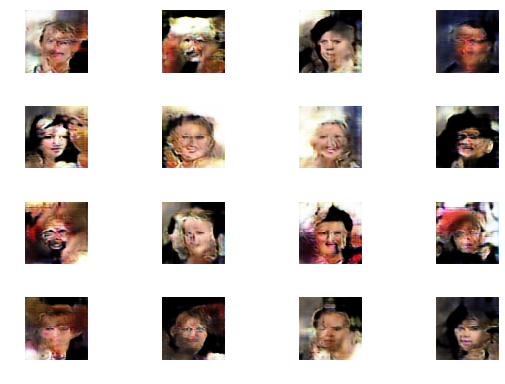

0: [D loss: 0.479269, acc: 0.757812] [A loss: 1.900224, acc: 0.218750]
1: [D loss: 0.647730, acc: 0.718750] [A loss: 1.572868, acc: 0.359375]
2: [D loss: 0.438417, acc: 0.820312] [A loss: 1.735760, acc: 0.218750]
3: [D loss: 0.336015, acc: 0.867188] [A loss: 1.838830, acc: 0.265625]
4: [D loss: 0.511595, acc: 0.812500] [A loss: 1.943619, acc: 0.203125]
5: [D loss: 0.484707, acc: 0.781250] [A loss: 1.917079, acc: 0.125000]
6: [D loss: 0.462569, acc: 0.804688] [A loss: 1.610034, acc: 0.265625]
7: [D loss: 0.450972, acc: 0.812500] [A loss: 1.555419, acc: 0.312500]
8: [D loss: 0.492594, acc: 0.750000] [A loss: 1.685625, acc: 0.234375]
9: [D loss: 0.395473, acc: 0.796875] [A loss: 1.899739, acc: 0.156250]
10: [D loss: 0.438097, acc: 0.828125] [A loss: 2.010883, acc: 0.171875]
11: [D loss: 0.507277, acc: 0.726562] [A loss: 2.224130, acc: 0.156250]
12: [D loss: 0.512708, acc: 0.781250] [A loss: 1.841645, acc: 0.250000]
13: [D loss: 0.567221, acc: 0.734375] [A loss: 2.009496, acc: 0.203125]
14

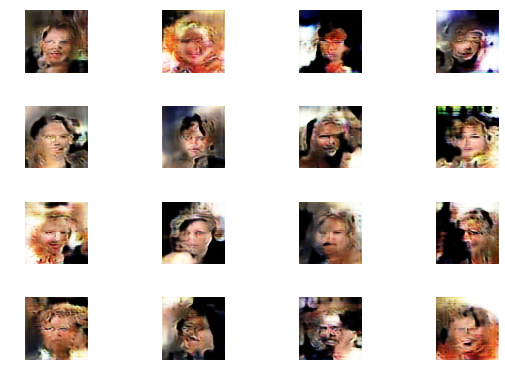

0: [D loss: 0.422731, acc: 0.796875] [A loss: 1.892488, acc: 0.187500]
1: [D loss: 0.612425, acc: 0.710938] [A loss: 2.004060, acc: 0.156250]
2: [D loss: 0.388707, acc: 0.820312] [A loss: 2.160837, acc: 0.187500]
3: [D loss: 0.611265, acc: 0.710938] [A loss: 1.959926, acc: 0.203125]
4: [D loss: 0.591603, acc: 0.742188] [A loss: 1.893258, acc: 0.265625]
5: [D loss: 0.387484, acc: 0.789062] [A loss: 1.985955, acc: 0.125000]
6: [D loss: 0.412268, acc: 0.804688] [A loss: 1.906765, acc: 0.218750]
7: [D loss: 0.527660, acc: 0.812500] [A loss: 1.844378, acc: 0.218750]
8: [D loss: 0.572452, acc: 0.742188] [A loss: 2.099254, acc: 0.140625]
9: [D loss: 0.513491, acc: 0.757812] [A loss: 2.064745, acc: 0.234375]
10: [D loss: 0.497067, acc: 0.796875] [A loss: 2.012336, acc: 0.203125]
11: [D loss: 0.570938, acc: 0.789062] [A loss: 2.103148, acc: 0.140625]
12: [D loss: 0.562568, acc: 0.742188] [A loss: 1.767875, acc: 0.265625]
13: [D loss: 0.478386, acc: 0.773438] [A loss: 1.886303, acc: 0.203125]
14

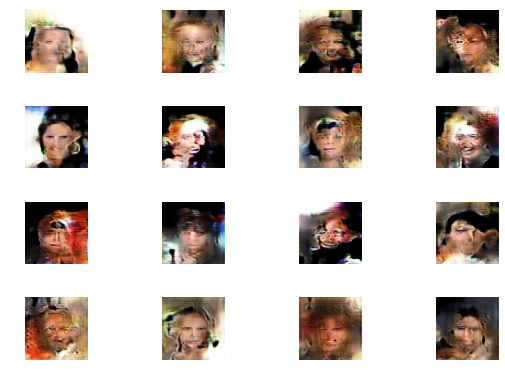

0: [D loss: 0.517776, acc: 0.742188] [A loss: 1.834920, acc: 0.218750]
1: [D loss: 0.501446, acc: 0.726562] [A loss: 1.788497, acc: 0.250000]
2: [D loss: 0.565527, acc: 0.773438] [A loss: 1.961537, acc: 0.187500]
3: [D loss: 0.447343, acc: 0.820312] [A loss: 1.793199, acc: 0.281250]
4: [D loss: 0.555786, acc: 0.703125] [A loss: 1.877733, acc: 0.203125]
5: [D loss: 0.574872, acc: 0.734375] [A loss: 1.904835, acc: 0.187500]
6: [D loss: 0.598631, acc: 0.710938] [A loss: 1.939884, acc: 0.218750]
7: [D loss: 0.372490, acc: 0.796875] [A loss: 1.530052, acc: 0.265625]
8: [D loss: 0.482904, acc: 0.773438] [A loss: 2.267105, acc: 0.140625]
9: [D loss: 0.480654, acc: 0.757812] [A loss: 1.657473, acc: 0.218750]
10: [D loss: 0.516616, acc: 0.742188] [A loss: 2.020566, acc: 0.109375]
11: [D loss: 0.657913, acc: 0.718750] [A loss: 1.996795, acc: 0.187500]
12: [D loss: 0.491530, acc: 0.742188] [A loss: 1.899652, acc: 0.218750]
13: [D loss: 0.498659, acc: 0.765625] [A loss: 1.896432, acc: 0.156250]
14

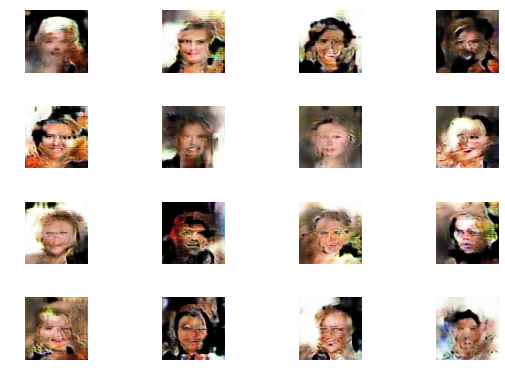

0: [D loss: 0.607346, acc: 0.679688] [A loss: 1.794341, acc: 0.218750]
1: [D loss: 0.627065, acc: 0.679688] [A loss: 2.064492, acc: 0.250000]
2: [D loss: 0.545196, acc: 0.726562] [A loss: 1.946433, acc: 0.234375]
3: [D loss: 0.369393, acc: 0.820312] [A loss: 2.064189, acc: 0.203125]
4: [D loss: 0.394218, acc: 0.828125] [A loss: 1.992995, acc: 0.203125]
5: [D loss: 0.452188, acc: 0.796875] [A loss: 2.127366, acc: 0.109375]
6: [D loss: 0.511443, acc: 0.742188] [A loss: 2.025820, acc: 0.140625]
7: [D loss: 0.609133, acc: 0.718750] [A loss: 1.980758, acc: 0.187500]
8: [D loss: 0.482865, acc: 0.765625] [A loss: 2.109680, acc: 0.187500]
9: [D loss: 0.565791, acc: 0.734375] [A loss: 1.993471, acc: 0.171875]
10: [D loss: 0.632813, acc: 0.664062] [A loss: 2.215656, acc: 0.093750]
11: [D loss: 0.538391, acc: 0.742188] [A loss: 2.347570, acc: 0.140625]
12: [D loss: 0.545790, acc: 0.726562] [A loss: 1.978957, acc: 0.203125]
13: [D loss: 0.425198, acc: 0.789062] [A loss: 2.107435, acc: 0.203125]
14

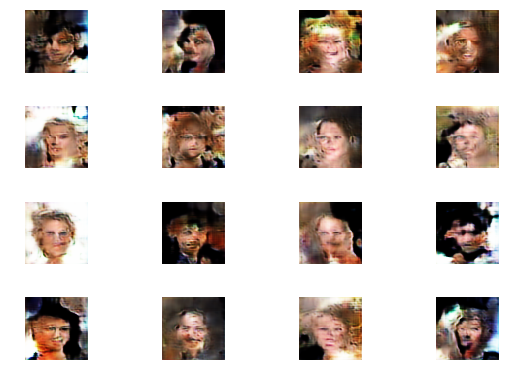

0: [D loss: 0.604167, acc: 0.703125] [A loss: 1.806190, acc: 0.187500]
1: [D loss: 0.499979, acc: 0.750000] [A loss: 2.035458, acc: 0.109375]
2: [D loss: 0.512145, acc: 0.742188] [A loss: 1.822443, acc: 0.187500]
3: [D loss: 0.611961, acc: 0.726562] [A loss: 2.362745, acc: 0.218750]
4: [D loss: 0.457119, acc: 0.765625] [A loss: 1.936709, acc: 0.203125]
5: [D loss: 0.628313, acc: 0.703125] [A loss: 1.794019, acc: 0.218750]
6: [D loss: 0.463958, acc: 0.796875] [A loss: 1.908234, acc: 0.250000]
7: [D loss: 0.487203, acc: 0.796875] [A loss: 1.966121, acc: 0.218750]
8: [D loss: 0.447470, acc: 0.773438] [A loss: 2.086972, acc: 0.187500]
9: [D loss: 0.599782, acc: 0.726562] [A loss: 2.245849, acc: 0.203125]
10: [D loss: 0.604551, acc: 0.726562] [A loss: 2.347286, acc: 0.187500]
11: [D loss: 0.620434, acc: 0.742188] [A loss: 1.841099, acc: 0.281250]
12: [D loss: 0.533083, acc: 0.750000] [A loss: 2.043746, acc: 0.140625]
13: [D loss: 0.530048, acc: 0.789062] [A loss: 1.554535, acc: 0.265625]
14

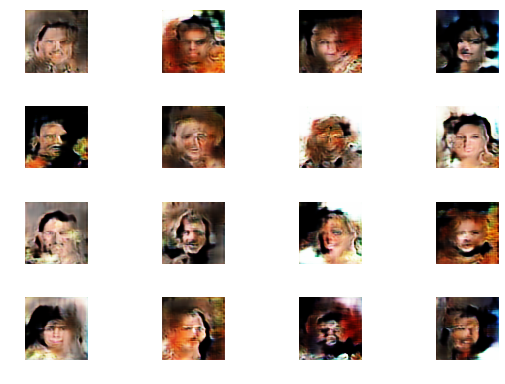

0: [D loss: 0.511839, acc: 0.773438] [A loss: 1.535163, acc: 0.375000]
1: [D loss: 0.498809, acc: 0.718750] [A loss: 1.910482, acc: 0.203125]
2: [D loss: 0.616127, acc: 0.710938] [A loss: 1.694715, acc: 0.234375]
3: [D loss: 0.647587, acc: 0.695312] [A loss: 1.710363, acc: 0.281250]
4: [D loss: 0.585783, acc: 0.687500] [A loss: 1.899365, acc: 0.187500]
5: [D loss: 0.539709, acc: 0.742188] [A loss: 1.848805, acc: 0.250000]
6: [D loss: 0.569765, acc: 0.750000] [A loss: 1.736663, acc: 0.203125]
7: [D loss: 0.527930, acc: 0.773438] [A loss: 1.641723, acc: 0.171875]
8: [D loss: 0.572854, acc: 0.734375] [A loss: 1.944971, acc: 0.234375]
9: [D loss: 0.470320, acc: 0.742188] [A loss: 1.839875, acc: 0.218750]
10: [D loss: 0.570772, acc: 0.742188] [A loss: 2.311659, acc: 0.109375]
11: [D loss: 0.574669, acc: 0.750000] [A loss: 1.969689, acc: 0.203125]
12: [D loss: 0.580878, acc: 0.742188] [A loss: 2.123816, acc: 0.140625]
13: [D loss: 0.481810, acc: 0.789062] [A loss: 1.966240, acc: 0.140625]
14

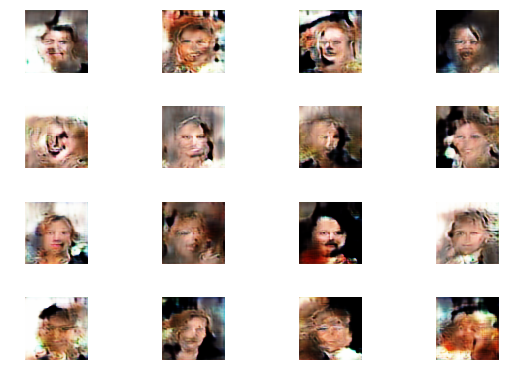

0: [D loss: 0.443822, acc: 0.789062] [A loss: 2.188973, acc: 0.187500]
1: [D loss: 0.612434, acc: 0.703125] [A loss: 2.167426, acc: 0.234375]
2: [D loss: 0.403263, acc: 0.796875] [A loss: 1.654803, acc: 0.281250]
3: [D loss: 0.631816, acc: 0.718750] [A loss: 1.742513, acc: 0.265625]
4: [D loss: 0.462865, acc: 0.820312] [A loss: 1.696489, acc: 0.328125]
5: [D loss: 0.574829, acc: 0.710938] [A loss: 1.950867, acc: 0.203125]
6: [D loss: 0.507805, acc: 0.789062] [A loss: 2.389955, acc: 0.125000]
7: [D loss: 0.528926, acc: 0.765625] [A loss: 1.734424, acc: 0.234375]
8: [D loss: 0.461507, acc: 0.789062] [A loss: 2.137992, acc: 0.171875]
9: [D loss: 0.498451, acc: 0.781250] [A loss: 2.094938, acc: 0.250000]
10: [D loss: 0.437498, acc: 0.789062] [A loss: 1.959445, acc: 0.203125]
11: [D loss: 0.578781, acc: 0.734375] [A loss: 1.834996, acc: 0.203125]
12: [D loss: 0.498574, acc: 0.734375] [A loss: 1.930868, acc: 0.250000]
13: [D loss: 0.443181, acc: 0.796875] [A loss: 1.961597, acc: 0.250000]
14

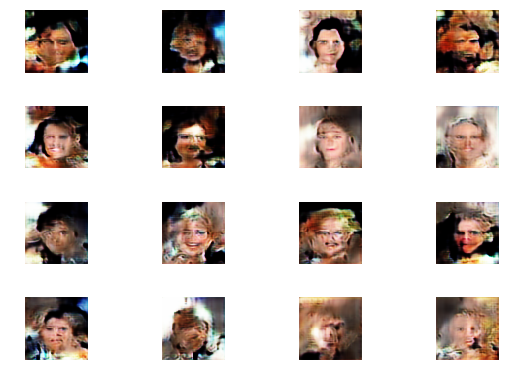

0: [D loss: 0.464501, acc: 0.796875] [A loss: 1.814549, acc: 0.265625]
1: [D loss: 0.620486, acc: 0.734375] [A loss: 2.254813, acc: 0.171875]
2: [D loss: 0.463718, acc: 0.789062] [A loss: 2.205236, acc: 0.140625]
3: [D loss: 0.697863, acc: 0.703125] [A loss: 1.978431, acc: 0.203125]
4: [D loss: 0.538729, acc: 0.765625] [A loss: 1.964667, acc: 0.109375]
5: [D loss: 0.458564, acc: 0.789062] [A loss: 2.016512, acc: 0.203125]
6: [D loss: 0.465042, acc: 0.773438] [A loss: 2.201866, acc: 0.140625]
7: [D loss: 0.609692, acc: 0.726562] [A loss: 1.959159, acc: 0.187500]
8: [D loss: 0.539306, acc: 0.703125] [A loss: 2.089630, acc: 0.218750]
9: [D loss: 0.523156, acc: 0.781250] [A loss: 2.329292, acc: 0.156250]
10: [D loss: 0.608414, acc: 0.687500] [A loss: 2.205906, acc: 0.187500]
11: [D loss: 0.514599, acc: 0.765625] [A loss: 1.825132, acc: 0.296875]
12: [D loss: 0.491563, acc: 0.773438] [A loss: 1.840723, acc: 0.218750]
13: [D loss: 0.540826, acc: 0.726562] [A loss: 1.966842, acc: 0.187500]
14

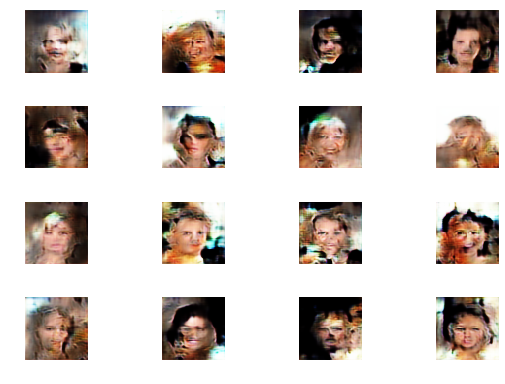

0: [D loss: 0.564416, acc: 0.718750] [A loss: 2.030817, acc: 0.187500]
1: [D loss: 0.547719, acc: 0.742188] [A loss: 1.967125, acc: 0.203125]
2: [D loss: 0.500994, acc: 0.796875] [A loss: 2.036589, acc: 0.171875]
3: [D loss: 0.594320, acc: 0.750000] [A loss: 1.732176, acc: 0.250000]
4: [D loss: 0.635894, acc: 0.734375] [A loss: 1.716838, acc: 0.265625]
5: [D loss: 0.446352, acc: 0.773438] [A loss: 1.931113, acc: 0.281250]
6: [D loss: 0.445415, acc: 0.789062] [A loss: 1.796433, acc: 0.250000]
7: [D loss: 0.561511, acc: 0.781250] [A loss: 1.982091, acc: 0.171875]
8: [D loss: 0.688840, acc: 0.671875] [A loss: 1.627545, acc: 0.187500]
9: [D loss: 0.489320, acc: 0.820312] [A loss: 2.115276, acc: 0.156250]
10: [D loss: 0.458024, acc: 0.789062] [A loss: 1.834788, acc: 0.234375]
11: [D loss: 0.553847, acc: 0.757812] [A loss: 1.999691, acc: 0.218750]
12: [D loss: 0.575929, acc: 0.750000] [A loss: 1.819387, acc: 0.218750]
13: [D loss: 0.560025, acc: 0.726562] [A loss: 1.773014, acc: 0.250000]
14

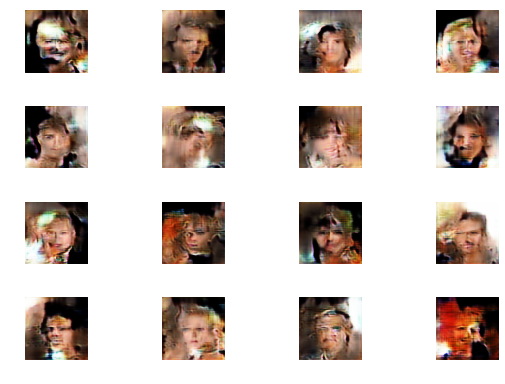

0: [D loss: 0.608785, acc: 0.703125] [A loss: 1.765031, acc: 0.281250]
1: [D loss: 0.608667, acc: 0.734375] [A loss: 1.764185, acc: 0.203125]
2: [D loss: 0.620696, acc: 0.718750] [A loss: 2.112339, acc: 0.109375]
3: [D loss: 0.695549, acc: 0.703125] [A loss: 1.678810, acc: 0.187500]
4: [D loss: 0.544308, acc: 0.726562] [A loss: 1.792121, acc: 0.281250]
5: [D loss: 0.464581, acc: 0.789062] [A loss: 1.996886, acc: 0.250000]
6: [D loss: 0.757224, acc: 0.656250] [A loss: 2.089234, acc: 0.203125]
7: [D loss: 0.597254, acc: 0.750000] [A loss: 1.972775, acc: 0.265625]
8: [D loss: 0.594681, acc: 0.718750] [A loss: 2.127779, acc: 0.187500]
9: [D loss: 0.542620, acc: 0.742188] [A loss: 1.812687, acc: 0.234375]
10: [D loss: 0.407151, acc: 0.804688] [A loss: 1.726468, acc: 0.328125]
11: [D loss: 0.489349, acc: 0.757812] [A loss: 1.854056, acc: 0.281250]
12: [D loss: 0.443874, acc: 0.796875] [A loss: 1.827578, acc: 0.187500]
13: [D loss: 0.609687, acc: 0.710938] [A loss: 1.880038, acc: 0.250000]
14

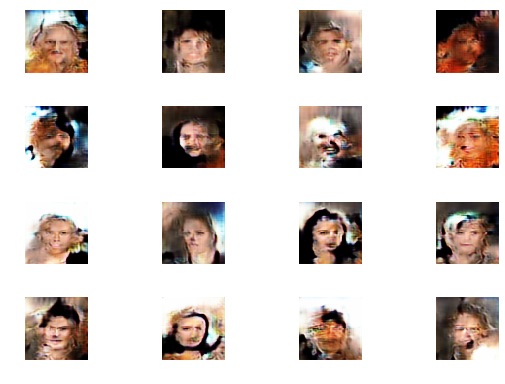

0: [D loss: 0.595318, acc: 0.750000] [A loss: 1.705557, acc: 0.312500]
1: [D loss: 0.407267, acc: 0.796875] [A loss: 1.721134, acc: 0.265625]
2: [D loss: 0.583471, acc: 0.726562] [A loss: 1.706537, acc: 0.218750]
3: [D loss: 0.599157, acc: 0.679688] [A loss: 2.085509, acc: 0.234375]
4: [D loss: 0.502684, acc: 0.796875] [A loss: 1.857284, acc: 0.250000]
5: [D loss: 0.480344, acc: 0.781250] [A loss: 2.035698, acc: 0.203125]
6: [D loss: 0.644819, acc: 0.679688] [A loss: 1.937409, acc: 0.171875]
7: [D loss: 0.565186, acc: 0.781250] [A loss: 1.900172, acc: 0.218750]
8: [D loss: 0.660083, acc: 0.710938] [A loss: 1.858867, acc: 0.203125]
9: [D loss: 0.413245, acc: 0.859375] [A loss: 1.637664, acc: 0.312500]
10: [D loss: 0.580401, acc: 0.726562] [A loss: 1.922353, acc: 0.234375]
11: [D loss: 0.622007, acc: 0.679688] [A loss: 1.733802, acc: 0.218750]
12: [D loss: 0.581430, acc: 0.726562] [A loss: 1.851295, acc: 0.234375]
13: [D loss: 0.555146, acc: 0.718750] [A loss: 2.097429, acc: 0.218750]
14

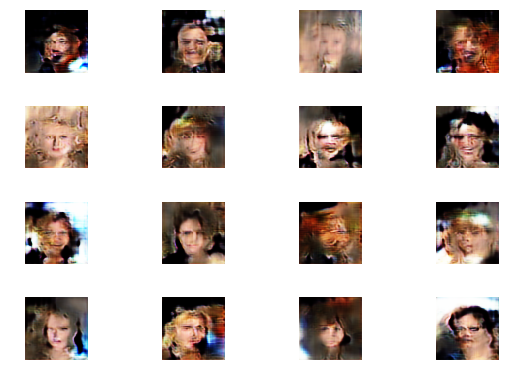

0: [D loss: 0.708774, acc: 0.640625] [A loss: 1.886755, acc: 0.187500]
1: [D loss: 0.619265, acc: 0.703125] [A loss: 1.827667, acc: 0.218750]
2: [D loss: 0.648948, acc: 0.695312] [A loss: 1.916160, acc: 0.250000]
3: [D loss: 0.792732, acc: 0.617188] [A loss: 1.931643, acc: 0.156250]
4: [D loss: 0.612172, acc: 0.687500] [A loss: 1.887809, acc: 0.187500]
5: [D loss: 0.451157, acc: 0.742188] [A loss: 2.093678, acc: 0.265625]
6: [D loss: 0.615688, acc: 0.734375] [A loss: 2.093366, acc: 0.203125]
7: [D loss: 0.611712, acc: 0.703125] [A loss: 2.079482, acc: 0.156250]
8: [D loss: 0.677838, acc: 0.703125] [A loss: 2.133389, acc: 0.187500]
9: [D loss: 0.497454, acc: 0.773438] [A loss: 2.062178, acc: 0.187500]
10: [D loss: 0.698192, acc: 0.687500] [A loss: 1.872812, acc: 0.218750]
11: [D loss: 0.590472, acc: 0.765625] [A loss: 1.995565, acc: 0.218750]
12: [D loss: 0.521272, acc: 0.750000] [A loss: 1.866275, acc: 0.328125]
13: [D loss: 0.588712, acc: 0.710938] [A loss: 2.047746, acc: 0.187500]
14

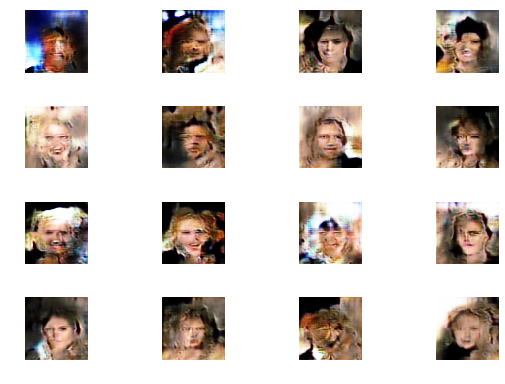

0: [D loss: 0.541611, acc: 0.742188] [A loss: 1.728435, acc: 0.140625]
1: [D loss: 0.623127, acc: 0.726562] [A loss: 1.583508, acc: 0.296875]
2: [D loss: 0.597696, acc: 0.734375] [A loss: 1.752113, acc: 0.250000]
3: [D loss: 0.526038, acc: 0.773438] [A loss: 1.770581, acc: 0.203125]
4: [D loss: 0.567877, acc: 0.718750] [A loss: 2.071062, acc: 0.156250]
5: [D loss: 0.542169, acc: 0.742188] [A loss: 1.778753, acc: 0.234375]
6: [D loss: 0.465687, acc: 0.781250] [A loss: 1.552141, acc: 0.265625]
7: [D loss: 0.553888, acc: 0.710938] [A loss: 1.701906, acc: 0.265625]
8: [D loss: 0.853862, acc: 0.578125] [A loss: 1.517323, acc: 0.312500]
9: [D loss: 0.423902, acc: 0.781250] [A loss: 1.798319, acc: 0.203125]
10: [D loss: 0.659689, acc: 0.718750] [A loss: 1.636092, acc: 0.296875]
11: [D loss: 0.651260, acc: 0.695312] [A loss: 1.511812, acc: 0.312500]
12: [D loss: 0.596452, acc: 0.703125] [A loss: 1.754619, acc: 0.265625]
13: [D loss: 0.534221, acc: 0.742188] [A loss: 1.776733, acc: 0.156250]
14

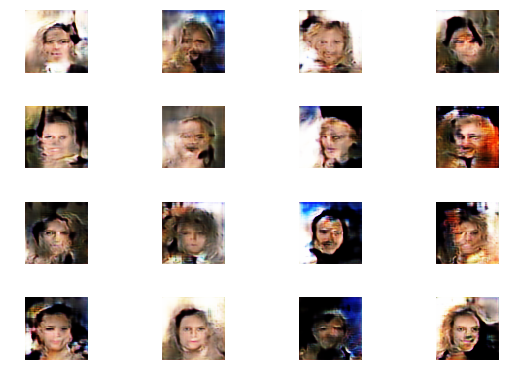

0: [D loss: 0.589599, acc: 0.750000] [A loss: 1.546313, acc: 0.312500]
1: [D loss: 0.631608, acc: 0.718750] [A loss: 1.820433, acc: 0.203125]
2: [D loss: 0.550638, acc: 0.742188] [A loss: 1.890789, acc: 0.218750]
3: [D loss: 0.567627, acc: 0.750000] [A loss: 1.931202, acc: 0.265625]
4: [D loss: 0.721123, acc: 0.695312] [A loss: 1.894017, acc: 0.218750]
5: [D loss: 0.394400, acc: 0.835938] [A loss: 1.677840, acc: 0.250000]
6: [D loss: 0.507366, acc: 0.773438] [A loss: 1.656687, acc: 0.312500]
7: [D loss: 0.568162, acc: 0.750000] [A loss: 1.774134, acc: 0.296875]
8: [D loss: 0.592603, acc: 0.726562] [A loss: 1.667789, acc: 0.250000]
9: [D loss: 0.705201, acc: 0.703125] [A loss: 1.884945, acc: 0.296875]
10: [D loss: 0.653240, acc: 0.710938] [A loss: 1.722035, acc: 0.296875]
11: [D loss: 0.628478, acc: 0.664062] [A loss: 1.888909, acc: 0.234375]
12: [D loss: 0.524385, acc: 0.765625] [A loss: 1.500968, acc: 0.281250]
13: [D loss: 0.606623, acc: 0.757812] [A loss: 1.765311, acc: 0.156250]
14

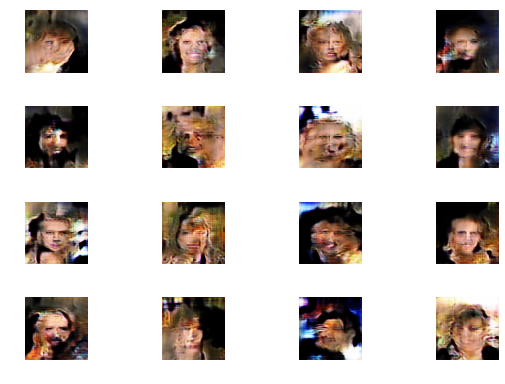

0: [D loss: 0.676878, acc: 0.687500] [A loss: 1.721321, acc: 0.296875]
1: [D loss: 0.660452, acc: 0.679688] [A loss: 1.794536, acc: 0.218750]
2: [D loss: 0.719065, acc: 0.679688] [A loss: 1.905905, acc: 0.156250]
3: [D loss: 0.463602, acc: 0.726562] [A loss: 1.824227, acc: 0.171875]
4: [D loss: 0.530806, acc: 0.742188] [A loss: 1.917291, acc: 0.250000]
5: [D loss: 0.639879, acc: 0.726562] [A loss: 1.647966, acc: 0.296875]
6: [D loss: 0.595102, acc: 0.695312] [A loss: 1.808814, acc: 0.218750]
7: [D loss: 0.528932, acc: 0.773438] [A loss: 1.721617, acc: 0.250000]
8: [D loss: 0.596978, acc: 0.734375] [A loss: 1.851568, acc: 0.203125]
9: [D loss: 0.571522, acc: 0.687500] [A loss: 2.332084, acc: 0.187500]
10: [D loss: 0.642522, acc: 0.726562] [A loss: 1.928258, acc: 0.171875]
11: [D loss: 0.453148, acc: 0.773438] [A loss: 1.917864, acc: 0.187500]
12: [D loss: 0.547678, acc: 0.742188] [A loss: 1.677370, acc: 0.218750]
13: [D loss: 0.654600, acc: 0.679688] [A loss: 1.913884, acc: 0.218750]
14

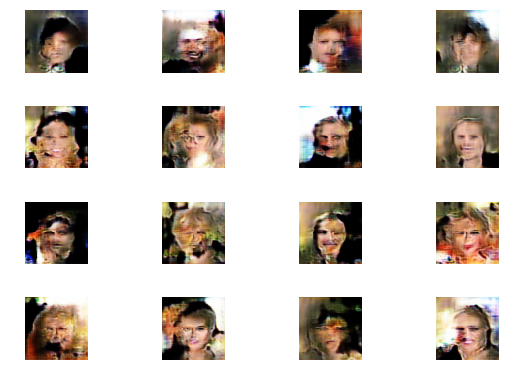

0: [D loss: 0.558913, acc: 0.757812] [A loss: 1.788174, acc: 0.171875]
1: [D loss: 0.585230, acc: 0.718750] [A loss: 1.697500, acc: 0.234375]
2: [D loss: 0.650361, acc: 0.671875] [A loss: 1.731677, acc: 0.234375]
3: [D loss: 0.639401, acc: 0.718750] [A loss: 1.651532, acc: 0.250000]
4: [D loss: 0.655387, acc: 0.679688] [A loss: 1.783362, acc: 0.234375]
5: [D loss: 0.569735, acc: 0.757812] [A loss: 1.564733, acc: 0.281250]
6: [D loss: 0.621546, acc: 0.703125] [A loss: 1.842916, acc: 0.234375]
7: [D loss: 0.621447, acc: 0.726562] [A loss: 1.833797, acc: 0.250000]
8: [D loss: 0.553258, acc: 0.742188] [A loss: 1.808613, acc: 0.281250]
9: [D loss: 0.640429, acc: 0.742188] [A loss: 1.746625, acc: 0.265625]
10: [D loss: 0.564005, acc: 0.765625] [A loss: 1.938634, acc: 0.296875]
11: [D loss: 0.490870, acc: 0.718750] [A loss: 2.167552, acc: 0.187500]
12: [D loss: 0.613784, acc: 0.703125] [A loss: 1.928608, acc: 0.218750]
13: [D loss: 0.590189, acc: 0.718750] [A loss: 1.623620, acc: 0.312500]
14

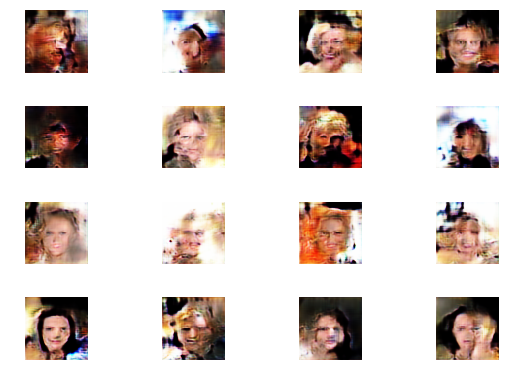

0: [D loss: 0.540041, acc: 0.710938] [A loss: 1.945479, acc: 0.218750]
1: [D loss: 0.637598, acc: 0.679688] [A loss: 1.982572, acc: 0.234375]
2: [D loss: 0.631684, acc: 0.671875] [A loss: 2.274483, acc: 0.109375]
3: [D loss: 0.617660, acc: 0.726562] [A loss: 1.677553, acc: 0.265625]
4: [D loss: 0.600670, acc: 0.726562] [A loss: 2.192921, acc: 0.203125]
5: [D loss: 0.638050, acc: 0.718750] [A loss: 1.961242, acc: 0.156250]
6: [D loss: 0.629931, acc: 0.710938] [A loss: 2.129251, acc: 0.187500]
7: [D loss: 0.366916, acc: 0.882812] [A loss: 2.024045, acc: 0.218750]
8: [D loss: 0.616680, acc: 0.750000] [A loss: 1.852566, acc: 0.265625]
9: [D loss: 0.623691, acc: 0.703125] [A loss: 2.324697, acc: 0.171875]
10: [D loss: 0.583660, acc: 0.734375] [A loss: 2.155847, acc: 0.171875]
11: [D loss: 0.653855, acc: 0.710938] [A loss: 1.934990, acc: 0.265625]
12: [D loss: 0.633104, acc: 0.679688] [A loss: 1.706335, acc: 0.265625]
13: [D loss: 0.668529, acc: 0.710938] [A loss: 1.671241, acc: 0.390625]
14

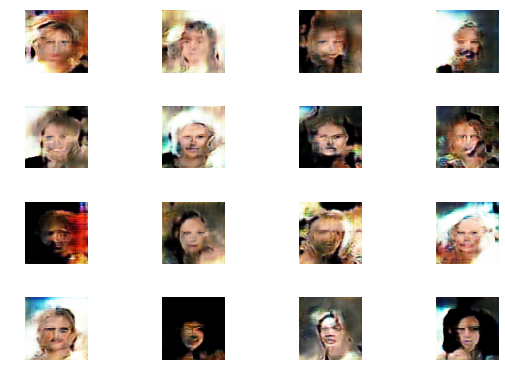

0: [D loss: 0.638310, acc: 0.726562] [A loss: 2.044018, acc: 0.203125]
1: [D loss: 0.623816, acc: 0.718750] [A loss: 1.628427, acc: 0.281250]
2: [D loss: 0.668117, acc: 0.742188] [A loss: 2.149644, acc: 0.203125]
3: [D loss: 0.615601, acc: 0.718750] [A loss: 2.046313, acc: 0.250000]
4: [D loss: 0.565170, acc: 0.734375] [A loss: 1.742409, acc: 0.234375]
5: [D loss: 0.603244, acc: 0.726562] [A loss: 1.554538, acc: 0.296875]
6: [D loss: 0.634035, acc: 0.718750] [A loss: 1.913240, acc: 0.218750]
7: [D loss: 0.625123, acc: 0.726562] [A loss: 1.949686, acc: 0.265625]
8: [D loss: 0.573760, acc: 0.734375] [A loss: 1.787139, acc: 0.234375]
9: [D loss: 0.640172, acc: 0.734375] [A loss: 1.977185, acc: 0.234375]
10: [D loss: 0.545631, acc: 0.765625] [A loss: 1.906466, acc: 0.203125]
11: [D loss: 0.590361, acc: 0.710938] [A loss: 2.029988, acc: 0.218750]
12: [D loss: 0.601381, acc: 0.687500] [A loss: 1.964470, acc: 0.171875]
13: [D loss: 0.581089, acc: 0.765625] [A loss: 1.791341, acc: 0.265625]
14

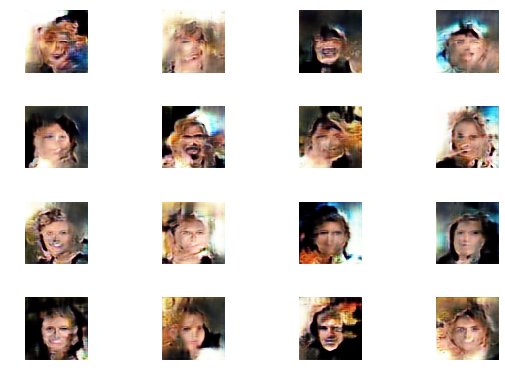

0: [D loss: 0.797499, acc: 0.632812] [A loss: 1.707853, acc: 0.187500]
1: [D loss: 0.696070, acc: 0.710938] [A loss: 1.856315, acc: 0.265625]
2: [D loss: 0.548722, acc: 0.757812] [A loss: 1.897896, acc: 0.296875]
3: [D loss: 0.553763, acc: 0.804688] [A loss: 1.908255, acc: 0.203125]
4: [D loss: 0.525996, acc: 0.742188] [A loss: 1.877448, acc: 0.218750]
5: [D loss: 0.534644, acc: 0.781250] [A loss: 1.781489, acc: 0.140625]
6: [D loss: 0.590363, acc: 0.695312] [A loss: 1.926693, acc: 0.156250]
7: [D loss: 0.664079, acc: 0.679688] [A loss: 2.229327, acc: 0.171875]
8: [D loss: 0.505185, acc: 0.781250] [A loss: 1.787245, acc: 0.328125]
9: [D loss: 0.700688, acc: 0.695312] [A loss: 1.574283, acc: 0.328125]
10: [D loss: 0.724646, acc: 0.671875] [A loss: 1.861227, acc: 0.250000]
11: [D loss: 0.563554, acc: 0.734375] [A loss: 1.470253, acc: 0.359375]
12: [D loss: 0.591386, acc: 0.750000] [A loss: 1.701737, acc: 0.328125]
13: [D loss: 0.632720, acc: 0.687500] [A loss: 1.567089, acc: 0.234375]
14

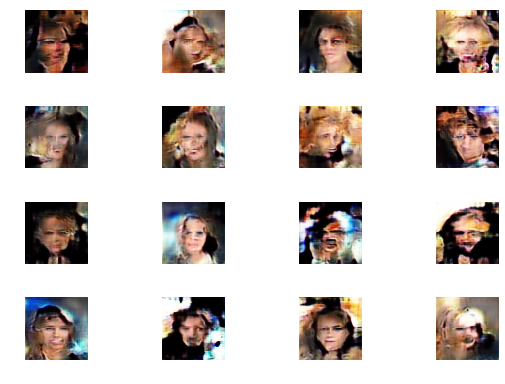

0: [D loss: 0.628652, acc: 0.726562] [A loss: 1.814980, acc: 0.218750]
1: [D loss: 0.493405, acc: 0.726562] [A loss: 1.874887, acc: 0.234375]
2: [D loss: 0.687326, acc: 0.664062] [A loss: 1.715703, acc: 0.265625]
3: [D loss: 0.691429, acc: 0.703125] [A loss: 1.644190, acc: 0.250000]
4: [D loss: 0.644148, acc: 0.710938] [A loss: 1.749703, acc: 0.203125]
5: [D loss: 0.533436, acc: 0.773438] [A loss: 1.742371, acc: 0.234375]
6: [D loss: 0.668248, acc: 0.734375] [A loss: 1.760486, acc: 0.281250]
7: [D loss: 0.598568, acc: 0.710938] [A loss: 1.646218, acc: 0.218750]
8: [D loss: 0.603276, acc: 0.710938] [A loss: 1.522771, acc: 0.328125]
9: [D loss: 0.697375, acc: 0.656250] [A loss: 1.794253, acc: 0.250000]
10: [D loss: 0.622495, acc: 0.687500] [A loss: 1.760486, acc: 0.218750]
11: [D loss: 0.667825, acc: 0.687500] [A loss: 1.966882, acc: 0.203125]
12: [D loss: 0.589132, acc: 0.703125] [A loss: 2.009233, acc: 0.109375]
13: [D loss: 0.591220, acc: 0.750000] [A loss: 1.758891, acc: 0.187500]
14

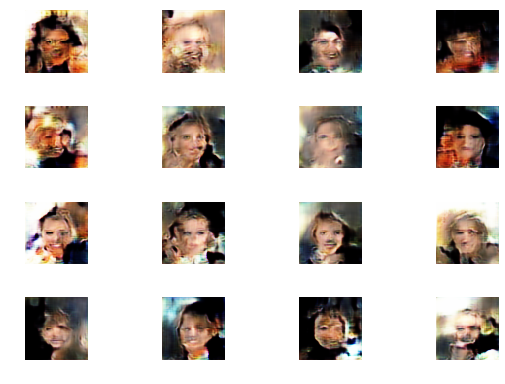

0: [D loss: 0.614953, acc: 0.703125] [A loss: 1.841332, acc: 0.250000]
1: [D loss: 0.703840, acc: 0.687500] [A loss: 1.765208, acc: 0.187500]
2: [D loss: 0.596873, acc: 0.726562] [A loss: 1.731271, acc: 0.375000]
3: [D loss: 0.577570, acc: 0.734375] [A loss: 1.802382, acc: 0.218750]
4: [D loss: 0.858600, acc: 0.609375] [A loss: 1.575209, acc: 0.296875]
5: [D loss: 0.627640, acc: 0.710938] [A loss: 2.101851, acc: 0.218750]
6: [D loss: 0.581237, acc: 0.695312] [A loss: 1.702943, acc: 0.218750]
7: [D loss: 0.538336, acc: 0.804688] [A loss: 1.868557, acc: 0.234375]
8: [D loss: 0.622025, acc: 0.687500] [A loss: 1.853369, acc: 0.171875]
9: [D loss: 0.532939, acc: 0.726562] [A loss: 1.712846, acc: 0.250000]
10: [D loss: 0.678926, acc: 0.679688] [A loss: 1.732442, acc: 0.218750]
11: [D loss: 0.598519, acc: 0.726562] [A loss: 1.837868, acc: 0.234375]
12: [D loss: 0.508990, acc: 0.765625] [A loss: 1.640981, acc: 0.296875]
13: [D loss: 0.519923, acc: 0.757812] [A loss: 1.494237, acc: 0.343750]
14

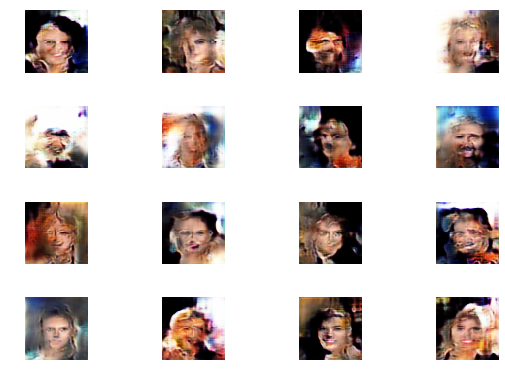

0: [D loss: 0.667676, acc: 0.726562] [A loss: 1.529284, acc: 0.281250]
1: [D loss: 0.621091, acc: 0.687500] [A loss: 1.367222, acc: 0.375000]
2: [D loss: 0.773606, acc: 0.648438] [A loss: 1.680300, acc: 0.234375]
3: [D loss: 0.627791, acc: 0.703125] [A loss: 1.618986, acc: 0.281250]
4: [D loss: 0.757433, acc: 0.703125] [A loss: 1.896785, acc: 0.218750]
5: [D loss: 0.677124, acc: 0.718750] [A loss: 1.781622, acc: 0.265625]
6: [D loss: 0.646475, acc: 0.648438] [A loss: 1.392009, acc: 0.328125]
7: [D loss: 0.672221, acc: 0.687500] [A loss: 1.914589, acc: 0.187500]
8: [D loss: 0.644121, acc: 0.734375] [A loss: 1.580852, acc: 0.281250]
9: [D loss: 0.517850, acc: 0.742188] [A loss: 1.688269, acc: 0.250000]
10: [D loss: 0.573853, acc: 0.710938] [A loss: 1.639778, acc: 0.312500]
11: [D loss: 0.540295, acc: 0.750000] [A loss: 1.846439, acc: 0.187500]
12: [D loss: 0.764992, acc: 0.664062] [A loss: 1.476134, acc: 0.359375]
13: [D loss: 0.582232, acc: 0.742188] [A loss: 1.538797, acc: 0.250000]
14

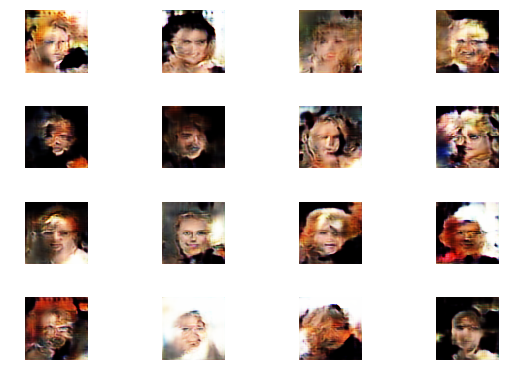

0: [D loss: 0.618760, acc: 0.703125] [A loss: 2.174318, acc: 0.187500]
1: [D loss: 0.665600, acc: 0.687500] [A loss: 1.801915, acc: 0.312500]
2: [D loss: 0.556897, acc: 0.734375] [A loss: 1.897859, acc: 0.171875]
3: [D loss: 0.742559, acc: 0.625000] [A loss: 2.035648, acc: 0.218750]
4: [D loss: 0.565204, acc: 0.726562] [A loss: 1.727301, acc: 0.250000]
5: [D loss: 0.661638, acc: 0.718750] [A loss: 1.787394, acc: 0.203125]
6: [D loss: 0.661916, acc: 0.671875] [A loss: 1.320610, acc: 0.375000]
7: [D loss: 0.674657, acc: 0.710938] [A loss: 1.831829, acc: 0.203125]
8: [D loss: 0.765147, acc: 0.664062] [A loss: 1.660848, acc: 0.265625]
9: [D loss: 0.799752, acc: 0.632812] [A loss: 1.959827, acc: 0.265625]
10: [D loss: 0.630986, acc: 0.703125] [A loss: 1.773537, acc: 0.234375]
11: [D loss: 0.772998, acc: 0.703125] [A loss: 1.918467, acc: 0.281250]
12: [D loss: 0.713441, acc: 0.656250] [A loss: 1.591601, acc: 0.328125]
13: [D loss: 0.627062, acc: 0.695312] [A loss: 1.654558, acc: 0.218750]
14

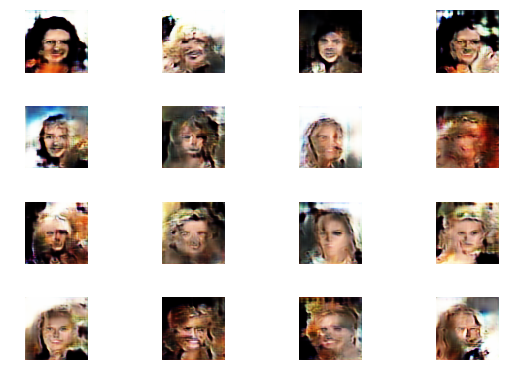

0: [D loss: 0.808518, acc: 0.640625] [A loss: 1.700405, acc: 0.296875]
1: [D loss: 0.671949, acc: 0.695312] [A loss: 1.658950, acc: 0.250000]
2: [D loss: 0.689182, acc: 0.664062] [A loss: 1.282091, acc: 0.421875]
3: [D loss: 0.564179, acc: 0.765625] [A loss: 1.670602, acc: 0.265625]
4: [D loss: 0.585692, acc: 0.742188] [A loss: 1.832198, acc: 0.265625]
5: [D loss: 0.673485, acc: 0.632812] [A loss: 1.777019, acc: 0.281250]
6: [D loss: 0.648090, acc: 0.710938] [A loss: 1.459417, acc: 0.250000]
7: [D loss: 0.799014, acc: 0.625000] [A loss: 1.724138, acc: 0.234375]
8: [D loss: 0.755311, acc: 0.617188] [A loss: 1.439122, acc: 0.375000]
9: [D loss: 0.751999, acc: 0.734375] [A loss: 1.965137, acc: 0.187500]
10: [D loss: 0.513749, acc: 0.718750] [A loss: 1.835749, acc: 0.250000]
11: [D loss: 0.830955, acc: 0.617188] [A loss: 1.573142, acc: 0.328125]
12: [D loss: 0.874970, acc: 0.570312] [A loss: 1.487666, acc: 0.359375]
13: [D loss: 0.510622, acc: 0.757812] [A loss: 1.831410, acc: 0.218750]
14

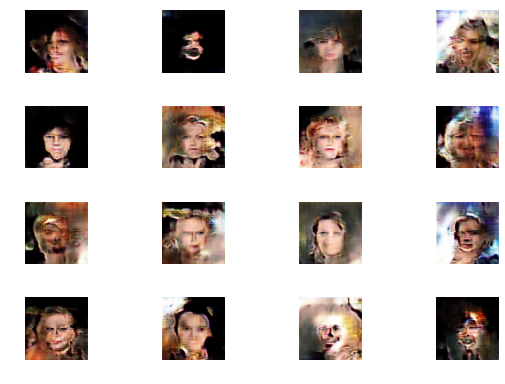

0: [D loss: 0.621281, acc: 0.718750] [A loss: 1.538799, acc: 0.312500]
1: [D loss: 0.648104, acc: 0.679688] [A loss: 1.764802, acc: 0.281250]
2: [D loss: 0.636389, acc: 0.703125] [A loss: 1.842001, acc: 0.250000]
3: [D loss: 0.625441, acc: 0.710938] [A loss: 1.453072, acc: 0.375000]
4: [D loss: 0.725734, acc: 0.640625] [A loss: 1.637690, acc: 0.281250]
5: [D loss: 0.638630, acc: 0.703125] [A loss: 1.648818, acc: 0.312500]
6: [D loss: 0.639359, acc: 0.679688] [A loss: 1.424832, acc: 0.375000]
7: [D loss: 0.610337, acc: 0.687500] [A loss: 1.209312, acc: 0.406250]
8: [D loss: 0.749131, acc: 0.679688] [A loss: 1.323517, acc: 0.359375]
9: [D loss: 0.683410, acc: 0.718750] [A loss: 1.548976, acc: 0.250000]
10: [D loss: 0.693958, acc: 0.664062] [A loss: 1.333728, acc: 0.375000]
11: [D loss: 0.852635, acc: 0.601562] [A loss: 1.602892, acc: 0.296875]
12: [D loss: 0.628733, acc: 0.695312] [A loss: 1.378544, acc: 0.328125]
13: [D loss: 0.749439, acc: 0.648438] [A loss: 1.608628, acc: 0.265625]
14

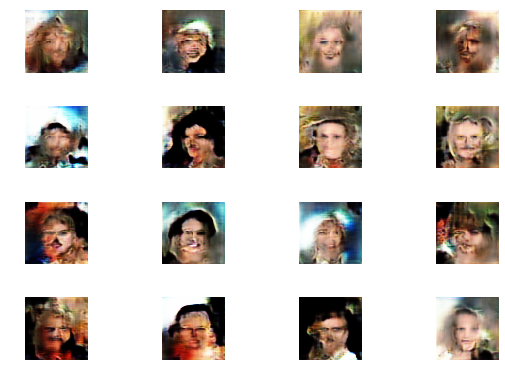

0: [D loss: 0.625379, acc: 0.695312] [A loss: 1.285395, acc: 0.453125]
1: [D loss: 0.700919, acc: 0.617188] [A loss: 1.942478, acc: 0.171875]
2: [D loss: 0.701443, acc: 0.679688] [A loss: 1.789604, acc: 0.218750]
3: [D loss: 0.698402, acc: 0.671875] [A loss: 1.842189, acc: 0.203125]
4: [D loss: 0.762772, acc: 0.601562] [A loss: 1.746546, acc: 0.328125]
5: [D loss: 0.703575, acc: 0.718750] [A loss: 1.437403, acc: 0.281250]
6: [D loss: 0.891176, acc: 0.578125] [A loss: 1.785470, acc: 0.296875]
7: [D loss: 0.628794, acc: 0.726562] [A loss: 1.419533, acc: 0.328125]
8: [D loss: 0.679667, acc: 0.687500] [A loss: 1.511559, acc: 0.265625]
9: [D loss: 0.708897, acc: 0.632812] [A loss: 1.753701, acc: 0.250000]
10: [D loss: 0.700359, acc: 0.648438] [A loss: 1.725924, acc: 0.296875]
11: [D loss: 0.733664, acc: 0.632812] [A loss: 1.518201, acc: 0.281250]
12: [D loss: 0.747241, acc: 0.671875] [A loss: 1.592341, acc: 0.281250]
13: [D loss: 0.660031, acc: 0.726562] [A loss: 1.527539, acc: 0.281250]
14

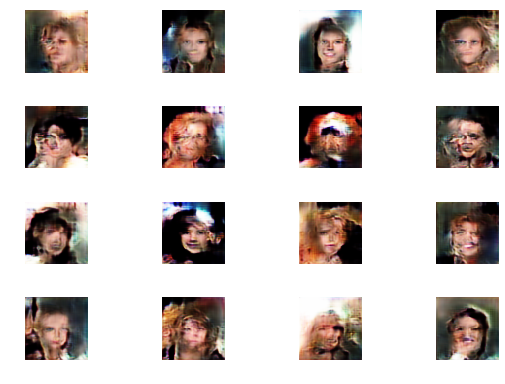

0: [D loss: 0.699152, acc: 0.640625] [A loss: 1.792297, acc: 0.218750]
1: [D loss: 0.733060, acc: 0.664062] [A loss: 1.752476, acc: 0.187500]
2: [D loss: 0.600678, acc: 0.734375] [A loss: 1.536241, acc: 0.281250]
3: [D loss: 0.786874, acc: 0.609375] [A loss: 1.545634, acc: 0.406250]
4: [D loss: 0.842467, acc: 0.601562] [A loss: 1.503128, acc: 0.187500]
5: [D loss: 0.745379, acc: 0.632812] [A loss: 1.546599, acc: 0.437500]
6: [D loss: 0.607951, acc: 0.703125] [A loss: 1.693237, acc: 0.250000]
7: [D loss: 0.631718, acc: 0.703125] [A loss: 1.760192, acc: 0.265625]
8: [D loss: 0.765311, acc: 0.593750] [A loss: 1.746200, acc: 0.234375]
9: [D loss: 0.716278, acc: 0.664062] [A loss: 1.827588, acc: 0.328125]
10: [D loss: 0.767184, acc: 0.687500] [A loss: 1.735461, acc: 0.218750]
11: [D loss: 0.622758, acc: 0.664062] [A loss: 1.556911, acc: 0.265625]
12: [D loss: 0.764383, acc: 0.648438] [A loss: 1.723060, acc: 0.250000]
13: [D loss: 0.644655, acc: 0.648438] [A loss: 1.913528, acc: 0.187500]
14

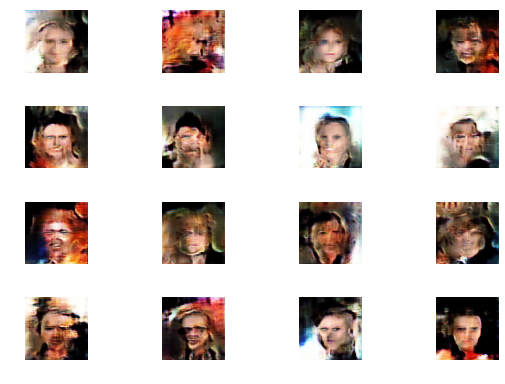

0: [D loss: 0.646306, acc: 0.703125] [A loss: 1.820306, acc: 0.265625]
1: [D loss: 0.780580, acc: 0.671875] [A loss: 1.441968, acc: 0.421875]
2: [D loss: 0.775336, acc: 0.671875] [A loss: 1.488950, acc: 0.296875]
3: [D loss: 0.665360, acc: 0.664062] [A loss: 1.602117, acc: 0.343750]
4: [D loss: 0.642763, acc: 0.687500] [A loss: 1.390780, acc: 0.265625]
5: [D loss: 0.585553, acc: 0.671875] [A loss: 1.671960, acc: 0.296875]
6: [D loss: 0.600308, acc: 0.726562] [A loss: 1.451926, acc: 0.250000]
7: [D loss: 0.633505, acc: 0.703125] [A loss: 1.913451, acc: 0.234375]
8: [D loss: 0.641421, acc: 0.671875] [A loss: 1.713288, acc: 0.203125]
9: [D loss: 0.696236, acc: 0.671875] [A loss: 1.479087, acc: 0.343750]
10: [D loss: 0.642588, acc: 0.664062] [A loss: 1.803475, acc: 0.203125]
11: [D loss: 0.655252, acc: 0.679688] [A loss: 1.777725, acc: 0.203125]
12: [D loss: 0.791424, acc: 0.648438] [A loss: 1.403925, acc: 0.375000]
13: [D loss: 0.916473, acc: 0.609375] [A loss: 1.873712, acc: 0.296875]
14

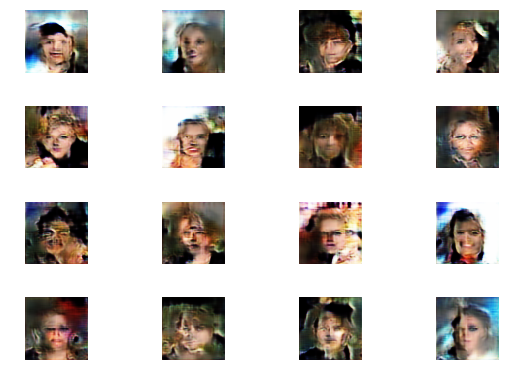

0: [D loss: 0.552236, acc: 0.750000] [A loss: 1.629387, acc: 0.312500]
1: [D loss: 0.684776, acc: 0.703125] [A loss: 1.646135, acc: 0.250000]
2: [D loss: 0.720600, acc: 0.656250] [A loss: 1.621843, acc: 0.265625]
3: [D loss: 0.794692, acc: 0.648438] [A loss: 1.385790, acc: 0.343750]
4: [D loss: 0.570617, acc: 0.718750] [A loss: 1.754616, acc: 0.312500]
5: [D loss: 0.675506, acc: 0.695312] [A loss: 1.570607, acc: 0.296875]
6: [D loss: 0.740598, acc: 0.640625] [A loss: 1.550626, acc: 0.312500]
7: [D loss: 0.666909, acc: 0.625000] [A loss: 1.703017, acc: 0.281250]
8: [D loss: 0.978975, acc: 0.554688] [A loss: 1.749481, acc: 0.250000]
9: [D loss: 0.588271, acc: 0.679688] [A loss: 1.872093, acc: 0.265625]
10: [D loss: 0.639644, acc: 0.679688] [A loss: 1.771917, acc: 0.234375]
11: [D loss: 0.621053, acc: 0.679688] [A loss: 1.652130, acc: 0.312500]
12: [D loss: 0.638038, acc: 0.687500] [A loss: 1.819609, acc: 0.281250]
13: [D loss: 0.624983, acc: 0.687500] [A loss: 1.789593, acc: 0.281250]
14

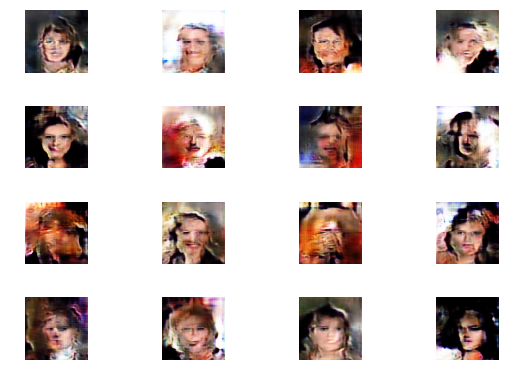

0: [D loss: 0.679776, acc: 0.726562] [A loss: 1.932590, acc: 0.203125]
1: [D loss: 0.608064, acc: 0.718750] [A loss: 1.893013, acc: 0.171875]
2: [D loss: 0.645941, acc: 0.726562] [A loss: 1.854924, acc: 0.218750]
3: [D loss: 0.591496, acc: 0.687500] [A loss: 1.659329, acc: 0.218750]
4: [D loss: 0.690063, acc: 0.679688] [A loss: 1.831328, acc: 0.296875]
5: [D loss: 0.598391, acc: 0.734375] [A loss: 1.653748, acc: 0.250000]
6: [D loss: 0.630798, acc: 0.671875] [A loss: 1.633241, acc: 0.296875]
7: [D loss: 0.634535, acc: 0.718750] [A loss: 1.619038, acc: 0.328125]
8: [D loss: 0.914064, acc: 0.632812] [A loss: 1.531978, acc: 0.343750]
9: [D loss: 0.665071, acc: 0.695312] [A loss: 1.589530, acc: 0.390625]
10: [D loss: 0.718076, acc: 0.687500] [A loss: 1.697995, acc: 0.250000]
11: [D loss: 0.698470, acc: 0.664062] [A loss: 1.933268, acc: 0.218750]
12: [D loss: 0.671723, acc: 0.671875] [A loss: 1.799965, acc: 0.328125]
13: [D loss: 0.486445, acc: 0.781250] [A loss: 1.785063, acc: 0.250000]
14

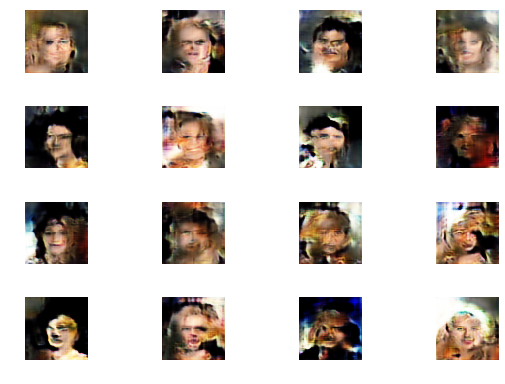

0: [D loss: 0.642187, acc: 0.687500] [A loss: 1.633351, acc: 0.312500]
1: [D loss: 0.769398, acc: 0.640625] [A loss: 1.734115, acc: 0.265625]
2: [D loss: 0.717015, acc: 0.632812] [A loss: 1.752810, acc: 0.281250]
3: [D loss: 0.828039, acc: 0.585938] [A loss: 1.536408, acc: 0.328125]
4: [D loss: 0.611420, acc: 0.742188] [A loss: 2.089494, acc: 0.203125]
5: [D loss: 0.647779, acc: 0.679688] [A loss: 1.852744, acc: 0.281250]
6: [D loss: 0.784842, acc: 0.617188] [A loss: 1.712102, acc: 0.250000]
7: [D loss: 0.590679, acc: 0.710938] [A loss: 1.768599, acc: 0.234375]
8: [D loss: 0.538500, acc: 0.734375] [A loss: 1.511758, acc: 0.312500]
9: [D loss: 0.728422, acc: 0.664062] [A loss: 2.026566, acc: 0.171875]
10: [D loss: 0.610805, acc: 0.765625] [A loss: 1.631074, acc: 0.328125]
11: [D loss: 0.663446, acc: 0.718750] [A loss: 1.447684, acc: 0.359375]
12: [D loss: 0.795961, acc: 0.632812] [A loss: 1.442844, acc: 0.343750]
13: [D loss: 0.667894, acc: 0.695312] [A loss: 1.502092, acc: 0.343750]
14

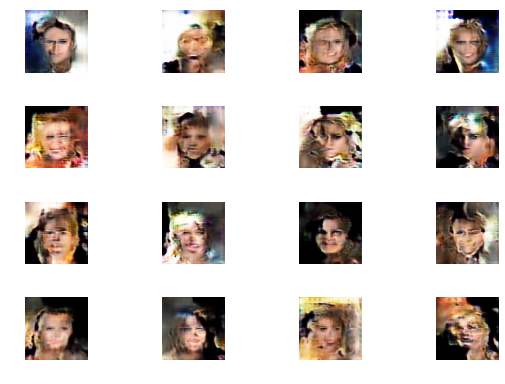

0: [D loss: 0.818294, acc: 0.664062] [A loss: 1.807100, acc: 0.218750]
1: [D loss: 0.881017, acc: 0.593750] [A loss: 1.573038, acc: 0.281250]
2: [D loss: 0.828152, acc: 0.695312] [A loss: 1.531361, acc: 0.250000]
3: [D loss: 0.674260, acc: 0.656250] [A loss: 1.824831, acc: 0.265625]
4: [D loss: 0.559009, acc: 0.726562] [A loss: 1.723590, acc: 0.328125]
5: [D loss: 0.743758, acc: 0.609375] [A loss: 1.672377, acc: 0.265625]
6: [D loss: 0.860028, acc: 0.609375] [A loss: 1.531222, acc: 0.390625]
7: [D loss: 0.813125, acc: 0.585938] [A loss: 1.427844, acc: 0.312500]
8: [D loss: 0.847367, acc: 0.609375] [A loss: 1.748438, acc: 0.265625]
9: [D loss: 0.798678, acc: 0.671875] [A loss: 1.602584, acc: 0.265625]
10: [D loss: 0.878880, acc: 0.609375] [A loss: 1.588762, acc: 0.218750]
11: [D loss: 0.706584, acc: 0.625000] [A loss: 1.746841, acc: 0.218750]
12: [D loss: 0.772841, acc: 0.609375] [A loss: 1.631257, acc: 0.343750]
13: [D loss: 0.661871, acc: 0.664062] [A loss: 1.782339, acc: 0.250000]
14

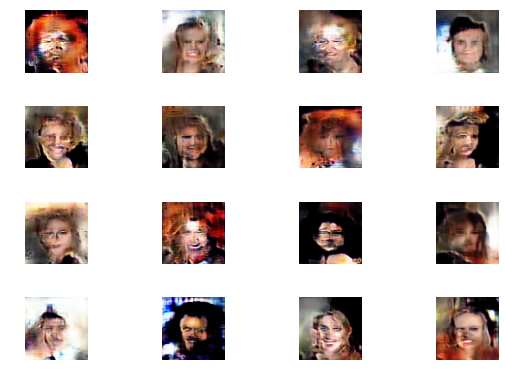

0: [D loss: 0.618914, acc: 0.726562] [A loss: 1.720455, acc: 0.265625]
1: [D loss: 0.826570, acc: 0.664062] [A loss: 1.825176, acc: 0.203125]
2: [D loss: 0.696867, acc: 0.718750] [A loss: 1.671631, acc: 0.312500]
3: [D loss: 0.773019, acc: 0.648438] [A loss: 1.479887, acc: 0.218750]
4: [D loss: 0.736801, acc: 0.640625] [A loss: 1.866270, acc: 0.203125]
5: [D loss: 0.727854, acc: 0.687500] [A loss: 1.724424, acc: 0.281250]
6: [D loss: 0.739343, acc: 0.648438] [A loss: 1.658914, acc: 0.359375]
7: [D loss: 0.698783, acc: 0.695312] [A loss: 2.055223, acc: 0.156250]
8: [D loss: 0.786937, acc: 0.640625] [A loss: 1.390212, acc: 0.312500]
9: [D loss: 0.705314, acc: 0.656250] [A loss: 1.794113, acc: 0.281250]
10: [D loss: 0.601947, acc: 0.726562] [A loss: 1.650265, acc: 0.234375]
11: [D loss: 0.718018, acc: 0.648438] [A loss: 1.752454, acc: 0.265625]
12: [D loss: 0.617582, acc: 0.742188] [A loss: 1.661157, acc: 0.328125]
13: [D loss: 0.732714, acc: 0.632812] [A loss: 1.653432, acc: 0.296875]
14

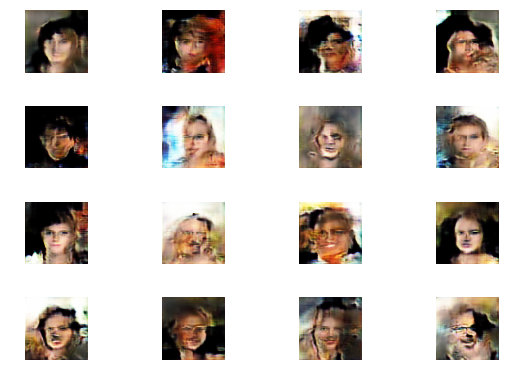

0: [D loss: 0.664042, acc: 0.695312] [A loss: 1.903170, acc: 0.218750]
1: [D loss: 0.779994, acc: 0.617188] [A loss: 1.830124, acc: 0.296875]
2: [D loss: 0.695263, acc: 0.671875] [A loss: 1.723747, acc: 0.265625]
3: [D loss: 0.643426, acc: 0.640625] [A loss: 1.763548, acc: 0.281250]
4: [D loss: 0.616377, acc: 0.726562] [A loss: 1.669553, acc: 0.312500]
5: [D loss: 0.619863, acc: 0.710938] [A loss: 1.638115, acc: 0.328125]
6: [D loss: 0.824054, acc: 0.640625] [A loss: 1.767390, acc: 0.203125]
7: [D loss: 0.554127, acc: 0.703125] [A loss: 1.777590, acc: 0.250000]
8: [D loss: 0.863740, acc: 0.625000] [A loss: 1.765238, acc: 0.281250]
9: [D loss: 0.634046, acc: 0.679688] [A loss: 1.500592, acc: 0.328125]
10: [D loss: 0.706913, acc: 0.695312] [A loss: 1.554027, acc: 0.296875]
11: [D loss: 0.764657, acc: 0.664062] [A loss: 1.534590, acc: 0.328125]
12: [D loss: 0.717582, acc: 0.671875] [A loss: 1.626922, acc: 0.281250]
13: [D loss: 0.675038, acc: 0.679688] [A loss: 1.384860, acc: 0.406250]
14

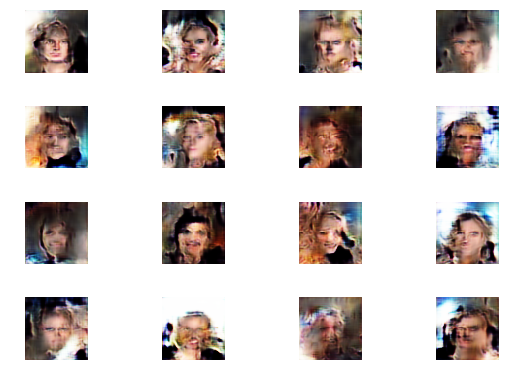

0: [D loss: 0.640002, acc: 0.703125] [A loss: 1.470846, acc: 0.281250]
1: [D loss: 0.621363, acc: 0.703125] [A loss: 1.924253, acc: 0.203125]
2: [D loss: 0.808225, acc: 0.609375] [A loss: 1.497913, acc: 0.265625]
3: [D loss: 0.627577, acc: 0.703125] [A loss: 1.637608, acc: 0.343750]
4: [D loss: 0.701416, acc: 0.625000] [A loss: 1.494742, acc: 0.296875]
5: [D loss: 0.748842, acc: 0.664062] [A loss: 1.323597, acc: 0.406250]
6: [D loss: 0.789037, acc: 0.617188] [A loss: 1.477188, acc: 0.250000]
7: [D loss: 0.741808, acc: 0.687500] [A loss: 1.907979, acc: 0.171875]
8: [D loss: 0.687135, acc: 0.703125] [A loss: 1.527835, acc: 0.218750]
9: [D loss: 0.918892, acc: 0.562500] [A loss: 1.546389, acc: 0.328125]
10: [D loss: 0.679385, acc: 0.703125] [A loss: 1.831045, acc: 0.187500]
11: [D loss: 0.762420, acc: 0.664062] [A loss: 1.793242, acc: 0.265625]
12: [D loss: 0.626135, acc: 0.687500] [A loss: 1.242369, acc: 0.359375]
13: [D loss: 0.658617, acc: 0.718750] [A loss: 1.666696, acc: 0.312500]
14

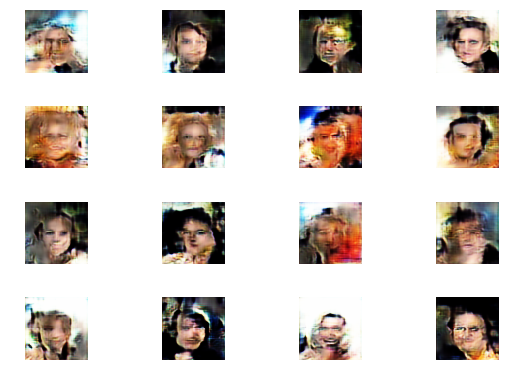

0: [D loss: 0.738225, acc: 0.625000] [A loss: 1.619336, acc: 0.281250]
1: [D loss: 0.737984, acc: 0.609375] [A loss: 1.465053, acc: 0.312500]
2: [D loss: 0.707600, acc: 0.632812] [A loss: 1.624260, acc: 0.234375]
3: [D loss: 0.731502, acc: 0.671875] [A loss: 1.670965, acc: 0.281250]
4: [D loss: 0.869615, acc: 0.554688] [A loss: 1.551771, acc: 0.296875]
5: [D loss: 0.837150, acc: 0.671875] [A loss: 1.861718, acc: 0.265625]
6: [D loss: 0.890997, acc: 0.578125] [A loss: 1.545474, acc: 0.265625]
7: [D loss: 0.631682, acc: 0.703125] [A loss: 1.793296, acc: 0.234375]
8: [D loss: 0.727714, acc: 0.726562] [A loss: 1.363503, acc: 0.343750]
9: [D loss: 0.840480, acc: 0.640625] [A loss: 1.320125, acc: 0.328125]
10: [D loss: 0.772127, acc: 0.664062] [A loss: 1.518675, acc: 0.328125]
11: [D loss: 0.810362, acc: 0.664062] [A loss: 1.310762, acc: 0.359375]
12: [D loss: 0.766738, acc: 0.671875] [A loss: 1.376271, acc: 0.359375]
13: [D loss: 0.717141, acc: 0.640625] [A loss: 1.585141, acc: 0.375000]
14

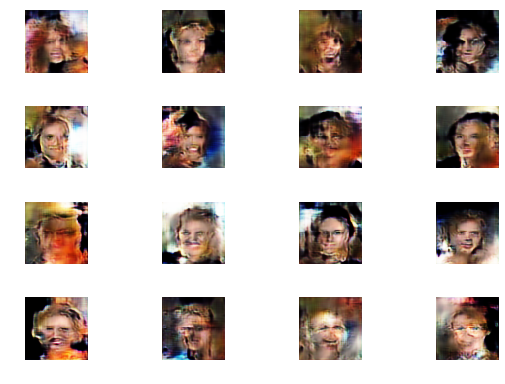

0: [D loss: 0.847451, acc: 0.656250] [A loss: 1.736199, acc: 0.328125]
1: [D loss: 0.777758, acc: 0.601562] [A loss: 1.749094, acc: 0.234375]
2: [D loss: 0.743175, acc: 0.617188] [A loss: 1.685073, acc: 0.375000]
3: [D loss: 0.675590, acc: 0.695312] [A loss: 1.302972, acc: 0.312500]
4: [D loss: 0.751086, acc: 0.632812] [A loss: 1.726101, acc: 0.187500]
5: [D loss: 0.779902, acc: 0.625000] [A loss: 1.459980, acc: 0.312500]
6: [D loss: 0.788988, acc: 0.656250] [A loss: 1.614994, acc: 0.328125]
7: [D loss: 0.721131, acc: 0.734375] [A loss: 1.518558, acc: 0.375000]
8: [D loss: 0.662520, acc: 0.656250] [A loss: 1.563433, acc: 0.390625]
9: [D loss: 0.737635, acc: 0.656250] [A loss: 1.699154, acc: 0.328125]
10: [D loss: 0.736388, acc: 0.625000] [A loss: 1.755153, acc: 0.234375]
11: [D loss: 0.552893, acc: 0.679688] [A loss: 1.374366, acc: 0.437500]
12: [D loss: 0.822868, acc: 0.648438] [A loss: 1.428285, acc: 0.250000]
13: [D loss: 0.754306, acc: 0.656250] [A loss: 1.323642, acc: 0.406250]
14

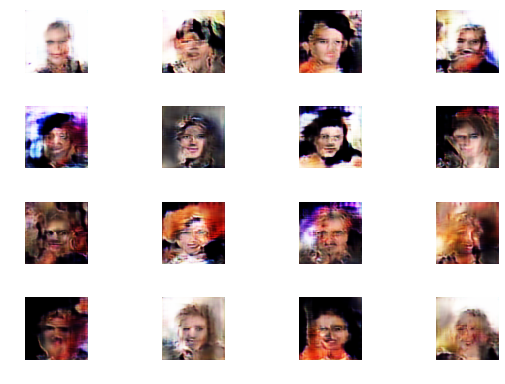

0: [D loss: 0.652934, acc: 0.695312] [A loss: 1.481995, acc: 0.265625]
1: [D loss: 0.562032, acc: 0.718750] [A loss: 1.566384, acc: 0.343750]
2: [D loss: 0.686162, acc: 0.656250] [A loss: 1.569145, acc: 0.218750]
3: [D loss: 0.751011, acc: 0.632812] [A loss: 1.809199, acc: 0.312500]
4: [D loss: 0.548501, acc: 0.718750] [A loss: 1.721648, acc: 0.265625]
5: [D loss: 0.728806, acc: 0.648438] [A loss: 1.644826, acc: 0.312500]
6: [D loss: 0.824905, acc: 0.632812] [A loss: 1.630870, acc: 0.250000]
7: [D loss: 0.724087, acc: 0.664062] [A loss: 1.707713, acc: 0.281250]
8: [D loss: 0.689197, acc: 0.710938] [A loss: 1.369841, acc: 0.343750]
9: [D loss: 0.787270, acc: 0.640625] [A loss: 1.434583, acc: 0.375000]
10: [D loss: 0.630892, acc: 0.640625] [A loss: 1.930771, acc: 0.218750]
11: [D loss: 0.699853, acc: 0.656250] [A loss: 1.436334, acc: 0.375000]
12: [D loss: 0.649246, acc: 0.718750] [A loss: 1.531617, acc: 0.281250]
13: [D loss: 0.649357, acc: 0.656250] [A loss: 1.587324, acc: 0.296875]
14

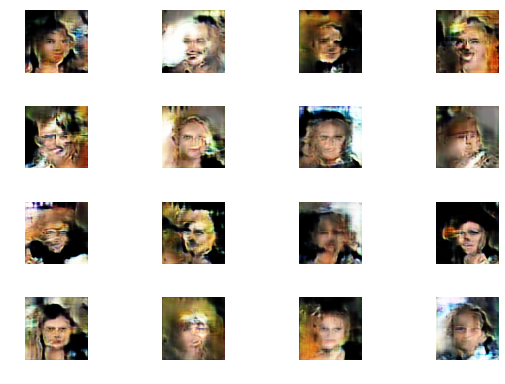

0: [D loss: 0.866889, acc: 0.585938] [A loss: 1.611055, acc: 0.375000]
1: [D loss: 0.839305, acc: 0.562500] [A loss: 1.607171, acc: 0.359375]
2: [D loss: 0.793422, acc: 0.671875] [A loss: 1.370098, acc: 0.312500]
3: [D loss: 0.587722, acc: 0.734375] [A loss: 1.544842, acc: 0.296875]
4: [D loss: 0.663109, acc: 0.687500] [A loss: 1.499966, acc: 0.296875]
5: [D loss: 0.622521, acc: 0.687500] [A loss: 1.736450, acc: 0.359375]
6: [D loss: 0.812725, acc: 0.640625] [A loss: 1.793244, acc: 0.250000]
7: [D loss: 0.727549, acc: 0.632812] [A loss: 1.609577, acc: 0.312500]
8: [D loss: 0.924317, acc: 0.546875] [A loss: 1.878498, acc: 0.265625]
9: [D loss: 0.710028, acc: 0.664062] [A loss: 1.443766, acc: 0.328125]
10: [D loss: 0.684538, acc: 0.679688] [A loss: 1.786682, acc: 0.250000]
11: [D loss: 0.731834, acc: 0.640625] [A loss: 1.698008, acc: 0.265625]
12: [D loss: 0.744326, acc: 0.656250] [A loss: 1.790856, acc: 0.187500]
13: [D loss: 0.884554, acc: 0.531250] [A loss: 1.499922, acc: 0.312500]
14

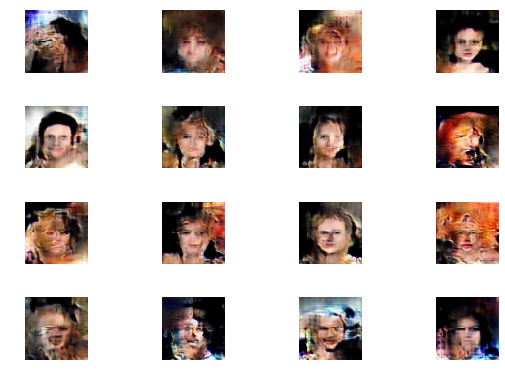

0: [D loss: 0.687731, acc: 0.695312] [A loss: 1.401247, acc: 0.343750]
1: [D loss: 0.733915, acc: 0.679688] [A loss: 1.383633, acc: 0.421875]
2: [D loss: 0.733114, acc: 0.609375] [A loss: 1.804076, acc: 0.281250]
3: [D loss: 0.709678, acc: 0.640625] [A loss: 1.517506, acc: 0.390625]
4: [D loss: 0.747844, acc: 0.640625] [A loss: 1.604710, acc: 0.390625]
5: [D loss: 0.750480, acc: 0.593750] [A loss: 1.631772, acc: 0.390625]
6: [D loss: 0.687335, acc: 0.632812] [A loss: 1.292988, acc: 0.437500]
7: [D loss: 0.905358, acc: 0.578125] [A loss: 1.099431, acc: 0.437500]
8: [D loss: 0.842906, acc: 0.585938] [A loss: 1.227070, acc: 0.375000]
9: [D loss: 0.936460, acc: 0.593750] [A loss: 1.200312, acc: 0.375000]
10: [D loss: 0.919642, acc: 0.570312] [A loss: 1.393541, acc: 0.406250]
11: [D loss: 0.879978, acc: 0.648438] [A loss: 1.271344, acc: 0.437500]
12: [D loss: 0.787626, acc: 0.632812] [A loss: 1.215676, acc: 0.437500]
13: [D loss: 1.003000, acc: 0.570312] [A loss: 1.388914, acc: 0.343750]
14

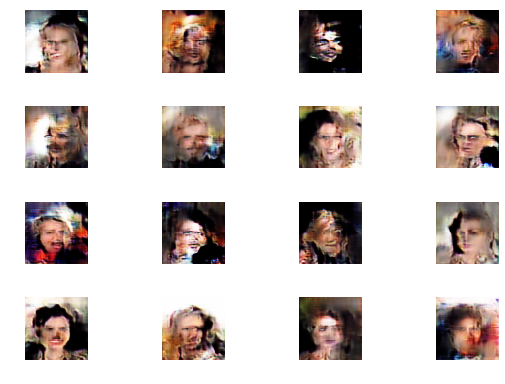

0: [D loss: 0.687723, acc: 0.679688] [A loss: 1.300404, acc: 0.437500]
1: [D loss: 0.682204, acc: 0.640625] [A loss: 1.478651, acc: 0.296875]
2: [D loss: 0.701699, acc: 0.632812] [A loss: 1.387067, acc: 0.328125]
3: [D loss: 0.702653, acc: 0.648438] [A loss: 1.452124, acc: 0.375000]
4: [D loss: 0.754284, acc: 0.671875] [A loss: 1.484019, acc: 0.343750]
5: [D loss: 0.737159, acc: 0.648438] [A loss: 1.337313, acc: 0.328125]
6: [D loss: 0.757769, acc: 0.656250] [A loss: 1.269345, acc: 0.406250]
7: [D loss: 0.598633, acc: 0.726562] [A loss: 1.567676, acc: 0.312500]
8: [D loss: 0.560429, acc: 0.703125] [A loss: 1.443008, acc: 0.328125]
9: [D loss: 0.748915, acc: 0.671875] [A loss: 1.494474, acc: 0.281250]
10: [D loss: 0.650273, acc: 0.710938] [A loss: 1.578667, acc: 0.234375]
11: [D loss: 0.698015, acc: 0.687500] [A loss: 1.537720, acc: 0.343750]
12: [D loss: 0.627581, acc: 0.757812] [A loss: 1.620125, acc: 0.296875]
13: [D loss: 0.700220, acc: 0.718750] [A loss: 1.529796, acc: 0.281250]
14

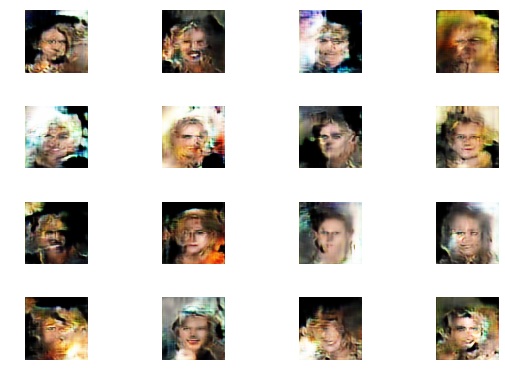

0: [D loss: 0.723681, acc: 0.695312] [A loss: 1.522673, acc: 0.359375]
1: [D loss: 0.794375, acc: 0.656250] [A loss: 1.773515, acc: 0.234375]
2: [D loss: 0.896892, acc: 0.601562] [A loss: 1.629462, acc: 0.343750]
3: [D loss: 0.903731, acc: 0.578125] [A loss: 1.673074, acc: 0.265625]
4: [D loss: 0.789320, acc: 0.585938] [A loss: 1.770847, acc: 0.359375]
5: [D loss: 0.737869, acc: 0.664062] [A loss: 1.671146, acc: 0.296875]
6: [D loss: 0.682060, acc: 0.679688] [A loss: 1.468953, acc: 0.359375]
7: [D loss: 0.790204, acc: 0.593750] [A loss: 2.059446, acc: 0.281250]
8: [D loss: 0.795131, acc: 0.671875] [A loss: 1.629564, acc: 0.328125]
9: [D loss: 0.894936, acc: 0.578125] [A loss: 1.506667, acc: 0.328125]
10: [D loss: 0.816176, acc: 0.625000] [A loss: 1.526982, acc: 0.359375]
11: [D loss: 0.781933, acc: 0.648438] [A loss: 1.712970, acc: 0.296875]
12: [D loss: 0.921667, acc: 0.585938] [A loss: 1.882359, acc: 0.250000]
13: [D loss: 0.674495, acc: 0.679688] [A loss: 1.450075, acc: 0.328125]
14

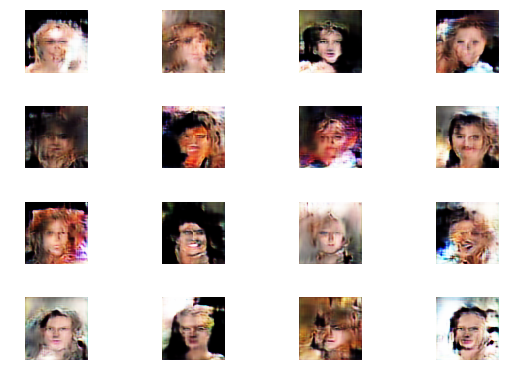

0: [D loss: 0.731500, acc: 0.656250] [A loss: 1.994770, acc: 0.281250]
1: [D loss: 0.789379, acc: 0.585938] [A loss: 1.322768, acc: 0.421875]
2: [D loss: 0.674244, acc: 0.664062] [A loss: 1.627984, acc: 0.281250]
3: [D loss: 0.810329, acc: 0.648438] [A loss: 1.619588, acc: 0.296875]
4: [D loss: 0.760488, acc: 0.648438] [A loss: 1.759959, acc: 0.281250]
5: [D loss: 0.729520, acc: 0.671875] [A loss: 1.656709, acc: 0.218750]
6: [D loss: 0.865153, acc: 0.585938] [A loss: 1.605367, acc: 0.218750]
7: [D loss: 0.845181, acc: 0.593750] [A loss: 1.527158, acc: 0.312500]
8: [D loss: 0.851614, acc: 0.585938] [A loss: 1.361312, acc: 0.390625]
9: [D loss: 0.893165, acc: 0.578125] [A loss: 1.620602, acc: 0.265625]
10: [D loss: 0.862528, acc: 0.640625] [A loss: 1.413990, acc: 0.390625]
11: [D loss: 0.733703, acc: 0.664062] [A loss: 1.412645, acc: 0.437500]
12: [D loss: 0.837878, acc: 0.648438] [A loss: 1.344664, acc: 0.359375]
13: [D loss: 0.776516, acc: 0.640625] [A loss: 1.473261, acc: 0.250000]
14

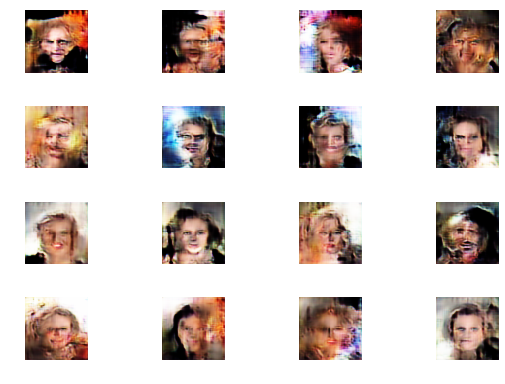

0: [D loss: 0.751776, acc: 0.617188] [A loss: 1.472500, acc: 0.250000]
1: [D loss: 0.633934, acc: 0.695312] [A loss: 1.260369, acc: 0.390625]
2: [D loss: 0.828574, acc: 0.585938] [A loss: 1.611221, acc: 0.187500]
3: [D loss: 0.887709, acc: 0.617188] [A loss: 1.640055, acc: 0.343750]
4: [D loss: 0.868679, acc: 0.601562] [A loss: 1.433205, acc: 0.375000]
5: [D loss: 0.760102, acc: 0.632812] [A loss: 1.472160, acc: 0.406250]
6: [D loss: 0.761734, acc: 0.671875] [A loss: 1.160250, acc: 0.437500]
7: [D loss: 0.629672, acc: 0.687500] [A loss: 1.385216, acc: 0.343750]
8: [D loss: 0.863480, acc: 0.570312] [A loss: 1.520652, acc: 0.375000]
9: [D loss: 0.891258, acc: 0.609375] [A loss: 1.761598, acc: 0.234375]
10: [D loss: 0.732780, acc: 0.679688] [A loss: 1.285272, acc: 0.343750]
11: [D loss: 0.901705, acc: 0.585938] [A loss: 1.768552, acc: 0.296875]
12: [D loss: 0.736071, acc: 0.695312] [A loss: 1.801728, acc: 0.343750]
13: [D loss: 0.698559, acc: 0.703125] [A loss: 1.959686, acc: 0.250000]
14

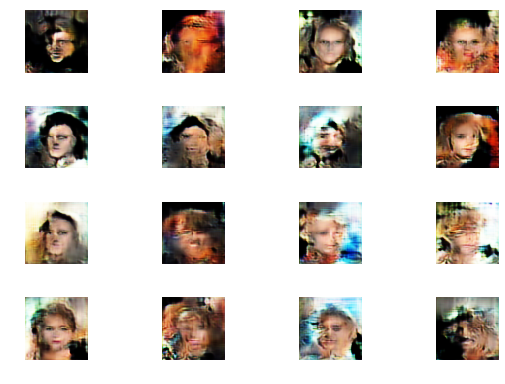

0: [D loss: 0.758994, acc: 0.648438] [A loss: 1.537965, acc: 0.375000]
1: [D loss: 0.731730, acc: 0.601562] [A loss: 1.548905, acc: 0.375000]
2: [D loss: 0.731257, acc: 0.640625] [A loss: 1.382772, acc: 0.375000]
3: [D loss: 0.741506, acc: 0.632812] [A loss: 1.582995, acc: 0.359375]
4: [D loss: 0.884780, acc: 0.585938] [A loss: 1.485038, acc: 0.281250]
5: [D loss: 0.892711, acc: 0.570312] [A loss: 1.687721, acc: 0.218750]
6: [D loss: 0.724288, acc: 0.609375] [A loss: 1.558655, acc: 0.359375]
7: [D loss: 0.791649, acc: 0.625000] [A loss: 1.925455, acc: 0.218750]
8: [D loss: 0.758847, acc: 0.664062] [A loss: 1.645211, acc: 0.328125]
9: [D loss: 0.850293, acc: 0.578125] [A loss: 1.753701, acc: 0.312500]
10: [D loss: 0.870395, acc: 0.640625] [A loss: 1.934394, acc: 0.203125]
11: [D loss: 0.847759, acc: 0.585938] [A loss: 1.467249, acc: 0.343750]
12: [D loss: 0.888605, acc: 0.648438] [A loss: 1.618834, acc: 0.312500]
13: [D loss: 0.656371, acc: 0.656250] [A loss: 1.777083, acc: 0.250000]
14

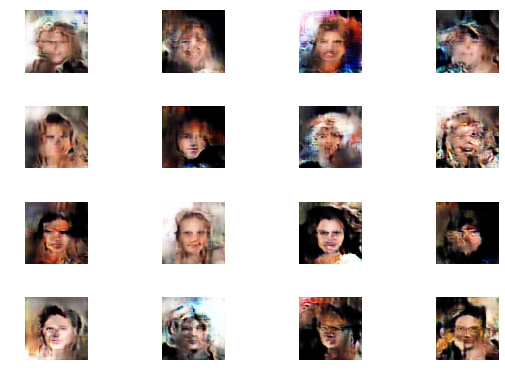

0: [D loss: 0.825440, acc: 0.617188] [A loss: 1.526822, acc: 0.406250]
1: [D loss: 0.949880, acc: 0.554688] [A loss: 1.211559, acc: 0.437500]
2: [D loss: 0.829226, acc: 0.609375] [A loss: 1.314194, acc: 0.375000]
3: [D loss: 0.793826, acc: 0.640625] [A loss: 1.572461, acc: 0.328125]
4: [D loss: 0.790765, acc: 0.617188] [A loss: 1.567717, acc: 0.281250]
5: [D loss: 0.874079, acc: 0.593750] [A loss: 1.512333, acc: 0.281250]
6: [D loss: 0.928725, acc: 0.539062] [A loss: 1.583271, acc: 0.343750]
7: [D loss: 0.690718, acc: 0.710938] [A loss: 1.689865, acc: 0.296875]
8: [D loss: 0.732130, acc: 0.648438] [A loss: 1.862311, acc: 0.296875]
9: [D loss: 0.878663, acc: 0.625000] [A loss: 1.781687, acc: 0.250000]
10: [D loss: 0.738335, acc: 0.656250] [A loss: 1.301475, acc: 0.421875]
11: [D loss: 0.824814, acc: 0.539062] [A loss: 1.558449, acc: 0.343750]
12: [D loss: 0.730431, acc: 0.617188] [A loss: 1.557642, acc: 0.312500]
13: [D loss: 0.699970, acc: 0.679688] [A loss: 1.391213, acc: 0.359375]
14

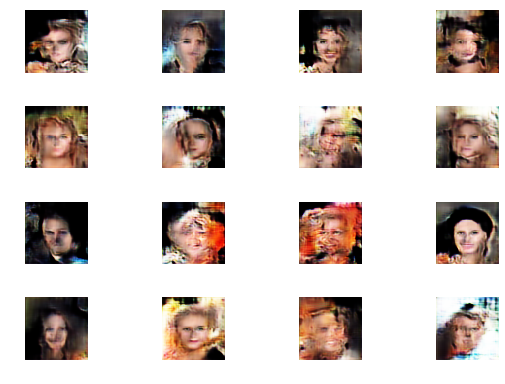

0: [D loss: 0.901488, acc: 0.609375] [A loss: 1.447821, acc: 0.328125]
1: [D loss: 0.619065, acc: 0.679688] [A loss: 1.695797, acc: 0.265625]
2: [D loss: 0.742147, acc: 0.640625] [A loss: 1.732499, acc: 0.218750]
3: [D loss: 0.743006, acc: 0.664062] [A loss: 1.267661, acc: 0.390625]
4: [D loss: 0.680413, acc: 0.687500] [A loss: 1.541391, acc: 0.328125]
5: [D loss: 0.686345, acc: 0.664062] [A loss: 1.333504, acc: 0.312500]
6: [D loss: 0.733546, acc: 0.609375] [A loss: 1.449859, acc: 0.312500]
7: [D loss: 0.865759, acc: 0.617188] [A loss: 1.415234, acc: 0.312500]
8: [D loss: 0.750078, acc: 0.664062] [A loss: 1.358217, acc: 0.328125]
9: [D loss: 0.925033, acc: 0.585938] [A loss: 1.673938, acc: 0.296875]
10: [D loss: 1.006892, acc: 0.601562] [A loss: 1.285045, acc: 0.328125]
11: [D loss: 0.820753, acc: 0.593750] [A loss: 1.348758, acc: 0.421875]
12: [D loss: 0.758884, acc: 0.609375] [A loss: 1.143057, acc: 0.468750]
13: [D loss: 0.803756, acc: 0.632812] [A loss: 1.392531, acc: 0.468750]
14

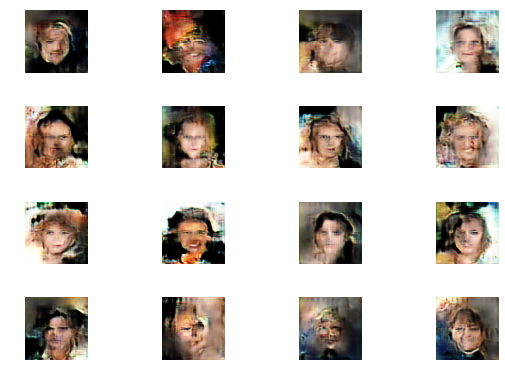

0: [D loss: 0.880267, acc: 0.648438] [A loss: 1.586672, acc: 0.296875]
1: [D loss: 0.822411, acc: 0.640625] [A loss: 1.603979, acc: 0.312500]
2: [D loss: 0.702210, acc: 0.656250] [A loss: 1.908960, acc: 0.140625]
3: [D loss: 0.726706, acc: 0.648438] [A loss: 1.910283, acc: 0.203125]
4: [D loss: 0.679844, acc: 0.648438] [A loss: 1.820078, acc: 0.250000]
5: [D loss: 0.705790, acc: 0.656250] [A loss: 1.468444, acc: 0.296875]
6: [D loss: 0.778005, acc: 0.609375] [A loss: 1.762439, acc: 0.312500]
7: [D loss: 0.535951, acc: 0.734375] [A loss: 1.610701, acc: 0.343750]
8: [D loss: 0.775905, acc: 0.617188] [A loss: 1.825467, acc: 0.234375]
9: [D loss: 0.660689, acc: 0.664062] [A loss: 1.655685, acc: 0.281250]
10: [D loss: 0.768457, acc: 0.593750] [A loss: 1.770915, acc: 0.250000]
11: [D loss: 0.746167, acc: 0.703125] [A loss: 1.293067, acc: 0.296875]
12: [D loss: 0.802802, acc: 0.632812] [A loss: 1.436285, acc: 0.359375]
13: [D loss: 0.724957, acc: 0.656250] [A loss: 1.769213, acc: 0.265625]
14

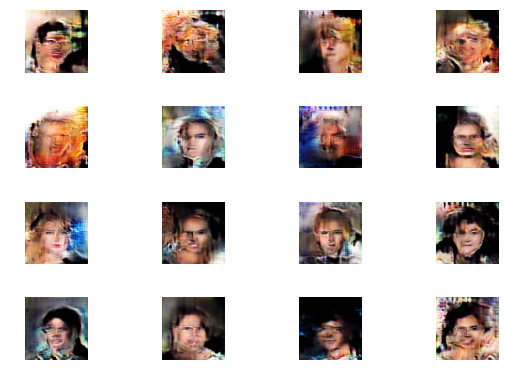

0: [D loss: 0.911611, acc: 0.578125] [A loss: 1.550702, acc: 0.312500]
1: [D loss: 0.636534, acc: 0.640625] [A loss: 1.325926, acc: 0.375000]
2: [D loss: 0.776383, acc: 0.593750] [A loss: 1.303972, acc: 0.406250]
3: [D loss: 0.706524, acc: 0.601562] [A loss: 1.543160, acc: 0.296875]
4: [D loss: 0.818771, acc: 0.609375] [A loss: 1.354836, acc: 0.375000]
5: [D loss: 0.957293, acc: 0.593750] [A loss: 1.586945, acc: 0.296875]
6: [D loss: 0.742929, acc: 0.671875] [A loss: 1.523478, acc: 0.375000]
7: [D loss: 0.683799, acc: 0.656250] [A loss: 1.363916, acc: 0.328125]
8: [D loss: 0.762837, acc: 0.640625] [A loss: 1.226110, acc: 0.500000]
9: [D loss: 0.990257, acc: 0.554688] [A loss: 1.418640, acc: 0.359375]
10: [D loss: 0.818501, acc: 0.640625] [A loss: 1.216488, acc: 0.421875]
11: [D loss: 1.039083, acc: 0.546875] [A loss: 1.224811, acc: 0.390625]
12: [D loss: 0.799795, acc: 0.632812] [A loss: 1.298593, acc: 0.312500]
13: [D loss: 0.809068, acc: 0.632812] [A loss: 1.430905, acc: 0.468750]
14

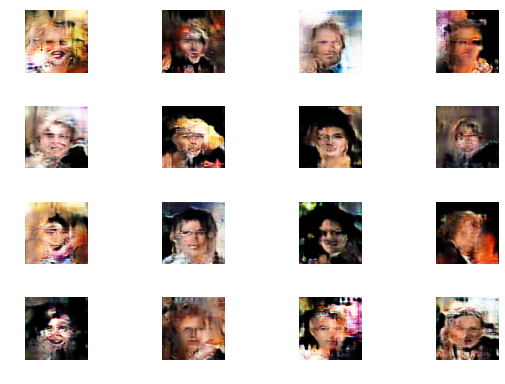

0: [D loss: 0.822330, acc: 0.617188] [A loss: 1.542728, acc: 0.359375]
1: [D loss: 0.705670, acc: 0.609375] [A loss: 1.627321, acc: 0.296875]
2: [D loss: 0.779628, acc: 0.632812] [A loss: 1.300061, acc: 0.328125]
3: [D loss: 0.737708, acc: 0.656250] [A loss: 1.276632, acc: 0.359375]
4: [D loss: 0.835664, acc: 0.632812] [A loss: 1.926212, acc: 0.250000]
5: [D loss: 0.715127, acc: 0.679688] [A loss: 1.406898, acc: 0.375000]
6: [D loss: 0.653738, acc: 0.679688] [A loss: 1.590266, acc: 0.375000]
7: [D loss: 0.800747, acc: 0.656250] [A loss: 1.355167, acc: 0.343750]
8: [D loss: 0.781952, acc: 0.609375] [A loss: 1.442214, acc: 0.453125]
9: [D loss: 0.814865, acc: 0.601562] [A loss: 1.369220, acc: 0.312500]
10: [D loss: 0.732804, acc: 0.648438] [A loss: 1.428987, acc: 0.390625]
11: [D loss: 0.780604, acc: 0.617188] [A loss: 1.724078, acc: 0.296875]
12: [D loss: 0.829777, acc: 0.617188] [A loss: 1.834699, acc: 0.312500]
13: [D loss: 0.898906, acc: 0.625000] [A loss: 1.677961, acc: 0.281250]
14

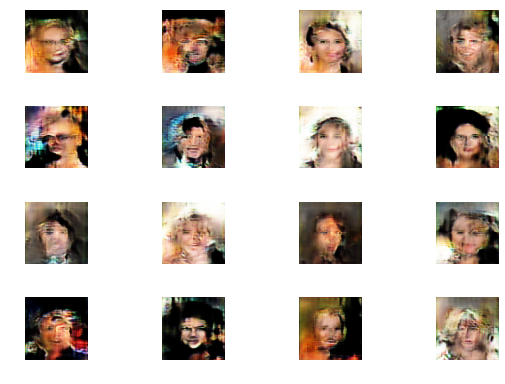

0: [D loss: 0.787809, acc: 0.648438] [A loss: 1.834558, acc: 0.265625]
1: [D loss: 0.883981, acc: 0.578125] [A loss: 1.689947, acc: 0.296875]
2: [D loss: 0.810927, acc: 0.601562] [A loss: 1.516071, acc: 0.343750]
3: [D loss: 0.834152, acc: 0.632812] [A loss: 1.326690, acc: 0.421875]
4: [D loss: 0.831380, acc: 0.593750] [A loss: 1.350651, acc: 0.406250]
5: [D loss: 1.015245, acc: 0.617188] [A loss: 1.313890, acc: 0.343750]
6: [D loss: 0.570584, acc: 0.726562] [A loss: 1.546894, acc: 0.218750]
7: [D loss: 0.738900, acc: 0.632812] [A loss: 1.449535, acc: 0.375000]
8: [D loss: 0.793651, acc: 0.625000] [A loss: 1.827297, acc: 0.250000]
9: [D loss: 0.702033, acc: 0.640625] [A loss: 1.353502, acc: 0.359375]
10: [D loss: 0.998590, acc: 0.578125] [A loss: 1.517717, acc: 0.343750]
11: [D loss: 0.701798, acc: 0.664062] [A loss: 1.713417, acc: 0.296875]
12: [D loss: 0.840297, acc: 0.640625] [A loss: 1.386643, acc: 0.343750]
13: [D loss: 0.711416, acc: 0.601562] [A loss: 1.420499, acc: 0.375000]
14

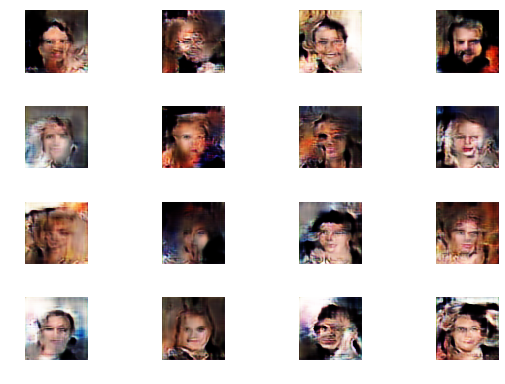

0: [D loss: 0.695274, acc: 0.632812] [A loss: 1.458242, acc: 0.375000]
1: [D loss: 0.751660, acc: 0.609375] [A loss: 1.366182, acc: 0.328125]
2: [D loss: 0.622670, acc: 0.695312] [A loss: 1.576779, acc: 0.375000]
3: [D loss: 0.770570, acc: 0.601562] [A loss: 1.604608, acc: 0.328125]
4: [D loss: 0.845722, acc: 0.656250] [A loss: 1.295777, acc: 0.390625]
5: [D loss: 0.643610, acc: 0.703125] [A loss: 1.574209, acc: 0.234375]
6: [D loss: 0.751768, acc: 0.656250] [A loss: 1.753279, acc: 0.265625]
7: [D loss: 0.737660, acc: 0.648438] [A loss: 1.386507, acc: 0.312500]
8: [D loss: 0.880315, acc: 0.554688] [A loss: 1.233055, acc: 0.515625]
9: [D loss: 0.816942, acc: 0.601562] [A loss: 1.511077, acc: 0.343750]
10: [D loss: 0.866017, acc: 0.640625] [A loss: 1.586927, acc: 0.265625]
11: [D loss: 0.838834, acc: 0.648438] [A loss: 1.968139, acc: 0.265625]
12: [D loss: 0.623882, acc: 0.726562] [A loss: 1.566528, acc: 0.296875]
13: [D loss: 0.783916, acc: 0.632812] [A loss: 1.248070, acc: 0.437500]
14

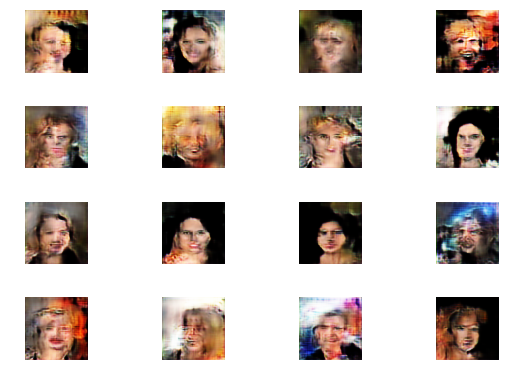

0: [D loss: 0.722910, acc: 0.656250] [A loss: 1.558100, acc: 0.312500]
1: [D loss: 0.952375, acc: 0.546875] [A loss: 1.715871, acc: 0.328125]
2: [D loss: 0.899514, acc: 0.593750] [A loss: 1.482955, acc: 0.281250]
3: [D loss: 0.735958, acc: 0.625000] [A loss: 1.233662, acc: 0.390625]
4: [D loss: 0.931248, acc: 0.585938] [A loss: 1.527564, acc: 0.328125]
5: [D loss: 0.925807, acc: 0.593750] [A loss: 1.557033, acc: 0.296875]
6: [D loss: 0.889753, acc: 0.609375] [A loss: 1.591974, acc: 0.281250]
7: [D loss: 0.768003, acc: 0.593750] [A loss: 1.439938, acc: 0.359375]
8: [D loss: 0.959633, acc: 0.546875] [A loss: 1.770264, acc: 0.328125]
9: [D loss: 0.720994, acc: 0.664062] [A loss: 1.566420, acc: 0.328125]
10: [D loss: 0.684490, acc: 0.664062] [A loss: 1.467018, acc: 0.343750]
11: [D loss: 0.811888, acc: 0.609375] [A loss: 1.468963, acc: 0.312500]
12: [D loss: 0.832698, acc: 0.625000] [A loss: 1.407606, acc: 0.390625]
13: [D loss: 0.849718, acc: 0.601562] [A loss: 1.305498, acc: 0.406250]
14

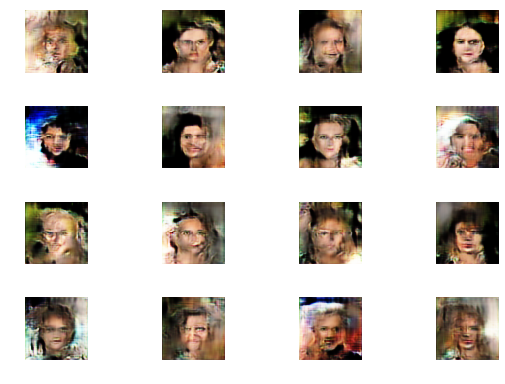

0: [D loss: 0.860204, acc: 0.609375] [A loss: 1.362374, acc: 0.484375]
1: [D loss: 0.938987, acc: 0.570312] [A loss: 1.523994, acc: 0.312500]
2: [D loss: 0.887138, acc: 0.585938] [A loss: 1.416892, acc: 0.406250]
3: [D loss: 0.849027, acc: 0.656250] [A loss: 1.841702, acc: 0.265625]
4: [D loss: 0.697784, acc: 0.695312] [A loss: 1.849040, acc: 0.218750]
5: [D loss: 0.904342, acc: 0.585938] [A loss: 1.854550, acc: 0.203125]
6: [D loss: 0.893377, acc: 0.593750] [A loss: 1.565470, acc: 0.359375]
7: [D loss: 0.911328, acc: 0.601562] [A loss: 1.443221, acc: 0.359375]
8: [D loss: 0.762356, acc: 0.656250] [A loss: 1.380349, acc: 0.453125]
9: [D loss: 0.678020, acc: 0.718750] [A loss: 1.359240, acc: 0.468750]
10: [D loss: 0.958395, acc: 0.617188] [A loss: 1.527727, acc: 0.343750]
11: [D loss: 0.890798, acc: 0.593750] [A loss: 1.537808, acc: 0.343750]
12: [D loss: 0.694046, acc: 0.687500] [A loss: 1.381890, acc: 0.375000]
13: [D loss: 0.879461, acc: 0.570312] [A loss: 1.537205, acc: 0.328125]
14

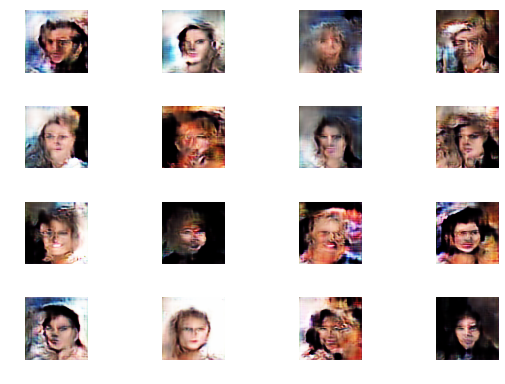

0: [D loss: 0.720621, acc: 0.671875] [A loss: 1.256868, acc: 0.390625]
1: [D loss: 0.789823, acc: 0.640625] [A loss: 1.473214, acc: 0.343750]
2: [D loss: 0.923380, acc: 0.609375] [A loss: 1.246992, acc: 0.359375]
3: [D loss: 0.639522, acc: 0.687500] [A loss: 1.458629, acc: 0.421875]
4: [D loss: 0.649058, acc: 0.687500] [A loss: 1.638203, acc: 0.296875]
5: [D loss: 0.765284, acc: 0.632812] [A loss: 1.376640, acc: 0.343750]
6: [D loss: 0.771029, acc: 0.609375] [A loss: 1.487284, acc: 0.343750]
7: [D loss: 0.725619, acc: 0.664062] [A loss: 1.441792, acc: 0.328125]
8: [D loss: 0.796675, acc: 0.648438] [A loss: 1.346558, acc: 0.281250]
9: [D loss: 0.765821, acc: 0.632812] [A loss: 1.800756, acc: 0.265625]
10: [D loss: 0.660862, acc: 0.679688] [A loss: 1.373252, acc: 0.390625]
11: [D loss: 0.838724, acc: 0.625000] [A loss: 1.547533, acc: 0.375000]
12: [D loss: 0.782511, acc: 0.679688] [A loss: 1.515015, acc: 0.281250]
13: [D loss: 0.706576, acc: 0.656250] [A loss: 1.700847, acc: 0.218750]
14

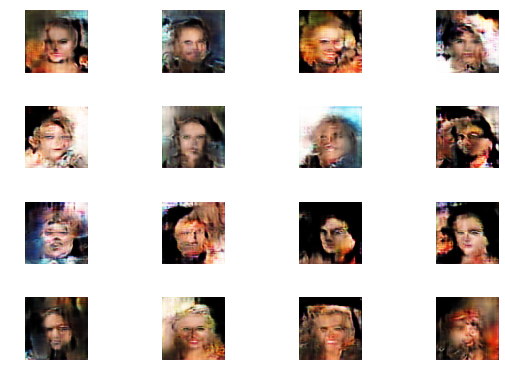

0: [D loss: 0.777066, acc: 0.648438] [A loss: 1.649322, acc: 0.250000]
1: [D loss: 0.672224, acc: 0.687500] [A loss: 1.866069, acc: 0.187500]
2: [D loss: 0.806700, acc: 0.617188] [A loss: 1.764679, acc: 0.234375]
3: [D loss: 0.737678, acc: 0.640625] [A loss: 1.837879, acc: 0.312500]
4: [D loss: 0.849797, acc: 0.625000] [A loss: 1.399850, acc: 0.328125]
5: [D loss: 0.797157, acc: 0.625000] [A loss: 1.443132, acc: 0.296875]
6: [D loss: 0.798440, acc: 0.601562] [A loss: 1.584465, acc: 0.296875]
7: [D loss: 0.872710, acc: 0.578125] [A loss: 1.510118, acc: 0.312500]
8: [D loss: 0.783620, acc: 0.617188] [A loss: 1.503384, acc: 0.296875]
9: [D loss: 0.841695, acc: 0.640625] [A loss: 1.616925, acc: 0.343750]
10: [D loss: 0.648410, acc: 0.648438] [A loss: 1.508787, acc: 0.312500]
11: [D loss: 0.759716, acc: 0.625000] [A loss: 1.297325, acc: 0.437500]
12: [D loss: 0.934205, acc: 0.570312] [A loss: 1.539900, acc: 0.359375]
13: [D loss: 0.639745, acc: 0.695312] [A loss: 1.749423, acc: 0.250000]
14

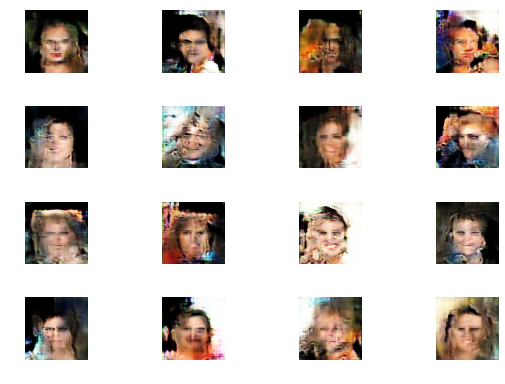

0: [D loss: 0.698776, acc: 0.632812] [A loss: 1.394977, acc: 0.406250]
1: [D loss: 0.768213, acc: 0.601562] [A loss: 1.654863, acc: 0.359375]
2: [D loss: 0.672127, acc: 0.703125] [A loss: 1.519278, acc: 0.343750]
3: [D loss: 0.794953, acc: 0.593750] [A loss: 1.412675, acc: 0.296875]
4: [D loss: 0.650381, acc: 0.671875] [A loss: 1.651137, acc: 0.375000]
5: [D loss: 0.876235, acc: 0.609375] [A loss: 1.361471, acc: 0.437500]
6: [D loss: 0.885699, acc: 0.601562] [A loss: 1.578622, acc: 0.312500]
7: [D loss: 0.630357, acc: 0.687500] [A loss: 1.553525, acc: 0.296875]
8: [D loss: 0.935216, acc: 0.570312] [A loss: 1.488301, acc: 0.312500]
9: [D loss: 0.909319, acc: 0.585938] [A loss: 1.488406, acc: 0.265625]
10: [D loss: 1.089133, acc: 0.492188] [A loss: 1.639029, acc: 0.234375]
11: [D loss: 0.724576, acc: 0.625000] [A loss: 1.366783, acc: 0.343750]
12: [D loss: 0.735562, acc: 0.671875] [A loss: 1.578740, acc: 0.359375]
13: [D loss: 0.890936, acc: 0.578125] [A loss: 1.228014, acc: 0.375000]
14

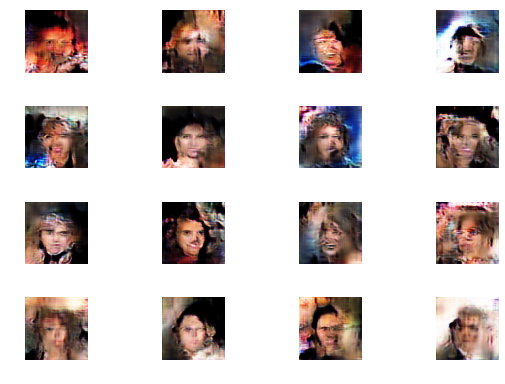

0: [D loss: 0.673036, acc: 0.679688] [A loss: 1.493508, acc: 0.296875]
1: [D loss: 0.846851, acc: 0.656250] [A loss: 1.627343, acc: 0.250000]
2: [D loss: 0.637302, acc: 0.695312] [A loss: 1.434365, acc: 0.375000]
3: [D loss: 0.834979, acc: 0.625000] [A loss: 1.449044, acc: 0.328125]
4: [D loss: 0.830996, acc: 0.601562] [A loss: 1.365513, acc: 0.296875]
5: [D loss: 0.677993, acc: 0.640625] [A loss: 1.399592, acc: 0.312500]
6: [D loss: 0.837305, acc: 0.609375] [A loss: 1.467456, acc: 0.296875]
7: [D loss: 0.828351, acc: 0.609375] [A loss: 1.467893, acc: 0.343750]
8: [D loss: 0.695651, acc: 0.710938] [A loss: 1.352536, acc: 0.390625]
9: [D loss: 0.873639, acc: 0.617188] [A loss: 1.433217, acc: 0.343750]
10: [D loss: 0.791379, acc: 0.640625] [A loss: 1.484031, acc: 0.406250]
11: [D loss: 0.733249, acc: 0.601562] [A loss: 1.732823, acc: 0.296875]
12: [D loss: 0.728257, acc: 0.601562] [A loss: 1.410610, acc: 0.218750]
13: [D loss: 0.660308, acc: 0.648438] [A loss: 1.358594, acc: 0.359375]
14

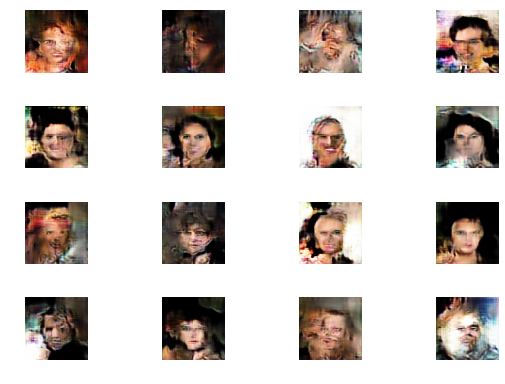

0: [D loss: 0.730033, acc: 0.617188] [A loss: 1.754394, acc: 0.281250]
1: [D loss: 0.803647, acc: 0.578125] [A loss: 1.502148, acc: 0.375000]
2: [D loss: 0.852122, acc: 0.570312] [A loss: 1.572008, acc: 0.281250]
3: [D loss: 0.771119, acc: 0.632812] [A loss: 1.705137, acc: 0.281250]
4: [D loss: 0.758984, acc: 0.640625] [A loss: 1.941002, acc: 0.187500]
5: [D loss: 0.937554, acc: 0.585938] [A loss: 1.667445, acc: 0.250000]
6: [D loss: 0.815946, acc: 0.554688] [A loss: 1.458183, acc: 0.343750]
7: [D loss: 0.691614, acc: 0.656250] [A loss: 1.744295, acc: 0.281250]
8: [D loss: 0.696277, acc: 0.671875] [A loss: 1.497959, acc: 0.281250]
9: [D loss: 0.963252, acc: 0.601562] [A loss: 1.383501, acc: 0.359375]
10: [D loss: 0.936277, acc: 0.593750] [A loss: 1.454927, acc: 0.343750]
11: [D loss: 1.024101, acc: 0.507812] [A loss: 1.498821, acc: 0.359375]
12: [D loss: 0.786293, acc: 0.562500] [A loss: 1.362072, acc: 0.375000]
13: [D loss: 0.772133, acc: 0.578125] [A loss: 1.263261, acc: 0.406250]
14

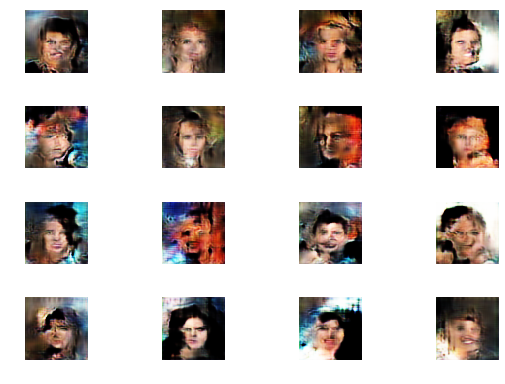

0: [D loss: 0.719287, acc: 0.679688] [A loss: 1.374504, acc: 0.312500]
1: [D loss: 0.849220, acc: 0.609375] [A loss: 1.386883, acc: 0.343750]
2: [D loss: 0.785912, acc: 0.632812] [A loss: 1.456579, acc: 0.343750]
3: [D loss: 0.873045, acc: 0.609375] [A loss: 1.252725, acc: 0.406250]
4: [D loss: 0.786464, acc: 0.593750] [A loss: 1.487814, acc: 0.312500]
5: [D loss: 0.892534, acc: 0.570312] [A loss: 1.580007, acc: 0.218750]
6: [D loss: 0.798901, acc: 0.632812] [A loss: 1.786073, acc: 0.281250]
7: [D loss: 0.784255, acc: 0.617188] [A loss: 1.501134, acc: 0.265625]
8: [D loss: 0.716199, acc: 0.671875] [A loss: 1.596745, acc: 0.328125]
9: [D loss: 0.866151, acc: 0.578125] [A loss: 1.267365, acc: 0.375000]
10: [D loss: 0.801808, acc: 0.679688] [A loss: 1.502399, acc: 0.359375]
11: [D loss: 0.888290, acc: 0.554688] [A loss: 1.406144, acc: 0.421875]
12: [D loss: 0.831049, acc: 0.648438] [A loss: 1.505709, acc: 0.250000]
13: [D loss: 0.829687, acc: 0.632812] [A loss: 1.482939, acc: 0.359375]
14

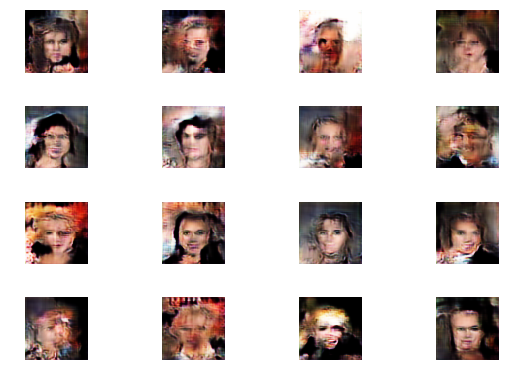

0: [D loss: 0.842263, acc: 0.578125] [A loss: 1.650085, acc: 0.359375]
1: [D loss: 1.001092, acc: 0.539062] [A loss: 1.301682, acc: 0.375000]
2: [D loss: 0.721839, acc: 0.648438] [A loss: 1.540526, acc: 0.375000]
3: [D loss: 0.842615, acc: 0.656250] [A loss: 1.281054, acc: 0.375000]
4: [D loss: 0.730001, acc: 0.640625] [A loss: 1.471292, acc: 0.343750]
5: [D loss: 0.647121, acc: 0.703125] [A loss: 1.399384, acc: 0.328125]
6: [D loss: 0.840459, acc: 0.632812] [A loss: 1.470227, acc: 0.281250]
7: [D loss: 0.692276, acc: 0.656250] [A loss: 1.516289, acc: 0.312500]
8: [D loss: 0.751247, acc: 0.640625] [A loss: 1.379474, acc: 0.312500]
9: [D loss: 0.774978, acc: 0.625000] [A loss: 1.477710, acc: 0.421875]
10: [D loss: 0.651966, acc: 0.687500] [A loss: 1.191643, acc: 0.484375]
11: [D loss: 0.854098, acc: 0.617188] [A loss: 1.544851, acc: 0.265625]
12: [D loss: 0.764822, acc: 0.625000] [A loss: 1.706568, acc: 0.234375]
13: [D loss: 0.786048, acc: 0.664062] [A loss: 1.665130, acc: 0.296875]
14

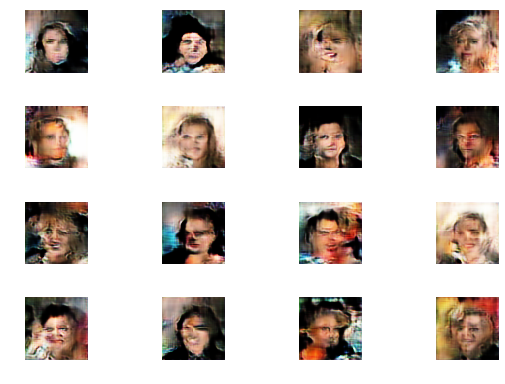

0: [D loss: 0.856341, acc: 0.609375] [A loss: 1.400215, acc: 0.265625]
1: [D loss: 0.934758, acc: 0.578125] [A loss: 1.171853, acc: 0.406250]
2: [D loss: 0.845221, acc: 0.562500] [A loss: 1.190878, acc: 0.406250]
3: [D loss: 0.796723, acc: 0.648438] [A loss: 1.590012, acc: 0.375000]
4: [D loss: 0.907418, acc: 0.570312] [A loss: 1.411795, acc: 0.468750]
5: [D loss: 0.727592, acc: 0.664062] [A loss: 1.264018, acc: 0.406250]
6: [D loss: 0.740497, acc: 0.648438] [A loss: 1.473063, acc: 0.312500]
7: [D loss: 0.778502, acc: 0.593750] [A loss: 1.892003, acc: 0.234375]
8: [D loss: 0.770895, acc: 0.671875] [A loss: 1.257000, acc: 0.328125]
9: [D loss: 0.793464, acc: 0.664062] [A loss: 1.359644, acc: 0.421875]
10: [D loss: 0.940062, acc: 0.570312] [A loss: 1.401299, acc: 0.390625]
11: [D loss: 0.891528, acc: 0.609375] [A loss: 1.203215, acc: 0.468750]
12: [D loss: 0.876981, acc: 0.625000] [A loss: 1.190267, acc: 0.390625]
13: [D loss: 0.808899, acc: 0.585938] [A loss: 1.183365, acc: 0.421875]
14

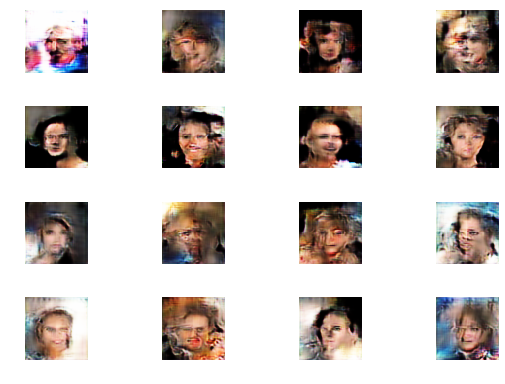

0: [D loss: 0.857000, acc: 0.648438] [A loss: 1.240888, acc: 0.359375]
1: [D loss: 0.816568, acc: 0.609375] [A loss: 1.144631, acc: 0.484375]
2: [D loss: 0.799420, acc: 0.609375] [A loss: 0.884222, acc: 0.562500]
3: [D loss: 1.066692, acc: 0.500000] [A loss: 1.164122, acc: 0.421875]
4: [D loss: 0.954500, acc: 0.492188] [A loss: 1.435089, acc: 0.312500]
5: [D loss: 0.847842, acc: 0.539062] [A loss: 1.388022, acc: 0.328125]
6: [D loss: 0.932175, acc: 0.562500] [A loss: 1.207809, acc: 0.453125]
7: [D loss: 0.921534, acc: 0.578125] [A loss: 1.264798, acc: 0.484375]
8: [D loss: 0.916566, acc: 0.554688] [A loss: 1.255128, acc: 0.453125]
9: [D loss: 0.775603, acc: 0.585938] [A loss: 1.406231, acc: 0.328125]
10: [D loss: 0.853674, acc: 0.601562] [A loss: 1.420548, acc: 0.375000]
11: [D loss: 0.803378, acc: 0.656250] [A loss: 1.324978, acc: 0.359375]
12: [D loss: 0.771462, acc: 0.656250] [A loss: 1.522032, acc: 0.343750]
13: [D loss: 0.845168, acc: 0.601562] [A loss: 1.312135, acc: 0.296875]
14

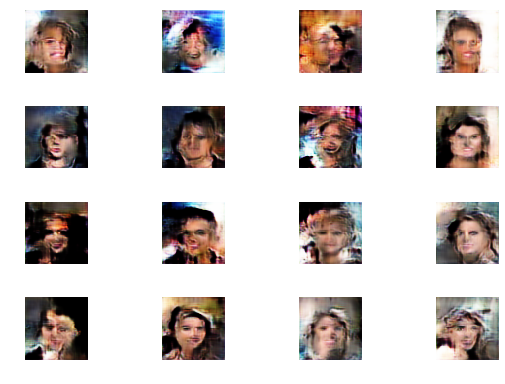

0: [D loss: 0.743319, acc: 0.648438] [A loss: 1.344101, acc: 0.437500]
1: [D loss: 0.846903, acc: 0.617188] [A loss: 1.491087, acc: 0.328125]
2: [D loss: 0.781990, acc: 0.671875] [A loss: 1.731964, acc: 0.343750]
3: [D loss: 0.964043, acc: 0.539062] [A loss: 1.613343, acc: 0.250000]
4: [D loss: 0.824434, acc: 0.648438] [A loss: 1.617545, acc: 0.250000]
5: [D loss: 0.798587, acc: 0.679688] [A loss: 1.224878, acc: 0.437500]
6: [D loss: 0.700368, acc: 0.617188] [A loss: 1.282985, acc: 0.343750]
7: [D loss: 0.651408, acc: 0.671875] [A loss: 1.328333, acc: 0.437500]
8: [D loss: 0.775540, acc: 0.601562] [A loss: 1.511389, acc: 0.390625]
9: [D loss: 0.856581, acc: 0.617188] [A loss: 1.301540, acc: 0.328125]
10: [D loss: 0.816628, acc: 0.593750] [A loss: 1.122305, acc: 0.468750]
11: [D loss: 0.692942, acc: 0.679688] [A loss: 1.434543, acc: 0.296875]
12: [D loss: 0.824526, acc: 0.617188] [A loss: 1.387676, acc: 0.375000]
13: [D loss: 0.777643, acc: 0.578125] [A loss: 1.537759, acc: 0.328125]
14

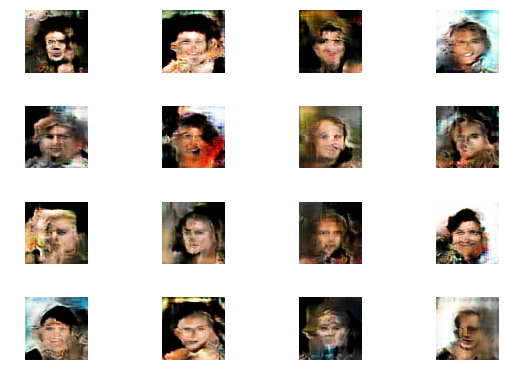

0: [D loss: 0.797418, acc: 0.609375] [A loss: 1.353356, acc: 0.312500]
1: [D loss: 0.645574, acc: 0.710938] [A loss: 1.414100, acc: 0.296875]
2: [D loss: 0.878860, acc: 0.601562] [A loss: 1.454128, acc: 0.328125]
3: [D loss: 0.833651, acc: 0.554688] [A loss: 1.345677, acc: 0.312500]
4: [D loss: 0.756157, acc: 0.625000] [A loss: 1.236250, acc: 0.390625]
5: [D loss: 0.833916, acc: 0.601562] [A loss: 1.577604, acc: 0.312500]
6: [D loss: 0.840541, acc: 0.578125] [A loss: 1.480125, acc: 0.375000]
7: [D loss: 0.816062, acc: 0.562500] [A loss: 1.614089, acc: 0.328125]
8: [D loss: 0.906199, acc: 0.562500] [A loss: 1.717940, acc: 0.234375]
9: [D loss: 0.846301, acc: 0.578125] [A loss: 1.591568, acc: 0.296875]
10: [D loss: 0.738298, acc: 0.679688] [A loss: 1.461292, acc: 0.328125]
11: [D loss: 0.699522, acc: 0.687500] [A loss: 1.547741, acc: 0.281250]
12: [D loss: 0.775494, acc: 0.640625] [A loss: 1.455297, acc: 0.390625]
13: [D loss: 0.769781, acc: 0.585938] [A loss: 1.511381, acc: 0.328125]
14

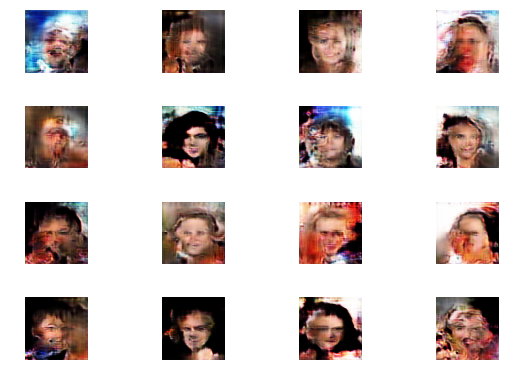

0: [D loss: 0.826185, acc: 0.585938] [A loss: 1.404004, acc: 0.296875]
1: [D loss: 0.831771, acc: 0.648438] [A loss: 1.543349, acc: 0.328125]
2: [D loss: 0.705312, acc: 0.648438] [A loss: 1.419249, acc: 0.343750]
3: [D loss: 0.815997, acc: 0.609375] [A loss: 1.494760, acc: 0.328125]
4: [D loss: 0.916000, acc: 0.585938] [A loss: 1.472517, acc: 0.375000]
5: [D loss: 0.770723, acc: 0.625000] [A loss: 1.451052, acc: 0.312500]
6: [D loss: 0.819343, acc: 0.578125] [A loss: 1.536875, acc: 0.312500]
7: [D loss: 0.866845, acc: 0.632812] [A loss: 1.202121, acc: 0.343750]
8: [D loss: 0.775108, acc: 0.656250] [A loss: 0.807022, acc: 0.500000]
9: [D loss: 0.889947, acc: 0.625000] [A loss: 1.173514, acc: 0.375000]
10: [D loss: 0.915616, acc: 0.593750] [A loss: 1.180762, acc: 0.453125]
11: [D loss: 0.714796, acc: 0.640625] [A loss: 1.191443, acc: 0.484375]
12: [D loss: 0.673068, acc: 0.632812] [A loss: 1.415566, acc: 0.312500]
13: [D loss: 0.754042, acc: 0.601562] [A loss: 1.348367, acc: 0.343750]
14

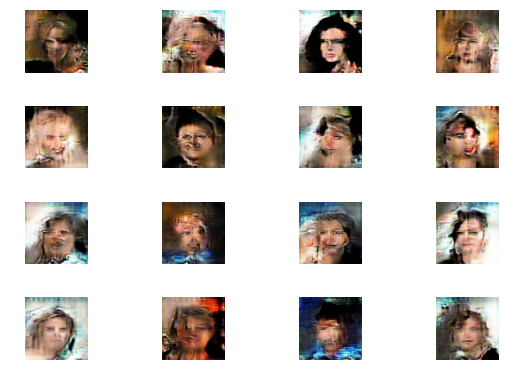

0: [D loss: 0.893945, acc: 0.539062] [A loss: 1.488948, acc: 0.375000]
1: [D loss: 0.931912, acc: 0.570312] [A loss: 1.462689, acc: 0.296875]
2: [D loss: 0.966088, acc: 0.570312] [A loss: 1.476236, acc: 0.250000]
3: [D loss: 1.033723, acc: 0.531250] [A loss: 1.498349, acc: 0.343750]
4: [D loss: 0.812756, acc: 0.625000] [A loss: 1.615257, acc: 0.359375]
5: [D loss: 1.021476, acc: 0.578125] [A loss: 1.566274, acc: 0.359375]
6: [D loss: 0.819902, acc: 0.609375] [A loss: 1.527294, acc: 0.281250]
7: [D loss: 0.808254, acc: 0.640625] [A loss: 1.585411, acc: 0.312500]
8: [D loss: 0.860191, acc: 0.601562] [A loss: 1.404043, acc: 0.343750]
9: [D loss: 0.912196, acc: 0.515625] [A loss: 1.240504, acc: 0.343750]
10: [D loss: 0.851423, acc: 0.593750] [A loss: 1.412896, acc: 0.359375]
11: [D loss: 0.932481, acc: 0.562500] [A loss: 1.848372, acc: 0.187500]
12: [D loss: 0.934743, acc: 0.625000] [A loss: 1.371253, acc: 0.375000]
13: [D loss: 0.784461, acc: 0.625000] [A loss: 1.372744, acc: 0.390625]
14

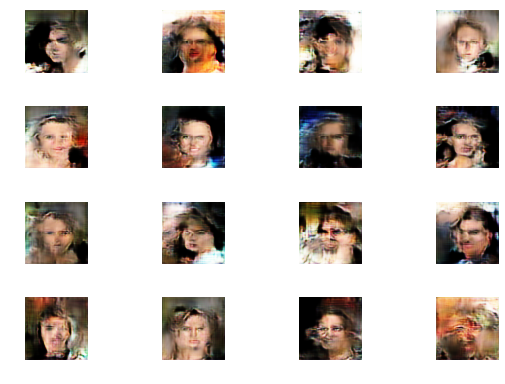

0: [D loss: 0.987631, acc: 0.601562] [A loss: 1.559399, acc: 0.265625]
1: [D loss: 0.933512, acc: 0.523438] [A loss: 1.533291, acc: 0.375000]
2: [D loss: 0.928279, acc: 0.609375] [A loss: 1.553583, acc: 0.296875]
3: [D loss: 0.831186, acc: 0.617188] [A loss: 1.380439, acc: 0.375000]
4: [D loss: 0.783838, acc: 0.601562] [A loss: 1.532413, acc: 0.296875]
5: [D loss: 0.926050, acc: 0.562500] [A loss: 1.562113, acc: 0.312500]
6: [D loss: 0.810127, acc: 0.656250] [A loss: 1.262676, acc: 0.375000]
7: [D loss: 1.123991, acc: 0.539062] [A loss: 1.250382, acc: 0.359375]
8: [D loss: 0.838117, acc: 0.601562] [A loss: 1.587126, acc: 0.328125]
9: [D loss: 0.774857, acc: 0.640625] [A loss: 1.193049, acc: 0.296875]
10: [D loss: 0.797707, acc: 0.585938] [A loss: 1.711454, acc: 0.250000]
11: [D loss: 0.878748, acc: 0.578125] [A loss: 1.427240, acc: 0.421875]
12: [D loss: 0.882501, acc: 0.601562] [A loss: 1.552197, acc: 0.312500]
13: [D loss: 0.916332, acc: 0.593750] [A loss: 1.268749, acc: 0.390625]
14

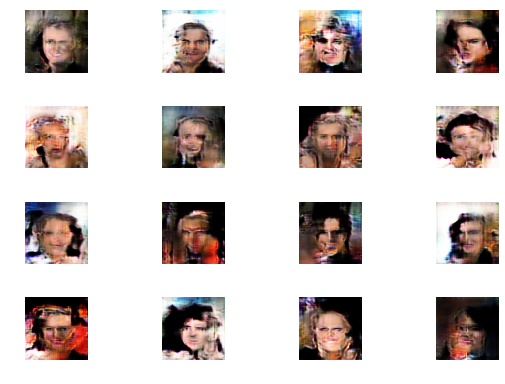

0: [D loss: 0.737440, acc: 0.632812] [A loss: 1.472565, acc: 0.359375]
1: [D loss: 0.814593, acc: 0.601562] [A loss: 1.436884, acc: 0.343750]
2: [D loss: 1.017862, acc: 0.539062] [A loss: 1.440140, acc: 0.375000]
3: [D loss: 0.810322, acc: 0.617188] [A loss: 1.560593, acc: 0.343750]
4: [D loss: 0.772949, acc: 0.632812] [A loss: 1.378121, acc: 0.328125]
5: [D loss: 0.779165, acc: 0.625000] [A loss: 1.435679, acc: 0.296875]
6: [D loss: 0.564574, acc: 0.703125] [A loss: 1.698087, acc: 0.296875]
7: [D loss: 0.714535, acc: 0.601562] [A loss: 1.729905, acc: 0.343750]
8: [D loss: 0.818857, acc: 0.554688] [A loss: 1.410318, acc: 0.375000]
9: [D loss: 0.997271, acc: 0.554688] [A loss: 1.561641, acc: 0.312500]
10: [D loss: 0.885376, acc: 0.585938] [A loss: 1.472505, acc: 0.328125]
11: [D loss: 0.673126, acc: 0.671875] [A loss: 1.172499, acc: 0.375000]
12: [D loss: 0.779202, acc: 0.640625] [A loss: 1.396654, acc: 0.343750]
13: [D loss: 0.748145, acc: 0.671875] [A loss: 1.294862, acc: 0.359375]
14

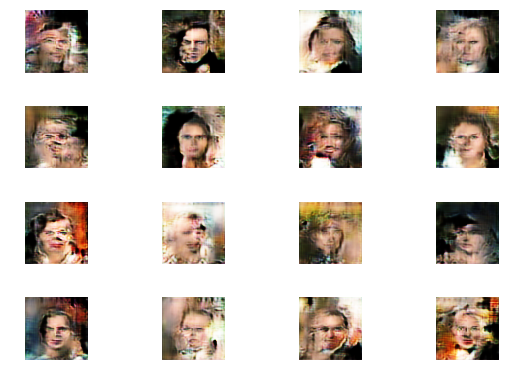

0: [D loss: 0.861115, acc: 0.617188] [A loss: 1.568208, acc: 0.375000]
1: [D loss: 0.937387, acc: 0.562500] [A loss: 1.141415, acc: 0.390625]
2: [D loss: 0.953456, acc: 0.625000] [A loss: 1.246956, acc: 0.437500]
3: [D loss: 0.782831, acc: 0.593750] [A loss: 1.298746, acc: 0.328125]
4: [D loss: 1.013581, acc: 0.531250] [A loss: 1.527085, acc: 0.390625]
5: [D loss: 0.739202, acc: 0.664062] [A loss: 1.475863, acc: 0.328125]
6: [D loss: 0.868732, acc: 0.562500] [A loss: 1.244941, acc: 0.406250]
7: [D loss: 0.808339, acc: 0.648438] [A loss: 1.039282, acc: 0.484375]
8: [D loss: 0.721582, acc: 0.601562] [A loss: 1.462488, acc: 0.390625]
9: [D loss: 0.902886, acc: 0.570312] [A loss: 1.272440, acc: 0.359375]
10: [D loss: 0.817121, acc: 0.632812] [A loss: 1.244442, acc: 0.390625]
11: [D loss: 0.874574, acc: 0.539062] [A loss: 1.730293, acc: 0.328125]
12: [D loss: 0.866709, acc: 0.585938] [A loss: 1.806713, acc: 0.296875]
13: [D loss: 0.884158, acc: 0.515625] [A loss: 1.698252, acc: 0.265625]
14

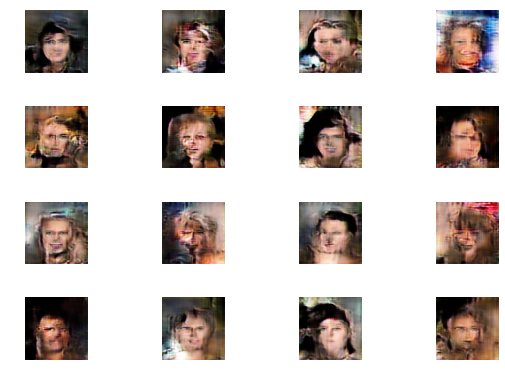

0: [D loss: 0.941987, acc: 0.570312] [A loss: 1.250969, acc: 0.453125]
1: [D loss: 0.814758, acc: 0.609375] [A loss: 1.423141, acc: 0.406250]
2: [D loss: 1.052799, acc: 0.546875] [A loss: 1.137342, acc: 0.390625]
3: [D loss: 0.978449, acc: 0.570312] [A loss: 1.195958, acc: 0.406250]
4: [D loss: 0.853129, acc: 0.570312] [A loss: 1.371219, acc: 0.375000]
5: [D loss: 0.897558, acc: 0.570312] [A loss: 1.297784, acc: 0.375000]
6: [D loss: 0.744808, acc: 0.609375] [A loss: 1.396820, acc: 0.375000]
7: [D loss: 0.919158, acc: 0.539062] [A loss: 1.432478, acc: 0.390625]
8: [D loss: 0.965210, acc: 0.570312] [A loss: 1.305457, acc: 0.359375]
9: [D loss: 0.856434, acc: 0.578125] [A loss: 1.411192, acc: 0.312500]
10: [D loss: 0.708456, acc: 0.648438] [A loss: 1.210039, acc: 0.359375]
11: [D loss: 0.817438, acc: 0.593750] [A loss: 1.666499, acc: 0.296875]
12: [D loss: 0.908691, acc: 0.578125] [A loss: 1.608146, acc: 0.375000]
13: [D loss: 0.913237, acc: 0.554688] [A loss: 1.244866, acc: 0.390625]
14

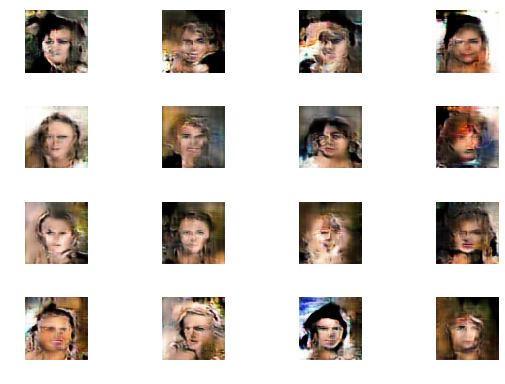

0: [D loss: 0.863145, acc: 0.562500] [A loss: 1.549770, acc: 0.296875]
1: [D loss: 0.960745, acc: 0.531250] [A loss: 1.441796, acc: 0.406250]
2: [D loss: 1.047596, acc: 0.539062] [A loss: 1.370797, acc: 0.406250]
3: [D loss: 0.995885, acc: 0.562500] [A loss: 1.389731, acc: 0.296875]
4: [D loss: 0.876906, acc: 0.609375] [A loss: 1.387054, acc: 0.375000]
5: [D loss: 0.838403, acc: 0.570312] [A loss: 1.565067, acc: 0.343750]
6: [D loss: 0.998231, acc: 0.531250] [A loss: 1.702678, acc: 0.203125]
7: [D loss: 0.827963, acc: 0.570312] [A loss: 1.279644, acc: 0.375000]
8: [D loss: 1.002532, acc: 0.546875] [A loss: 1.282878, acc: 0.328125]
9: [D loss: 0.904348, acc: 0.601562] [A loss: 1.476073, acc: 0.328125]
10: [D loss: 1.065361, acc: 0.546875] [A loss: 1.459353, acc: 0.390625]
11: [D loss: 0.939894, acc: 0.570312] [A loss: 1.704333, acc: 0.343750]
12: [D loss: 0.873291, acc: 0.578125] [A loss: 1.566088, acc: 0.281250]
13: [D loss: 1.058376, acc: 0.531250] [A loss: 1.231642, acc: 0.453125]
14

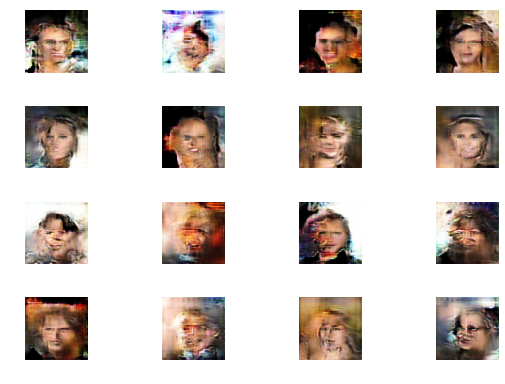

0: [D loss: 0.780059, acc: 0.640625] [A loss: 1.386220, acc: 0.421875]
1: [D loss: 0.718032, acc: 0.617188] [A loss: 1.149611, acc: 0.437500]
2: [D loss: 0.843984, acc: 0.632812] [A loss: 1.362146, acc: 0.343750]
3: [D loss: 0.806495, acc: 0.625000] [A loss: 1.359409, acc: 0.375000]
4: [D loss: 0.843769, acc: 0.554688] [A loss: 1.427719, acc: 0.234375]
5: [D loss: 0.931370, acc: 0.562500] [A loss: 1.249393, acc: 0.406250]
6: [D loss: 0.900529, acc: 0.562500] [A loss: 1.420038, acc: 0.250000]
7: [D loss: 0.818513, acc: 0.617188] [A loss: 1.258536, acc: 0.359375]
8: [D loss: 0.782056, acc: 0.593750] [A loss: 1.324345, acc: 0.390625]
9: [D loss: 0.980933, acc: 0.585938] [A loss: 1.412908, acc: 0.328125]
10: [D loss: 0.950421, acc: 0.500000] [A loss: 1.578199, acc: 0.265625]
11: [D loss: 0.891095, acc: 0.570312] [A loss: 1.314448, acc: 0.390625]
12: [D loss: 0.795414, acc: 0.617188] [A loss: 1.245979, acc: 0.421875]
13: [D loss: 0.837249, acc: 0.601562] [A loss: 1.385949, acc: 0.312500]
14

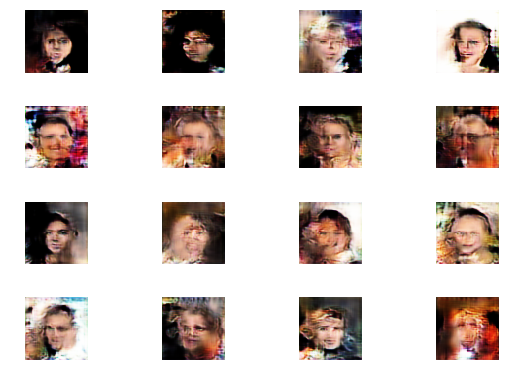

0: [D loss: 0.775619, acc: 0.601562] [A loss: 1.143087, acc: 0.468750]
1: [D loss: 0.784063, acc: 0.632812] [A loss: 1.402912, acc: 0.375000]
2: [D loss: 0.754676, acc: 0.609375] [A loss: 1.292851, acc: 0.375000]
3: [D loss: 0.800172, acc: 0.609375] [A loss: 1.116026, acc: 0.484375]
4: [D loss: 0.730891, acc: 0.664062] [A loss: 1.141107, acc: 0.359375]
5: [D loss: 0.879410, acc: 0.578125] [A loss: 1.264840, acc: 0.406250]
6: [D loss: 0.740128, acc: 0.625000] [A loss: 1.572446, acc: 0.343750]
7: [D loss: 0.854496, acc: 0.648438] [A loss: 1.334408, acc: 0.328125]
8: [D loss: 0.814522, acc: 0.562500] [A loss: 1.255984, acc: 0.406250]
9: [D loss: 0.798439, acc: 0.601562] [A loss: 1.364227, acc: 0.390625]
10: [D loss: 0.819836, acc: 0.617188] [A loss: 1.379195, acc: 0.406250]
11: [D loss: 0.800917, acc: 0.601562] [A loss: 1.468420, acc: 0.328125]
12: [D loss: 0.970732, acc: 0.531250] [A loss: 1.471840, acc: 0.359375]
13: [D loss: 0.807850, acc: 0.593750] [A loss: 1.165002, acc: 0.453125]
14

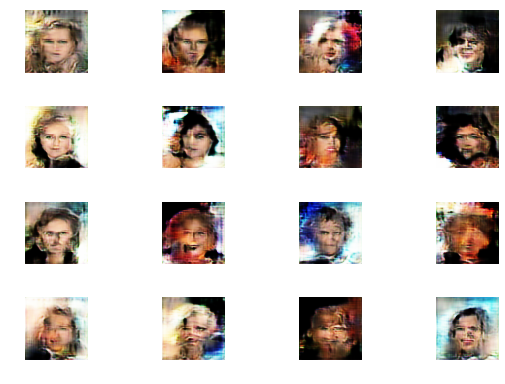

0: [D loss: 0.754918, acc: 0.632812] [A loss: 1.509708, acc: 0.250000]
1: [D loss: 0.957396, acc: 0.585938] [A loss: 1.538796, acc: 0.296875]
2: [D loss: 0.690969, acc: 0.656250] [A loss: 1.524951, acc: 0.343750]
3: [D loss: 0.705630, acc: 0.593750] [A loss: 1.484358, acc: 0.281250]
4: [D loss: 0.850482, acc: 0.570312] [A loss: 1.566070, acc: 0.296875]
5: [D loss: 0.721559, acc: 0.632812] [A loss: 1.797268, acc: 0.296875]
6: [D loss: 1.093471, acc: 0.531250] [A loss: 1.763891, acc: 0.281250]
7: [D loss: 0.965391, acc: 0.578125] [A loss: 1.924706, acc: 0.312500]
8: [D loss: 0.945207, acc: 0.554688] [A loss: 1.486086, acc: 0.343750]
9: [D loss: 0.938229, acc: 0.554688] [A loss: 1.602309, acc: 0.390625]
10: [D loss: 0.825397, acc: 0.585938] [A loss: 1.357204, acc: 0.343750]
11: [D loss: 0.797133, acc: 0.617188] [A loss: 1.614195, acc: 0.406250]
12: [D loss: 0.688408, acc: 0.640625] [A loss: 1.552441, acc: 0.328125]
13: [D loss: 0.933004, acc: 0.570312] [A loss: 1.463945, acc: 0.359375]
14

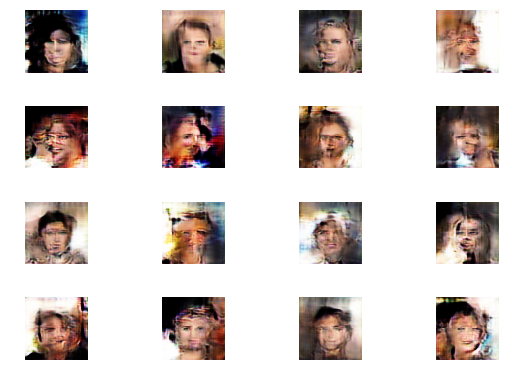

0: [D loss: 0.912978, acc: 0.570312] [A loss: 1.462646, acc: 0.328125]
1: [D loss: 0.710935, acc: 0.664062] [A loss: 1.553225, acc: 0.296875]
2: [D loss: 0.825297, acc: 0.585938] [A loss: 1.369964, acc: 0.421875]
3: [D loss: 0.835039, acc: 0.625000] [A loss: 1.461994, acc: 0.296875]
4: [D loss: 0.801172, acc: 0.585938] [A loss: 1.238361, acc: 0.328125]
5: [D loss: 0.840432, acc: 0.609375] [A loss: 1.323161, acc: 0.375000]
6: [D loss: 0.914657, acc: 0.554688] [A loss: 1.249113, acc: 0.437500]
7: [D loss: 0.721407, acc: 0.664062] [A loss: 1.341012, acc: 0.312500]
8: [D loss: 0.825770, acc: 0.562500] [A loss: 1.482263, acc: 0.375000]
9: [D loss: 0.995229, acc: 0.531250] [A loss: 1.099431, acc: 0.437500]
10: [D loss: 0.962000, acc: 0.554688] [A loss: 1.081337, acc: 0.453125]
11: [D loss: 0.948068, acc: 0.585938] [A loss: 1.419954, acc: 0.421875]
12: [D loss: 0.842579, acc: 0.648438] [A loss: 1.355970, acc: 0.390625]
13: [D loss: 0.910672, acc: 0.578125] [A loss: 1.066884, acc: 0.453125]
14

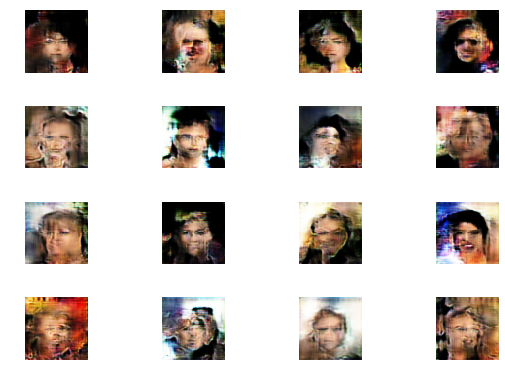

0: [D loss: 0.910489, acc: 0.468750] [A loss: 1.379823, acc: 0.390625]
1: [D loss: 0.972777, acc: 0.562500] [A loss: 1.309290, acc: 0.375000]
2: [D loss: 1.032756, acc: 0.546875] [A loss: 1.366761, acc: 0.359375]
3: [D loss: 0.903308, acc: 0.585938] [A loss: 1.517769, acc: 0.312500]
4: [D loss: 0.883800, acc: 0.601562] [A loss: 1.067481, acc: 0.453125]
5: [D loss: 1.015391, acc: 0.523438] [A loss: 1.741933, acc: 0.187500]
6: [D loss: 0.957465, acc: 0.546875] [A loss: 1.302408, acc: 0.515625]
7: [D loss: 1.048122, acc: 0.578125] [A loss: 1.384927, acc: 0.328125]
8: [D loss: 0.935831, acc: 0.585938] [A loss: 1.381370, acc: 0.390625]
9: [D loss: 0.999631, acc: 0.507812] [A loss: 1.370654, acc: 0.421875]
10: [D loss: 0.936581, acc: 0.546875] [A loss: 1.442371, acc: 0.343750]
11: [D loss: 0.826610, acc: 0.546875] [A loss: 1.139058, acc: 0.468750]
12: [D loss: 0.954730, acc: 0.578125] [A loss: 1.454038, acc: 0.390625]
13: [D loss: 0.973112, acc: 0.515625] [A loss: 1.380743, acc: 0.343750]
14

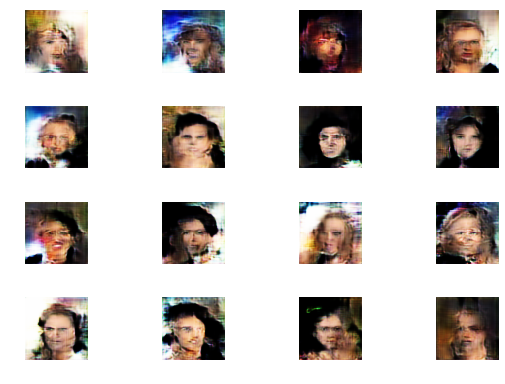

0: [D loss: 0.823994, acc: 0.570312] [A loss: 1.264794, acc: 0.375000]
1: [D loss: 0.905487, acc: 0.562500] [A loss: 1.263813, acc: 0.390625]
2: [D loss: 0.938936, acc: 0.578125] [A loss: 1.057320, acc: 0.468750]
3: [D loss: 0.979627, acc: 0.585938] [A loss: 1.230805, acc: 0.468750]
4: [D loss: 0.996520, acc: 0.515625] [A loss: 1.301689, acc: 0.437500]
5: [D loss: 0.968832, acc: 0.554688] [A loss: 1.415870, acc: 0.312500]
6: [D loss: 1.080661, acc: 0.554688] [A loss: 1.624077, acc: 0.328125]
7: [D loss: 0.826670, acc: 0.593750] [A loss: 1.491663, acc: 0.296875]
8: [D loss: 0.745630, acc: 0.617188] [A loss: 1.475340, acc: 0.328125]
9: [D loss: 0.877262, acc: 0.585938] [A loss: 1.325789, acc: 0.437500]
10: [D loss: 0.852262, acc: 0.640625] [A loss: 1.057799, acc: 0.453125]
11: [D loss: 1.003623, acc: 0.484375] [A loss: 1.400608, acc: 0.390625]
12: [D loss: 0.861099, acc: 0.570312] [A loss: 1.650655, acc: 0.328125]
13: [D loss: 0.987635, acc: 0.523438] [A loss: 1.495135, acc: 0.343750]
14

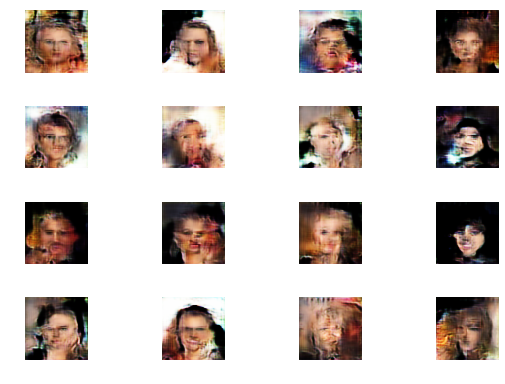

0: [D loss: 1.007172, acc: 0.539062] [A loss: 1.403696, acc: 0.421875]
1: [D loss: 0.755264, acc: 0.593750] [A loss: 1.584622, acc: 0.296875]
2: [D loss: 0.748049, acc: 0.664062] [A loss: 0.962410, acc: 0.515625]
3: [D loss: 0.865338, acc: 0.625000] [A loss: 1.358501, acc: 0.343750]
4: [D loss: 0.756907, acc: 0.695312] [A loss: 1.296595, acc: 0.390625]
5: [D loss: 1.011575, acc: 0.539062] [A loss: 1.438151, acc: 0.265625]
6: [D loss: 0.783601, acc: 0.617188] [A loss: 1.411904, acc: 0.343750]
7: [D loss: 0.713983, acc: 0.687500] [A loss: 1.459992, acc: 0.375000]
8: [D loss: 0.938844, acc: 0.585938] [A loss: 1.386769, acc: 0.390625]
9: [D loss: 0.820475, acc: 0.617188] [A loss: 1.342501, acc: 0.281250]
10: [D loss: 0.838166, acc: 0.601562] [A loss: 1.427100, acc: 0.375000]
11: [D loss: 1.015332, acc: 0.593750] [A loss: 1.269221, acc: 0.421875]
12: [D loss: 0.939092, acc: 0.578125] [A loss: 1.454406, acc: 0.343750]
13: [D loss: 0.900979, acc: 0.625000] [A loss: 1.723239, acc: 0.265625]
14

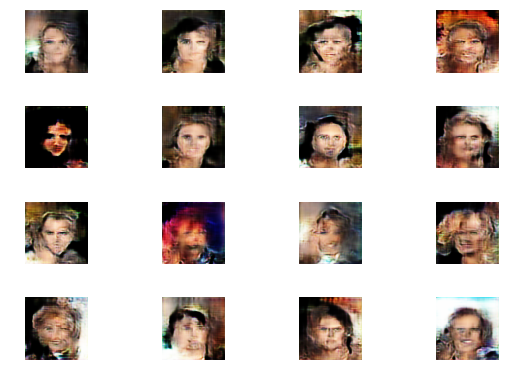

0: [D loss: 1.076698, acc: 0.546875] [A loss: 1.573836, acc: 0.421875]
1: [D loss: 0.877131, acc: 0.617188] [A loss: 1.621672, acc: 0.234375]
2: [D loss: 0.939780, acc: 0.601562] [A loss: 1.631335, acc: 0.343750]
3: [D loss: 1.050156, acc: 0.546875] [A loss: 1.293291, acc: 0.281250]
4: [D loss: 0.967221, acc: 0.539062] [A loss: 1.752860, acc: 0.328125]
5: [D loss: 0.959496, acc: 0.593750] [A loss: 1.426033, acc: 0.437500]
6: [D loss: 0.750094, acc: 0.617188] [A loss: 1.156219, acc: 0.500000]
7: [D loss: 1.053123, acc: 0.570312] [A loss: 1.544493, acc: 0.312500]
8: [D loss: 0.983619, acc: 0.523438] [A loss: 1.503195, acc: 0.375000]
9: [D loss: 0.825743, acc: 0.585938] [A loss: 1.404189, acc: 0.406250]
10: [D loss: 0.945247, acc: 0.570312] [A loss: 1.613538, acc: 0.375000]
11: [D loss: 0.863376, acc: 0.617188] [A loss: 1.213739, acc: 0.484375]
12: [D loss: 0.829899, acc: 0.617188] [A loss: 1.218690, acc: 0.484375]
13: [D loss: 0.940531, acc: 0.554688] [A loss: 1.157572, acc: 0.531250]
14

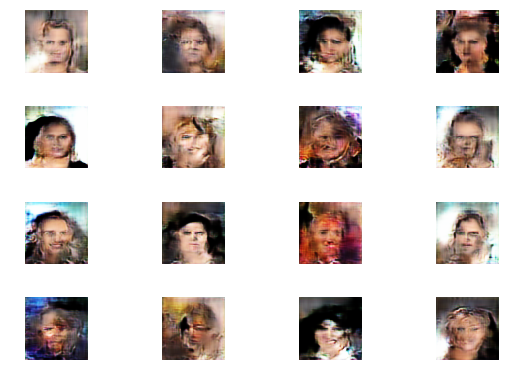

0: [D loss: 0.890484, acc: 0.648438] [A loss: 1.505484, acc: 0.359375]
1: [D loss: 0.975780, acc: 0.523438] [A loss: 1.262826, acc: 0.406250]
2: [D loss: 0.903264, acc: 0.562500] [A loss: 1.296228, acc: 0.375000]
3: [D loss: 0.882354, acc: 0.593750] [A loss: 1.283872, acc: 0.375000]
4: [D loss: 0.940143, acc: 0.523438] [A loss: 1.278636, acc: 0.421875]
5: [D loss: 0.765914, acc: 0.640625] [A loss: 1.653867, acc: 0.359375]
6: [D loss: 0.796661, acc: 0.625000] [A loss: 1.387499, acc: 0.421875]
7: [D loss: 1.026298, acc: 0.523438] [A loss: 1.282588, acc: 0.406250]
8: [D loss: 0.949842, acc: 0.593750] [A loss: 1.465004, acc: 0.390625]
9: [D loss: 1.087262, acc: 0.562500] [A loss: 1.311528, acc: 0.437500]
10: [D loss: 1.026710, acc: 0.515625] [A loss: 1.363081, acc: 0.406250]
11: [D loss: 1.078639, acc: 0.507812] [A loss: 1.256880, acc: 0.437500]
12: [D loss: 0.990144, acc: 0.570312] [A loss: 1.130112, acc: 0.390625]
13: [D loss: 1.078262, acc: 0.546875] [A loss: 1.522730, acc: 0.250000]
14

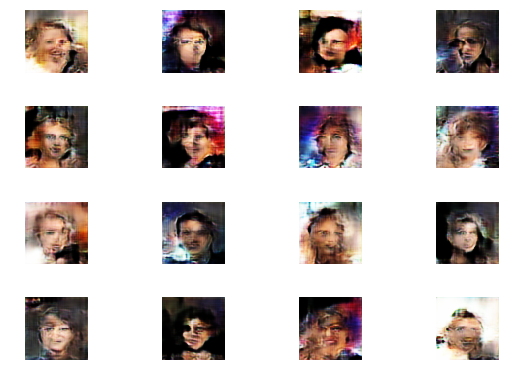

0: [D loss: 0.941549, acc: 0.570312] [A loss: 1.408450, acc: 0.359375]
1: [D loss: 0.884982, acc: 0.546875] [A loss: 1.237730, acc: 0.453125]
2: [D loss: 0.929399, acc: 0.593750] [A loss: 1.118858, acc: 0.421875]
3: [D loss: 0.787881, acc: 0.640625] [A loss: 1.391841, acc: 0.343750]
4: [D loss: 0.911093, acc: 0.562500] [A loss: 1.311838, acc: 0.406250]
5: [D loss: 0.989313, acc: 0.562500] [A loss: 1.397193, acc: 0.265625]
6: [D loss: 1.029703, acc: 0.562500] [A loss: 1.531525, acc: 0.375000]
7: [D loss: 0.950695, acc: 0.570312] [A loss: 1.468914, acc: 0.390625]
8: [D loss: 0.831853, acc: 0.562500] [A loss: 1.538806, acc: 0.375000]
9: [D loss: 0.961280, acc: 0.539062] [A loss: 1.673146, acc: 0.343750]
10: [D loss: 1.104165, acc: 0.492188] [A loss: 1.537259, acc: 0.265625]
11: [D loss: 0.973995, acc: 0.578125] [A loss: 1.227437, acc: 0.453125]
12: [D loss: 0.928898, acc: 0.585938] [A loss: 1.820408, acc: 0.187500]
13: [D loss: 0.999158, acc: 0.531250] [A loss: 1.575833, acc: 0.343750]
14

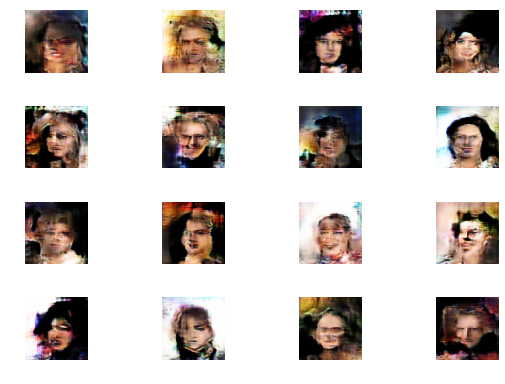

0: [D loss: 0.895803, acc: 0.601562] [A loss: 1.428753, acc: 0.437500]
1: [D loss: 1.090336, acc: 0.492188] [A loss: 1.113929, acc: 0.515625]
2: [D loss: 0.832403, acc: 0.601562] [A loss: 1.429352, acc: 0.312500]
3: [D loss: 0.883454, acc: 0.585938] [A loss: 1.302499, acc: 0.406250]
4: [D loss: 1.021605, acc: 0.460938] [A loss: 1.608307, acc: 0.312500]
5: [D loss: 0.920992, acc: 0.570312] [A loss: 1.486240, acc: 0.328125]
6: [D loss: 1.000185, acc: 0.539062] [A loss: 1.260572, acc: 0.406250]
7: [D loss: 0.993283, acc: 0.539062] [A loss: 1.384482, acc: 0.359375]
8: [D loss: 0.891628, acc: 0.640625] [A loss: 1.357438, acc: 0.343750]
9: [D loss: 0.782041, acc: 0.671875] [A loss: 1.416762, acc: 0.406250]
10: [D loss: 0.935095, acc: 0.585938] [A loss: 1.274988, acc: 0.437500]
11: [D loss: 0.801079, acc: 0.585938] [A loss: 1.610214, acc: 0.421875]
12: [D loss: 0.982242, acc: 0.570312] [A loss: 1.025069, acc: 0.468750]
13: [D loss: 0.826430, acc: 0.617188] [A loss: 1.090249, acc: 0.546875]
14

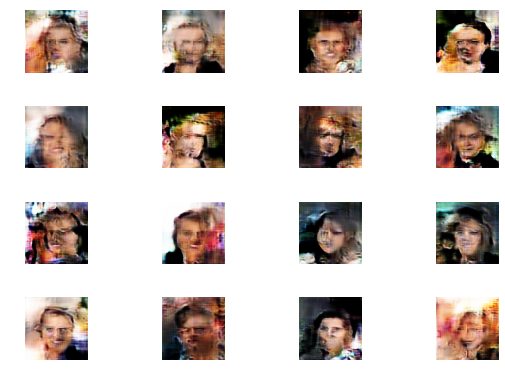

0: [D loss: 1.116787, acc: 0.539062] [A loss: 1.534575, acc: 0.281250]
1: [D loss: 0.926996, acc: 0.570312] [A loss: 1.601501, acc: 0.265625]
2: [D loss: 1.046664, acc: 0.515625] [A loss: 1.383033, acc: 0.390625]
3: [D loss: 1.051136, acc: 0.531250] [A loss: 1.364257, acc: 0.421875]
4: [D loss: 0.993357, acc: 0.523438] [A loss: 1.292978, acc: 0.421875]
5: [D loss: 1.112670, acc: 0.429688] [A loss: 1.531850, acc: 0.328125]
6: [D loss: 0.946317, acc: 0.609375] [A loss: 1.474902, acc: 0.375000]
7: [D loss: 1.180842, acc: 0.453125] [A loss: 1.301154, acc: 0.437500]
8: [D loss: 0.941033, acc: 0.578125] [A loss: 1.306050, acc: 0.437500]
9: [D loss: 0.939201, acc: 0.554688] [A loss: 1.127293, acc: 0.468750]
10: [D loss: 0.991464, acc: 0.601562] [A loss: 1.047927, acc: 0.500000]
11: [D loss: 0.899096, acc: 0.523438] [A loss: 1.245331, acc: 0.390625]
12: [D loss: 0.989342, acc: 0.554688] [A loss: 1.446675, acc: 0.359375]
13: [D loss: 0.916630, acc: 0.593750] [A loss: 1.668551, acc: 0.296875]
14

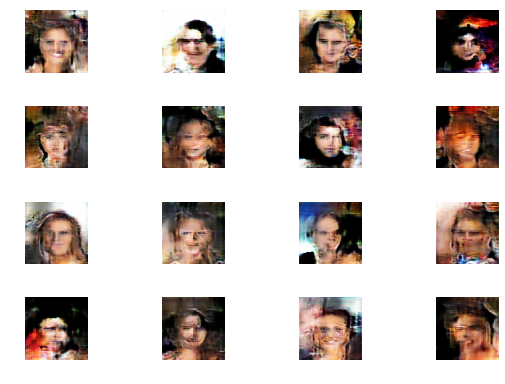

0: [D loss: 0.906975, acc: 0.570312] [A loss: 1.640122, acc: 0.281250]
1: [D loss: 1.054619, acc: 0.531250] [A loss: 1.503087, acc: 0.328125]
2: [D loss: 0.946844, acc: 0.500000] [A loss: 1.651969, acc: 0.343750]
3: [D loss: 0.747081, acc: 0.593750] [A loss: 1.667329, acc: 0.296875]
4: [D loss: 0.953084, acc: 0.554688] [A loss: 1.259340, acc: 0.453125]
5: [D loss: 0.877055, acc: 0.585938] [A loss: 1.425672, acc: 0.359375]
6: [D loss: 0.983184, acc: 0.546875] [A loss: 1.472881, acc: 0.343750]
7: [D loss: 0.944881, acc: 0.601562] [A loss: 1.702575, acc: 0.343750]
8: [D loss: 0.788752, acc: 0.609375] [A loss: 1.308224, acc: 0.390625]
9: [D loss: 0.929521, acc: 0.585938] [A loss: 1.466212, acc: 0.406250]
10: [D loss: 1.065082, acc: 0.507812] [A loss: 1.143185, acc: 0.546875]
11: [D loss: 0.878174, acc: 0.554688] [A loss: 1.429450, acc: 0.359375]
12: [D loss: 1.031673, acc: 0.546875] [A loss: 1.478548, acc: 0.343750]
13: [D loss: 0.965079, acc: 0.515625] [A loss: 1.510182, acc: 0.281250]
14

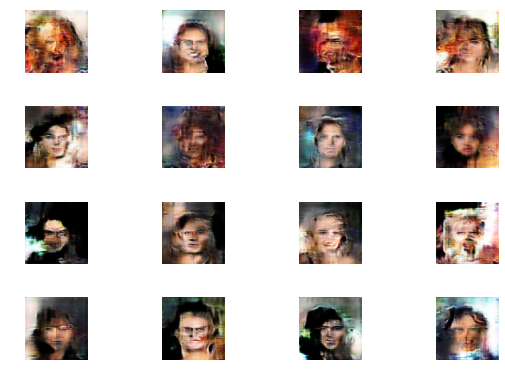

0: [D loss: 1.226609, acc: 0.500000] [A loss: 1.136584, acc: 0.468750]
1: [D loss: 1.072318, acc: 0.492188] [A loss: 1.237483, acc: 0.453125]
2: [D loss: 1.033587, acc: 0.515625] [A loss: 1.148810, acc: 0.500000]
3: [D loss: 0.844589, acc: 0.601562] [A loss: 1.383885, acc: 0.390625]
4: [D loss: 1.009125, acc: 0.539062] [A loss: 1.209924, acc: 0.468750]
5: [D loss: 0.988127, acc: 0.562500] [A loss: 1.105044, acc: 0.437500]
6: [D loss: 0.771634, acc: 0.609375] [A loss: 0.972631, acc: 0.578125]
7: [D loss: 0.983760, acc: 0.539062] [A loss: 1.340390, acc: 0.375000]
8: [D loss: 0.875315, acc: 0.578125] [A loss: 1.076235, acc: 0.406250]
9: [D loss: 0.830816, acc: 0.601562] [A loss: 1.261682, acc: 0.421875]
10: [D loss: 0.984853, acc: 0.507812] [A loss: 1.360948, acc: 0.453125]
11: [D loss: 0.975384, acc: 0.515625] [A loss: 1.437524, acc: 0.359375]
12: [D loss: 0.870391, acc: 0.593750] [A loss: 1.464707, acc: 0.281250]
13: [D loss: 0.983986, acc: 0.539062] [A loss: 1.048881, acc: 0.468750]
14

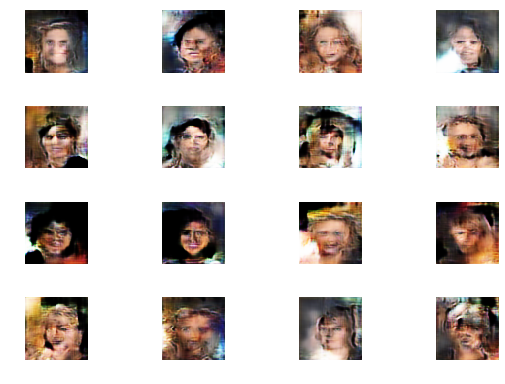

0: [D loss: 0.977250, acc: 0.585938] [A loss: 1.122801, acc: 0.406250]
1: [D loss: 0.961019, acc: 0.507812] [A loss: 1.359372, acc: 0.375000]
2: [D loss: 0.839525, acc: 0.664062] [A loss: 1.289907, acc: 0.421875]
3: [D loss: 0.821971, acc: 0.601562] [A loss: 0.973097, acc: 0.531250]
4: [D loss: 0.887477, acc: 0.609375] [A loss: 1.138164, acc: 0.500000]
5: [D loss: 0.993687, acc: 0.523438] [A loss: 1.432877, acc: 0.453125]
6: [D loss: 0.882293, acc: 0.585938] [A loss: 1.213656, acc: 0.421875]
7: [D loss: 1.089035, acc: 0.500000] [A loss: 1.528724, acc: 0.375000]
8: [D loss: 0.832942, acc: 0.632812] [A loss: 1.342902, acc: 0.453125]
9: [D loss: 1.009566, acc: 0.531250] [A loss: 1.446353, acc: 0.453125]
10: [D loss: 0.959563, acc: 0.585938] [A loss: 1.251176, acc: 0.437500]
11: [D loss: 0.827502, acc: 0.593750] [A loss: 1.359977, acc: 0.406250]
12: [D loss: 0.948455, acc: 0.507812] [A loss: 1.219207, acc: 0.484375]
13: [D loss: 0.985299, acc: 0.539062] [A loss: 1.581384, acc: 0.296875]
14

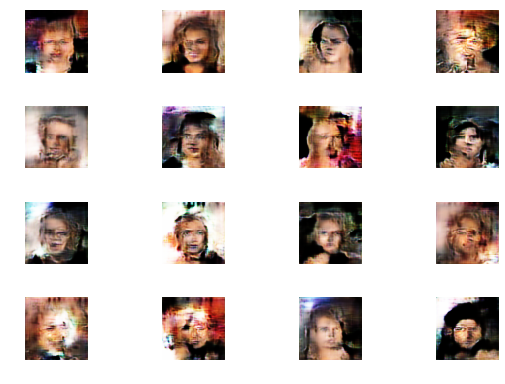

0: [D loss: 0.738095, acc: 0.632812] [A loss: 1.315272, acc: 0.343750]
1: [D loss: 0.899542, acc: 0.632812] [A loss: 1.132419, acc: 0.406250]
2: [D loss: 0.734472, acc: 0.632812] [A loss: 1.716790, acc: 0.312500]
3: [D loss: 0.949571, acc: 0.570312] [A loss: 1.272394, acc: 0.359375]
4: [D loss: 0.842806, acc: 0.679688] [A loss: 1.305532, acc: 0.390625]
5: [D loss: 0.998995, acc: 0.570312] [A loss: 1.036881, acc: 0.578125]
6: [D loss: 1.027139, acc: 0.507812] [A loss: 1.158237, acc: 0.406250]
7: [D loss: 1.069496, acc: 0.492188] [A loss: 1.431295, acc: 0.343750]
8: [D loss: 0.812128, acc: 0.625000] [A loss: 1.388865, acc: 0.421875]
9: [D loss: 1.031293, acc: 0.523438] [A loss: 1.158877, acc: 0.421875]
10: [D loss: 0.996680, acc: 0.523438] [A loss: 1.369164, acc: 0.328125]
11: [D loss: 0.998356, acc: 0.539062] [A loss: 1.170300, acc: 0.421875]
12: [D loss: 1.102834, acc: 0.414062] [A loss: 1.276944, acc: 0.390625]
13: [D loss: 0.914953, acc: 0.570312] [A loss: 1.502149, acc: 0.250000]
14

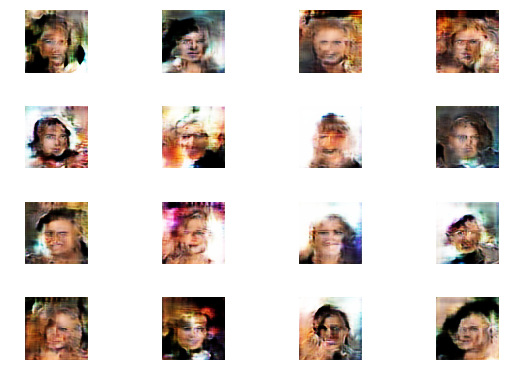

0: [D loss: 0.864736, acc: 0.570312] [A loss: 1.211218, acc: 0.406250]
1: [D loss: 0.809984, acc: 0.664062] [A loss: 1.044492, acc: 0.468750]
2: [D loss: 0.934714, acc: 0.492188] [A loss: 1.137810, acc: 0.406250]
3: [D loss: 1.144267, acc: 0.554688] [A loss: 1.352592, acc: 0.406250]
4: [D loss: 0.887414, acc: 0.625000] [A loss: 1.329490, acc: 0.343750]
5: [D loss: 0.873008, acc: 0.578125] [A loss: 1.302282, acc: 0.375000]
6: [D loss: 1.006504, acc: 0.554688] [A loss: 1.277040, acc: 0.406250]
7: [D loss: 0.933499, acc: 0.562500] [A loss: 1.253547, acc: 0.343750]
8: [D loss: 0.893809, acc: 0.578125] [A loss: 1.210547, acc: 0.421875]
9: [D loss: 0.848635, acc: 0.625000] [A loss: 1.442760, acc: 0.296875]
10: [D loss: 1.005424, acc: 0.562500] [A loss: 1.585188, acc: 0.343750]
11: [D loss: 0.958538, acc: 0.531250] [A loss: 1.298524, acc: 0.453125]
12: [D loss: 0.952081, acc: 0.554688] [A loss: 1.307083, acc: 0.500000]
13: [D loss: 0.955101, acc: 0.570312] [A loss: 1.270716, acc: 0.515625]
14

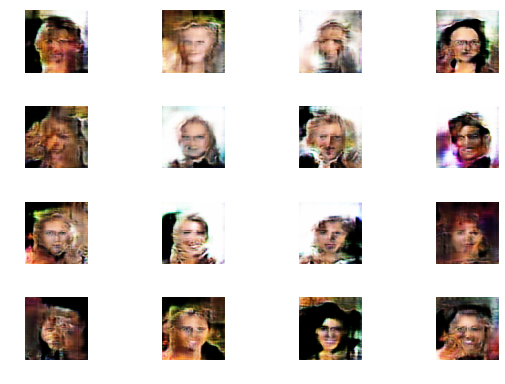

0: [D loss: 1.058627, acc: 0.515625] [A loss: 1.393900, acc: 0.421875]
1: [D loss: 1.076353, acc: 0.492188] [A loss: 1.399495, acc: 0.312500]
2: [D loss: 0.733792, acc: 0.648438] [A loss: 1.256409, acc: 0.406250]
3: [D loss: 0.825506, acc: 0.609375] [A loss: 1.114044, acc: 0.421875]
4: [D loss: 0.858423, acc: 0.593750] [A loss: 1.374194, acc: 0.281250]
5: [D loss: 0.857619, acc: 0.593750] [A loss: 1.446930, acc: 0.437500]
6: [D loss: 0.911489, acc: 0.593750] [A loss: 0.957576, acc: 0.484375]
7: [D loss: 0.957128, acc: 0.570312] [A loss: 1.495597, acc: 0.406250]
8: [D loss: 1.012430, acc: 0.546875] [A loss: 1.332905, acc: 0.343750]
9: [D loss: 0.852230, acc: 0.593750] [A loss: 1.408031, acc: 0.359375]
10: [D loss: 0.967801, acc: 0.578125] [A loss: 1.392455, acc: 0.390625]
11: [D loss: 1.013894, acc: 0.539062] [A loss: 1.284896, acc: 0.437500]
12: [D loss: 0.972060, acc: 0.593750] [A loss: 1.557056, acc: 0.359375]
13: [D loss: 0.901197, acc: 0.585938] [A loss: 1.207120, acc: 0.453125]
14

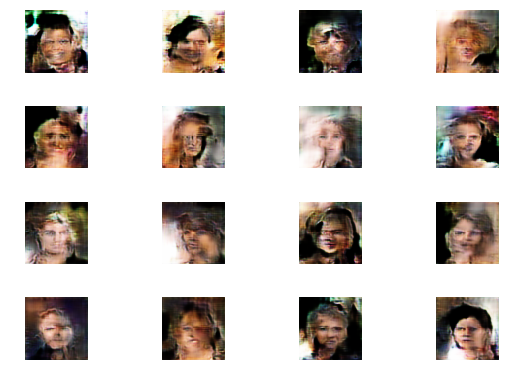

0: [D loss: 0.888036, acc: 0.531250] [A loss: 1.079367, acc: 0.484375]
1: [D loss: 1.080742, acc: 0.515625] [A loss: 1.486160, acc: 0.312500]
2: [D loss: 1.003503, acc: 0.523438] [A loss: 1.250304, acc: 0.375000]
3: [D loss: 0.896018, acc: 0.570312] [A loss: 1.224651, acc: 0.343750]
4: [D loss: 0.882984, acc: 0.585938] [A loss: 1.151479, acc: 0.453125]
5: [D loss: 0.860540, acc: 0.609375] [A loss: 1.244534, acc: 0.390625]
6: [D loss: 0.846269, acc: 0.554688] [A loss: 1.427704, acc: 0.250000]
7: [D loss: 0.916707, acc: 0.554688] [A loss: 1.051614, acc: 0.453125]
8: [D loss: 0.919421, acc: 0.585938] [A loss: 0.938223, acc: 0.468750]
9: [D loss: 0.959612, acc: 0.609375] [A loss: 1.208379, acc: 0.390625]
10: [D loss: 0.729743, acc: 0.609375] [A loss: 1.279585, acc: 0.296875]
11: [D loss: 0.954319, acc: 0.515625] [A loss: 1.426204, acc: 0.312500]
12: [D loss: 0.945046, acc: 0.492188] [A loss: 1.337504, acc: 0.328125]
13: [D loss: 0.764162, acc: 0.664062] [A loss: 1.345837, acc: 0.406250]
14

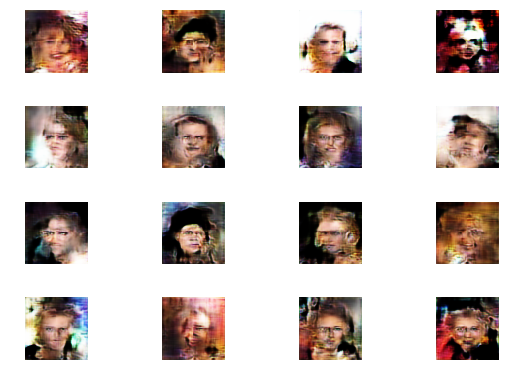

0: [D loss: 0.922517, acc: 0.554688] [A loss: 1.613520, acc: 0.312500]
1: [D loss: 0.922047, acc: 0.554688] [A loss: 1.553973, acc: 0.343750]
2: [D loss: 1.076357, acc: 0.507812] [A loss: 1.362148, acc: 0.406250]
3: [D loss: 0.989714, acc: 0.500000] [A loss: 1.451309, acc: 0.328125]
4: [D loss: 0.816522, acc: 0.609375] [A loss: 1.308529, acc: 0.406250]
5: [D loss: 0.963259, acc: 0.578125] [A loss: 1.246868, acc: 0.406250]
6: [D loss: 0.952680, acc: 0.570312] [A loss: 1.072148, acc: 0.468750]
7: [D loss: 1.054927, acc: 0.515625] [A loss: 0.959983, acc: 0.578125]
8: [D loss: 0.854079, acc: 0.578125] [A loss: 1.437005, acc: 0.468750]
9: [D loss: 1.056936, acc: 0.507812] [A loss: 1.307593, acc: 0.437500]
10: [D loss: 0.813915, acc: 0.578125] [A loss: 1.307434, acc: 0.390625]
11: [D loss: 0.944101, acc: 0.609375] [A loss: 1.144224, acc: 0.468750]
12: [D loss: 0.964647, acc: 0.507812] [A loss: 1.408918, acc: 0.328125]
13: [D loss: 0.986087, acc: 0.585938] [A loss: 1.460853, acc: 0.343750]
14

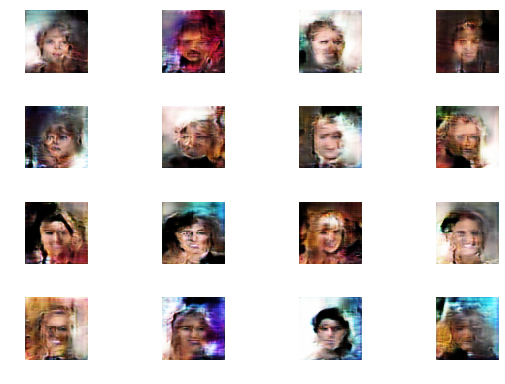

0: [D loss: 1.119668, acc: 0.492188] [A loss: 1.522510, acc: 0.296875]
1: [D loss: 1.028690, acc: 0.562500] [A loss: 1.539076, acc: 0.343750]
2: [D loss: 0.910513, acc: 0.562500] [A loss: 1.611349, acc: 0.312500]
3: [D loss: 0.866764, acc: 0.578125] [A loss: 1.220598, acc: 0.468750]
4: [D loss: 1.168575, acc: 0.484375] [A loss: 1.705944, acc: 0.296875]
5: [D loss: 0.883992, acc: 0.539062] [A loss: 1.110210, acc: 0.421875]
6: [D loss: 0.886964, acc: 0.570312] [A loss: 1.212781, acc: 0.468750]
7: [D loss: 0.846381, acc: 0.570312] [A loss: 1.249649, acc: 0.453125]
8: [D loss: 0.965455, acc: 0.593750] [A loss: 1.049876, acc: 0.437500]
9: [D loss: 0.916164, acc: 0.601562] [A loss: 1.196551, acc: 0.406250]
10: [D loss: 1.008488, acc: 0.570312] [A loss: 1.027497, acc: 0.468750]
11: [D loss: 1.011652, acc: 0.500000] [A loss: 1.160116, acc: 0.453125]
12: [D loss: 0.989993, acc: 0.531250] [A loss: 1.066298, acc: 0.484375]
13: [D loss: 0.961641, acc: 0.507812] [A loss: 0.980574, acc: 0.531250]
14

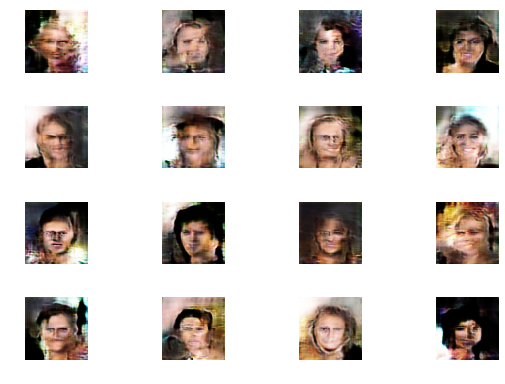

0: [D loss: 0.940187, acc: 0.546875] [A loss: 1.226232, acc: 0.390625]
1: [D loss: 1.016548, acc: 0.578125] [A loss: 1.123630, acc: 0.421875]
2: [D loss: 0.990354, acc: 0.578125] [A loss: 1.497435, acc: 0.390625]
3: [D loss: 0.957483, acc: 0.523438] [A loss: 1.312137, acc: 0.390625]
4: [D loss: 1.051695, acc: 0.468750] [A loss: 1.479995, acc: 0.343750]
5: [D loss: 0.920000, acc: 0.539062] [A loss: 1.304430, acc: 0.421875]
6: [D loss: 0.959460, acc: 0.562500] [A loss: 1.148181, acc: 0.406250]
7: [D loss: 0.930762, acc: 0.523438] [A loss: 1.076512, acc: 0.421875]
8: [D loss: 0.885660, acc: 0.500000] [A loss: 1.290086, acc: 0.343750]
9: [D loss: 1.066240, acc: 0.554688] [A loss: 1.474610, acc: 0.343750]
10: [D loss: 0.966771, acc: 0.554688] [A loss: 1.384946, acc: 0.343750]
11: [D loss: 0.869465, acc: 0.562500] [A loss: 1.216987, acc: 0.421875]
12: [D loss: 0.892076, acc: 0.578125] [A loss: 1.149935, acc: 0.406250]
13: [D loss: 0.962384, acc: 0.585938] [A loss: 1.010353, acc: 0.500000]
14

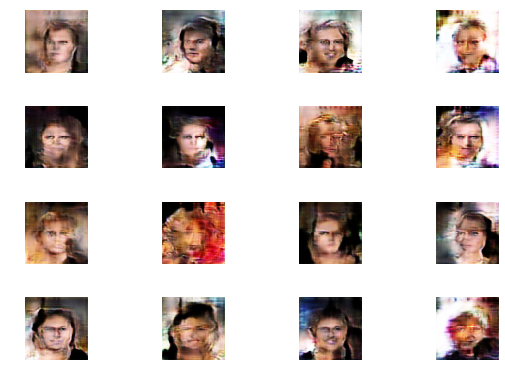

0: [D loss: 0.882371, acc: 0.585938] [A loss: 1.299204, acc: 0.359375]
1: [D loss: 0.959663, acc: 0.507812] [A loss: 1.264768, acc: 0.375000]
2: [D loss: 1.221368, acc: 0.484375] [A loss: 1.137026, acc: 0.421875]
3: [D loss: 0.834772, acc: 0.625000] [A loss: 1.098622, acc: 0.484375]
4: [D loss: 1.014736, acc: 0.523438] [A loss: 1.585119, acc: 0.265625]
5: [D loss: 0.972593, acc: 0.531250] [A loss: 1.135496, acc: 0.390625]
6: [D loss: 0.809932, acc: 0.593750] [A loss: 1.323569, acc: 0.375000]
7: [D loss: 0.773756, acc: 0.640625] [A loss: 1.334658, acc: 0.375000]
8: [D loss: 0.945078, acc: 0.531250] [A loss: 1.014586, acc: 0.515625]
9: [D loss: 0.933185, acc: 0.546875] [A loss: 1.109128, acc: 0.453125]
10: [D loss: 0.991021, acc: 0.507812] [A loss: 1.171450, acc: 0.468750]
11: [D loss: 1.090284, acc: 0.515625] [A loss: 0.966741, acc: 0.484375]
12: [D loss: 0.868045, acc: 0.593750] [A loss: 1.225519, acc: 0.375000]
13: [D loss: 1.005100, acc: 0.515625] [A loss: 1.033763, acc: 0.515625]
14

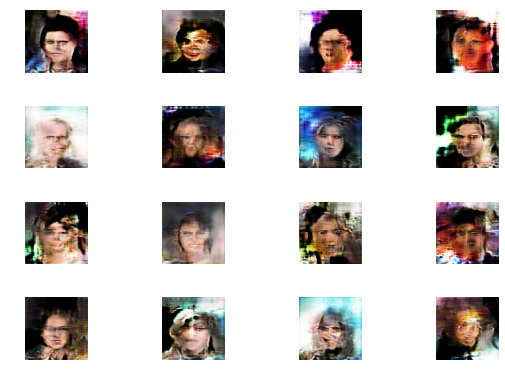

0: [D loss: 0.777408, acc: 0.625000] [A loss: 1.498602, acc: 0.390625]
1: [D loss: 0.919862, acc: 0.570312] [A loss: 1.225080, acc: 0.375000]
2: [D loss: 1.079312, acc: 0.507812] [A loss: 1.136881, acc: 0.500000]
3: [D loss: 1.112529, acc: 0.523438] [A loss: 1.527634, acc: 0.328125]
4: [D loss: 0.969916, acc: 0.507812] [A loss: 1.583690, acc: 0.312500]
5: [D loss: 1.039716, acc: 0.500000] [A loss: 1.334134, acc: 0.375000]
6: [D loss: 0.796110, acc: 0.632812] [A loss: 1.108160, acc: 0.453125]
7: [D loss: 0.970269, acc: 0.570312] [A loss: 1.231126, acc: 0.468750]
8: [D loss: 1.093580, acc: 0.453125] [A loss: 1.175208, acc: 0.437500]
9: [D loss: 0.818295, acc: 0.570312] [A loss: 1.028513, acc: 0.468750]
10: [D loss: 1.057382, acc: 0.484375] [A loss: 1.018480, acc: 0.468750]
11: [D loss: 0.894357, acc: 0.554688] [A loss: 1.204175, acc: 0.453125]
12: [D loss: 0.863783, acc: 0.625000] [A loss: 1.150143, acc: 0.437500]
13: [D loss: 0.973920, acc: 0.500000] [A loss: 1.279774, acc: 0.437500]
14

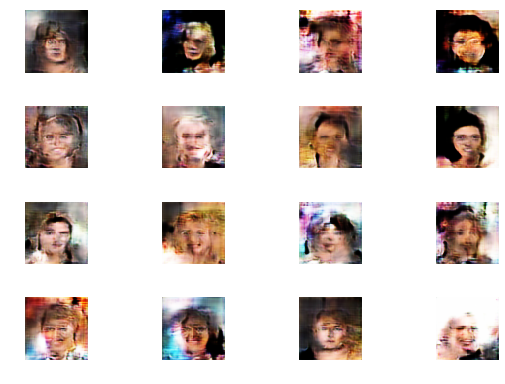

0: [D loss: 0.862785, acc: 0.554688] [A loss: 1.183037, acc: 0.406250]
1: [D loss: 0.999763, acc: 0.554688] [A loss: 1.311472, acc: 0.390625]
2: [D loss: 0.808794, acc: 0.679688] [A loss: 1.237103, acc: 0.437500]
3: [D loss: 0.892376, acc: 0.546875] [A loss: 1.217798, acc: 0.500000]
4: [D loss: 0.930026, acc: 0.539062] [A loss: 1.145539, acc: 0.453125]
5: [D loss: 0.861849, acc: 0.585938] [A loss: 1.121995, acc: 0.421875]
6: [D loss: 0.864029, acc: 0.625000] [A loss: 1.176307, acc: 0.484375]
7: [D loss: 1.085180, acc: 0.539062] [A loss: 1.188815, acc: 0.421875]
8: [D loss: 0.916585, acc: 0.585938] [A loss: 1.321477, acc: 0.406250]
9: [D loss: 0.912686, acc: 0.546875] [A loss: 1.339095, acc: 0.437500]
10: [D loss: 1.235270, acc: 0.484375] [A loss: 1.466984, acc: 0.328125]
11: [D loss: 1.035410, acc: 0.531250] [A loss: 1.103500, acc: 0.437500]
12: [D loss: 1.105054, acc: 0.468750] [A loss: 1.116732, acc: 0.437500]
13: [D loss: 0.971064, acc: 0.507812] [A loss: 0.916845, acc: 0.515625]
14

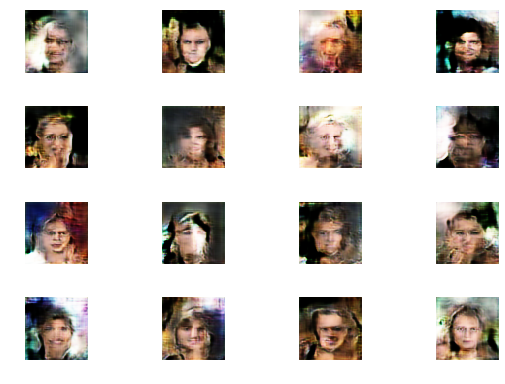

0: [D loss: 0.899774, acc: 0.554688] [A loss: 1.493262, acc: 0.234375]
1: [D loss: 1.036964, acc: 0.531250] [A loss: 1.178612, acc: 0.406250]
2: [D loss: 0.868426, acc: 0.570312] [A loss: 1.258840, acc: 0.343750]
3: [D loss: 0.948844, acc: 0.593750] [A loss: 1.468860, acc: 0.437500]
4: [D loss: 1.140632, acc: 0.468750] [A loss: 1.350882, acc: 0.421875]
5: [D loss: 0.921301, acc: 0.523438] [A loss: 1.311834, acc: 0.406250]
6: [D loss: 0.923475, acc: 0.585938] [A loss: 1.270547, acc: 0.390625]
7: [D loss: 1.007700, acc: 0.539062] [A loss: 1.206491, acc: 0.437500]
8: [D loss: 0.924053, acc: 0.554688] [A loss: 1.521214, acc: 0.328125]
9: [D loss: 0.841675, acc: 0.585938] [A loss: 1.136711, acc: 0.375000]
10: [D loss: 0.906812, acc: 0.585938] [A loss: 1.178881, acc: 0.375000]
11: [D loss: 0.995932, acc: 0.554688] [A loss: 1.368097, acc: 0.312500]
12: [D loss: 1.140887, acc: 0.492188] [A loss: 1.293063, acc: 0.390625]
13: [D loss: 1.038468, acc: 0.484375] [A loss: 1.092572, acc: 0.375000]
14

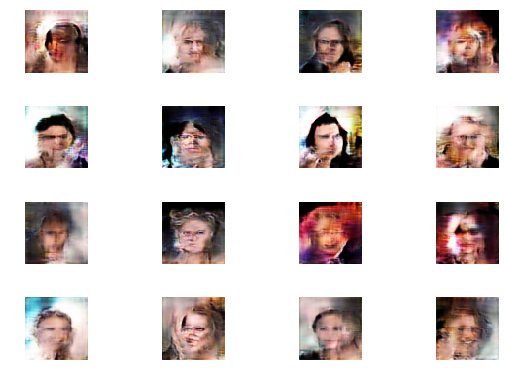

0: [D loss: 0.911767, acc: 0.570312] [A loss: 1.406908, acc: 0.343750]
1: [D loss: 0.953603, acc: 0.539062] [A loss: 1.297204, acc: 0.359375]
2: [D loss: 1.117038, acc: 0.507812] [A loss: 1.352062, acc: 0.406250]
3: [D loss: 0.862961, acc: 0.609375] [A loss: 1.136553, acc: 0.515625]
4: [D loss: 1.009977, acc: 0.539062] [A loss: 1.137781, acc: 0.437500]
5: [D loss: 0.882582, acc: 0.585938] [A loss: 1.089029, acc: 0.484375]
6: [D loss: 0.973322, acc: 0.546875] [A loss: 1.285076, acc: 0.406250]
7: [D loss: 0.920990, acc: 0.500000] [A loss: 1.140815, acc: 0.437500]
8: [D loss: 1.020323, acc: 0.476562] [A loss: 1.004749, acc: 0.421875]
9: [D loss: 1.071453, acc: 0.515625] [A loss: 1.127828, acc: 0.421875]
10: [D loss: 0.954492, acc: 0.492188] [A loss: 1.363285, acc: 0.312500]
11: [D loss: 0.822345, acc: 0.656250] [A loss: 1.073623, acc: 0.484375]
12: [D loss: 1.023755, acc: 0.539062] [A loss: 1.112322, acc: 0.437500]
13: [D loss: 0.841231, acc: 0.570312] [A loss: 1.163098, acc: 0.406250]
14

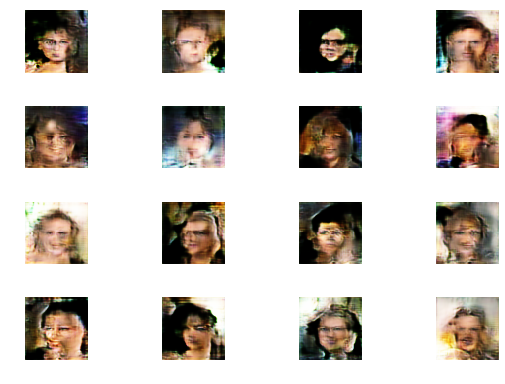

0: [D loss: 0.882446, acc: 0.609375] [A loss: 1.413790, acc: 0.421875]
1: [D loss: 0.802298, acc: 0.578125] [A loss: 1.304370, acc: 0.421875]
2: [D loss: 0.917895, acc: 0.585938] [A loss: 1.360339, acc: 0.265625]
3: [D loss: 1.118941, acc: 0.546875] [A loss: 1.272176, acc: 0.437500]
4: [D loss: 1.170552, acc: 0.531250] [A loss: 1.147588, acc: 0.484375]
5: [D loss: 0.944976, acc: 0.554688] [A loss: 1.350039, acc: 0.390625]
6: [D loss: 1.045190, acc: 0.515625] [A loss: 1.253417, acc: 0.468750]
7: [D loss: 0.994533, acc: 0.578125] [A loss: 1.396923, acc: 0.296875]
8: [D loss: 0.821870, acc: 0.609375] [A loss: 1.155922, acc: 0.453125]
9: [D loss: 0.988109, acc: 0.515625] [A loss: 1.477202, acc: 0.406250]
10: [D loss: 0.763581, acc: 0.617188] [A loss: 1.094158, acc: 0.531250]
11: [D loss: 1.013513, acc: 0.507812] [A loss: 1.167722, acc: 0.312500]
12: [D loss: 1.050493, acc: 0.539062] [A loss: 1.184315, acc: 0.484375]
13: [D loss: 0.891410, acc: 0.492188] [A loss: 1.327872, acc: 0.437500]
14

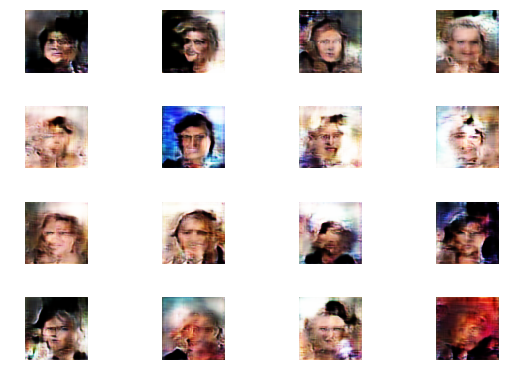

0: [D loss: 0.830280, acc: 0.578125] [A loss: 1.045052, acc: 0.515625]
1: [D loss: 1.004204, acc: 0.492188] [A loss: 1.299243, acc: 0.406250]
2: [D loss: 1.201651, acc: 0.460938] [A loss: 0.971196, acc: 0.468750]
3: [D loss: 1.210778, acc: 0.453125] [A loss: 1.062266, acc: 0.375000]
4: [D loss: 1.052663, acc: 0.500000] [A loss: 1.208541, acc: 0.484375]
5: [D loss: 0.996687, acc: 0.546875] [A loss: 0.996147, acc: 0.546875]
6: [D loss: 0.913967, acc: 0.539062] [A loss: 1.237657, acc: 0.406250]
7: [D loss: 1.080053, acc: 0.500000] [A loss: 1.152576, acc: 0.343750]
8: [D loss: 1.060914, acc: 0.484375] [A loss: 1.392395, acc: 0.328125]
9: [D loss: 0.991006, acc: 0.500000] [A loss: 1.516751, acc: 0.390625]
10: [D loss: 0.880584, acc: 0.554688] [A loss: 1.014725, acc: 0.468750]
11: [D loss: 1.040698, acc: 0.515625] [A loss: 1.018008, acc: 0.484375]
12: [D loss: 0.875728, acc: 0.601562] [A loss: 1.141603, acc: 0.453125]
13: [D loss: 0.900365, acc: 0.554688] [A loss: 1.309115, acc: 0.421875]
14

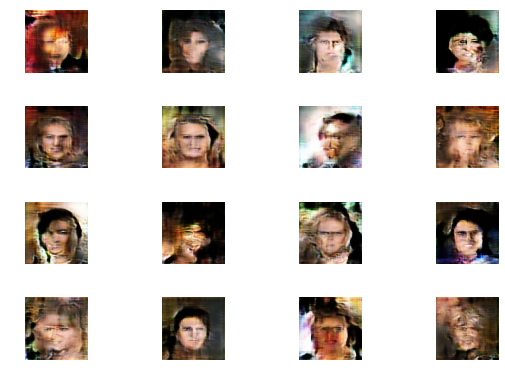

0: [D loss: 1.015028, acc: 0.500000] [A loss: 1.016965, acc: 0.468750]
1: [D loss: 0.907850, acc: 0.554688] [A loss: 1.186036, acc: 0.546875]
2: [D loss: 0.846379, acc: 0.625000] [A loss: 1.181166, acc: 0.453125]
3: [D loss: 0.875999, acc: 0.546875] [A loss: 0.957464, acc: 0.515625]
4: [D loss: 0.956100, acc: 0.546875] [A loss: 1.273759, acc: 0.500000]
5: [D loss: 1.056620, acc: 0.523438] [A loss: 1.404024, acc: 0.375000]
6: [D loss: 1.058335, acc: 0.562500] [A loss: 1.188662, acc: 0.484375]
7: [D loss: 0.788664, acc: 0.632812] [A loss: 1.402500, acc: 0.390625]
8: [D loss: 1.014631, acc: 0.523438] [A loss: 1.203435, acc: 0.437500]
9: [D loss: 0.880777, acc: 0.609375] [A loss: 1.087835, acc: 0.390625]
10: [D loss: 0.974649, acc: 0.531250] [A loss: 1.127457, acc: 0.468750]
11: [D loss: 1.161020, acc: 0.523438] [A loss: 1.131809, acc: 0.421875]
12: [D loss: 1.011431, acc: 0.539062] [A loss: 1.120605, acc: 0.421875]
13: [D loss: 0.962857, acc: 0.492188] [A loss: 1.214029, acc: 0.421875]
14

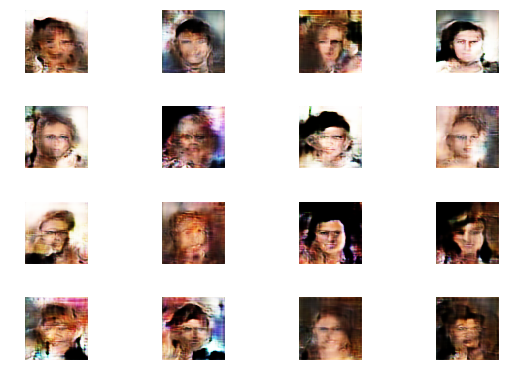

0: [D loss: 0.933829, acc: 0.585938] [A loss: 0.947318, acc: 0.484375]
1: [D loss: 1.025564, acc: 0.539062] [A loss: 1.289378, acc: 0.359375]
2: [D loss: 0.951761, acc: 0.546875] [A loss: 1.347447, acc: 0.359375]
3: [D loss: 1.004539, acc: 0.453125] [A loss: 1.360774, acc: 0.359375]
4: [D loss: 0.875588, acc: 0.585938] [A loss: 1.372736, acc: 0.296875]
5: [D loss: 0.918182, acc: 0.546875] [A loss: 1.194520, acc: 0.359375]
6: [D loss: 1.125264, acc: 0.492188] [A loss: 1.395121, acc: 0.375000]
7: [D loss: 1.031729, acc: 0.515625] [A loss: 1.312484, acc: 0.390625]
8: [D loss: 0.963760, acc: 0.585938] [A loss: 1.214803, acc: 0.468750]
9: [D loss: 1.190827, acc: 0.476562] [A loss: 1.233960, acc: 0.421875]
10: [D loss: 1.123119, acc: 0.468750] [A loss: 1.114079, acc: 0.546875]
11: [D loss: 0.958782, acc: 0.531250] [A loss: 1.167773, acc: 0.406250]
12: [D loss: 1.138581, acc: 0.523438] [A loss: 0.888104, acc: 0.593750]
13: [D loss: 1.008323, acc: 0.554688] [A loss: 0.983401, acc: 0.484375]
14

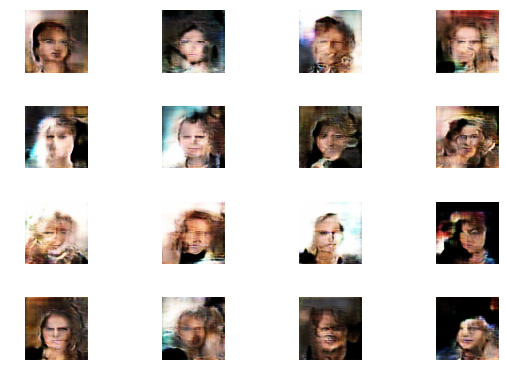

0: [D loss: 0.902998, acc: 0.617188] [A loss: 1.183712, acc: 0.390625]
1: [D loss: 0.839888, acc: 0.593750] [A loss: 1.228471, acc: 0.406250]
2: [D loss: 1.010818, acc: 0.554688] [A loss: 1.219014, acc: 0.468750]
3: [D loss: 0.894684, acc: 0.562500] [A loss: 1.320233, acc: 0.453125]
4: [D loss: 0.922468, acc: 0.546875] [A loss: 1.106921, acc: 0.453125]
5: [D loss: 0.859456, acc: 0.562500] [A loss: 1.182271, acc: 0.500000]
6: [D loss: 0.939891, acc: 0.593750] [A loss: 0.914419, acc: 0.578125]
7: [D loss: 0.956041, acc: 0.507812] [A loss: 0.858282, acc: 0.500000]
8: [D loss: 1.081416, acc: 0.492188] [A loss: 1.033025, acc: 0.515625]
9: [D loss: 0.895820, acc: 0.546875] [A loss: 1.384456, acc: 0.406250]
10: [D loss: 0.953828, acc: 0.585938] [A loss: 1.162410, acc: 0.343750]
11: [D loss: 0.944544, acc: 0.601562] [A loss: 0.896329, acc: 0.593750]
12: [D loss: 1.127080, acc: 0.484375] [A loss: 1.121433, acc: 0.453125]
13: [D loss: 1.020733, acc: 0.546875] [A loss: 0.983407, acc: 0.453125]
14

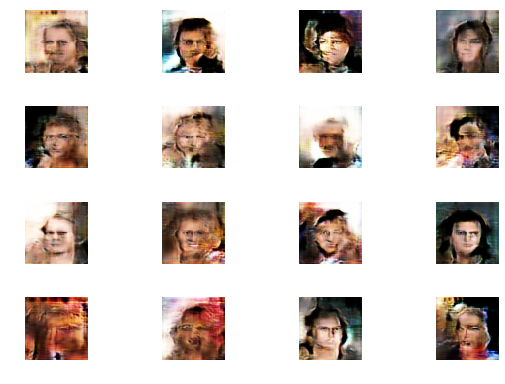

0: [D loss: 1.189932, acc: 0.500000] [A loss: 1.281141, acc: 0.390625]
1: [D loss: 1.129070, acc: 0.460938] [A loss: 0.943054, acc: 0.500000]
2: [D loss: 0.979008, acc: 0.554688] [A loss: 1.133098, acc: 0.468750]
3: [D loss: 1.047550, acc: 0.531250] [A loss: 1.256979, acc: 0.390625]
4: [D loss: 0.794681, acc: 0.578125] [A loss: 1.031573, acc: 0.468750]
5: [D loss: 1.091068, acc: 0.531250] [A loss: 1.426869, acc: 0.359375]
6: [D loss: 1.066659, acc: 0.484375] [A loss: 1.303259, acc: 0.312500]
7: [D loss: 0.985094, acc: 0.531250] [A loss: 0.974680, acc: 0.515625]
8: [D loss: 0.909112, acc: 0.500000] [A loss: 1.239015, acc: 0.406250]
9: [D loss: 1.034178, acc: 0.507812] [A loss: 1.427054, acc: 0.265625]
10: [D loss: 0.793411, acc: 0.640625] [A loss: 1.133276, acc: 0.406250]
11: [D loss: 0.845918, acc: 0.578125] [A loss: 0.976783, acc: 0.406250]
12: [D loss: 0.922132, acc: 0.578125] [A loss: 1.336268, acc: 0.375000]
13: [D loss: 0.988832, acc: 0.578125] [A loss: 1.196026, acc: 0.421875]
14

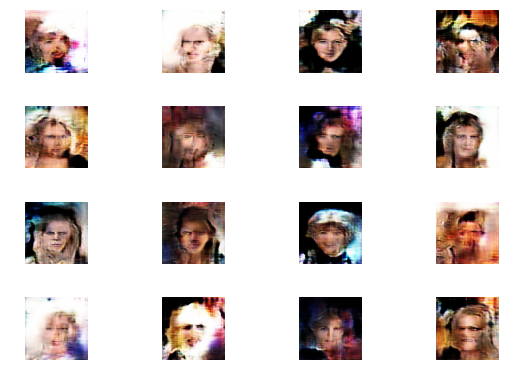

0: [D loss: 1.021244, acc: 0.492188] [A loss: 1.033749, acc: 0.453125]
1: [D loss: 0.940673, acc: 0.539062] [A loss: 1.207779, acc: 0.421875]
2: [D loss: 0.804158, acc: 0.578125] [A loss: 1.055458, acc: 0.484375]
3: [D loss: 0.850328, acc: 0.539062] [A loss: 1.395595, acc: 0.375000]
4: [D loss: 0.862705, acc: 0.593750] [A loss: 1.156746, acc: 0.421875]
5: [D loss: 1.080442, acc: 0.484375] [A loss: 1.381475, acc: 0.421875]
6: [D loss: 1.169644, acc: 0.492188] [A loss: 1.283331, acc: 0.359375]
7: [D loss: 1.011169, acc: 0.507812] [A loss: 0.975407, acc: 0.468750]
8: [D loss: 1.174842, acc: 0.460938] [A loss: 1.258356, acc: 0.375000]
9: [D loss: 0.972589, acc: 0.554688] [A loss: 1.183933, acc: 0.312500]
10: [D loss: 0.983390, acc: 0.546875] [A loss: 1.601401, acc: 0.343750]
11: [D loss: 1.037477, acc: 0.554688] [A loss: 1.131588, acc: 0.484375]
12: [D loss: 0.908060, acc: 0.601562] [A loss: 1.140348, acc: 0.406250]
13: [D loss: 0.913558, acc: 0.578125] [A loss: 1.416539, acc: 0.421875]
14

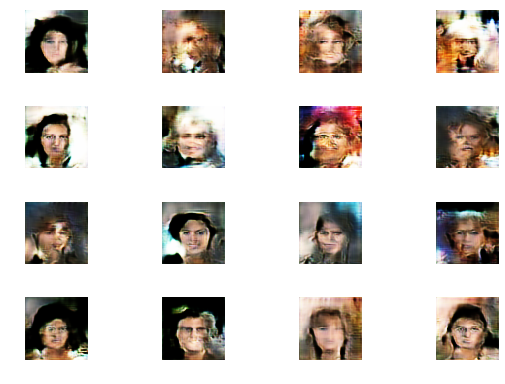

0: [D loss: 0.926966, acc: 0.562500] [A loss: 1.161961, acc: 0.437500]
1: [D loss: 0.899110, acc: 0.562500] [A loss: 1.208563, acc: 0.390625]
2: [D loss: 0.998401, acc: 0.515625] [A loss: 1.117133, acc: 0.453125]
3: [D loss: 1.030924, acc: 0.515625] [A loss: 1.346931, acc: 0.265625]
4: [D loss: 0.982605, acc: 0.593750] [A loss: 1.388733, acc: 0.328125]
5: [D loss: 1.045276, acc: 0.476562] [A loss: 1.151439, acc: 0.437500]
6: [D loss: 0.924954, acc: 0.531250] [A loss: 1.500741, acc: 0.312500]
7: [D loss: 0.894048, acc: 0.539062] [A loss: 1.224082, acc: 0.421875]
8: [D loss: 0.990603, acc: 0.593750] [A loss: 1.445427, acc: 0.390625]
9: [D loss: 1.029078, acc: 0.507812] [A loss: 1.700341, acc: 0.281250]
10: [D loss: 1.119370, acc: 0.500000] [A loss: 1.286416, acc: 0.390625]
11: [D loss: 1.203897, acc: 0.476562] [A loss: 1.235241, acc: 0.453125]
12: [D loss: 0.892342, acc: 0.539062] [A loss: 1.457831, acc: 0.359375]
13: [D loss: 0.845155, acc: 0.664062] [A loss: 1.434745, acc: 0.343750]
14

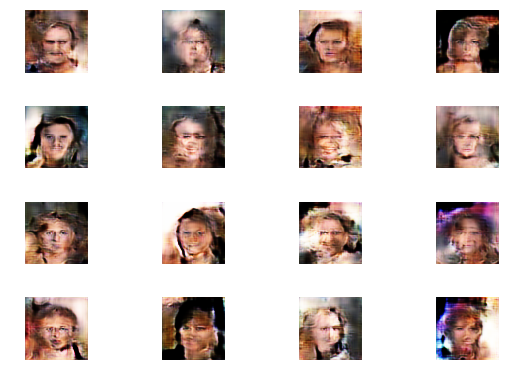

0: [D loss: 0.943277, acc: 0.554688] [A loss: 1.019122, acc: 0.437500]
1: [D loss: 1.003438, acc: 0.539062] [A loss: 1.082685, acc: 0.453125]
2: [D loss: 0.987727, acc: 0.539062] [A loss: 1.055120, acc: 0.453125]
3: [D loss: 0.908348, acc: 0.507812] [A loss: 1.111732, acc: 0.468750]
4: [D loss: 0.956802, acc: 0.531250] [A loss: 1.242162, acc: 0.468750]
5: [D loss: 0.934762, acc: 0.507812] [A loss: 1.238592, acc: 0.421875]
6: [D loss: 1.052117, acc: 0.554688] [A loss: 1.206806, acc: 0.343750]
7: [D loss: 1.013624, acc: 0.523438] [A loss: 1.480169, acc: 0.281250]
8: [D loss: 0.914159, acc: 0.570312] [A loss: 1.244568, acc: 0.437500]
9: [D loss: 0.906771, acc: 0.562500] [A loss: 1.315263, acc: 0.453125]
10: [D loss: 0.822612, acc: 0.562500] [A loss: 1.224693, acc: 0.390625]
11: [D loss: 1.022925, acc: 0.531250] [A loss: 1.160780, acc: 0.406250]
12: [D loss: 0.840102, acc: 0.617188] [A loss: 1.155722, acc: 0.500000]
13: [D loss: 1.046226, acc: 0.507812] [A loss: 1.405236, acc: 0.343750]
14

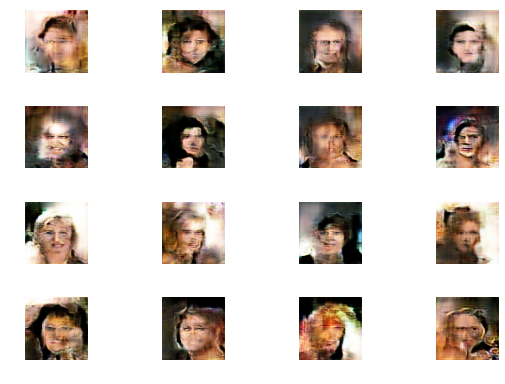

0: [D loss: 1.103394, acc: 0.546875] [A loss: 1.344807, acc: 0.390625]
1: [D loss: 1.106282, acc: 0.468750] [A loss: 1.060793, acc: 0.484375]
2: [D loss: 0.919597, acc: 0.562500] [A loss: 0.929883, acc: 0.515625]
3: [D loss: 0.933155, acc: 0.562500] [A loss: 0.855309, acc: 0.453125]
4: [D loss: 1.106752, acc: 0.421875] [A loss: 1.294267, acc: 0.359375]
5: [D loss: 1.277592, acc: 0.492188] [A loss: 1.376698, acc: 0.406250]
6: [D loss: 1.079494, acc: 0.507812] [A loss: 1.202353, acc: 0.500000]
7: [D loss: 1.040864, acc: 0.578125] [A loss: 1.088510, acc: 0.500000]
8: [D loss: 1.205693, acc: 0.507812] [A loss: 1.375981, acc: 0.359375]
9: [D loss: 1.068421, acc: 0.539062] [A loss: 1.308042, acc: 0.437500]
10: [D loss: 1.189884, acc: 0.421875] [A loss: 1.258921, acc: 0.421875]
11: [D loss: 0.997900, acc: 0.585938] [A loss: 1.152311, acc: 0.484375]
12: [D loss: 1.337453, acc: 0.406250] [A loss: 0.945950, acc: 0.484375]
13: [D loss: 1.209217, acc: 0.484375] [A loss: 1.292500, acc: 0.421875]
14

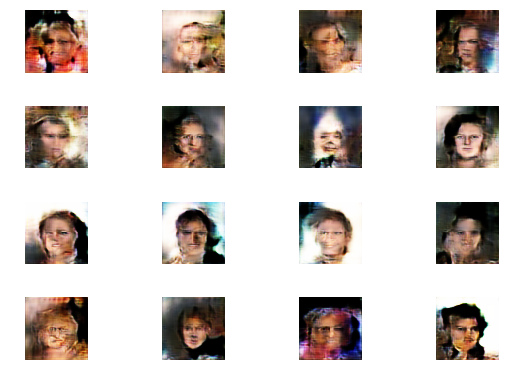

0: [D loss: 1.153843, acc: 0.476562] [A loss: 1.132384, acc: 0.406250]
1: [D loss: 0.973880, acc: 0.554688] [A loss: 1.054964, acc: 0.531250]
2: [D loss: 0.978529, acc: 0.531250] [A loss: 1.167252, acc: 0.390625]
3: [D loss: 0.892885, acc: 0.546875] [A loss: 1.247550, acc: 0.375000]
4: [D loss: 1.004162, acc: 0.500000] [A loss: 1.392504, acc: 0.312500]
5: [D loss: 1.158961, acc: 0.484375] [A loss: 1.320341, acc: 0.328125]
6: [D loss: 0.907881, acc: 0.601562] [A loss: 1.184387, acc: 0.468750]
7: [D loss: 1.004820, acc: 0.531250] [A loss: 1.124022, acc: 0.500000]
8: [D loss: 0.917560, acc: 0.539062] [A loss: 1.041988, acc: 0.500000]
9: [D loss: 1.044478, acc: 0.531250] [A loss: 1.176203, acc: 0.437500]
10: [D loss: 0.853053, acc: 0.593750] [A loss: 1.088737, acc: 0.484375]
11: [D loss: 0.760414, acc: 0.632812] [A loss: 1.115581, acc: 0.390625]
12: [D loss: 0.956610, acc: 0.539062] [A loss: 1.221743, acc: 0.453125]
13: [D loss: 1.148061, acc: 0.500000] [A loss: 1.170198, acc: 0.500000]
14

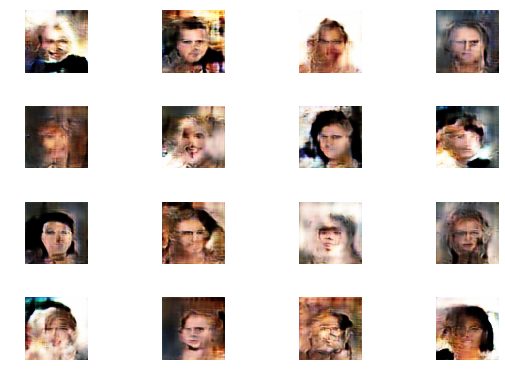

0: [D loss: 0.916923, acc: 0.554688] [A loss: 0.988727, acc: 0.453125]
1: [D loss: 0.918164, acc: 0.562500] [A loss: 1.066909, acc: 0.406250]
2: [D loss: 0.891611, acc: 0.593750] [A loss: 1.293588, acc: 0.421875]
3: [D loss: 0.875417, acc: 0.578125] [A loss: 1.108989, acc: 0.453125]
4: [D loss: 0.988618, acc: 0.546875] [A loss: 1.258916, acc: 0.406250]
5: [D loss: 1.046049, acc: 0.562500] [A loss: 1.417465, acc: 0.312500]
6: [D loss: 0.999487, acc: 0.515625] [A loss: 1.286685, acc: 0.375000]
7: [D loss: 0.894587, acc: 0.570312] [A loss: 1.127038, acc: 0.437500]
8: [D loss: 1.011096, acc: 0.492188] [A loss: 1.385674, acc: 0.312500]
9: [D loss: 0.988510, acc: 0.507812] [A loss: 1.273418, acc: 0.359375]
10: [D loss: 1.052804, acc: 0.468750] [A loss: 1.344353, acc: 0.328125]
11: [D loss: 0.940001, acc: 0.539062] [A loss: 1.282239, acc: 0.421875]
12: [D loss: 1.008697, acc: 0.523438] [A loss: 1.295237, acc: 0.406250]
13: [D loss: 0.998717, acc: 0.546875] [A loss: 1.160808, acc: 0.468750]
14

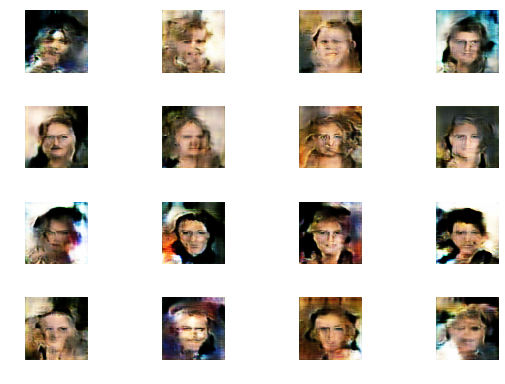

0: [D loss: 1.018100, acc: 0.507812] [A loss: 1.322767, acc: 0.421875]
1: [D loss: 1.059974, acc: 0.523438] [A loss: 1.615605, acc: 0.343750]
2: [D loss: 1.044283, acc: 0.546875] [A loss: 1.192877, acc: 0.359375]
3: [D loss: 0.789435, acc: 0.640625] [A loss: 1.404950, acc: 0.421875]
4: [D loss: 0.922865, acc: 0.632812] [A loss: 1.319079, acc: 0.421875]
5: [D loss: 0.902787, acc: 0.617188] [A loss: 1.318520, acc: 0.390625]
6: [D loss: 0.901928, acc: 0.601562] [A loss: 1.209241, acc: 0.421875]
7: [D loss: 0.694558, acc: 0.648438] [A loss: 1.400559, acc: 0.406250]
8: [D loss: 1.023068, acc: 0.531250] [A loss: 1.516210, acc: 0.343750]
9: [D loss: 0.854565, acc: 0.617188] [A loss: 0.977506, acc: 0.468750]
10: [D loss: 0.951115, acc: 0.578125] [A loss: 1.112387, acc: 0.484375]
11: [D loss: 0.979637, acc: 0.601562] [A loss: 1.266488, acc: 0.375000]
12: [D loss: 1.143352, acc: 0.515625] [A loss: 1.371931, acc: 0.343750]
13: [D loss: 0.902572, acc: 0.601562] [A loss: 1.204326, acc: 0.453125]
14

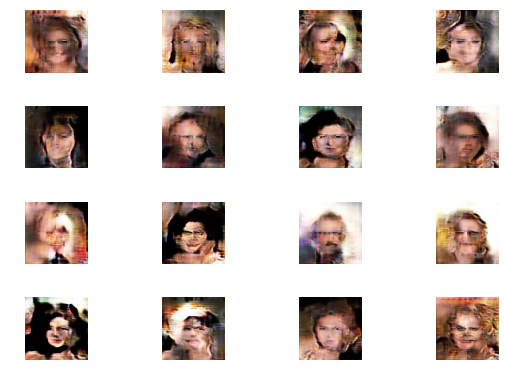

0: [D loss: 1.082771, acc: 0.468750] [A loss: 1.264281, acc: 0.390625]
1: [D loss: 1.122993, acc: 0.476562] [A loss: 1.211820, acc: 0.406250]
2: [D loss: 1.037612, acc: 0.523438] [A loss: 0.993747, acc: 0.484375]
3: [D loss: 0.888347, acc: 0.539062] [A loss: 1.116527, acc: 0.437500]
4: [D loss: 0.986468, acc: 0.500000] [A loss: 1.255104, acc: 0.328125]
5: [D loss: 1.118520, acc: 0.515625] [A loss: 0.954728, acc: 0.484375]
6: [D loss: 0.941560, acc: 0.578125] [A loss: 1.147810, acc: 0.406250]
7: [D loss: 0.991342, acc: 0.562500] [A loss: 1.428532, acc: 0.437500]
8: [D loss: 1.035674, acc: 0.507812] [A loss: 1.091309, acc: 0.468750]
9: [D loss: 0.950755, acc: 0.585938] [A loss: 1.143471, acc: 0.406250]
10: [D loss: 0.885815, acc: 0.609375] [A loss: 1.103663, acc: 0.468750]
11: [D loss: 0.988057, acc: 0.554688] [A loss: 1.034263, acc: 0.500000]
12: [D loss: 0.932638, acc: 0.523438] [A loss: 0.961450, acc: 0.500000]
13: [D loss: 0.934865, acc: 0.562500] [A loss: 1.036347, acc: 0.484375]
14

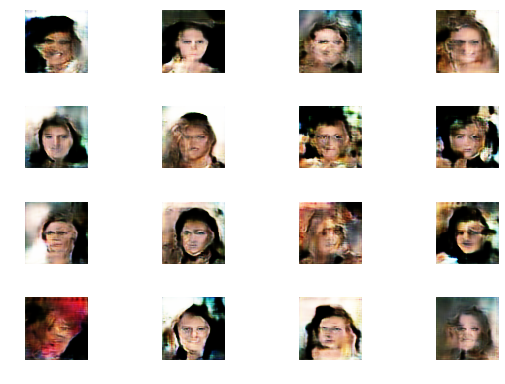

0: [D loss: 0.880181, acc: 0.546875] [A loss: 1.211267, acc: 0.453125]
1: [D loss: 1.057869, acc: 0.484375] [A loss: 1.047493, acc: 0.468750]
2: [D loss: 1.050486, acc: 0.523438] [A loss: 1.309466, acc: 0.390625]
3: [D loss: 0.925209, acc: 0.546875] [A loss: 1.106769, acc: 0.531250]
4: [D loss: 0.928306, acc: 0.585938] [A loss: 1.357019, acc: 0.453125]
5: [D loss: 1.101158, acc: 0.476562] [A loss: 1.154948, acc: 0.515625]
6: [D loss: 1.167895, acc: 0.453125] [A loss: 1.368694, acc: 0.406250]
7: [D loss: 1.229601, acc: 0.507812] [A loss: 1.373738, acc: 0.390625]
8: [D loss: 1.212889, acc: 0.421875] [A loss: 1.175139, acc: 0.406250]
9: [D loss: 1.077492, acc: 0.507812] [A loss: 1.113686, acc: 0.453125]
10: [D loss: 1.185887, acc: 0.484375] [A loss: 1.431496, acc: 0.390625]
11: [D loss: 1.216649, acc: 0.414062] [A loss: 0.916751, acc: 0.531250]
12: [D loss: 1.055430, acc: 0.500000] [A loss: 1.265736, acc: 0.328125]
13: [D loss: 1.381581, acc: 0.421875] [A loss: 1.045882, acc: 0.421875]
14

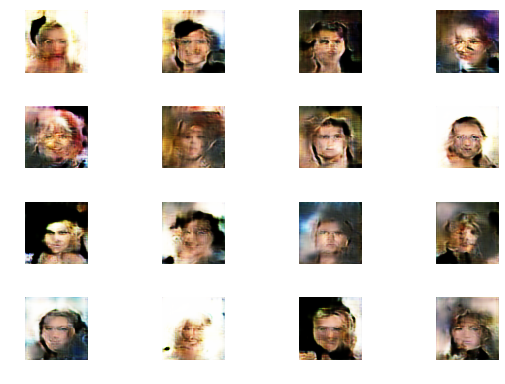

0: [D loss: 0.896402, acc: 0.593750] [A loss: 1.379004, acc: 0.328125]
1: [D loss: 0.852410, acc: 0.562500] [A loss: 1.471346, acc: 0.359375]
2: [D loss: 0.988624, acc: 0.523438] [A loss: 1.189082, acc: 0.390625]
3: [D loss: 0.897760, acc: 0.570312] [A loss: 1.450330, acc: 0.343750]
4: [D loss: 0.979180, acc: 0.507812] [A loss: 1.101442, acc: 0.421875]
5: [D loss: 1.046494, acc: 0.546875] [A loss: 1.406629, acc: 0.312500]
6: [D loss: 1.048530, acc: 0.515625] [A loss: 1.212878, acc: 0.484375]
7: [D loss: 0.802109, acc: 0.648438] [A loss: 1.311243, acc: 0.406250]
8: [D loss: 0.954789, acc: 0.570312] [A loss: 1.324897, acc: 0.406250]
9: [D loss: 1.036925, acc: 0.523438] [A loss: 1.103077, acc: 0.453125]
10: [D loss: 1.203251, acc: 0.468750] [A loss: 1.396310, acc: 0.468750]
11: [D loss: 1.077728, acc: 0.546875] [A loss: 1.350638, acc: 0.359375]
12: [D loss: 1.194055, acc: 0.507812] [A loss: 1.278145, acc: 0.421875]
13: [D loss: 0.996879, acc: 0.617188] [A loss: 1.255949, acc: 0.343750]
14

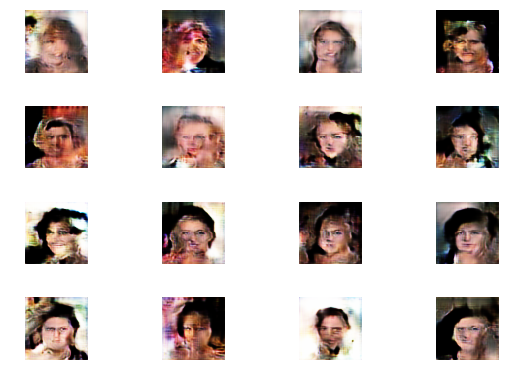

0: [D loss: 0.962591, acc: 0.523438] [A loss: 0.868946, acc: 0.640625]
1: [D loss: 0.871565, acc: 0.578125] [A loss: 1.342638, acc: 0.359375]
2: [D loss: 1.101592, acc: 0.468750] [A loss: 1.224064, acc: 0.453125]
3: [D loss: 0.846812, acc: 0.593750] [A loss: 1.525968, acc: 0.421875]
4: [D loss: 1.029211, acc: 0.539062] [A loss: 1.451132, acc: 0.359375]
5: [D loss: 0.855052, acc: 0.593750] [A loss: 1.089205, acc: 0.406250]
6: [D loss: 0.931987, acc: 0.484375] [A loss: 1.213073, acc: 0.484375]
7: [D loss: 0.912954, acc: 0.539062] [A loss: 1.327002, acc: 0.375000]
8: [D loss: 0.973717, acc: 0.570312] [A loss: 1.231334, acc: 0.437500]
9: [D loss: 0.900476, acc: 0.562500] [A loss: 1.297184, acc: 0.437500]
10: [D loss: 0.805206, acc: 0.578125] [A loss: 1.335732, acc: 0.484375]
11: [D loss: 0.952126, acc: 0.539062] [A loss: 1.284108, acc: 0.359375]
12: [D loss: 0.839531, acc: 0.570312] [A loss: 1.338071, acc: 0.390625]
13: [D loss: 0.925718, acc: 0.585938] [A loss: 1.398699, acc: 0.281250]
14

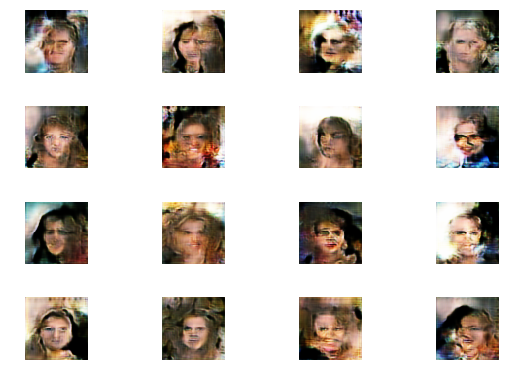

0: [D loss: 1.216492, acc: 0.476562] [A loss: 0.952220, acc: 0.484375]
1: [D loss: 0.886745, acc: 0.625000] [A loss: 1.121978, acc: 0.500000]
2: [D loss: 1.061518, acc: 0.523438] [A loss: 1.392622, acc: 0.343750]
3: [D loss: 0.992729, acc: 0.484375] [A loss: 1.075031, acc: 0.515625]
4: [D loss: 0.991329, acc: 0.531250] [A loss: 1.466157, acc: 0.328125]
5: [D loss: 0.998690, acc: 0.570312] [A loss: 1.440164, acc: 0.343750]
6: [D loss: 1.200982, acc: 0.460938] [A loss: 1.299366, acc: 0.375000]
7: [D loss: 0.959804, acc: 0.539062] [A loss: 0.882121, acc: 0.562500]
8: [D loss: 1.070312, acc: 0.421875] [A loss: 1.343586, acc: 0.453125]
9: [D loss: 0.996888, acc: 0.515625] [A loss: 1.226921, acc: 0.484375]
10: [D loss: 1.156114, acc: 0.453125] [A loss: 1.015404, acc: 0.484375]
11: [D loss: 1.093749, acc: 0.539062] [A loss: 1.325264, acc: 0.312500]
12: [D loss: 1.017437, acc: 0.578125] [A loss: 1.155037, acc: 0.390625]
13: [D loss: 0.951994, acc: 0.531250] [A loss: 1.247331, acc: 0.359375]
14

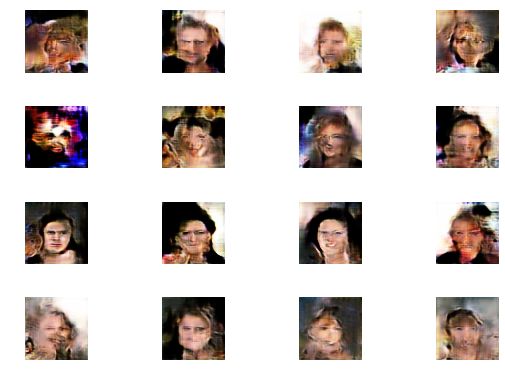

0: [D loss: 1.054240, acc: 0.492188] [A loss: 1.075475, acc: 0.421875]
1: [D loss: 1.047134, acc: 0.523438] [A loss: 1.302096, acc: 0.421875]
2: [D loss: 1.006956, acc: 0.578125] [A loss: 1.064870, acc: 0.546875]
3: [D loss: 1.049008, acc: 0.523438] [A loss: 1.176170, acc: 0.484375]
4: [D loss: 0.981848, acc: 0.546875] [A loss: 1.165581, acc: 0.437500]
5: [D loss: 1.212780, acc: 0.453125] [A loss: 1.320839, acc: 0.390625]
6: [D loss: 1.269668, acc: 0.429688] [A loss: 1.260015, acc: 0.421875]
7: [D loss: 1.039915, acc: 0.515625] [A loss: 1.230165, acc: 0.390625]
8: [D loss: 1.042984, acc: 0.523438] [A loss: 1.269862, acc: 0.515625]
9: [D loss: 0.998767, acc: 0.539062] [A loss: 1.222723, acc: 0.453125]
10: [D loss: 1.081385, acc: 0.531250] [A loss: 1.258402, acc: 0.468750]
11: [D loss: 1.115839, acc: 0.468750] [A loss: 0.900895, acc: 0.578125]
12: [D loss: 0.936221, acc: 0.539062] [A loss: 1.112634, acc: 0.515625]
13: [D loss: 1.178206, acc: 0.390625] [A loss: 1.191132, acc: 0.437500]
14

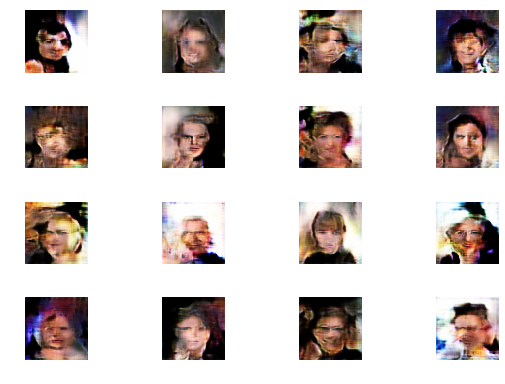

0: [D loss: 1.081801, acc: 0.500000] [A loss: 1.205960, acc: 0.453125]
1: [D loss: 0.879424, acc: 0.578125] [A loss: 1.441911, acc: 0.437500]
2: [D loss: 1.005197, acc: 0.554688] [A loss: 1.378617, acc: 0.390625]
3: [D loss: 0.942448, acc: 0.546875] [A loss: 1.571475, acc: 0.281250]
4: [D loss: 1.056308, acc: 0.492188] [A loss: 1.219321, acc: 0.406250]
5: [D loss: 0.953501, acc: 0.570312] [A loss: 1.062314, acc: 0.484375]
6: [D loss: 0.965903, acc: 0.554688] [A loss: 1.373301, acc: 0.437500]
7: [D loss: 1.090189, acc: 0.507812] [A loss: 1.115924, acc: 0.515625]
8: [D loss: 1.003816, acc: 0.523438] [A loss: 1.141745, acc: 0.437500]
9: [D loss: 1.047763, acc: 0.531250] [A loss: 1.055179, acc: 0.515625]
10: [D loss: 0.944427, acc: 0.578125] [A loss: 0.961006, acc: 0.515625]
11: [D loss: 0.926827, acc: 0.531250] [A loss: 1.299187, acc: 0.437500]
12: [D loss: 0.936397, acc: 0.578125] [A loss: 1.164029, acc: 0.406250]
13: [D loss: 0.886941, acc: 0.546875] [A loss: 1.260019, acc: 0.359375]
14

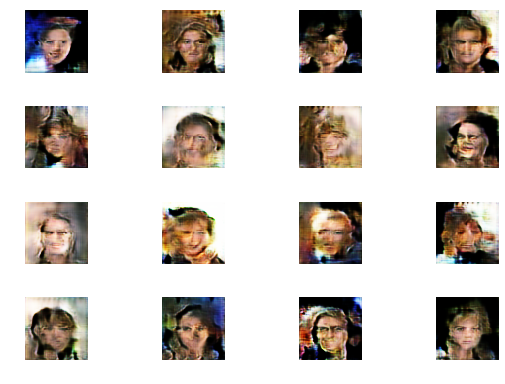

0: [D loss: 1.149774, acc: 0.500000] [A loss: 1.115519, acc: 0.421875]
1: [D loss: 1.075505, acc: 0.515625] [A loss: 1.209927, acc: 0.437500]
2: [D loss: 0.943913, acc: 0.570312] [A loss: 1.118990, acc: 0.421875]
3: [D loss: 0.865567, acc: 0.640625] [A loss: 1.020059, acc: 0.453125]
4: [D loss: 1.004160, acc: 0.539062] [A loss: 1.306612, acc: 0.421875]
5: [D loss: 0.939576, acc: 0.546875] [A loss: 1.462984, acc: 0.328125]
6: [D loss: 1.149575, acc: 0.492188] [A loss: 1.249241, acc: 0.390625]
7: [D loss: 0.813616, acc: 0.671875] [A loss: 1.349796, acc: 0.359375]
8: [D loss: 1.046553, acc: 0.539062] [A loss: 1.468787, acc: 0.359375]
9: [D loss: 0.991439, acc: 0.515625] [A loss: 1.421419, acc: 0.375000]
10: [D loss: 1.095999, acc: 0.453125] [A loss: 1.009515, acc: 0.500000]
11: [D loss: 0.988997, acc: 0.562500] [A loss: 1.100720, acc: 0.531250]
12: [D loss: 0.982149, acc: 0.523438] [A loss: 0.953380, acc: 0.437500]
13: [D loss: 0.910512, acc: 0.554688] [A loss: 1.045096, acc: 0.515625]
14

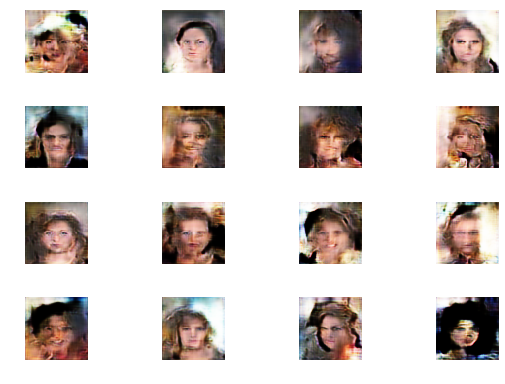

0: [D loss: 1.052459, acc: 0.515625] [A loss: 0.899004, acc: 0.531250]
1: [D loss: 0.987446, acc: 0.570312] [A loss: 1.440705, acc: 0.515625]
2: [D loss: 1.014055, acc: 0.539062] [A loss: 0.978678, acc: 0.531250]
3: [D loss: 0.918054, acc: 0.515625] [A loss: 1.174049, acc: 0.468750]
4: [D loss: 1.108795, acc: 0.468750] [A loss: 0.951225, acc: 0.468750]
5: [D loss: 0.959411, acc: 0.562500] [A loss: 1.163156, acc: 0.468750]
6: [D loss: 1.029161, acc: 0.531250] [A loss: 1.187129, acc: 0.453125]
7: [D loss: 1.016390, acc: 0.515625] [A loss: 0.962141, acc: 0.437500]
8: [D loss: 0.820879, acc: 0.601562] [A loss: 0.996085, acc: 0.500000]
9: [D loss: 0.962009, acc: 0.507812] [A loss: 1.027051, acc: 0.500000]
10: [D loss: 0.927857, acc: 0.546875] [A loss: 1.204653, acc: 0.359375]
11: [D loss: 1.074098, acc: 0.507812] [A loss: 1.326855, acc: 0.390625]
12: [D loss: 0.877078, acc: 0.601562] [A loss: 1.232879, acc: 0.421875]
13: [D loss: 0.935938, acc: 0.562500] [A loss: 1.063539, acc: 0.515625]
14

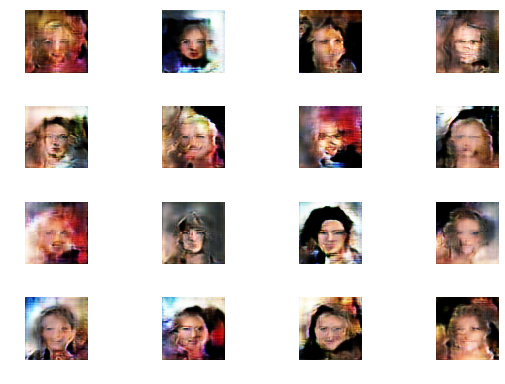

0: [D loss: 0.982793, acc: 0.539062] [A loss: 1.394562, acc: 0.343750]
1: [D loss: 0.906621, acc: 0.539062] [A loss: 1.567946, acc: 0.328125]
2: [D loss: 0.908820, acc: 0.578125] [A loss: 1.404308, acc: 0.343750]
3: [D loss: 1.020725, acc: 0.500000] [A loss: 1.128484, acc: 0.421875]
4: [D loss: 0.968978, acc: 0.531250] [A loss: 1.349579, acc: 0.437500]
5: [D loss: 0.980996, acc: 0.515625] [A loss: 0.968867, acc: 0.593750]
6: [D loss: 0.994116, acc: 0.578125] [A loss: 1.152943, acc: 0.515625]
7: [D loss: 0.960056, acc: 0.507812] [A loss: 1.164209, acc: 0.468750]
8: [D loss: 1.055792, acc: 0.546875] [A loss: 1.379510, acc: 0.406250]
9: [D loss: 0.969478, acc: 0.578125] [A loss: 1.288422, acc: 0.375000]
10: [D loss: 0.892056, acc: 0.539062] [A loss: 1.262439, acc: 0.359375]
11: [D loss: 0.977694, acc: 0.523438] [A loss: 1.234568, acc: 0.343750]
12: [D loss: 1.018781, acc: 0.554688] [A loss: 1.135333, acc: 0.468750]
13: [D loss: 0.883663, acc: 0.554688] [A loss: 1.194902, acc: 0.406250]
14

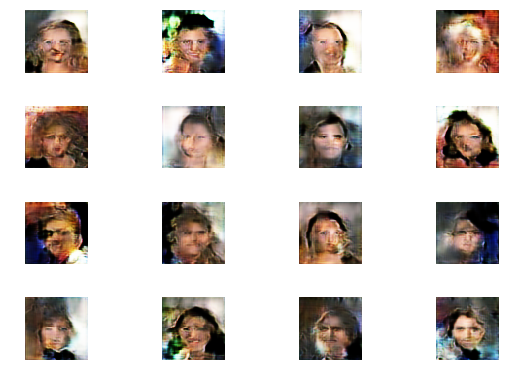

0: [D loss: 0.985067, acc: 0.523438] [A loss: 1.147264, acc: 0.468750]
1: [D loss: 0.937014, acc: 0.578125] [A loss: 1.387453, acc: 0.328125]
2: [D loss: 0.931714, acc: 0.539062] [A loss: 1.114946, acc: 0.453125]
3: [D loss: 0.979002, acc: 0.546875] [A loss: 1.075838, acc: 0.484375]
4: [D loss: 1.029057, acc: 0.492188] [A loss: 1.223393, acc: 0.390625]
5: [D loss: 0.866008, acc: 0.562500] [A loss: 1.244228, acc: 0.437500]
6: [D loss: 0.935398, acc: 0.578125] [A loss: 1.441442, acc: 0.359375]
7: [D loss: 0.822231, acc: 0.601562] [A loss: 1.233368, acc: 0.453125]
8: [D loss: 0.998622, acc: 0.601562] [A loss: 1.484081, acc: 0.312500]
9: [D loss: 0.995093, acc: 0.546875] [A loss: 1.314704, acc: 0.359375]
10: [D loss: 0.873583, acc: 0.570312] [A loss: 1.034206, acc: 0.421875]
11: [D loss: 1.012602, acc: 0.617188] [A loss: 1.209304, acc: 0.390625]
12: [D loss: 0.902056, acc: 0.640625] [A loss: 1.128931, acc: 0.515625]
13: [D loss: 0.970882, acc: 0.570312] [A loss: 1.167602, acc: 0.406250]
14

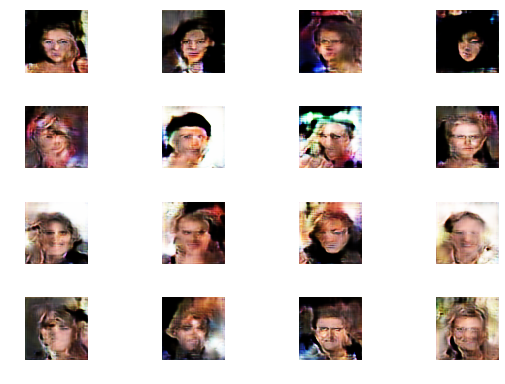

0: [D loss: 1.029237, acc: 0.500000] [A loss: 1.137973, acc: 0.437500]
1: [D loss: 1.080335, acc: 0.539062] [A loss: 1.109517, acc: 0.390625]
2: [D loss: 1.066411, acc: 0.578125] [A loss: 1.357517, acc: 0.453125]
3: [D loss: 1.034799, acc: 0.484375] [A loss: 1.129190, acc: 0.437500]
4: [D loss: 0.984763, acc: 0.531250] [A loss: 1.168588, acc: 0.375000]
5: [D loss: 1.102592, acc: 0.523438] [A loss: 1.210973, acc: 0.500000]
6: [D loss: 0.783339, acc: 0.648438] [A loss: 1.383733, acc: 0.390625]
7: [D loss: 0.944641, acc: 0.625000] [A loss: 1.120055, acc: 0.406250]
8: [D loss: 1.071478, acc: 0.476562] [A loss: 0.969201, acc: 0.515625]
9: [D loss: 0.726270, acc: 0.625000] [A loss: 1.172122, acc: 0.500000]
10: [D loss: 1.038511, acc: 0.484375] [A loss: 1.605155, acc: 0.296875]
11: [D loss: 0.686548, acc: 0.687500] [A loss: 1.296678, acc: 0.390625]
12: [D loss: 1.047951, acc: 0.523438] [A loss: 1.100352, acc: 0.453125]
13: [D loss: 0.907835, acc: 0.593750] [A loss: 1.348405, acc: 0.359375]
14

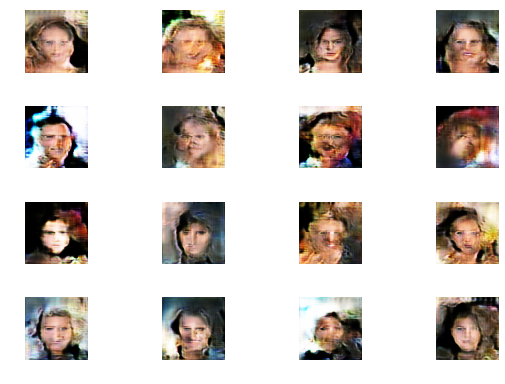

0: [D loss: 1.078629, acc: 0.507812] [A loss: 1.137260, acc: 0.468750]
1: [D loss: 1.053513, acc: 0.523438] [A loss: 1.181973, acc: 0.375000]
2: [D loss: 1.032261, acc: 0.578125] [A loss: 1.185879, acc: 0.515625]
3: [D loss: 1.079765, acc: 0.539062] [A loss: 1.240741, acc: 0.359375]
4: [D loss: 0.988275, acc: 0.539062] [A loss: 1.284552, acc: 0.453125]
5: [D loss: 1.125320, acc: 0.445312] [A loss: 0.931754, acc: 0.578125]
6: [D loss: 0.969413, acc: 0.562500] [A loss: 1.175551, acc: 0.453125]
7: [D loss: 0.935479, acc: 0.523438] [A loss: 1.127882, acc: 0.484375]
8: [D loss: 0.862415, acc: 0.601562] [A loss: 1.313086, acc: 0.406250]
9: [D loss: 1.035720, acc: 0.500000] [A loss: 1.124464, acc: 0.515625]
10: [D loss: 1.204160, acc: 0.453125] [A loss: 1.257696, acc: 0.468750]
11: [D loss: 0.983335, acc: 0.515625] [A loss: 1.226747, acc: 0.406250]
12: [D loss: 0.819274, acc: 0.593750] [A loss: 1.086098, acc: 0.453125]
13: [D loss: 1.178396, acc: 0.468750] [A loss: 1.578861, acc: 0.328125]
14

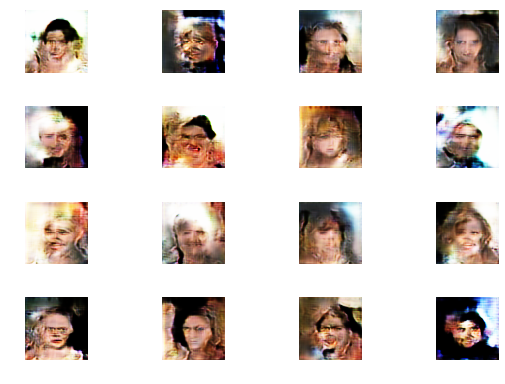

0: [D loss: 1.055700, acc: 0.539062] [A loss: 1.004238, acc: 0.531250]
1: [D loss: 1.189372, acc: 0.437500] [A loss: 1.119617, acc: 0.500000]
2: [D loss: 0.991794, acc: 0.523438] [A loss: 1.251503, acc: 0.421875]
3: [D loss: 1.168554, acc: 0.484375] [A loss: 1.167259, acc: 0.437500]
4: [D loss: 0.851683, acc: 0.585938] [A loss: 1.099431, acc: 0.453125]
5: [D loss: 1.170700, acc: 0.515625] [A loss: 1.261000, acc: 0.375000]
6: [D loss: 1.104624, acc: 0.492188] [A loss: 1.128110, acc: 0.500000]
7: [D loss: 1.041599, acc: 0.500000] [A loss: 1.116060, acc: 0.390625]
8: [D loss: 1.025850, acc: 0.507812] [A loss: 1.195670, acc: 0.421875]
9: [D loss: 1.205190, acc: 0.468750] [A loss: 1.230237, acc: 0.390625]
10: [D loss: 0.996899, acc: 0.554688] [A loss: 1.126929, acc: 0.468750]
11: [D loss: 1.102028, acc: 0.500000] [A loss: 1.172314, acc: 0.437500]
12: [D loss: 0.959971, acc: 0.539062] [A loss: 1.531309, acc: 0.343750]
13: [D loss: 1.160138, acc: 0.453125] [A loss: 1.006137, acc: 0.484375]
14

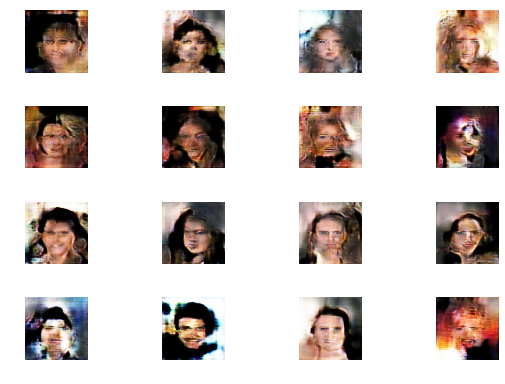

0: [D loss: 0.957601, acc: 0.578125] [A loss: 1.386704, acc: 0.359375]
1: [D loss: 0.975085, acc: 0.539062] [A loss: 1.290174, acc: 0.375000]
2: [D loss: 1.109793, acc: 0.507812] [A loss: 1.228368, acc: 0.468750]
3: [D loss: 1.103849, acc: 0.492188] [A loss: 1.101646, acc: 0.500000]
4: [D loss: 1.066980, acc: 0.492188] [A loss: 1.509853, acc: 0.359375]
5: [D loss: 1.012694, acc: 0.515625] [A loss: 1.259033, acc: 0.375000]
6: [D loss: 1.077862, acc: 0.523438] [A loss: 1.501686, acc: 0.375000]
7: [D loss: 1.170450, acc: 0.531250] [A loss: 1.176659, acc: 0.546875]
8: [D loss: 0.927680, acc: 0.570312] [A loss: 1.073904, acc: 0.437500]
9: [D loss: 0.991396, acc: 0.546875] [A loss: 0.936914, acc: 0.546875]
10: [D loss: 0.999599, acc: 0.515625] [A loss: 1.000795, acc: 0.468750]
11: [D loss: 1.038406, acc: 0.484375] [A loss: 1.006327, acc: 0.562500]
12: [D loss: 0.958500, acc: 0.539062] [A loss: 1.228930, acc: 0.437500]
13: [D loss: 0.995920, acc: 0.515625] [A loss: 1.161194, acc: 0.468750]
14

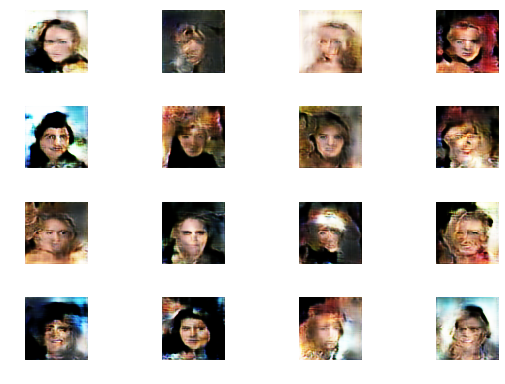

0: [D loss: 1.090573, acc: 0.515625] [A loss: 1.072816, acc: 0.453125]
1: [D loss: 0.931752, acc: 0.562500] [A loss: 0.994126, acc: 0.500000]
2: [D loss: 1.052909, acc: 0.523438] [A loss: 1.209329, acc: 0.500000]
3: [D loss: 0.936486, acc: 0.484375] [A loss: 1.089027, acc: 0.546875]
4: [D loss: 1.077414, acc: 0.515625] [A loss: 0.785077, acc: 0.656250]
5: [D loss: 0.940808, acc: 0.554688] [A loss: 1.100119, acc: 0.406250]
6: [D loss: 0.941929, acc: 0.546875] [A loss: 1.193001, acc: 0.406250]
7: [D loss: 0.963224, acc: 0.507812] [A loss: 1.250749, acc: 0.406250]
8: [D loss: 0.944662, acc: 0.578125] [A loss: 1.307914, acc: 0.406250]
9: [D loss: 0.972032, acc: 0.531250] [A loss: 1.039724, acc: 0.562500]
10: [D loss: 0.961402, acc: 0.515625] [A loss: 1.261326, acc: 0.421875]
11: [D loss: 1.139701, acc: 0.476562] [A loss: 1.113705, acc: 0.484375]
12: [D loss: 1.187549, acc: 0.429688] [A loss: 1.156469, acc: 0.484375]
13: [D loss: 1.052217, acc: 0.578125] [A loss: 1.053221, acc: 0.484375]
14

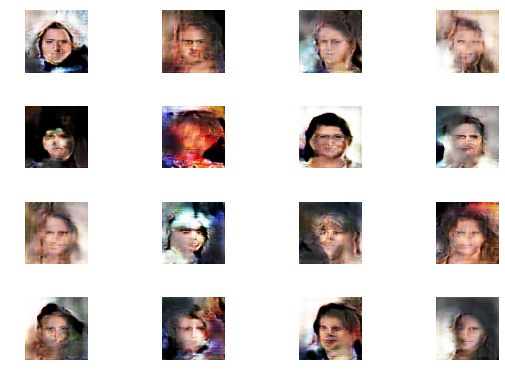

0: [D loss: 1.140004, acc: 0.453125] [A loss: 1.375488, acc: 0.343750]
1: [D loss: 1.005157, acc: 0.492188] [A loss: 0.929486, acc: 0.546875]
2: [D loss: 0.812694, acc: 0.632812] [A loss: 0.939053, acc: 0.515625]
3: [D loss: 1.053885, acc: 0.484375] [A loss: 1.128702, acc: 0.343750]
4: [D loss: 0.948501, acc: 0.539062] [A loss: 1.199815, acc: 0.437500]
5: [D loss: 0.983822, acc: 0.523438] [A loss: 1.140072, acc: 0.437500]
6: [D loss: 0.946962, acc: 0.593750] [A loss: 1.158562, acc: 0.453125]
7: [D loss: 0.823629, acc: 0.585938] [A loss: 1.321533, acc: 0.421875]
8: [D loss: 0.904052, acc: 0.546875] [A loss: 1.088198, acc: 0.500000]
9: [D loss: 1.068961, acc: 0.500000] [A loss: 1.083030, acc: 0.500000]
10: [D loss: 0.922117, acc: 0.593750] [A loss: 1.154911, acc: 0.468750]
11: [D loss: 0.973327, acc: 0.507812] [A loss: 1.032337, acc: 0.484375]
12: [D loss: 0.846777, acc: 0.554688] [A loss: 1.051774, acc: 0.468750]
13: [D loss: 1.050652, acc: 0.546875] [A loss: 1.217327, acc: 0.359375]
14

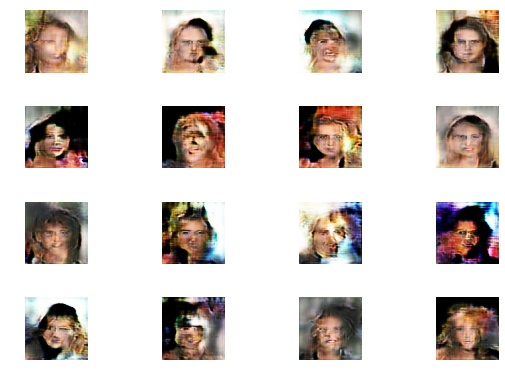

0: [D loss: 1.063019, acc: 0.531250] [A loss: 1.208867, acc: 0.453125]
1: [D loss: 1.110556, acc: 0.476562] [A loss: 1.291440, acc: 0.484375]
2: [D loss: 1.033459, acc: 0.539062] [A loss: 1.142933, acc: 0.437500]
3: [D loss: 1.060921, acc: 0.554688] [A loss: 1.118138, acc: 0.406250]
4: [D loss: 1.088387, acc: 0.507812] [A loss: 1.047550, acc: 0.421875]
5: [D loss: 0.929323, acc: 0.539062] [A loss: 1.092911, acc: 0.453125]
6: [D loss: 1.064357, acc: 0.546875] [A loss: 1.071555, acc: 0.437500]
7: [D loss: 1.067301, acc: 0.554688] [A loss: 1.043316, acc: 0.515625]
8: [D loss: 0.960421, acc: 0.578125] [A loss: 1.104956, acc: 0.421875]
9: [D loss: 0.987242, acc: 0.531250] [A loss: 0.995964, acc: 0.484375]
10: [D loss: 1.142514, acc: 0.437500] [A loss: 1.255842, acc: 0.484375]
11: [D loss: 0.932062, acc: 0.515625] [A loss: 0.908377, acc: 0.484375]
12: [D loss: 0.830192, acc: 0.585938] [A loss: 1.009822, acc: 0.453125]
13: [D loss: 0.905338, acc: 0.609375] [A loss: 1.108924, acc: 0.484375]
14

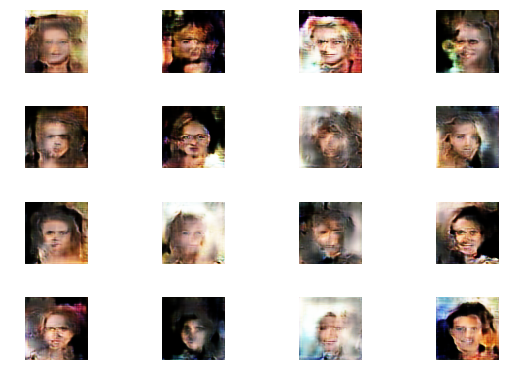

0: [D loss: 0.975820, acc: 0.507812] [A loss: 0.883507, acc: 0.531250]
1: [D loss: 0.944913, acc: 0.562500] [A loss: 0.997380, acc: 0.500000]
2: [D loss: 1.131070, acc: 0.476562] [A loss: 1.060488, acc: 0.421875]
3: [D loss: 1.099532, acc: 0.570312] [A loss: 1.205231, acc: 0.375000]
4: [D loss: 0.945004, acc: 0.562500] [A loss: 1.282815, acc: 0.406250]
5: [D loss: 1.087777, acc: 0.445312] [A loss: 1.059518, acc: 0.484375]
6: [D loss: 1.160143, acc: 0.476562] [A loss: 1.273790, acc: 0.390625]
7: [D loss: 1.126566, acc: 0.406250] [A loss: 1.089839, acc: 0.484375]
8: [D loss: 1.079335, acc: 0.539062] [A loss: 1.187974, acc: 0.406250]
9: [D loss: 0.964688, acc: 0.554688] [A loss: 1.146878, acc: 0.484375]
10: [D loss: 0.936926, acc: 0.601562] [A loss: 1.225723, acc: 0.437500]
11: [D loss: 1.176047, acc: 0.453125] [A loss: 1.324681, acc: 0.312500]
12: [D loss: 0.855601, acc: 0.578125] [A loss: 1.248628, acc: 0.390625]
13: [D loss: 1.161361, acc: 0.500000] [A loss: 1.192278, acc: 0.406250]
14

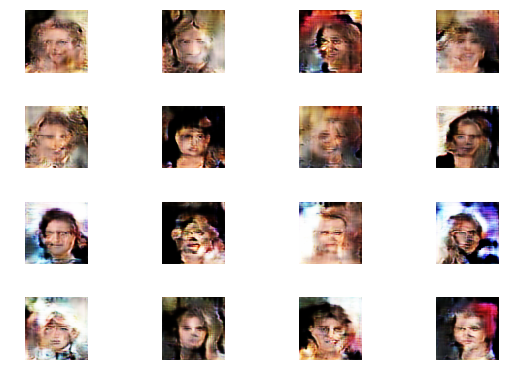

0: [D loss: 0.826886, acc: 0.601562] [A loss: 1.233979, acc: 0.406250]
1: [D loss: 0.907637, acc: 0.570312] [A loss: 1.073128, acc: 0.453125]
2: [D loss: 0.886604, acc: 0.515625] [A loss: 1.128400, acc: 0.421875]
3: [D loss: 1.049423, acc: 0.507812] [A loss: 1.294453, acc: 0.437500]
4: [D loss: 1.013106, acc: 0.546875] [A loss: 1.060088, acc: 0.468750]
5: [D loss: 0.979323, acc: 0.523438] [A loss: 1.184712, acc: 0.484375]
6: [D loss: 1.095341, acc: 0.507812] [A loss: 1.161697, acc: 0.406250]
7: [D loss: 0.891277, acc: 0.562500] [A loss: 1.226496, acc: 0.421875]
8: [D loss: 0.900794, acc: 0.578125] [A loss: 1.050119, acc: 0.531250]
9: [D loss: 0.863832, acc: 0.601562] [A loss: 1.378659, acc: 0.343750]
10: [D loss: 1.030677, acc: 0.500000] [A loss: 1.159843, acc: 0.484375]
11: [D loss: 1.021221, acc: 0.500000] [A loss: 1.473392, acc: 0.359375]
12: [D loss: 1.003286, acc: 0.554688] [A loss: 1.145755, acc: 0.437500]
13: [D loss: 0.889548, acc: 0.546875] [A loss: 1.105388, acc: 0.453125]
14

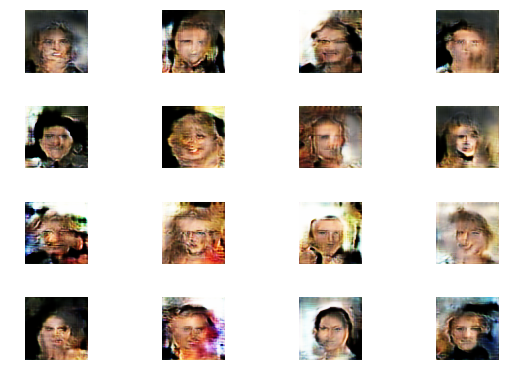

0: [D loss: 0.926802, acc: 0.500000] [A loss: 1.089158, acc: 0.484375]
1: [D loss: 1.079336, acc: 0.523438] [A loss: 1.274474, acc: 0.406250]
2: [D loss: 1.178046, acc: 0.476562] [A loss: 1.263768, acc: 0.406250]
3: [D loss: 1.000212, acc: 0.531250] [A loss: 1.037678, acc: 0.515625]
4: [D loss: 1.144786, acc: 0.523438] [A loss: 1.314924, acc: 0.468750]
5: [D loss: 0.960907, acc: 0.539062] [A loss: 0.951979, acc: 0.546875]
6: [D loss: 0.859041, acc: 0.570312] [A loss: 1.530267, acc: 0.390625]
7: [D loss: 0.897132, acc: 0.570312] [A loss: 1.223691, acc: 0.453125]
8: [D loss: 1.103637, acc: 0.484375] [A loss: 1.186732, acc: 0.453125]
9: [D loss: 0.987804, acc: 0.546875] [A loss: 1.300382, acc: 0.437500]
10: [D loss: 0.894219, acc: 0.609375] [A loss: 1.098003, acc: 0.437500]
11: [D loss: 0.977476, acc: 0.507812] [A loss: 1.054714, acc: 0.515625]
12: [D loss: 1.011599, acc: 0.546875] [A loss: 1.235305, acc: 0.437500]
13: [D loss: 1.100916, acc: 0.429688] [A loss: 1.245160, acc: 0.453125]
14

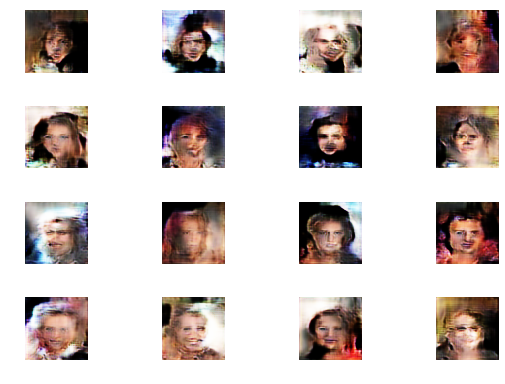

0: [D loss: 0.959904, acc: 0.562500] [A loss: 1.063927, acc: 0.421875]
1: [D loss: 1.046655, acc: 0.539062] [A loss: 0.997091, acc: 0.421875]
2: [D loss: 1.149781, acc: 0.460938] [A loss: 1.057160, acc: 0.515625]
3: [D loss: 0.997697, acc: 0.531250] [A loss: 0.971246, acc: 0.484375]
4: [D loss: 1.078464, acc: 0.515625] [A loss: 0.876340, acc: 0.531250]
5: [D loss: 0.975865, acc: 0.460938] [A loss: 1.453799, acc: 0.375000]
6: [D loss: 0.974078, acc: 0.468750] [A loss: 1.154216, acc: 0.421875]
7: [D loss: 0.987153, acc: 0.585938] [A loss: 1.444290, acc: 0.343750]
8: [D loss: 0.970721, acc: 0.546875] [A loss: 1.103333, acc: 0.406250]
9: [D loss: 1.071244, acc: 0.523438] [A loss: 1.307773, acc: 0.437500]
10: [D loss: 1.043651, acc: 0.500000] [A loss: 1.103177, acc: 0.453125]
11: [D loss: 1.022985, acc: 0.453125] [A loss: 1.255854, acc: 0.406250]
12: [D loss: 0.946511, acc: 0.539062] [A loss: 0.972225, acc: 0.515625]
13: [D loss: 0.977704, acc: 0.546875] [A loss: 1.497533, acc: 0.328125]
14

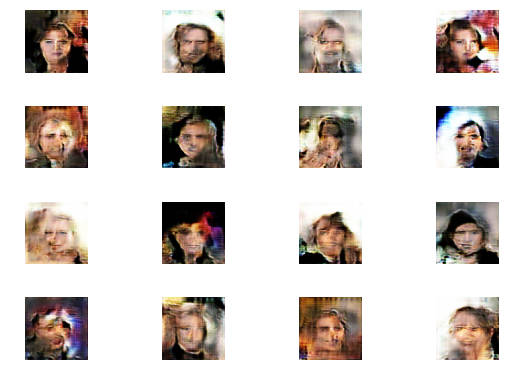

0: [D loss: 1.009451, acc: 0.601562] [A loss: 1.127415, acc: 0.406250]
1: [D loss: 1.063907, acc: 0.523438] [A loss: 1.162252, acc: 0.437500]
2: [D loss: 1.144124, acc: 0.414062] [A loss: 1.193020, acc: 0.437500]
3: [D loss: 1.310593, acc: 0.476562] [A loss: 1.145036, acc: 0.406250]
4: [D loss: 1.054697, acc: 0.492188] [A loss: 1.148856, acc: 0.421875]
5: [D loss: 1.059361, acc: 0.460938] [A loss: 1.088989, acc: 0.468750]
6: [D loss: 1.101729, acc: 0.515625] [A loss: 1.145447, acc: 0.406250]
7: [D loss: 1.027996, acc: 0.531250] [A loss: 1.111862, acc: 0.515625]
8: [D loss: 1.005492, acc: 0.515625] [A loss: 1.315567, acc: 0.406250]
9: [D loss: 1.001756, acc: 0.562500] [A loss: 1.171298, acc: 0.453125]
10: [D loss: 0.937206, acc: 0.562500] [A loss: 1.032672, acc: 0.484375]
11: [D loss: 0.839165, acc: 0.531250] [A loss: 0.916520, acc: 0.531250]
12: [D loss: 1.080977, acc: 0.515625] [A loss: 1.351281, acc: 0.421875]
13: [D loss: 0.858742, acc: 0.562500] [A loss: 1.129602, acc: 0.500000]
14

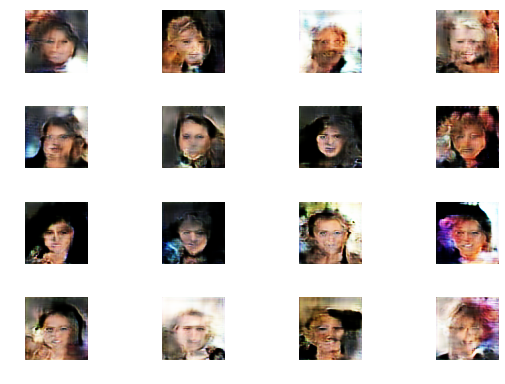

0: [D loss: 1.033793, acc: 0.531250] [A loss: 1.240133, acc: 0.390625]
1: [D loss: 0.803067, acc: 0.585938] [A loss: 1.076548, acc: 0.484375]
2: [D loss: 0.874557, acc: 0.585938] [A loss: 1.247758, acc: 0.421875]
3: [D loss: 0.869473, acc: 0.570312] [A loss: 1.405693, acc: 0.312500]
4: [D loss: 0.949092, acc: 0.515625] [A loss: 1.011410, acc: 0.453125]
5: [D loss: 0.853746, acc: 0.593750] [A loss: 1.150089, acc: 0.500000]
6: [D loss: 0.891315, acc: 0.585938] [A loss: 1.312194, acc: 0.375000]
7: [D loss: 0.882008, acc: 0.546875] [A loss: 1.036381, acc: 0.484375]
8: [D loss: 0.955757, acc: 0.546875] [A loss: 0.965630, acc: 0.515625]
9: [D loss: 0.883264, acc: 0.531250] [A loss: 1.194942, acc: 0.375000]
10: [D loss: 0.835434, acc: 0.632812] [A loss: 1.193915, acc: 0.437500]
11: [D loss: 1.071170, acc: 0.539062] [A loss: 1.039140, acc: 0.484375]
12: [D loss: 1.159375, acc: 0.476562] [A loss: 1.357809, acc: 0.390625]
13: [D loss: 1.203273, acc: 0.468750] [A loss: 0.954336, acc: 0.640625]
14

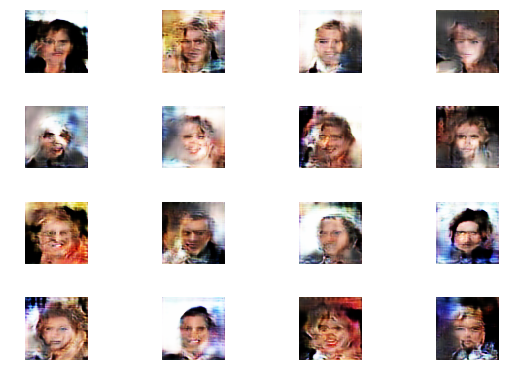

0: [D loss: 0.930472, acc: 0.554688] [A loss: 0.930131, acc: 0.453125]
1: [D loss: 1.035054, acc: 0.484375] [A loss: 1.304713, acc: 0.390625]
2: [D loss: 1.049128, acc: 0.515625] [A loss: 1.202132, acc: 0.453125]
3: [D loss: 0.988269, acc: 0.554688] [A loss: 1.043607, acc: 0.484375]
4: [D loss: 0.962111, acc: 0.570312] [A loss: 0.867697, acc: 0.515625]
5: [D loss: 1.026561, acc: 0.531250] [A loss: 1.179371, acc: 0.406250]
6: [D loss: 0.998545, acc: 0.507812] [A loss: 1.089458, acc: 0.531250]
7: [D loss: 1.030608, acc: 0.492188] [A loss: 1.205721, acc: 0.421875]
8: [D loss: 0.864094, acc: 0.554688] [A loss: 1.167908, acc: 0.468750]
9: [D loss: 1.000664, acc: 0.546875] [A loss: 1.349818, acc: 0.375000]
10: [D loss: 0.938994, acc: 0.554688] [A loss: 0.793766, acc: 0.500000]
11: [D loss: 1.019509, acc: 0.523438] [A loss: 1.275416, acc: 0.359375]
12: [D loss: 1.040211, acc: 0.476562] [A loss: 1.030079, acc: 0.484375]
13: [D loss: 0.921259, acc: 0.554688] [A loss: 1.012632, acc: 0.593750]
14

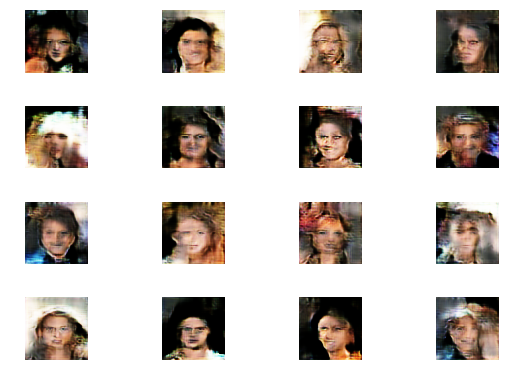

KeyboardInterrupt: ignored

In [0]:

faces = np.array(faces)
for j in range(10000):
  #x_train = []
    
  #for f in cats_im[np.random.randint(0, cats_im.shape[0], size=1000)]:
  #   x_train.append(cv2.resize((cv2.imread(f) / 255), (256, 	256), interpolation = cv2.INTER_AREA))
 
  y_train = []
    
  for f in faces[np.random.randint(0, faces.shape[0], size=6000)]:
    im = cv2.resize((cv2.imread('faces/img_align_celeba/' + f) / 255 * 2 - 1), (64, 64), interpolation = cv2.INTER_AREA)
    #im.reshape((64, 64, 3))
    y_train.append(im)

  mnist_dcgan.x_train = np.array(y_train)
  #mnist_dcgan.y_train = np.array(y_train)
  
  mnist_dcgan.train(train_steps=100, batch_size=64, save_interval=1000)
  mnist_dcgan.plot_images(fake=True) 
  mnist_dcgan.plot_images(fake=True, save2file=True)

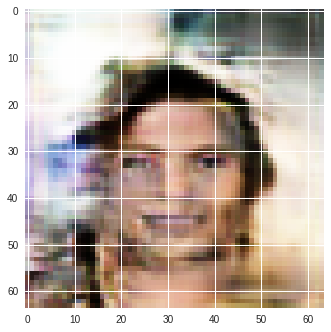

In [0]:
im = mnist_dcgan.generator.predict(np.random.normal(0, 0.3, size=[1, 100]))
plt.imshow(((im[0].reshape(64, 64, 3)+1)/2)[..., [2, 1, 0]])
